# Make a new set of decoys for PPI decoy discrimination

## Import `Python` modules

In [3]:
import os
import sys
import pandas
import glob
import random
import re
import shutil
import math
import time
import numpy as np
import scipy.stats
import umap
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set(font_scale=2, style='ticks', palette='colorblind')

# custom modules
sys.path.append('scripts/')
import design_utils

resultsdir = 'results/'
if not os.path.isdir(resultsdir):
    os.makedirs(resultsdir)

## Extract PDBs from silent files containing the output of Hahnbeom's global-docking runs

In [51]:
# Extract all PDBs from a silent file with output from
# global docking
native = '3CPH'
silent_file = os.path.join(
    '/net/scratch/haddox/2021/ppi_benchmark/data/comb1000/',
    f'{native}.1000.rescore.out'
)
output_dir = f'results/global_docks/{native}/'
if True: # not os.path.isdir(output_dir):
    #os.makedirs(output_dir)
    
    # Extract PDBs
    print('Extracting PDBs')
    design_utils.extract_pdbs_from_silent_file(
        working_dir=output_dir,
        silent_file=silent_file
    )

    # Copy the PDB of the native to the same directory as the
    # global docks
    print("Copying native PDB to same directory")
    native_pdb = os.path.join(
        '/home/dimaio/optE2/dualoptE/decoys/docking/',
        f'{native}_bound_native.pdb'
    )
    new_pdb = os.path.join(output_dir, os.path.basename(native_pdb))
    ! cp {native_pdb} {new_pdb}
    time.sleep(60)

    # Strip PDBs of all hydrogens to avoid bug with hydrogen
    # placement from old silent files
    print("Stripping hydrogens from all PDBs")
    pdbs = glob.glob(os.path.join(output_dir, '*.pdb'))
    for pdb in pdbs:
        cmd = f'scripts/stripH_inplace.pl {pdb}'
        ! {cmd}

Extracting PDBs
/home/haddox/Rosetta/main/source/bin/extract_pdbs.linuxgccrelease -database /home/haddox/Rosetta/main/database/ -in:file:silent /net/scratch/haddox/2021/ppi_benchmark/data/comb1000/3CPH.1000.rescore.out -silent_read_through_errors -crystal_refine
Copying native PDB to same directory
Stripping hydrogens from all PDBs


## Make jittered version of each global dock

In [3]:
# Define parameters for jittering inputs
run_dict = {
    1 : {
        'internal_sampes' : 100, # number of jitters to make
        'cluster_rmsd' : 0.2, # how tightly to cluster jitters
        'max_translate' : 4, # maximum translation distance
        'max_angle' : 10 # maximum angle for translating things
    },
    2 : {
        'internal_sampes' : 100, # number of jitters to make
        'cluster_rmsd' : 0.2, # how tightly to cluster jitters
        'max_translate' : 5, # maximum translation distance
        'max_angle' : 1 # maximum angle for translating things
    }
}

# Cycle over all input PDBs and jitter chain B
env_name = 'high_throughput_design_for_E_function_opt'
runs = [1, 2]
native = '1AHW' # '2AJF' # '1BUH'
pdb_dir = f'results/global_docks/{native}/'
pdbs = [
    pdb for pdb in glob.glob(os.path.join(pdb_dir, '*.pdb'))
    if 'S_' not in pdb
]
print(native, len(pdbs))
for run in runs:
    for pdb in pdbs:

        # Assemble command-line argument
        pdb_tag = os.path.basename(pdb).replace('.pdb', '')
        output_dir = os.path.join(
            pdb_dir,
            'jittered_poses',
            pdb_tag + '/',
            f'run_{run}/'
        )
        if not os.path.isdir(output_dir):
            os.makedirs(output_dir)
        cmd = ' '.join([
            'python',
            'scripts/jitter_binder.py',
            pdb,
            f'-output_dir {output_dir}',
            f'-output_pdb_suffix _run_{run}',
            f"-internal_samples {run_dict[run]['internal_sampes']}",
            f"-cluster_rmsd {run_dict[run]['cluster_rmsd']}",
            f"-max_translate {run_dict[run]['max_translate']}",
            f"-max_angle {run_dict[run]['max_angle']}",
            '-silent_out',
        ])
        cmd = 'source activate {0}'.format(env_name) + '\n' + cmd

        # Carry out the job
        sbatch_file_name = os.path.join(
            output_dir,
            'jitter_binder.sbatch'
        )
        if not os.path.isfile(sbatch_file_name):
            design_utils.WriteSbatchFile(
                sbatch_file_name,
                command=cmd,
                queue_type='medium',
                memory='2g'
            )
            ! sbatch {sbatch_file_name}

1AHW 991


## Use the beta_soft score function to score global docks before and after jittering to identify a subset to relax

Score global docks before jittering

In [4]:
# Define input params
score_app_path = \
    '/home/haddox/Rosetta/main/source/bin/score.linuxgccrelease'
native = '1AHW'
pdb_dir = f'results/global_docks/{native}/'
pdbs = glob.glob(os.path.join(pdb_dir, '*.pdb'))
file_listing_pdbs = os.path.join(pdb_dir, 'pdbs.txt')
if not os.path.isfile(file_listing_pdbs):
    with open(file_listing_pdbs, 'w') as f:
        for pdb in pdbs:
            f.write(f'{pdb}\n')
extra_args = ['-beta']
output_dir = pdb_dir

# Score PDBs
scores_file_prefix = os.path.join(output_dir, 'soft_rep_score')
scores_sbatch_file = scores_file_prefix + '.sbatch'
if not os.path.isfile(scores_sbatch_file):
    design_utils.compute_score_using_rosettascripts(
        score_app_path=score_app_path,
        file_listing_pdbs=file_listing_pdbs,
        weights_file='beta_soft',
        extra_args=extra_args,
        output_dir=output_dir,
        scores_file_prefix=scores_file_prefix,
        submit_sbatch_job=True,
        queue_type='medium',
        memory='2g'
    )

Score global docks after jittering

In [5]:
# Define input params
native = '1AHW' # '2AJF'
jitter_dir = f'results/global_docks/{native}/jittered_poses/'
silent_files = glob.glob(os.path.join(
    jitter_dir,
    '*/run*/out.silent'
))
extra_args = [
    '-in:file:silent_struct_type binary',
    '-beta'
]

# Loop over silent files and score each
for silent_file in silent_files:
    output_dir = os.path.split(silent_file)[0] + '/'
    scores_file_prefix = os.path.join(output_dir, 'soft_rep_score')
    scores_sbatch_file = scores_file_prefix + '.sbatch'
    if not os.path.isfile(scores_sbatch_file):
        design_utils.compute_score_using_rosettascripts(
            score_app_path=score_app_path,
            silent_file=silent_file,
            weights_file='beta_soft',
            extra_args=extra_args,
            output_dir=False,
            scores_file_prefix=scores_file_prefix,
            submit_sbatch_job=True,
            queue_type='medium',
            memory='2g'
        )

Read in and visualize scores from above

In [6]:
# Read in scores for global docks before jittering
native = '1BUH' # '1AHW' # '2AJF' # '1Y64' #
dfs = []
score_file = f'results/global_docks/{native}/soft_rep_score.sc'
df = pandas.read_csv(score_file, sep='\s+')
df.dropna(subset=['description'], inplace=True)
df['score'] = df['score'].astype(float)
df['pdb'] = df['description'].apply(
    lambda x: x[:-5] + '.pdb'
)
df['native'] = native
df['global_dock_parent'] = df['pdb'].apply(
    lambda x: f"{native}_{os.path.basename(x).replace('.pdb', '')}"
)
df['original_dock'] = True
del df['SCORE:']
dfs.append(df)

# Read in scores for global docks after jittering
jitter_dir = f'results/global_docks/{native}/jittered_poses/'
score_files = glob.glob(os.path.join(
    jitter_dir,
    '*/run*/soft_rep_score.sc'
))
for score_file in score_files:
    df = pandas.read_csv(score_file, sep='\s+')
    df.dropna(subset=['description'], inplace=True)
    df['score'] = df['score'].astype(float)
    df['pdb'] = df['description'].apply(
        lambda x: x[:-5] + '.pdb'
    )
    df['native'] = native
    df['global_dock_parent'] = f"{native}_{score_file.split('/')[-3]}"
    df['original_dock'] = False
    del df['SCORE:']
    dfs.append(df)
soft_scores_df = pandas.concat(dfs, sort=False)
soft_scores_df = soft_scores_df[
    ~soft_scores_df['global_dock_parent'].str.contains('_S_')
]
del dfs
print(native, len(soft_scores_df))

1BUH 196720


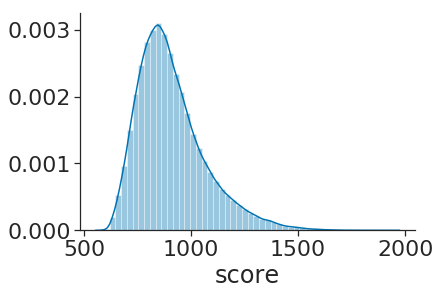

In [7]:
sns.distplot(soft_scores_df['score'])
sns.despine()
plt.show()

Identify a subset of low-scoring decoys to relax

In [8]:
# For each parent from the global dock, select one or
# a few of the best-scoring structures for relaxing
native = '1BUH' # '1AHW' # '2AJF' # '1Y64' #
native_pdb = os.path.join(
    'results/global_docks/',
    native,
    f'{native}_bound_native.pdb'
)
candidates_to_relax = []
parents = list(set(soft_scores_df['global_dock_parent']))
print(native, len(parents))
soft_scores_df.sort_values('score', inplace=True)
for parent in parents:
    
    # Make a list of the best one or few of the best-scoring
    # decoys
    if 'native' in parent:
        n_candidates_per_parent = 10
    else:
        n_candidates_per_parent = 5
    pdbs = list(soft_scores_df[
        soft_scores_df['global_dock_parent'] == parent
    ]['pdb'][:n_candidates_per_parent])
    renamed_pdbs = []
    for pdb in pdbs:
        if 'jittered_poses' in pdb:
            renamed_pdbs.append(pdb.replace('.pdb', '_0001.pdb'))
        else:
            renamed_pdbs.append(pdb)
    pdbs = renamed_pdbs
    tags = [pdb.replace('_0001.pdb', '') for pdb in pdbs]
    candidates_to_relax.extend(pdbs)
    
    # Extract the PDB file of each one
    for tag in tags:
        assert native in tag, tag
        output_dir = os.path.split(tag)[0] + '/'
        tag_bn = os.path.split(tag)[1]
        silent_file = os.path.join(output_dir, 'out.silent')
        scores_file_prefix = os.path.join(
            output_dir, f'extract_{tag_bn}'
        )
        scores_sbatch_file = scores_file_prefix + '.sbatch'
        if not os.path.isfile(scores_sbatch_file):
            print(tag)
            extra_args = [
                '-out:output',
                f'-in:file:tags {tag}',
                '-in:file:silent_struct_type binary',
                '-silent_read_through_errors',
                '-beta'
            ]
            design_utils.compute_score_using_rosettascripts(
                score_app_path=score_app_path,
                silent_file=silent_file,
                weights_file='beta_soft',
                extra_args=extra_args,
                output_dir=False,
                scores_file_prefix=scores_file_prefix,
                submit_sbatch_job=True,
                queue_type='short',
                memory='2g',
                write_out_err=False,
            )

1BUH 991


In [9]:
i = 0
for f in candidates_to_relax:
    if not os.path.isfile(f):
        raise ValueError(f)
#         (dir_i, bn) = os.path.split(f)
#         sbatch_file = bn.replace(
#             'complex', 'extract_complex'
#         ).replace('_0001.pdb', '.sbatch')
#         sbatch_file = os.path.join(dir_i, sbatch_file)
#         if os.path.isfile(sbatch_file):
#             os.remove(sbatch_file)
#             i += 1
    #assert os.path.isfile(f), f
print(i)

0


In [10]:
fs = [os.path.basename(f) for f in candidates_to_relax]
print(len(fs), len(set(fs)))

4960 4874


In [11]:
print(sum(['run_2' in f for f in candidates_to_relax]))

3445


In [12]:
candidates_to_relax

['results/global_docks/1BUH/jittered_poses/complex.234/run_2/complex.234_chain_B_5_0001.pdb',
 'results/global_docks/1BUH/jittered_poses/complex.234/run_2/complex.234_chain_B_22_0001.pdb',
 'results/global_docks/1BUH/jittered_poses/complex.234/run_1/complex.234_chain_B_12_0001.pdb',
 'results/global_docks/1BUH/jittered_poses/complex.234/run_1/complex.234_chain_B_28_0001.pdb',
 'results/global_docks/1BUH/jittered_poses/complex.234/run_2/complex.234_chain_B_39_0001.pdb',
 'results/global_docks/1BUH/jittered_poses/complex.61/run_2/complex.61_chain_B_9_0001.pdb',
 'results/global_docks/1BUH/jittered_poses/complex.61/run_2/complex.61_chain_B_19_0001.pdb',
 'results/global_docks/1BUH/jittered_poses/complex.61/run_1/complex.61_chain_B_39_0001.pdb',
 'results/global_docks/1BUH/jittered_poses/complex.61/run_2/complex.61_chain_B_5_0001.pdb',
 'results/global_docks/1BUH/jittered_poses/complex.61/run_2/complex.61_chain_B_32_0001.pdb',
 'results/global_docks/1BUH/jittered_poses/complex.1743/run_2/c

After extracting best jitters, remove silent files with all jitterd poses

In [13]:
native = '1AHW' # '2AJF' # '1Y64' # '1BUH' # 
silent_files = glob.glob(
    f'results/global_docks/{native}/jittered_poses/*/*/out.silent'
)
print(native, len(silent_files))
for f in silent_files:
    os.remove(f)

1AHW 0


## Relax the top decoys from each landscape

Define energy functions

In [2]:
e_functions_dict = {
    'beta_nov16' : (
        'beta_nov16_cart', # weights
        None, # flags
        ['-beta_nov16_cart'] # extra args
    ),
    'HH_run19A_step266' : (
        '/home/haddox/2019/optE_eval/data/HH_run19A_weights_266.wts',
        '/home/haddox/2019/optE_eval/data/HH_run19A_flags_266',
        []
    ),
    'HH_run19A_step266_dd_sol_1a' : (
        '/home/haddox/2019/optE_eval/data/HH_run19A_weights_266_dd_elec_sol.wts',
        '/home/haddox/2019/optE_eval/data/HH_run19A_flags_266_dd_sol_1a',
        []
    ),
    'HH_run19A_step266_dd_sol_2a' : (
        '/home/haddox/2019/optE_eval/data/HH_run19A_weights_266_dd_elec_sol.wts',
        '/home/haddox/2019/optE_eval/data/HH_run19A_flags_266_dd_sol_2a',
        []
    ),
    'HH_run19A_step266_dd_sol_2b' : (
        '/home/haddox/2019/optE_eval/data/HH_run19A_weights_266_dd_elec_sol.wts',
        '/home/haddox/2019/optE_eval/data/HH_run19A_flags_266_dd_sol_2b',
        []
    ),
    'HH_run19A_step266_dd_elec_5h_res0.5_pr2.5' : (
        '/home/haddox/2019/optE_eval/data/HH_run19A_weights_266_dd_elec.wts',
        '/home/haddox/2019/optE_eval/data/HH_run19A_flags_266_dd_elec_5h_res0.5_pr2.5',
        []
    ),
    'HH_run19A_step266_dd_elec_sol_5h_res0.5_pr2.5' : (
        '/home/haddox/2019/optE_eval/data/HH_run19A_weights_266_dd_elec_sol.wts',
        '/home/haddox/2019/optE_eval/data/HH_run19A_flags_266_dd_elec_sol_5h_res0.5_pr2.5',
        []
    ),
}

Relax decoys with coordinate constraints on backbone atoms

In [20]:
# Define input params
relax_path = \
    '/home/haddox/Rosetta/main/source/bin/relax.default.linuxgccrelease'

# Relax the PDBs with the best beta_soft scores
native = '1BUH' # '1AHW' # '2AJF' # '1Y64' # 
native_pdb = os.path.join(
    '/home/dimaio/optE2/dualoptE/decoys/docking/',
    f'{native}_bound_native.pdb'
)
pdbs = [native_pdb] + candidates_to_relax
for f in pdbs:
    assert os.path.isfile(f), f
    assert native in f, f

# Relax pdbs
e_functions = [
    'beta_nov16',
#     'HH_run19A_step266',
#     'HH_run19A_step266_dd_elec_5h_res0.5_pr2.5',
#     'HH_run19A_step266_dd_elec_sol_5h_res0.5_pr2.5'
]
coord_cst_wts = [0.01]
for e_function in e_functions:
    (weights_file, flags_file, extra_args) = e_functions_dict[e_function]
    for coord_cst_wt in coord_cst_wts:
        output_dir = os.path.join(
            'results/global_docks/',
            native,
            f'constrained_relax_{coord_cst_wt}_mca',
            f'{e_function}/'
        )
        if not os.path.isdir(output_dir):
            os.makedirs(output_dir)
        scorefile = os.path.join(output_dir, 'relax.sc')
        cmds = []
        for pdb in pdbs:
            run_dir = pdb.split('/')[-2]
            output_prefix = os.path.join(output_dir, run_dir) + '_'
            cmd = ' '.join([
                relax_path,
                f'-s {pdb}',
                f'-score:weights {weights_file}',
                '-crystal_refine',
                '-use_input_sc',
                f'-nstruct 1',
                #'-no_optH false',
                '-ignore_unrecognized_res',
                '-overwrite',
                '-relax:script MonomerDesign2019',
                '-relax:cartesian true',
                '-relax:min_type lbfgs_armijo_nonmonotone',
                '-relax:constrain_relax_to_start_coords',
                '-relax:ramp_constraints false',
                f'-set_weights coordinate_constraint {coord_cst_wt}',
                '-relax:default_repeats 5',
                #'-multi_cool_annealer 10',
                '-ex1 -ex2aro -linmem_ig 10',
                f'-out:prefix {output_prefix}',
                f'-out:file:scorefile {scorefile}.sc',
                '-mute all',
            ] + extra_args)
            if flags_file:
                cmd += f' @{flags_file}'
            cmds.append(cmd)

        # Write commands to a file
        command_file_name = os.path.join(output_dir, 'commands.txt')
        if not os.path.isfile(command_file_name):
            with open(command_file_name, 'w') as f:
                print(command_file_name)
                for cmd in cmds:
                    f.write(cmd + '\n')

        sbatch_file_name = os.path.join(output_dir, 'relax.sbatch')
        if not os.path.isfile(sbatch_file_name):
            print(native, len(pdbs), e_function)
            design_utils.WriteSbatchFile(
                sbatch_file_name=sbatch_file_name,
                command_file_name=command_file_name,
                queue_type='medium',
                memory='2g',
                array=None,
                group_size=None,
                n_commands=None,
                write_out_err=True
            )
            ! sbatch -a 1-$(cat {command_file_name}|wc -l) {sbatch_file_name}

Relax native structure with nstruct of 10

In [21]:
# Get the path to the native PDB
native = '1AHW' # '2AJF' # '1Y64' # '1BUH' # 
native_pdb = os.path.join(
    '/home/dimaio/optE2/dualoptE/decoys/docking/',
    f'{native}_bound_native.pdb'
)

# Relax the native with each energy function
e_functions = [
    'beta_nov16',
#     'HH_run19A_step266',
#     'HH_run19A_step266_dd_elec_5h_res0.5_pr2.5',
#     'HH_run19A_step266_dd_elec_sol_5h_res0.5_pr2.5'
]
coord_cst_wts = [0.01]
for e_function in e_functions:
    (weights_file, flags_file, extra_args) = e_functions_dict[e_function]
    for coord_cst_wt in coord_cst_wts:
        output_dir = os.path.join(
            'results/global_docks/',
            native,
            f'constrained_relax_{coord_cst_wt}_mca',
            f'{e_function}/'
        )
        if not os.path.isdir(output_dir):
            os.makedirs(output_dir)
        scorefile = os.path.join(output_dir, 'relax_native.sc')
        cmd = ' '.join([
            relax_path,
            f'-s {native_pdb}',
            f'-score:weights {weights_file}',
            '-crystal_refine',
            '-use_input_sc',
            f'-nstruct 10',
            #'-no_optH false',
            '-ignore_unrecognized_res',
            '-overwrite',
            '-relax:script MonomerDesign2019',
            '-relax:cartesian true',
            '-relax:min_type lbfgs_armijo_nonmonotone',
            '-relax:constrain_relax_to_start_coords',
            '-relax:ramp_constraints false',
            f'-set_weights coordinate_constraint {coord_cst_wt}',
            '-relax:default_repeats 5',
            #'-multi_cool_annealer 10',
            '-ex1 -ex2aro -linmem_ig 10',
            f'-out:prefix {output_dir}',
            f'-out:file:scorefile {scorefile}',
            '-mute all',
        ] + extra_args)
        if flags_file:
            cmd += f' @{flags_file}'

        # Submit job
        sbatch_file_name = \
            os.path.join(output_dir, 'relax_native.sbatch')
        if not os.path.isfile(sbatch_file_name):
            design_utils.WriteSbatchFile(
                sbatch_file_name=sbatch_file_name,
                command=cmd,
                queue_type='long',
                memory='2g',
            )
            ! sbatch {sbatch_file_name}

Score relaxed decoys, computing both total score and ddG

In [22]:
rosetta_scripts_path = '/home/haddox/Rosetta/main/source/bin/rosetta_scripts.linuxgccrelease'
xml = 'scripts/compute_ddg_and_total_score.xml'

native = '2AJF' # '1AHW' # '1Y64' # '1BUH' # 
native_pdb = os.path.join(
    '/home/dimaio/optE2/dualoptE/decoys/docking/',
    f'{native}_bound_native.pdb'
)

use_silent_file = False
e_functions = [
    'beta_nov16',
#     'HH_run19A_step266',
#     'HH_run19A_step266_dd_elec_5h_res0.5_pr2.5',
#     'HH_run19A_step266_dd_elec_sol_5h_res0.5_pr2.5'
]
relax_scripts = [
    #'fastrelax_all_relax',
    'constrained_relax_0.01_mca'
]
for e_function in e_functions:
    (weights_file, flags_file, extra_args) = e_functions_dict[e_function]
    for relax_script in relax_scripts:
        pdb_dir = os.path.join(
            'results/global_docks/',
            native,
            relax_script,
            f'{e_function}/'
        )
        scores_file_prefix = os.path.join(pdb_dir, 'score')
        sbatch_file = scores_file_prefix + '.sbatch'
        if not os.path.isfile(sbatch_file):
            if use_silent_file:
                silent_file = os.path.join(pdb_dir, 'relax.out')
                cmd = ' '.join([
                    rosetta_scripts_path,
                    '-in:file:silent_struct_type binary',
                    f'-in:file:silent {silent_file}',
                    f'-parser:protocol {xml}',
                    f'-parser:script_vars',
                    f'weights_file={weights_file}',
                    '-silent_read_through_errors',
                    '-crystal_refine',
                    f'-out:prefix {pdb_dir}',
                    f'-out:file:score_only {scores_file_prefix}.sc',
                    f'-in:file:native {native_pdb}',
                ])
            else:
                pdbs = glob.glob(os.path.join(pdb_dir, '*.pdb'))
                if len(pdbs) == 0:
                    continue
                print(native, len(pdbs), e_function, relax_script)
                file_listing_pdbs = os.path.join(pdb_dir, 'pdbs.txt')
                with open(file_listing_pdbs, 'w') as f:
                    for pdb in pdbs:
                        f.write(f'{pdb}\n')
                cmd = ' '.join([
                    rosetta_scripts_path,
                    f'-l {file_listing_pdbs}',
                    f'-parser:protocol {xml}',
                    f'-parser:script_vars',
                    f'weights_file={weights_file}',
                    '-crystal_refine',
                    f'-out:prefix {pdb_dir}',
                    f'-out:file:score_only {scores_file_prefix}.sc',
                    f'-in:file:native {native_pdb}',
                ])

            if extra_args:
                cmd += ' ' + ' '.join(extra_args)
            if flags_file:
                cmd += f' @{flags_file}'
            design_utils.WriteSbatchFile(
                sbatch_file,
                command=cmd,
                queue_type='long',
                memory='2g',
            )
            ! sbatch {sbatch_file}

Read in data

In [23]:
# Read in data
relax_script = 'constrained_relax_0.01_mca'
natives = ['1BUH', '2AJF', '1AHW', '1Y64']
dfs = []
for native in natives:
    f = os.path.join(
        'results/global_docks/',
        native,
        relax_script,
        'beta_nov16/score.sc'
    )
    df = pandas.read_csv(f, sep='\s+', skiprows=1)
    print(native, len(df))
    df['native'] = native
    df['pdb'] = df['description'].apply(os.path.basename)
    df['decoy_type'] = df['pdb'].apply(
        lambda x: 'native' if x.startswith(f'{native}_bound_native') \
            else 'decoy'
    )
    dfs.append(df)
df = pandas.concat(dfs, sort=False)
    
# Add additional columns
df['pdb_path'] = df['description'].apply(lambda x: x[:-5] + '.pdb')
df['tag'] = df['description'].apply(lambda x: x[:-5])
df['total_score_from_parts'] = df[[
    'ddg', 'total_score_chain_A', 'total_score_chain_B'
]].sum(axis=1)
df['total_score_monomers'] = df[[
    'total_score_chain_A', 'total_score_chain_B'
]].sum(axis=1)
df['ddg_from_parts'] = df['total_score'] - df['total_score_monomers']
df.sort_values('total_score', inplace=True)

1BUH 4970
2AJF 4772
1AHW 4413
1Y64 2852


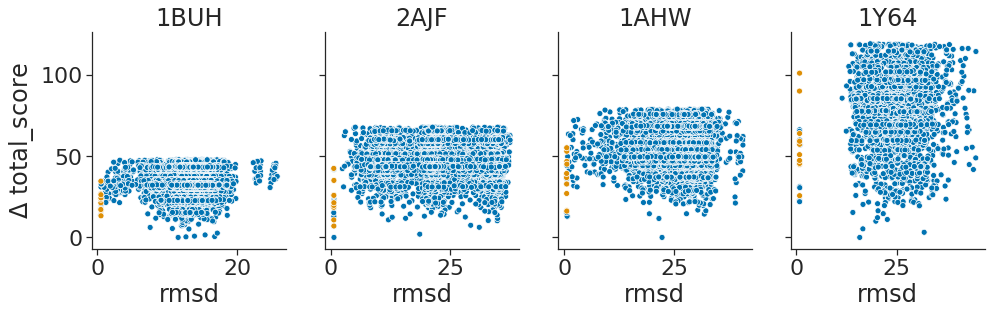

In [24]:
metric = 'total_score' # 'ddg_from_parts' # 'ddg' # 
(fig, axs) = plt.subplots(
    ncols=len(natives), figsize=[16,4],
    sharey=True
)
for (i, native) in enumerate(natives):
    upper_lim = df[df['native'] == native][metric].quantile(q=0.8)
    min_val = df[df['native'] == native][metric].min()
    data = df[
        (df['native'] == native) &
        (df[metric] < upper_lim)
    ].copy()
    data.sort_values('decoy_type', inplace=True)
    data['energy'] = data[metric] - min_val
    sns.scatterplot(
        x='rmsd', y='energy', data=data, hue='decoy_type',
        hue_order=['decoy', 'native'], ax=axs[i]
    )
    axs[i].set(title=native)
    axs[i].get_legend().remove()
axs[0].set(
    ylabel='$\Delta$ {0}'.format(metric).replace('_from_parts', '')
)
sns.despine()
plt.show()

In [25]:
native = '1BUH'
upper_lim = df[df['native'] == native][metric].quantile(q=0.8)
min_val = df[df['native'] == native][metric].min()
data = df[
    (df['native'] == native) &
    (df[metric] < upper_lim)
].copy()
data[[
    'rmsd', 'total_score', 'ddg_from_parts',
    'pdb', 'description', 'decoy_type'
]].sort_values(metric).head(n=10)

,rmsd,total_score,ddg_from_parts,pdb,description,decoy_type
661,11.579,-1233.775,-50.486,run_1_complex.319_chain_B_71_0001_0001_0001,results/global_docks/1BUH/constrained_relax_0....,decoy
3252,12.696,-1233.423,-51.638,run_2_complex.190_chain_B_29_0001_0001_0001,results/global_docks/1BUH/constrained_relax_0....,decoy
1761,16.810,-1233.245,-47.752,run_1_complex.104_chain_B_57_0001_0001_0001,results/global_docks/1BUH/constrained_relax_0....,decoy
3755,13.916,-1232.984,-40.544,run_1_complex.644_chain_B_12_0001_0001_0001,results/global_docks/1BUH/constrained_relax_0....,decoy
273,15.437,-1232.246,-37.156,run_2_complex.682_chain_B_55_0001_0001_0001,results/global_docks/1BUH/constrained_relax_0....,decoy
4835,17.186,-1231.119,-41.131,run_1_complex.132_chain_B_87_0001_0001_0001,results/global_docks/1BUH/constrained_relax_0....,decoy
2003,13.124,-1228.603,-79.204,run_1_complex.5_chain_B_6_0001_0001_0001,results/global_docks/1BUH/constrained_relax_0....,decoy
4421,10.750,-1228.301,-59.476,run_1_complex.427_chain_B_59_0001_0001_0001,results/global_docks/1BUH/constrained_relax_0....,decoy
1364,7.574,-1227.615,-78.491,run_2_complex.1845_chain_B_5_0001_0001_0001,results/global_docks/1BUH/constrained_relax_0....,decoy
2407,12.143,-1226.706,-54.452,run_1_complex.53_chain_B_19_0001_0001_0001,results/global_docks/1BUH/constrained_relax_0....,decoy


In [26]:
data['description'].iloc[4]

'results/global_docks/1BUH/constrained_relax_0.01_mca/beta_nov16/run_2_complex.682_chain_B_55_0001_0001_0001'

**Observations**
* 1BUH
    * many alternate minima
    * some probably aren't realistic because of overlap with unresolved region, but not all low-energy decoys have this problem
        
* 1Y64
    * many alternate minima
    * large spread in total score, even among relaxed natives

* 2AJF
    * deep minimum in ddg that disappears in total score, but total score has a few alternate minima that are close to native
    
* 1AHW
    * multiple alternate minima
    
Questions
* why do minima in ddg often disappear when look at total score?
* ddg and ddg_from_parts is very different for 1Y64. Why?

Select a subset of the best-scoring decoys and re-relax with different energy functions

In [27]:
# Make a series of bins every 1A and choose top 20
# points in each bin
native = '1BUH'
max_rmsd = df[df['native'] == native]['rmsd'].max()
bin_size = 1
n_samples = 20
bin_mins = np.arange(0, max_rmsd+bin_size, bin_size)
df.sort_values('total_score', inplace=True)
pdbs = []
for bin_min in bin_mins:
    data = df[
        (df['native'] == native) &
        (df['rmsd'].between(bin_min, bin_min+bin_size))
    ]
    pdbs += list(data['pdb_path'][:n_samples])
for f in pdbs:
    assert os.path.isfile(f), f
    assert native in f, f

# Relax the above PDBs
relax_path = \
    '/home/haddox/Rosetta/main/source/bin/relax.default.linuxgccrelease'
e_functions = [
#     'beta_nov16',
    'HH_run19A_step266',
#     'HH_run19A_step266_dd_sol_1a',
#     'HH_run19A_step266_dd_elec_5h_res0.5_pr2.5',
#     'HH_run19A_step266_dd_elec_sol_5h_res0.5_pr2.5'
]
for e_function in e_functions:
    (weights_file, flags_file, extra_args) = e_functions_dict[e_function]
    output_dir = os.path.join(
        'results/global_docks/',
        native,
        f'constrained_relax_0.01_mca',
        'beta_nov16',
        'rerelax_binned_decoys',
        f'{e_function}/'
    )
    if not os.path.isdir(output_dir):
        os.makedirs(output_dir)
    scorefile = os.path.join(output_dir, 'relax.sc')
    cmds = []
    for pdb in pdbs:
        cmd = ' '.join([
            relax_path,
            f'-s {pdb}',
            f'-score:weights {weights_file}',
            '-crystal_refine',
            '-use_input_sc',
            f'-nstruct 1',
            #'-no_optH false',
            '-ignore_unrecognized_res',
            '-overwrite',
            '-relax:script MonomerDesign2019',
            '-relax:cartesian true',
            '-relax:min_type lbfgs_armijo_nonmonotone',
            '-relax:constrain_relax_to_start_coords',
            '-relax:ramp_constraints false',
            f'-set_weights coordinate_constraint {coord_cst_wt}',
            '-relax:default_repeats 1',
            #'-multi_cool_annealer 10',
            '-ex1 -ex2aro -linmem_ig 10',
            f'-out:prefix {output_dir}',
            f'-out:file:scorefile {scorefile}',
            '-mute all',
        ] + extra_args)
        if flags_file:
            cmd += f' @{flags_file}'
        cmds.append(cmd)

    # Write commands to a file
    command_file_name = os.path.join(output_dir, 'commands.txt')
    if not os.path.isfile(command_file_name):
        with open(command_file_name, 'w') as f:
            print(command_file_name)
            for cmd in cmds:
                f.write(cmd + '\n')

    sbatch_file_name = os.path.join(output_dir, 'relax.sbatch')
    if not os.path.isfile(sbatch_file_name):
        print(native, len(pdbs), e_function)
        design_utils.WriteSbatchFile(
            sbatch_file_name=sbatch_file_name,
            command_file_name=command_file_name,
            queue_type='medium',
            memory='2g',
            array=None,
            group_size=None,
            n_commands=None,
            write_out_err=True
        )
        ! sbatch -a 1-$(cat {command_file_name}|wc -l) {sbatch_file_name}

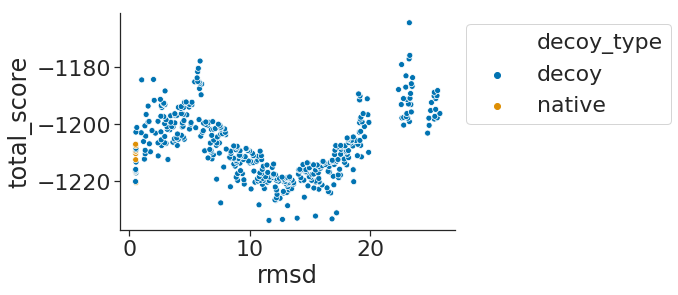

In [28]:
data = df[df['pdb_path'].isin(pdbs)].copy()
metric = 'total_score' # 'ddg_from_parts' # 
data.sort_values(metric, inplace=True)
sns.scatterplot(
    x='rmsd', y=metric, data=data, hue='decoy_type',
    hue_order=['decoy', 'native']
)
plt.legend(bbox_to_anchor=(1,1))
sns.despine()
plt.show()

Score the re-relaxed structures

In [31]:
rosetta_scripts_path = '/home/haddox/Rosetta/main/source/bin/rosetta_scripts.linuxgccrelease'
xml = 'scripts/compute_ddg_and_total_score.xml'

native = '1BUH' # '2AJF' # '1AHW' # '1Y64' # 
native_pdb = os.path.join(
    '/home/dimaio/optE2/dualoptE/decoys/docking/',
    f'{native}_bound_native.pdb'
)

use_silent_file = False
e_functions = [
    #'beta_nov16',
    'HH_run19A_step266',
    'HH_run19A_step266_dd_sol_2a',
    'HH_run19A_step266_dd_sol_2b',
    'HH_run19A_step266_dd_elec_5h_res0.5_pr2.5',
    'HH_run19A_step266_dd_elec_sol_5h_res0.5_pr2.5'
]
for e_function in e_functions:
    (weights_file, flags_file, extra_args) = e_functions_dict[e_function]
    pdb_dir = os.path.join(
        'results/global_docks/',
        native,
        f'constrained_relax_0.01_mca',
        'beta_nov16',
        'rerelax_binned_decoys',
        'HH_run19A_step266/'
    )
    scores_file_prefix = os.path.join(pdb_dir, f'score_{e_function}')
    sbatch_file = scores_file_prefix + '.sbatch'
    if not os.path.isfile(sbatch_file):
        pdbs = glob.glob(os.path.join(pdb_dir, '*.pdb'))
        if len(pdbs) == 0:
            continue
        print(native, len(pdbs), e_function)
        file_listing_pdbs = os.path.join(pdb_dir, 'pdbs.txt')
        if not os.path.isfile(file_listing_pdbs):
            with open(file_listing_pdbs, 'w') as f:
                for pdb in pdbs:
                    f.write(f'{pdb}\n')
        cmd = ' '.join([
            rosetta_scripts_path,
            f'-l {file_listing_pdbs}',
            f'-parser:protocol {xml}',
            f'-parser:script_vars',
            f'weights_file={weights_file}',
            '-crystal_refine',
            f'-out:prefix {pdb_dir}',
            f'-out:file:score_only {scores_file_prefix}.sc',
            f'-in:file:native {native_pdb}',
        ])
        if extra_args:
            cmd += ' ' + ' '.join(extra_args)
        if flags_file:
            cmd += f' @{flags_file}'
        design_utils.WriteSbatchFile(
            sbatch_file,
            command=cmd,
            queue_type='long',
            memory='2g',
        )
        ! sbatch {sbatch_file}

1BUH 433 HH_run19A_step266_dd_sol_2b
Submitted batch job 20942729


Read in data from above

In [38]:
native = '1BUH' # '2AJF' # '1Y64' # '1AHW' # 
e_functions = [
    'HH_run19A_step266',
    'HH_run19A_step266_dd_sol_2a',
    'HH_run19A_step266_dd_sol_2b',
    #'HH_run19A_step266_dd_elec_5h_res0.5_pr2.5',
    #'HH_run19A_step266_dd_elec_sol_5h_res0.5_pr2.5',
]
dfs = []
for e_function in e_functions:
    f = os.path.join(
        'results/global_docks/',
        native,
        'constrained_relax_0.01_mca/beta_nov16/',
        'rerelax_binned_decoys/HH_run19A_step266',
        f'score_{e_function}.sc'
    )
    if not os.path.isfile(f):
        continue
    df = pandas.read_csv(f, sep='\s+', skiprows=1)
    df['e_function'] = e_function
    print(e_function, len(df))
    dfs.append(df)
df = pandas.concat(dfs, sort=False)
df['pdb'] = df['description'].apply(os.path.basename)
df['pdb_path'] = df['description'].apply(lambda x: x[:-5] + '.pdb')
df['decoy_type'] = df['pdb'].apply(
    lambda x: 'native' if x.startswith(f'{native}_bound_native') \
        else 'decoy'
)
df['tag'] = df['description'].apply(lambda x: x[:-5])
df['total_score_from_parts'] = df[[
    'ddg', 'total_score_chain_A', 'total_score_chain_B'
]].sum(axis=1)
df['total_score_monomers'] = df[[
    'total_score_chain_A', 'total_score_chain_B'
]].sum(axis=1)
df['ddg_from_parts'] = df['total_score'] - df['total_score_monomers']
df.sort_values('total_score', inplace=True)
df[[
    'rmsd', 'ddg', 'ddg_from_parts', 'total_score',
    'total_score_chain_A', 'total_score_chain_B',
    'total_score_from_parts', 'pdb',
]].head()

HH_run19A_step266 433
HH_run19A_step266_dd_sol_2a 348
HH_run19A_step266_dd_sol_2b 355


,rmsd,ddg,ddg_from_parts,total_score,total_score_chain_A,total_score_chain_B,total_score_from_parts,pdb
138,15.718,-57.023,-57.312,-1638.036,-1281.726,-298.998,-1637.747,run_1_complex.91_chain_B_14_0001_0001_0001_0001
79,17.139,-41.272,-40.183,-1636.018,-1301.244,-294.591,-1637.107,run_1_complex.132_chain_B_87_0001_0001_0001_0001
349,15.036,-53.425,-54.283,-1634.353,-1287.285,-292.785,-1633.495,run_1_complex.662_chain_B_4_0001_0001_0001_0001
325,18.967,-29.805,-31.529,-1632.595,-1299.819,-301.247,-1630.871,run_2_complex.255_chain_B_68_0001_0001_0001_0001
341,14.277,-30.409,-31.431,-1630.331,-1299.363,-299.537,-1629.309,run_2_complex.365_chain_B_17_0001_0001_0001_0001


1BUH total_score


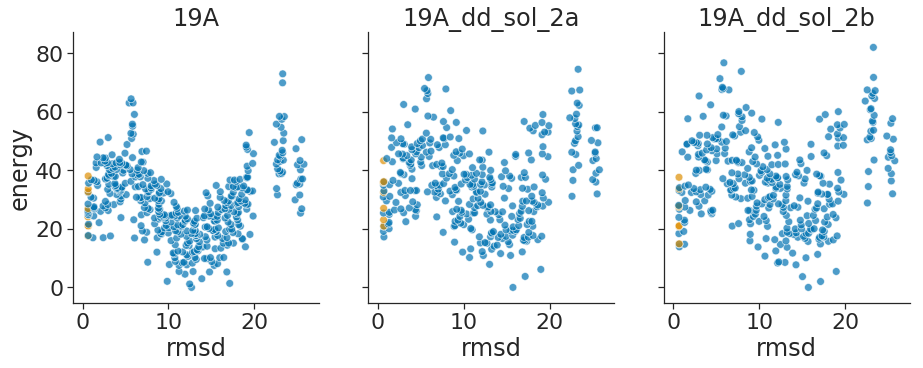

In [39]:
metric = 'total_score' # 'ddg_from_parts' #
print(native, metric)
df.sort_values(metric, inplace=True)
(fig, axs) = plt.subplots(
    ncols=len(e_functions), figsize=[5*len(e_functions), 5],
    sharex=True, sharey=True
)
for (i, e_function) in enumerate(e_functions):
    data = df[df['e_function'] == e_function].copy()
    min_val = data[metric].min()
    data['energy'] = data['total_score'] - min_val
    sns.scatterplot(
        x='rmsd', y='energy', data=data,
        s=60, alpha=0.7,
        hue='decoy_type', hue_order=['decoy', 'native'],
        ax=axs[i]
    )
    axs[i].set(
        title=e_function.replace(
            'HH_run19A_step266', '19A'
        ).replace('_res0.5_pr2.5', '*')
    )
    axs[i].get_legend().remove()
#plt.tight_layout()
sns.despine()
plt.show()

In [40]:
data[['e_function', 'total_score', 'fa_sol_bd', 'pdb']].head()

,e_function,total_score,fa_sol_bd,pdb
138,HH_run19A_step266_dd_sol_2b,-1638.036,2278.017,run_1_complex.91_chain_B_14_0001_0001_0001_0001
79,HH_run19A_step266_dd_sol_2b,-1636.018,2286.849,run_1_complex.132_chain_B_87_0001_0001_0001_0001
349,HH_run19A_step266_dd_sol_2b,-1634.353,2261.045,run_1_complex.662_chain_B_4_0001_0001_0001_0001
325,HH_run19A_step266_dd_sol_2b,-1632.595,2236.380,run_2_complex.255_chain_B_68_0001_0001_0001_0001
341,HH_run19A_step266_dd_sol_2b,-1630.331,2240.837,run_2_complex.365_chain_B_17_0001_0001_0001_0001


In [41]:
data['pdb_path'].iloc[0]

'results/global_docks/1BUH/constrained_relax_0.01_mca/beta_nov16/rerelax_binned_decoys/HH_run19A_step266/run_1_complex.91_chain_B_14_0001_0001_0001.pdb'

Relax decoys

In [15]:
# Define inputs
rosettapath = '/home/haddox/Rosetta/main/source/bin/rosetta_scripts.default.linuxgccrelease'
databasepath = '/home/haddox/Rosetta/main/database/'

e_function = 'beta_nov16'
(weights_file, flags_file, extra_args) = e_functions_dict[e_function]

# Relax the PDBs with the best beta_soft scores
native = '1Y64'
pdbs = candidates_to_relax
print(native, len(pdbs))
for f in pdbs:
    assert os.path.isfile(f), f
    assert native in f, f
    
relax_scripts = [
    'fastrelax',
    'fastrelax_all_pack',
    'fastrelax_all_pack_chainB_min',
    'fastrelax_all_relax'
]
for relax_script in relax_scripts:
    
    # Relax jittered decoys
    xml_file = f'scripts/{relax_script}.xml'
    extra_script_vars = [
        'n_repeats=5'
    ]
    output_dir = os.path.join(
        'results/global_docks/',
        native,
        relax_script,
        f'{e_function}/'
    )
    if not os.path.isdir(output_dir):
        os.makedirs(output_dir)
    scores_file_prefix = os.path.join(
        output_dir,
        'relax'
    )
    silent_file = scores_file_prefix + '.out'
    all_extra_args = list(extra_args) + [
        '-use_input_sc',
        '-crystal_refine',
        #f'-out:file:silent {silent_file}'
    ]
    sbatch_file = scores_file_prefix + '.sbatch'
    if not os.path.isfile(sbatch_file):
        design_utils.call_rosettascripts_xml(
            rosettapath=rosettapath,
            databasepath=databasepath,
            xml_file=xml_file,
            relaxscript='MonomerDesign2019',
            pdbs=pdbs,
            weights_file=weights_file,
            output_dir=output_dir,
            scores_file_prefix=scores_file_prefix,
            extra_script_vars=extra_script_vars,
            extra_args=all_extra_args,
            flags_file=flags_file,
            submit_sbatch_job=True,
            queue_type='medium', memory='2g',
            sbatch_group_size=10
        )
        print(sbatch_file)
        
    # Relax from the native
    native_pdb = os.path.join(
        '/home/dimaio/optE2/dualoptE/decoys/docking/',
        f'{native}_bound_native.pdb'
    )
    scores_file_prefix = os.path.join(
        output_dir,
        'relax_from_native'
    )
    native_extra_args = list(extra_args) + [
        '-use_input_sc',
        '-crystal_refine',
        '-nstruct 10'
    ]
    sbatch_file = scores_file_prefix + '.sbatch'
    if not os.path.isfile(sbatch_file):
        design_utils.call_rosettascripts_xml(
            rosettapath=rosettapath,
            databasepath=databasepath,
            xml_file=xml_file,
            relaxscript='MonomerDesign2019',
            pdbs=[native_pdb],
            weights_file=weights_file,
            output_dir=output_dir,
            scores_file_prefix=scores_file_prefix,
            extra_script_vars=extra_script_vars,
            extra_args=native_extra_args,
            flags_file=flags_file,
            submit_sbatch_job=True,
            queue_type='long', memory='2g',
        )
        print(sbatch_file)

1Y64 1000


In [105]:
# Read in data
natives = ['1BUH']
dfs = []
for native in natives:
    f = os.path.join(
        'results/global_docks/',
        native,
        'boinc_relax',
        'digs_relax/beta_nov16/score.sc',
    )
    df = pandas.read_csv(f, sep='\s+', skiprows=1)
    print(native, len(df))
    df['native'] = native
    df['pdb'] = df['description'].apply(os.path.basename)
    df['decoy_type'] = df['pdb'].apply(
        lambda x: 'native' if 'xtal' in x else 'decoy'
    )
    dfs.append(df)
df = pandas.concat(dfs, sort=False)
    
# Add additional columns
df['pdb_path'] = df['description'].apply(lambda x: x[:-5] + '.pdb')
df['tag'] = df['description'].apply(lambda x: x[:-5])
df['total_score_from_parts'] = df[[
    'ddg', 'total_score_chain_A', 'total_score_chain_B'
]].sum(axis=1)
df['total_score_monomers'] = df[[
    'total_score_chain_A', 'total_score_chain_B'
]].sum(axis=1)
df['ddg_from_parts'] = df['total_score'] - df['total_score_monomers']
df.sort_values('total_score', inplace=True)

1BUH 5015


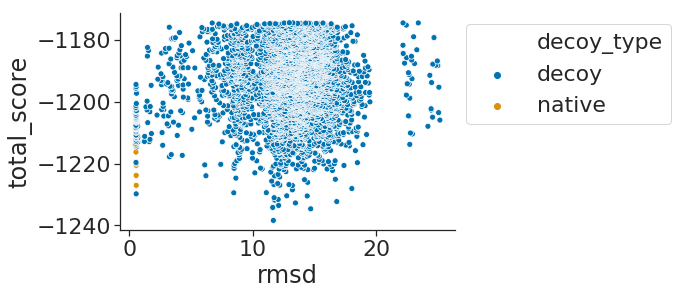

In [106]:
metric = 'total_score' # 'ddg_from_parts' # 
data = df[df[metric] < df[metric].quantile(0.8)]
sns.scatterplot(
    x='rmsd', y=metric, data=data,
    hue='decoy_type', hue_order=['decoy', 'native']
)
plt.legend(bbox_to_anchor=(1,1))
sns.despine()
plt.show()

In [107]:
df.sort_values('total_score', inplace=True)
df[['pdb', 'total_score']].head(n=10)

,pdb,total_score
2881,boinc_relax_HKH_2021_1BUH_run_2_complex.253_ch...,-1238.402
1565,boinc_relax_HKH_2021_1BUH_run_2_complex.237_ch...,-1234.652
76,boinc_relax_HKH_2021_1BUH_run_2_complex.309_ch...,-1234.208
1599,boinc_relax_HKH_2021_1BUH_run_2_complex.713_ch...,-1233.559
4637,boinc_relax_HKH_2021_1BUH_run_2_complex.125_ch...,-1232.752
1428,boinc_relax_HKH_2021_1BUH_run_2_complex.104_ch...,-1232.303
3666,boinc_relax_HKH_2021_1BUH_run_2_complex.319_ch...,-1231.830
2176,boinc_relax_HKH_2021_1BUH_run_2_complex.33_cha...,-1231.608
3205,boinc_relax_HKH_2021_1BUH_run_1_complex.309_ch...,-1231.051
4269,boinc_relax_HKH_2021_1BUH_run_1_complex.783_ch...,-1230.488


In [108]:
df.iloc[0]['pdb_path']

'/home/haddox/2021/ppi_benchmark/results/global_docks/1BUH/boinc_relax/digs_relax/beta_nov16/boinc_relax_HKH_2021_1BUH_run_2_complex.253_chain_B_13_0001.pdb'

Submit jobs to boinc

In [3]:
import subprocess

In [ ]:
# Define native
natives = [
    '1AHW', '1A2K', '1AKJ', '1AVX', '1BJ1',
    '1BVK', '1DFJ'
]
for native in natives:

# Get inputs
resultsdir = '/net/scratch/haddox/2021/ppi_benchmark/results'
boinc_relax_dir = f'{resultsdir}/global_docks/{native}/boinc_relax/'
flags_file = 'scripts/HKH_2021_boinc_ppi_relax_flags.txt'
flags_file_bn = os.path.basename(flags_file)
new_flags_file = os.path.join(boinc_relax_dir, flags_file_bn)
if not os.path.isfile(new_flags_file):
    print(new_flags_file)
    ! cp {flags_file} {new_flags_file}
pdbs = glob.glob(os.path.join(boinc_relax_dir, '*.pdb'))

# Cycle through PDBs and submit relax job for each one
print(native, len(pdbs))
for (i, pdb) in enumerate(pdbs):
    
    if i % 1000 == 0:
        print(i)
    
    # Make a submission file
    inputfile = os.path.basename(pdb)
    name = inputfile.replace('.pdb', '')
    resultfile = 'default.out.gz'
    boinc_submit_template = 'scripts/boinc_submit.txt'
    with open(boinc_submit_template) as f:
        protocol = f.read()
    protocol = protocol.replace('%%name%%', name)
    protocol = protocol.replace('%%description%%', name)
    protocol = protocol.replace('%%inputfile%%', inputfile)
    protocol = protocol.replace('%%resultfile%%', resultfile)
    boinc_submit_file = os.path.join(
        boinc_relax_dir,
        f'{name}.boinc_submit.txt'
    )
    if not os.path.isfile(boinc_submit_file):
        with open(boinc_submit_file, 'w') as f:
            f.write(protocol)
        
        # Submit job to boinc
        cmd = ' '.join([
            '/projects/boinc/bin/boinc_submit',
            os.path.basename(boinc_submit_file)
        ])
        boinc_job_outfile = boinc_submit_file.replace('.txt', '.out')
        process = subprocess.Popen(
            cmd,
            stdout=subprocess.PIPE,
            cwd=boinc_relax_dir,
            shell=True
        )
        (out, err) = process.communicate()
        with open(boinc_job_outfile, 'wb') as f:
            f.write(out)
        if err:
            print(err)
            raise ValueError('Error\n{0}'.format(err))

/net/scratch/haddox/2021/ppi_benchmark/results/global_docks/1AHW/boinc_relax/HKH_2021_boinc_ppi_relax_flags.txt
1AHW 5015
0
1000
2000


Copy results from boinc to `/home/` directory

In [3]:
resultsdir = '/net/scratch/haddox/2021/ppi_benchmark/results'

natives = sorted([
    d.split('/')[-1] for d in glob.glob(os.path.join(
        resultsdir, 'global_docks/*'
    )) if os.path.isdir(d)
])

n_natives_with_data = 0
natives_to_score = []
for native in natives:

    # Get batch numbers for each boinc job, and write a temp
    # file in case that helps preserve life of dir on /net/scratch/
    boinc_relax_dir = f'{resultsdir}/global_docks/{native}/boinc_relax/'
    temp_f = os.path.join(boinc_relax_dir, 'temp2.txt')
    with open(temp_f, 'w') as f:
        f.write('temp')
    boinc_submit_out_files = glob.glob(os.path.join(
        boinc_relax_dir,
        '*.boinc_submit.out'
    ))
    if len(boinc_submit_out_files) == 0:
        continue
    pattern = r'batch (?P<batch_id>\d+)'
    batch_ids = []
    for out_file in boinc_submit_out_files:
        with open(out_file) as f:
            fstr = f.read()
        match = re.search(pattern, fstr)
        if not match:
            continue
        batch_id = match.group('batch_id')
        batch_ids.append(batch_id)

    # For each batch id, check to see if there are output
    # files. If so, copy them over to the home directory
    home_boinc_results_dir = os.path.join(
        boinc_relax_dir.replace('/net/scratch/', '/home/'),
        'boinc_results/'
    )
    if not os.path.isdir(home_boinc_results_dir):
        os.makedirs(home_boinc_results_dir)
    n_outputs = 0
    all_score_files = []
    for batch_id in batch_ids:
        boinc_results_dir = f'/projects/boinc-results/{batch_id}'
        if os.path.isdir(boinc_results_dir):
            out_files = glob.glob(os.path.join(
                boinc_results_dir,
                '*.out'
            ))
            score_files = glob.glob(os.path.join(
                boinc_results_dir,
                '*.sc'
            ))
            all_score_files.extend(score_files)
            n_outputs += len(out_files)
            for f in out_files:
                new_file = os.path.join(
                    home_boinc_results_dir,
                    os.path.basename(f)
                )
                if not os.path.isfile(new_file):
                    shutil.copy(f, home_boinc_results_dir)
    print(native, n_outputs)
    n_natives_with_data += 1
    if n_outputs > 4800:
        natives_to_score.append(native)
    
print('N natives with data:', n_natives_with_data)
print('N natives to score:', len(natives_to_score))
natives_to_ignore = [
    '1IJK', # problem with RMSD calcuations? Even S_ have high RMSD
    #'1K74', # only three decoys from old benchmark results?
]
natives_to_score = sorted([
    native for native in natives_to_score
    if native not in natives_to_ignore
])

1A2K 4991
1AHW 4960
1AKJ 4986
1AVX 5000
1BJ1 4991
1BUH 4981
1BVK 4994
1DFJ 4980
1E6E 4970
1EAW 4975
1EWY 4991
1EZU 4993
1F34 4974
1F51 4988
1F6M 4988
1FC2 4973
1FFW 4984
1FQ1 4973
1FQJ 4997
1FSK 4978
1GLA 4962
1GPW 4986
1H1V 4964
1HCF 4998
1IB1 4999
1IJK 4996
1J2J 4983
1JMO 4972
1JZD 4985
1K74 5004
1KKL 4983
1M10 4987
1NCA 4960
1NSN 4989
1OPH 4968
1QA9 4973
1R6Q 4983
1RV6 4999
1SYX 4977
1US7 4980
1XU1 4969
1Y64 4956
1YVB 4965
1Z5Y 5002
1ZHI 4989
2A5T 4976
2ABZ 4979
2AJF 5931
2AYO 4997
2CFH 4993
2H7V 4972
2HRK 4989
2I9B 4989
2JEL 4983
2MTA 4977
2O3B 4978
2O8V 4993
2OOB 4975
2PCC 5001
2UUY 4994
2VIS 4980
3CPH 4980
3D5S 4989
7CEI 4978
9QFW 4999
N natives with data: 65
N natives to score: 65


In [4]:
native_no_filter_by_eye = [
    '1A2K',
    '1AKJ',
    '1E6E',
    '1EZU',
    '1F51',
    '1F6M',
    '1FQJ',
    '1FSK',
    '1GPW',
    '1IB1',
    '1JZD',
    '1NCA',
    '1M10',
    '1NSN',
    '1OPH',
    '1XU1',
    '2JEL',
    '2MTA',
    '2O3B',
    '2PCC',
    '2VIS', # antibody, flu HA complex
    '3CPH',
    '1RV6',
    '1BVK',
    '3D5S',
    '1EAW',
    '1R6Q',
    '1Z5Y',
    '1ZHI',
    '2HRK',
    '2UUY',
    '1FFW',
    '1J2J',
    '1QA9',
    '1SYX',
    '7CEI',
    '2OOB',
]

natives_filter_by_eye = [
    '1AHW',
    '1AVX',
    '1BJ1',
    '1BUH',
    '1DFJ',
    '1F34',
    '1FQ1',
    '1GLA',
    '1H1V',
    '1JMO',
    '1K74',
    '1KKL', # there's bridging of terminii, but xtal from PDB indicates that these terminii have long unresolved regions, so did not ignore
    '1US7',
    '1Y64',
    '2A5T',
    '2AJF', # SARS spike-receptor complex
    '2AYO',
    '2H7V',
    '2I9B',
    '9QFW',
    '1EWY',
    '1HCF', # there's bridging of terminii, but xtal from PDB indicates that these terminii have unresolved regions, so did not ignore
    '1YVB',
    '2ABZ',
    '2CFH',
    '2O8V',
    '1FC2',
]

natives_checked_by_eye = native_no_filter_by_eye + natives_filter_by_eye
print(len(natives_checked_by_eye))
for native in natives_to_score:
    if native not in natives_checked_by_eye:
        print(native)

64


Notes:
* structures with metals or cofactors near interface
    * 1E6E
    * 1DFJ metal at interface
    * 1F51 metal at interface
    * 1FQ1 has phospho sidechain at interface (deleted for test)
    * 2JEL SO4 at interface
    * 2MTA copper at interface
    * 2O3B Mg at interface
    * 2PCC heme kind of at interface; only one contact?
    * 1EWY a few molecules at/near interface
    * 2ABZ Zn at interface
* 9QFW not in PDB?

For each native, concatenate all silent files for that native into a single silent file. Then score all poses in that file. Also identify decoys that have chain breaks at the interface so that they can be removed from downstream steps.

In [5]:
import subprocess
import time

In [6]:
score_app_path = \
    '/home/haddox/Rosetta/main/source/bin/score.linuxgccrelease'
resultsdir = '/net/scratch/haddox/2021/ppi_benchmark/results'

for native in natives_to_score:
    
    if native not in natives_checked_by_eye: #['1A2K', '1AKJ', '1BUH', '1AHW', '1NCA']:
        continue
    print(native)
        
    # Get paths to directories of interest
    boinc_relax_dir = f'{resultsdir}/global_docks/{native}/boinc_relax/'
    boinc_results_dir = os.path.join(
        boinc_relax_dir,
        'boinc_results/'
    )
    if not os.path.isdir(boinc_results_dir):
        os.makedirs(boinc_results_dir)
    home_boinc_results_dir = \
        boinc_results_dir.replace('/net/scratch/', '/home/')

    # Concatenate all `*.out` silent files (execute in
    # directory with files)
    all_out_file = os.path.join(
        boinc_results_dir,
        f'{native}_all.out'
    )
    cat_cmd = 'find *.out -type f -exec cat {} \; > %s'%all_out_file
    if not os.path.isfile(all_out_file):
        subprocess.check_call(
            cat_cmd, shell=True,
            cwd=home_boinc_results_dir
        )

    # Run silentls and silentrename to make sure that all
    # indices are unique
    renamed_out_file = os.path.join(
        boinc_results_dir,
        f'{native}_renamed.out'
    )
    if not os.path.isfile(renamed_out_file):
        rename_cmd = ' '.join([
            f'/home/haddox/software/silent_tools/silentls {all_out_file} |',
            f'/home/haddox/software/silent_tools/silentrename {all_out_file} >', 
            f'{renamed_out_file}'
        ])
        out = subprocess.check_call(rename_cmd, shell=True)
        time.sleep(5)
        
    # Score 
    native_pdb = os.path.join(
        '/home/dimaio/optE2/dualoptE/decoys/docking/',
        f'{native}_bound_native.pdb'
    )
    extra_args = [
        '-in:file:silent_struct_type binary',
        '-beta_nov16_cart',
        '-crystal_refine true',
        f'-in:file:native {native_pdb}',
        '-evaluation:rmsd NATIVE 1 FULL'
    ]
    silent_file = renamed_out_file
    output_dir = boinc_results_dir
    scores_file_prefix = os.path.join(output_dir, 'score')
    scores_sbatch_file = scores_file_prefix + '.sbatch'
    if not os.path.isfile(scores_sbatch_file):
        design_utils.compute_score_using_rosettascripts(
            score_app_path=score_app_path,
            silent_file=silent_file,
            weights_file='beta_nov16_cart',
            extra_args=extra_args,
            output_dir=False,
            scores_file_prefix=scores_file_prefix,
            submit_sbatch_job=True,
            queue_type='short',
            memory='3g'
        )
        
    # Identify decoys with chain breaks at the interface
    input_silent_file = renamed_out_file
    ignore_res_file = f'data/chain_break_ignore_res_files/{native}.txt'
    output_prefix = home_boinc_results_dir
    output_silent_file = \
        input_silent_file.replace('.out', '_passing.out')
    cmd = ' '.join([
        'python',
        'scripts/find_decoys_with_chain_breaks_at_interface.py',
        f'--input_silent_file {input_silent_file}',
        f'--ignore_res_file {ignore_res_file}',
        f'--output_prefix {output_prefix}',
        f'--output_silent_file {output_silent_file}'
    ])
    sbatch_file_name = os.path.join(
        output_prefix,
        'find_decoys_with_chain_breaks_at_interface.sbatch'
    )
    if not os.path.isfile(sbatch_file_name):
        design_utils.WriteSbatchFile(
            sbatch_file_name=sbatch_file_name,
            command=cmd,
            queue_type='short',
            memory='2g',
        )
        ! sbatch {sbatch_file_name}

1A2K
1AHW
1AKJ
1AVX
1BJ1
1BUH
1BVK
1DFJ
1E6E
1EAW
1EWY
1EZU
1F34
1F51
1F6M
1FC2
1FFW
1FQ1
1FQJ
1FSK
1GLA
1GPW
1H1V
1HCF
1IB1
1J2J
1JMO
1JZD
1K74
1KKL
1M10
1NCA
1NSN
1OPH
1QA9
1R6Q
1RV6
1SYX
1US7
1XU1
1Y64
1YVB
1Z5Y
1ZHI
2A5T
2ABZ
2AJF
2AYO
2CFH
2H7V
2HRK
2I9B
2JEL
2MTA
2O3B
2O8V
2OOB
2PCC
2UUY
2VIS
3CPH
3D5S
7CEI
9QFW


Read in and plot scores from above

1A2K
N starting decoys 6800
N passing decoys 6800
native 14
decoy 6786
S mean rms: 0.6
S min and max: 0.537 0.701
native mean rms: 0.54
N w/ S in name 67
N w/ native in name 19
N w/ xtal in name 14
N < 1A 93


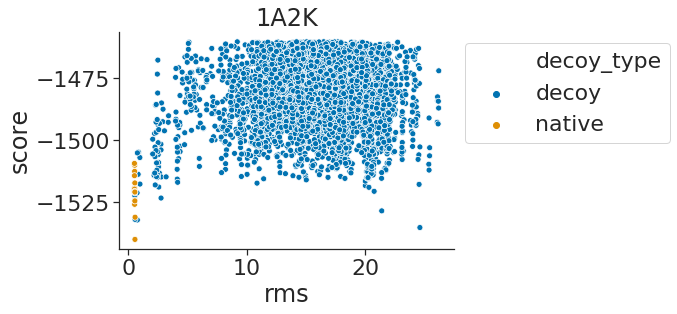

1AHW
N starting decoys 5286
N passing decoys 1601
native 10
decoy 1591
S mean rms: 0.93
S min and max: 0.848 1.06
native mean rms: 0.62
N w/ S in name 53
N w/ native in name 15
N w/ xtal in name 10
N < 1A 68


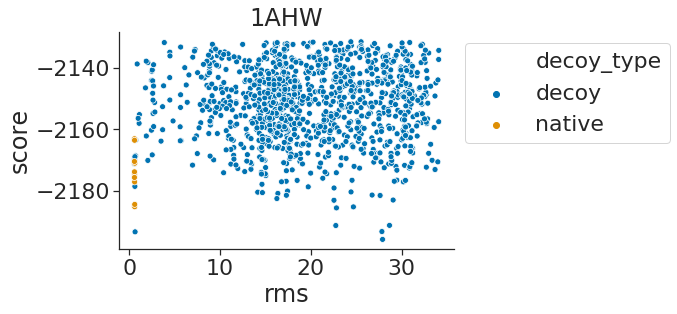

1AKJ
N starting decoys 5526
N passing decoys 5526
native 12
decoy 5514
S mean rms: 0.71
S min and max: 0.609 0.8320000000000001
native mean rms: 0.47
N w/ S in name 57
N w/ native in name 18
N w/ xtal in name 12
N < 1A 75


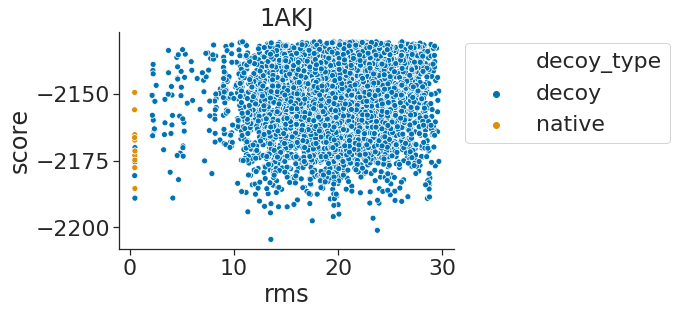

1AVX
N starting decoys 7434
N passing decoys 3558
native 18
decoy 3540
S mean rms: 1.31
S min and max: 0.9329999999999999 1.452
native mean rms: 0.51
N w/ S in name 40
N w/ native in name 20
N w/ xtal in name 18
N < 1A 24


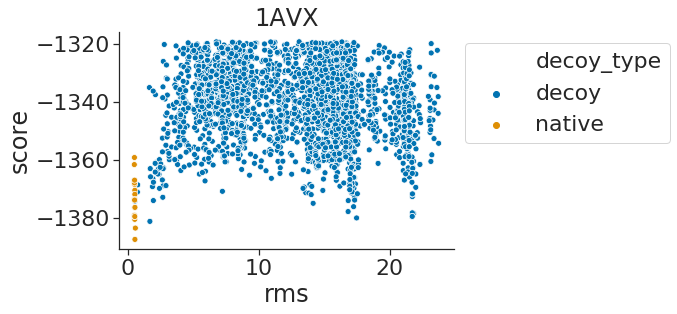

1BJ1
N starting decoys 5738
N passing decoys 3814
native 12
decoy 3802
S mean rms: 0.52
S min and max: 0.48200000000000004 0.58
native mean rms: 0.49
N w/ S in name 63
N w/ native in name 17
N w/ xtal in name 12
N < 1A 84


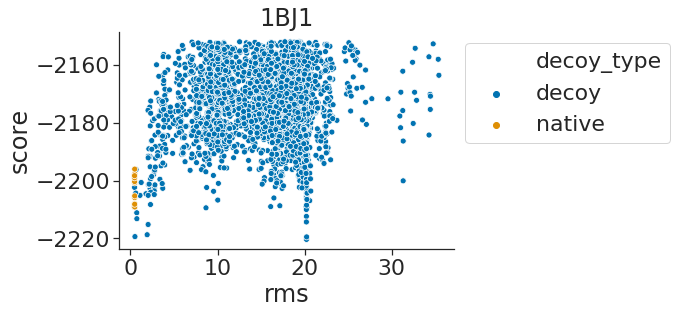

1BUH
N starting decoys 7783
N passing decoys 3767
native 20
decoy 3747
S mean rms: 0.54
S min and max: 0.502 0.634
native mean rms: 0.53
N w/ S in name 80
N w/ native in name 25
N w/ xtal in name 20
N < 1A 112


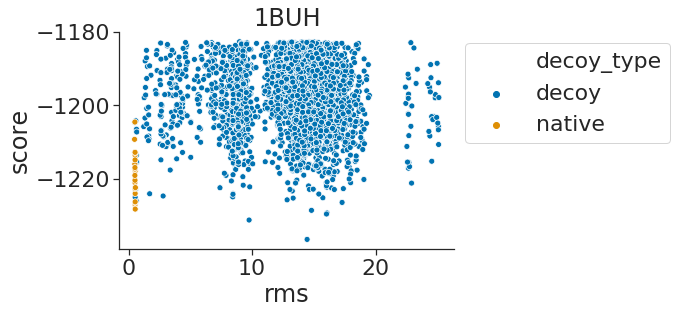

1BVK
N starting decoys 7734
N passing decoys 7734
native 17
decoy 7717
S mean rms: 0.66
S min and max: 0.578 0.773
native mean rms: 0.54
N w/ S in name 74
N w/ native in name 23
N w/ xtal in name 17
N < 1A 101


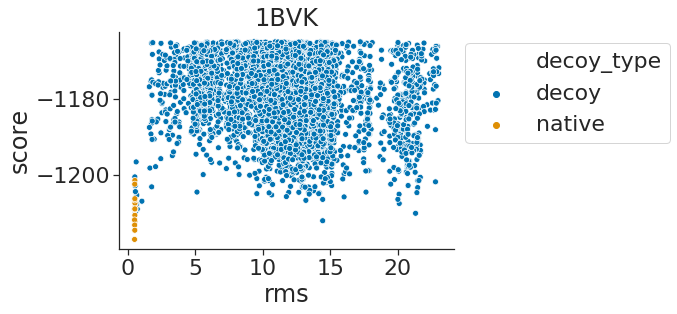

1DFJ
N starting decoys 6049
N passing decoys 6040
native 12
decoy 6028
S mean rms: 0.66
S min and max: 0.586 0.727
native mean rms: 0.55
N w/ S in name 60
N w/ native in name 18
N w/ xtal in name 12
N < 1A 82


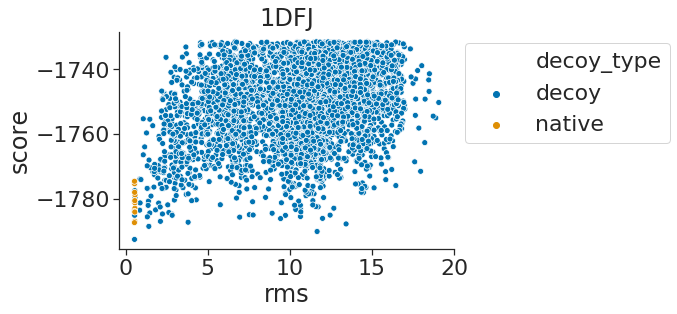

1E6E
N starting decoys 6625
N passing decoys 6625
native 15
decoy 6610
S mean rms: 0.58
S min and max: 0.51 0.721
native mean rms: 0.52
N w/ S in name 68
N w/ native in name 21
N w/ xtal in name 15
N < 1A 95


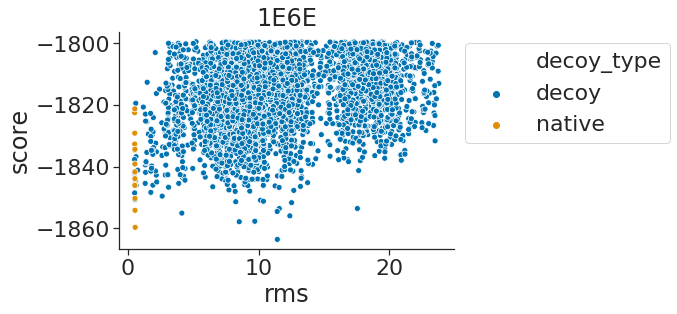

1EAW
N starting decoys 8760
N passing decoys 8760
native 12
decoy 8748
S mean rms: 0.56
S min and max: 0.45899999999999996 0.621
native mean rms: 0.44
N w/ S in name 106
N w/ native in name 18
N w/ xtal in name 12
N < 1A 153


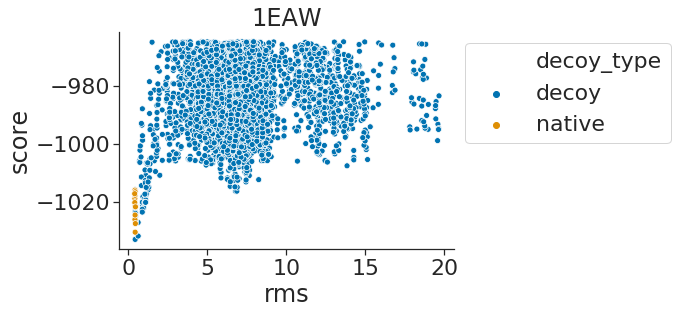

1EWY
N starting decoys 7671
N passing decoys 7671
native 16
decoy 7655
S mean rms: 0.96
S min and max: 0.8240000000000001 1.6130000000000002
native mean rms: 0.68
N w/ S in name 81
N w/ native in name 21
N w/ xtal in name 16
N < 1A 90


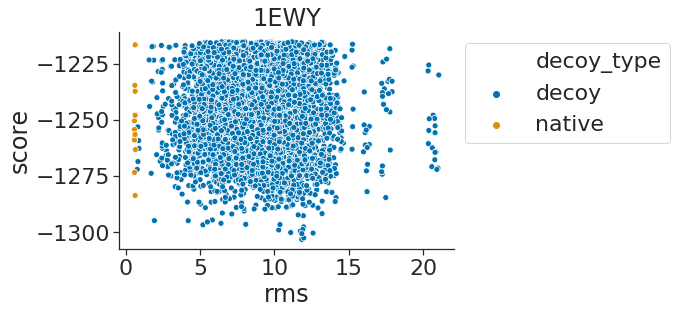

1EZU
N starting decoys 6790
N passing decoys 6790
native 15
decoy 6775
S mean rms: 0.5
S min and max: 0.469 0.578
native mean rms: 0.49
N w/ S in name 70
N w/ native in name 21
N w/ xtal in name 15
N < 1A 98


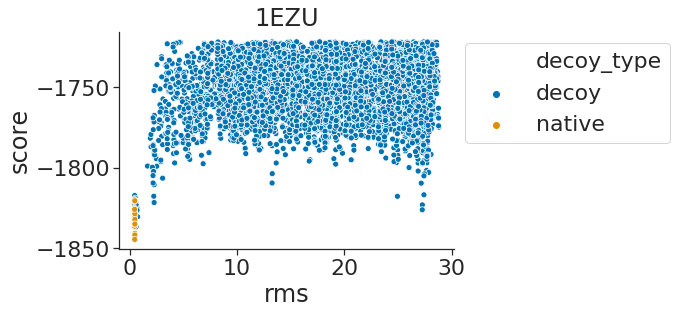

1F34
N starting decoys 6817
N passing decoys 2604
native 14
decoy 2590
S mean rms: nan
S min and max: nan nan
native mean rms: 0.58
N w/ S in name 0
N w/ native in name 14
N w/ xtal in name 14
N < 1A 14


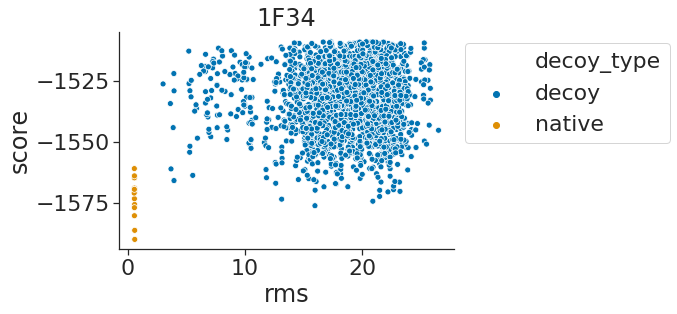

1F51
N starting decoys 6887
N passing decoys 6887
native 18
decoy 6869
S mean rms: 0.59
S min and max: 0.536 0.636
native mean rms: 0.55
N w/ S in name 66
N w/ native in name 23
N w/ xtal in name 18
N < 1A 96


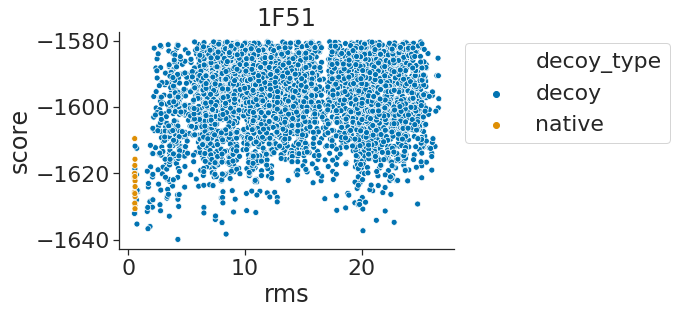

1F6M
N starting decoys 7999
N passing decoys 7999
native 15
decoy 7984
S mean rms: 0.58
S min and max: 0.541 0.67
native mean rms: 0.54
N w/ S in name 84
N w/ native in name 22
N w/ xtal in name 15
N < 1A 111


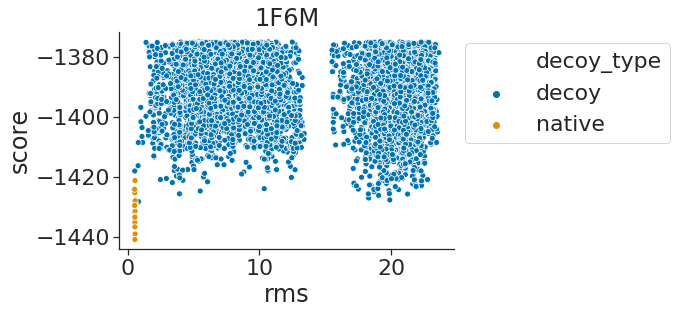

1FC2
N starting decoys 9794
N passing decoys 2632
native 15
decoy 2617
S mean rms: 10.33
S min and max: 9.895 10.755
native mean rms: 0.68
N w/ S in name 103
N w/ native in name 25
N w/ xtal in name 15
N < 1A 25


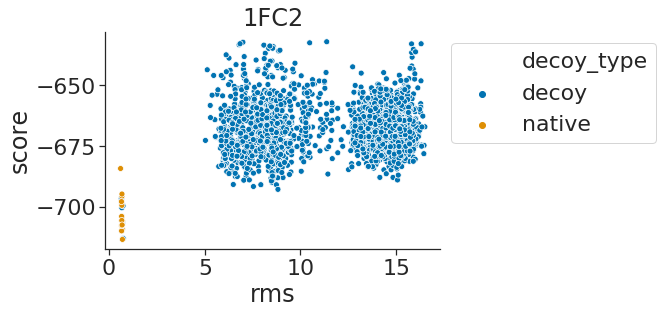

1FFW
N starting decoys 12837
N passing decoys 12837
native 35
decoy 12802
S mean rms: 0.66
S min and max: 0.529 0.857
native mean rms: 0.57
N w/ S in name 118
N w/ native in name 50
N w/ xtal in name 35
N < 1A 180


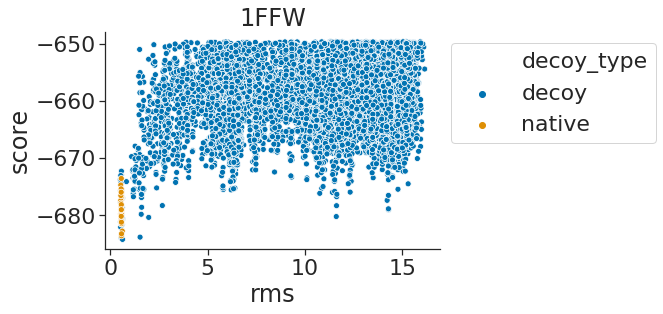

1FQ1
N starting decoys 6844
N passing decoys 3411
native 19
decoy 3392
S mean rms: nan
S min and max: nan nan
native mean rms: 0.72
N w/ S in name 0
N w/ native in name 19
N w/ xtal in name 19
N < 1A 19


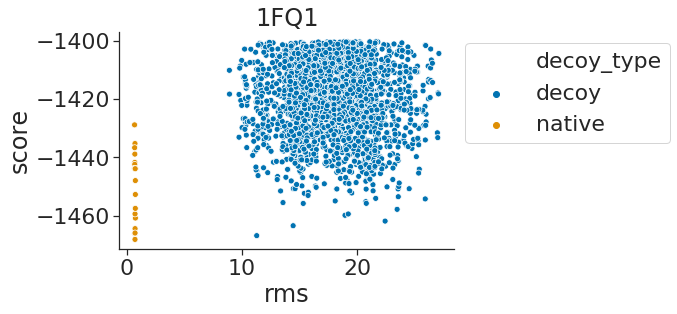

1FQJ
N starting decoys 6910
N passing decoys 6910
native 13
decoy 6897
S mean rms: 0.46
S min and max: 0.423 0.551
native mean rms: 0.42
N w/ S in name 76
N w/ native in name 22
N w/ xtal in name 13
N < 1A 98


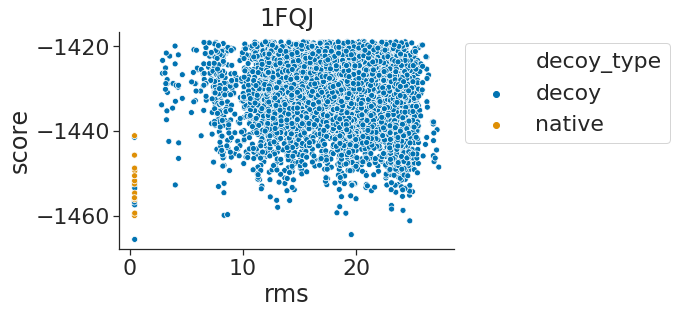

1FSK
N starting decoys 5874
N passing decoys 5874
native 13
decoy 5861
S mean rms: 1.28
S min and max: 1.0 1.528
native mean rms: 0.56
N w/ S in name 56
N w/ native in name 19
N w/ xtal in name 13
N < 1A 26


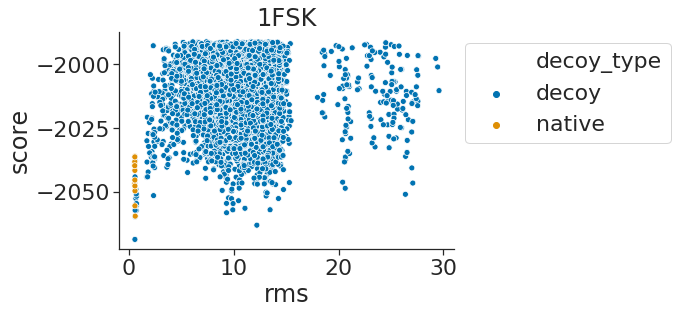

1GLA
N starting decoys 5654
N passing decoys 3910
native 14
decoy 3896
S mean rms: 0.6
S min and max: 0.528 0.664
native mean rms: 0.53
N w/ S in name 56
N w/ native in name 19
N w/ xtal in name 14
N < 1A 79


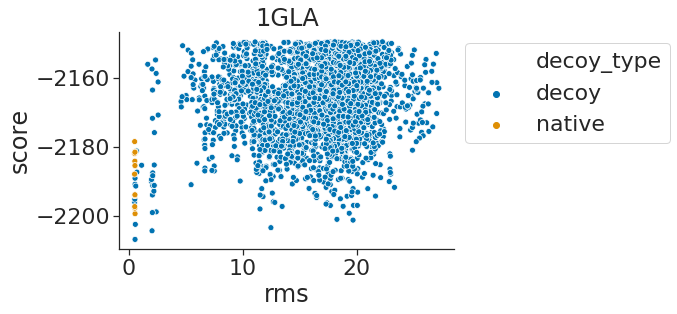

1GPW
N starting decoys 6826
N passing decoys 6826
native 17
decoy 6809
S mean rms: 0.53
S min and max: 0.49 0.5920000000000001
native mean rms: 0.51
N w/ S in name 71
N w/ native in name 21
N w/ xtal in name 17
N < 1A 101


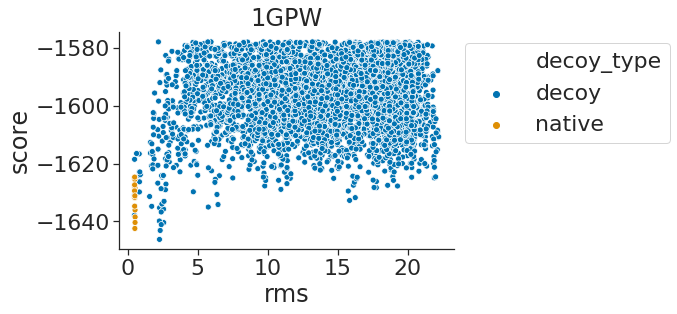

1H1V
N starting decoys 5247
N passing decoys 3338
native 11
decoy 3327
S mean rms: 1.0
S min and max: 0.912 1.119
native mean rms: 0.61
N w/ S in name 54
N w/ native in name 16
N w/ xtal in name 11
N < 1A 49


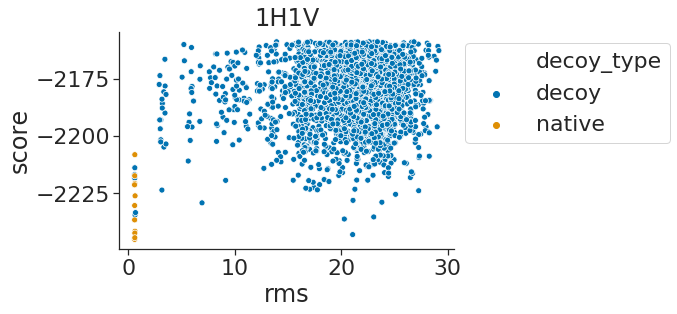

1HCF
N starting decoys 8371
N passing decoys 4602
native 11
decoy 4591
S mean rms: 0.65
S min and max: 0.59 0.745
native mean rms: 0.62
N w/ S in name 77
N w/ native in name 19
N w/ xtal in name 11
N < 1A 96


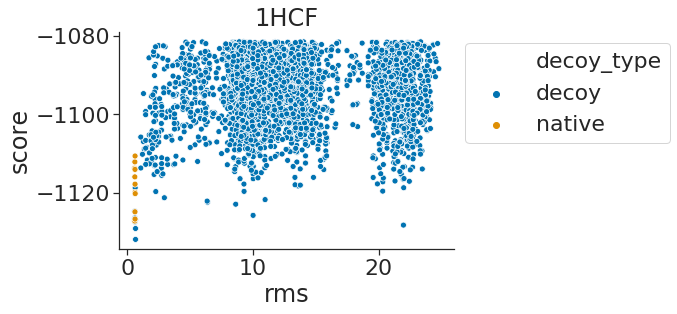

1IB1
N starting decoys 5790
N passing decoys 2886
native 11
decoy 2875
S mean rms: nan
S min and max: nan nan
native mean rms: 0.54
N w/ S in name 0
N w/ native in name 11
N w/ xtal in name 11
N < 1A 11


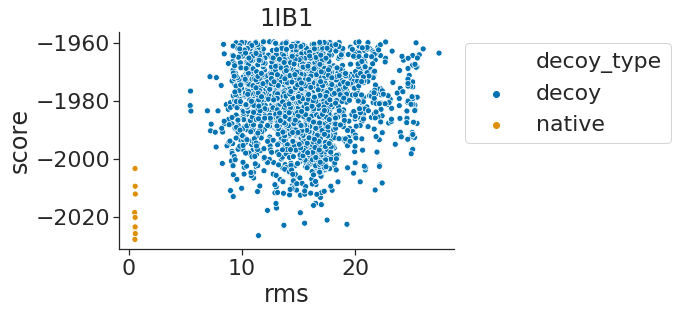

1J2J
N starting decoys 10776
N passing decoys 10776
native 23
decoy 10753
S mean rms: 0.57
S min and max: 0.501 0.628
native mean rms: 0.56
N w/ S in name 103
N w/ native in name 36
N w/ xtal in name 23
N < 1A 154


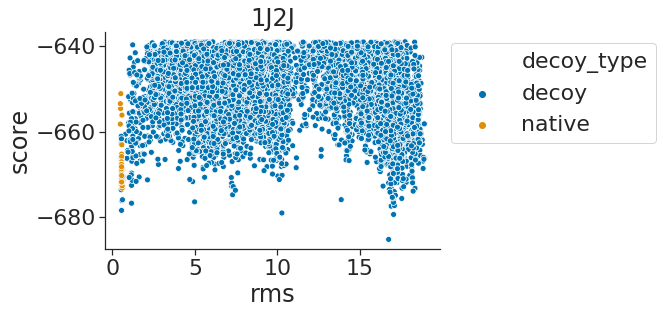

1JZD
N starting decoys 6255
N passing decoys 6255
native 12
decoy 6243
S mean rms: 0.58
S min and max: 0.544 0.622
native mean rms: 0.52
N w/ S in name 63
N w/ native in name 17
N w/ xtal in name 12
N < 1A 85


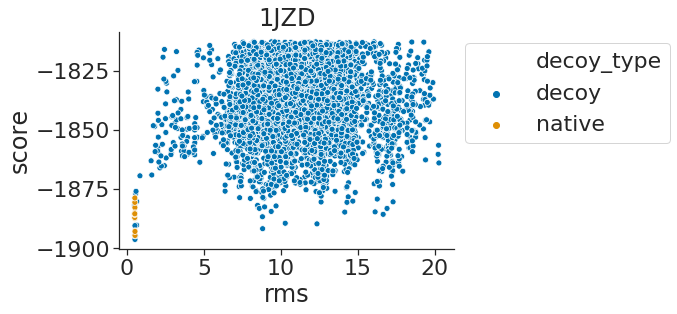

1K74
N starting decoys 6482
N passing decoys 6478
native 13
decoy 6465
S mean rms: 19.97
S min and max: 19.165 20.843000000000004
native mean rms: 0.62
N w/ S in name 67
N w/ native in name 17
N w/ xtal in name 13
N < 1A 17


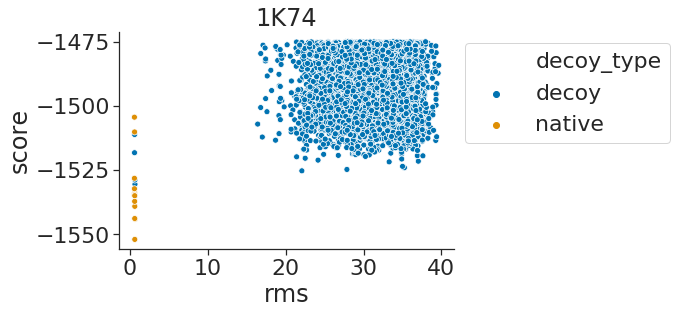

1KKL
N starting decoys 6747
N passing decoys 5581
native 13
decoy 5568
S mean rms: 0.73
S min and max: 0.648 0.778
native mean rms: 0.54
N w/ S in name 4
N w/ native in name 13
N w/ xtal in name 13
N < 1A 18


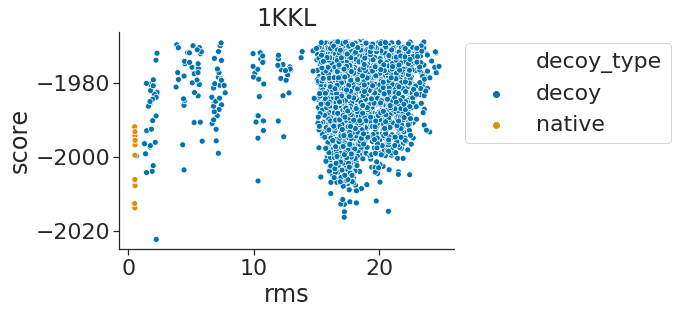

1M10
N starting decoys 7004
N passing decoys 7004
native 14
decoy 6990
S mean rms: 0.69
S min and max: 0.622 0.778
native mean rms: 0.58
N w/ S in name 63
N w/ native in name 21
N w/ xtal in name 14
N < 1A 91


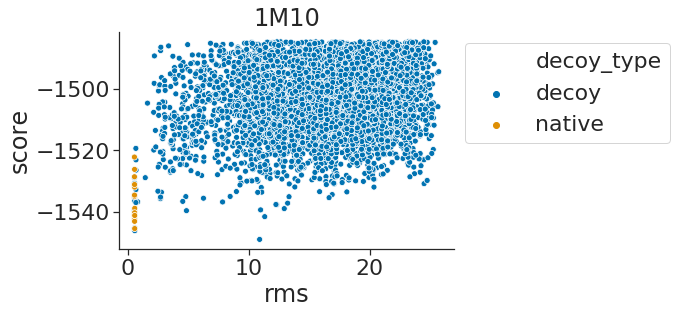

1NCA
N starting decoys 4849
N passing decoys 4849
native 10
decoy 4839
S mean rms: 0.71
S min and max: 0.591 0.794
native mean rms: 0.56
N w/ S in name 48
N w/ native in name 14
N w/ xtal in name 10
N < 1A 66


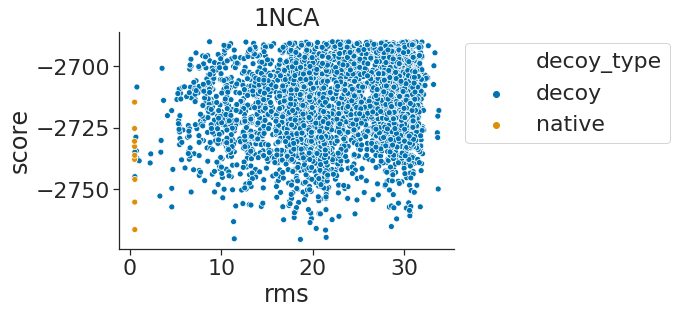

1NSN
N starting decoys 5721
N passing decoys 5721
native 11
decoy 5710
S mean rms: 1.0
S min and max: 0.893 1.31
native mean rms: 0.71
N w/ S in name 54
N w/ native in name 17
N w/ xtal in name 11
N < 1A 51


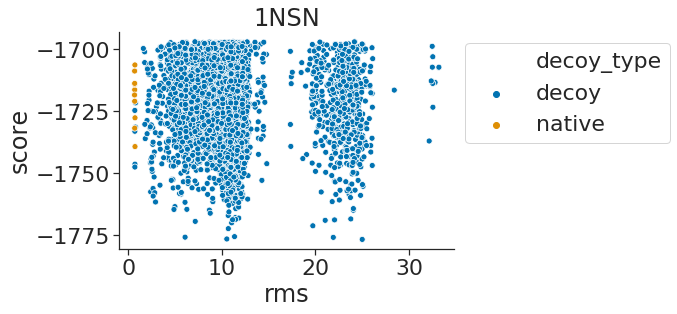

1OPH
N starting decoys 5563
N passing decoys 5563
native 10
decoy 5553
S mean rms: 0.81
S min and max: 0.675 0.941
native mean rms: 0.5
N w/ S in name 60
N w/ native in name 15
N w/ xtal in name 10
N < 1A 75


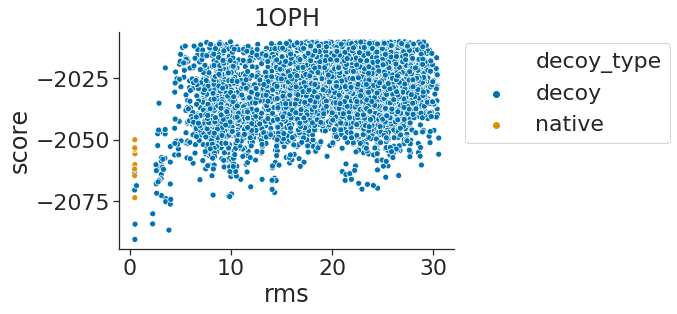

1QA9
N starting decoys 10648
N passing decoys 10648
native 21
decoy 10627
S mean rms: 1.09
S min and max: 0.792 1.4409999999999998
native mean rms: 0.7
N w/ S in name 109
N w/ native in name 33
N w/ xtal in name 21
N < 1A 55


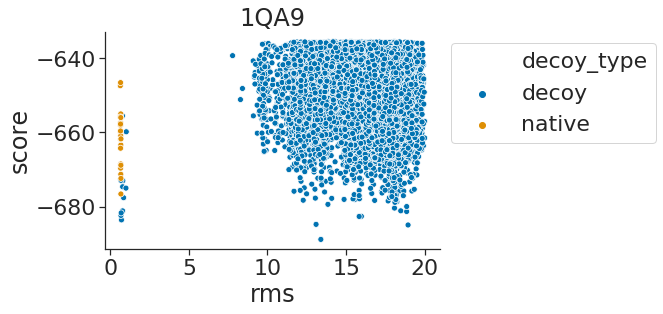

1R6Q
N starting decoys 10417
N passing decoys 10407
native 30
decoy 10377
S mean rms: 0.49
S min and max: 0.442 0.551
native mean rms: 0.46
N w/ S in name 101
N w/ native in name 37
N w/ xtal in name 30
N < 1A 151


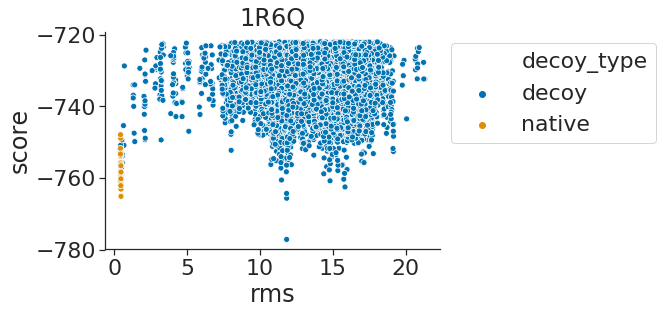

1RV6
N starting decoys 9524
N passing decoys 9524
native 13
decoy 9511
S mean rms: 0.58
S min and max: 0.523 0.723
native mean rms: 0.55
N w/ S in name 107
N w/ native in name 23
N w/ xtal in name 13
N < 1A 137


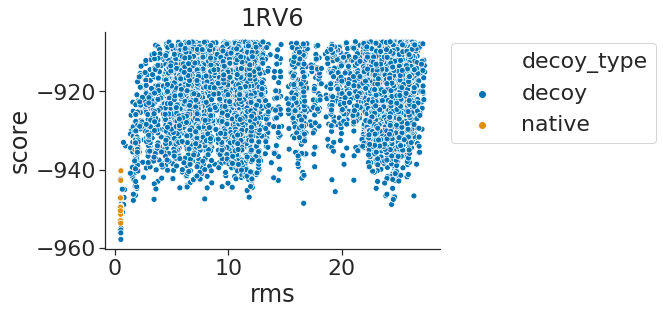

1SYX
N starting decoys 11097
N passing decoys 11097
native 16
decoy 11081
S mean rms: 0.57
S min and max: 0.523 0.675
native mean rms: 0.54
N w/ S in name 103
N w/ native in name 26
N w/ xtal in name 16
N < 1A 129


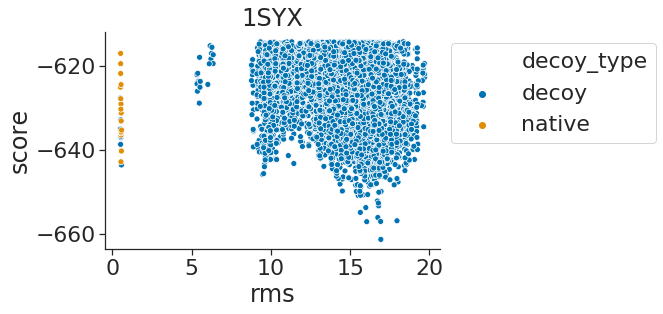

1US7
N starting decoys 7820
N passing decoys 3030
native 11
decoy 3019
S mean rms: 0.57
S min and max: 0.49700000000000005 0.665
native mean rms: 0.52
N w/ S in name 76
N w/ native in name 21
N w/ xtal in name 11
N < 1A 97


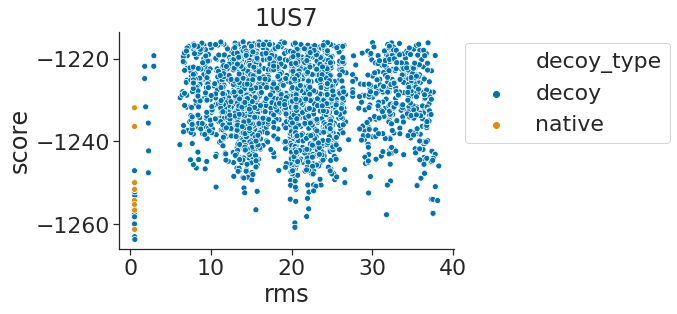

1XU1
N starting decoys 6560
N passing decoys 6560
native 14
decoy 6546
S mean rms: 0.69
S min and max: 0.614 0.804
native mean rms: 0.44
N w/ S in name 63
N w/ native in name 21
N w/ xtal in name 14
N < 1A 122


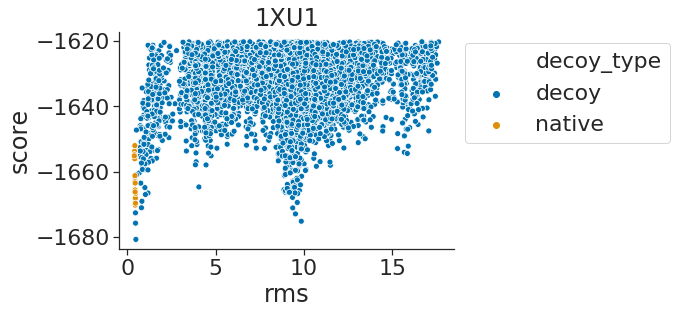

1Y64
N starting decoys 5096
N passing decoys 3764
native 10
decoy 3754
S mean rms: 1.52
S min and max: 1.219 1.8519999999999999
native mean rms: 0.76
N w/ S in name 50
N w/ native in name 15
N w/ xtal in name 10
N < 1A 15


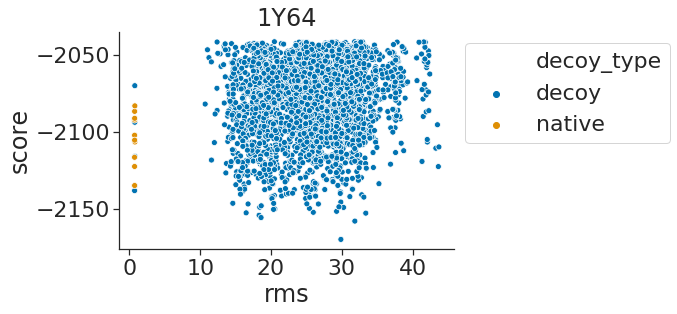

1YVB
N starting decoys 8157
N passing decoys 2863
native 17
decoy 2846
S mean rms: nan
S min and max: nan nan
native mean rms: 0.58
N w/ S in name 0
N w/ native in name 17
N w/ xtal in name 17
N < 1A 17


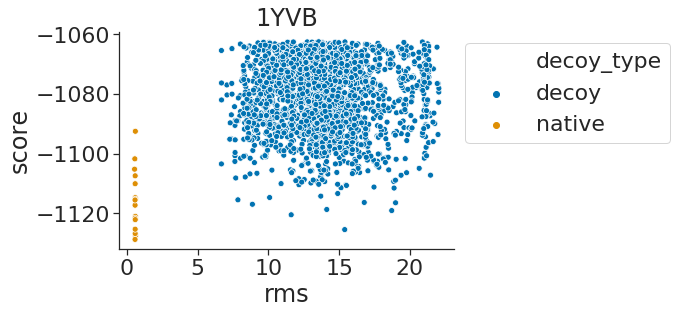

1Z5Y
N starting decoys 9527
N passing decoys 9520
native 16
decoy 9504
S mean rms: 0.56
S min and max: 0.499 0.621
native mean rms: 0.52
N w/ S in name 97
N w/ native in name 25
N w/ xtal in name 16
N < 1A 128


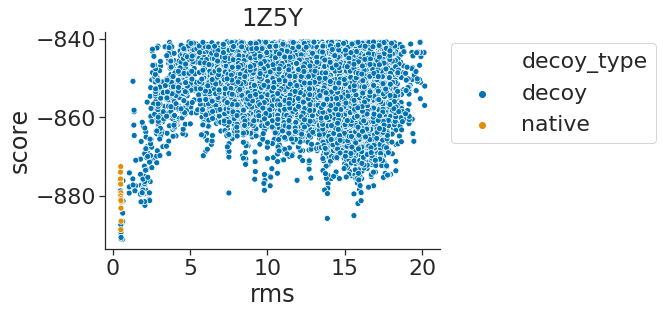

1ZHI
N starting decoys 8953
N passing decoys 8516
native 16
decoy 8500
S mean rms: 0.63
S min and max: 0.5760000000000001 0.747
native mean rms: 0.61
N w/ S in name 96
N w/ native in name 23
N w/ xtal in name 16
N < 1A 124


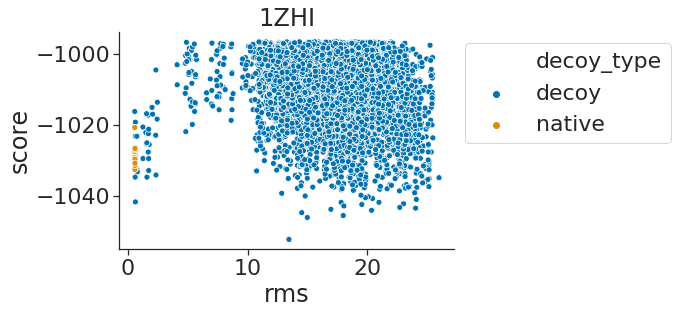

2A5T
N starting decoys 5934
N passing decoys 2760
native 10
decoy 2750
S mean rms: nan
S min and max: nan nan
native mean rms: 0.48
N w/ S in name 0
N w/ native in name 10
N w/ xtal in name 10
N < 1A 10


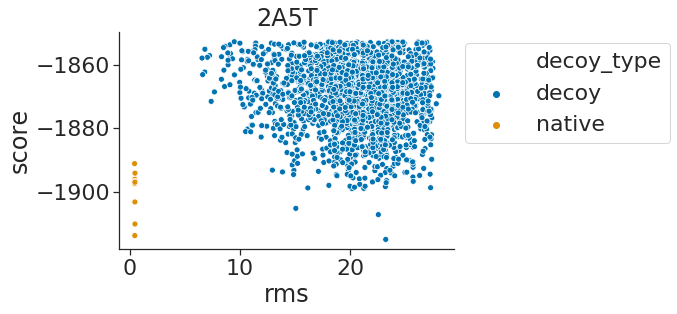

2ABZ
N starting decoys 7146
N passing decoys 4919
native 14
decoy 4905
S mean rms: 0.46
S min and max: 0.428 0.52
native mean rms: 0.44
N w/ S in name 77
N w/ native in name 21
N w/ xtal in name 14
N < 1A 116


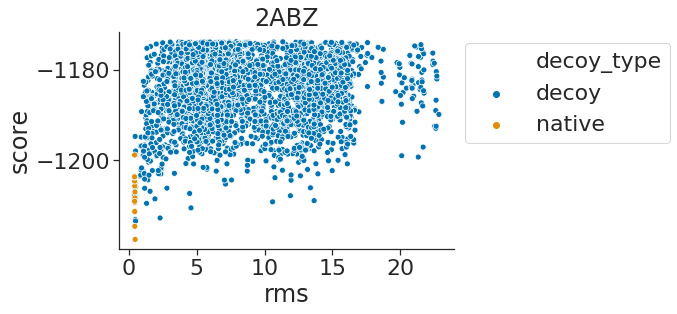

2AJF
N starting decoys 5776
N passing decoys 5678
native 9
decoy 5669
S mean rms: 0.9
S min and max: 0.616 1.597
native mean rms: 0.63
N w/ S in name 49
N w/ native in name 14
N w/ xtal in name 9
N < 1A 53


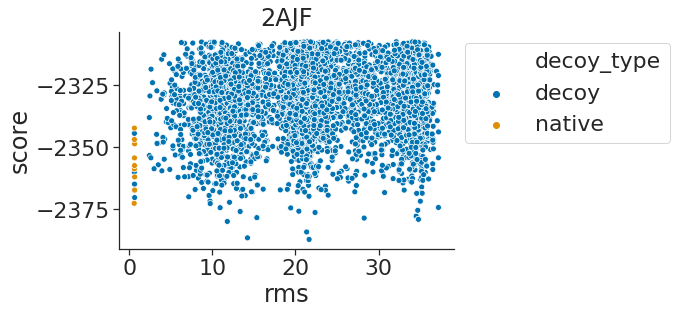

2AYO
N starting decoys 7185
N passing decoys 6616
native 12
decoy 6604
S mean rms: 0.92
S min and max: 0.742 1.104
native mean rms: 0.77
N w/ S in name 72
N w/ native in name 19
N w/ xtal in name 12
N < 1A 75


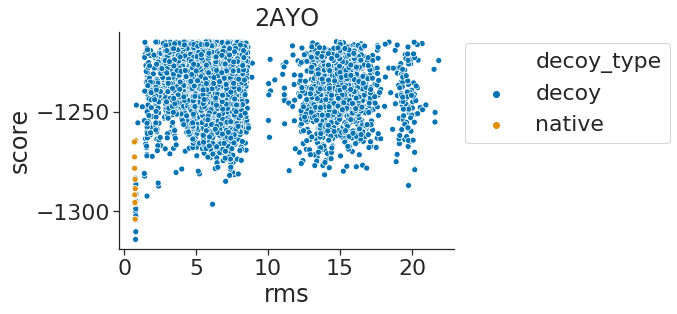

2CFH
N starting decoys 8829
N passing decoys 3823
native 22
decoy 3801
S mean rms: 0.58
S min and max: 0.51 0.7190000000000001
native mean rms: 0.56
N w/ S in name 80
N w/ native in name 34
N w/ xtal in name 22
N < 1A 124


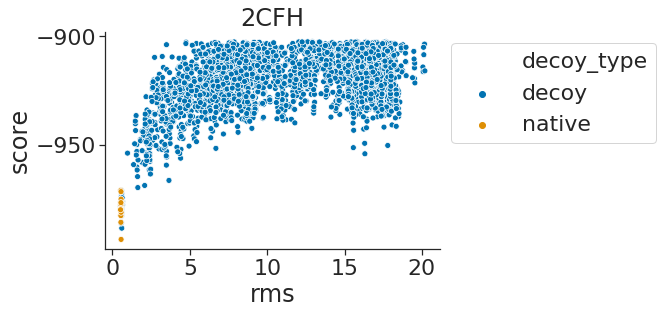

2HRK
N starting decoys 9419
N passing decoys 9419
native 19
decoy 9400
S mean rms: 18.29
S min and max: 17.451 19.17
native mean rms: 0.48
N w/ S in name 85
N w/ native in name 25
N w/ xtal in name 19
N < 1A 25


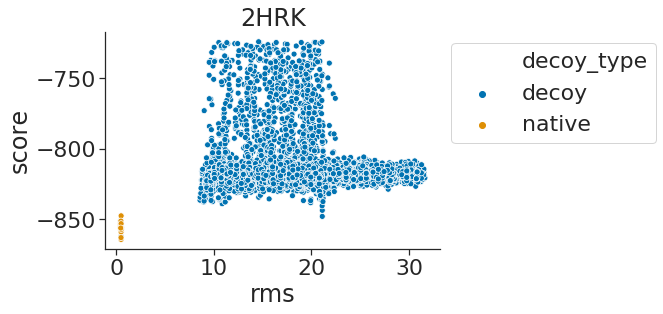

2I9B
N starting decoys 7493
N passing decoys 2569
native 20
decoy 2549
S mean rms: 0.6
S min and max: 0.551 0.638
native mean rms: 0.55
N w/ S in name 56
N w/ native in name 23
N w/ xtal in name 20
N < 1A 79


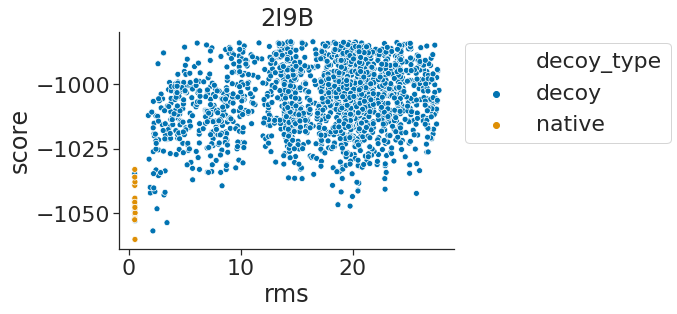

2JEL
N starting decoys 6305
N passing decoys 6305
native 10
decoy 6295
S mean rms: 0.58
S min and max: 0.544 0.6459999999999999
native mean rms: 0.55
N w/ S in name 62
N w/ native in name 15
N w/ xtal in name 10
N < 1A 83


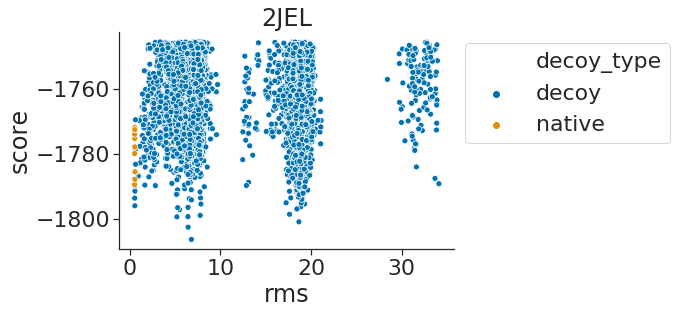

2MTA
N starting decoys 5801
N passing decoys 5801
native 11
decoy 5790
S mean rms: 0.6
S min and max: 0.556 0.951
native mean rms: 0.59
N w/ S in name 60
N w/ native in name 18
N w/ xtal in name 11
N < 1A 85


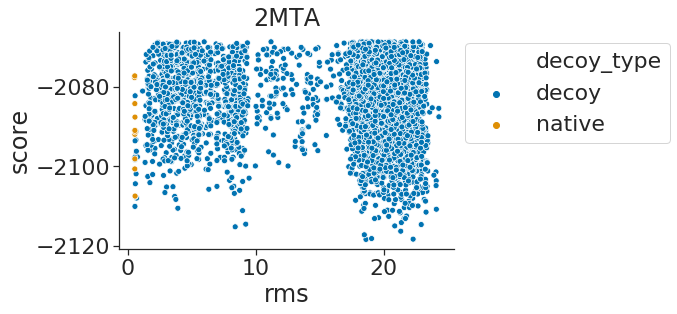

2O3B
N starting decoys 7964
N passing decoys 7964
native 18
decoy 7946
S mean rms: 0.61
S min and max: 0.489 0.748
native mean rms: 0.5
N w/ S in name 86
N w/ native in name 30
N w/ xtal in name 18
N < 1A 122


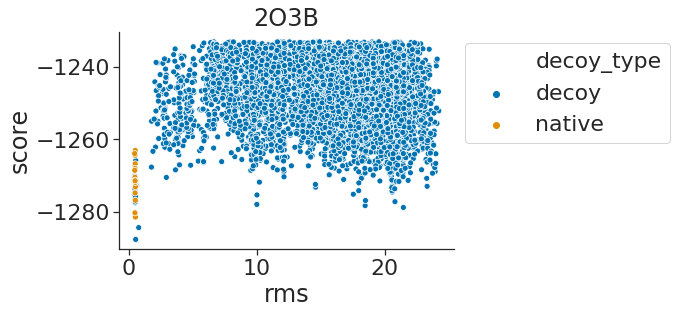

2O8V
N starting decoys 8478
N passing decoys 1004
native 15
decoy 989
S mean rms: nan
S min and max: nan nan
native mean rms: 0.63
N w/ S in name 0
N w/ native in name 15
N w/ xtal in name 15
N < 1A 15


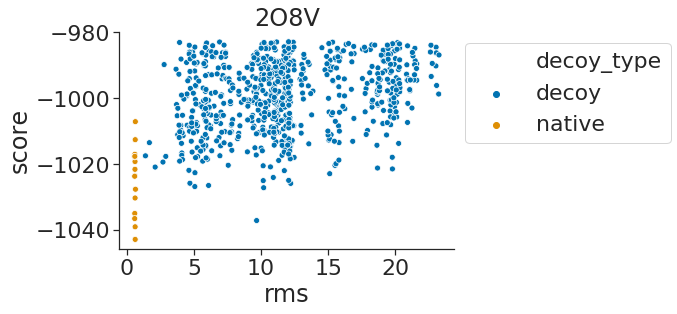

2OOB
N starting decoys 17367
N passing decoys 17367
native 39
decoy 17328
S mean rms: 0.4
S min and max: 0.369 0.45899999999999996
native mean rms: 0.4
N w/ S in name 166
N w/ native in name 50
N w/ xtal in name 39
N < 1A 216


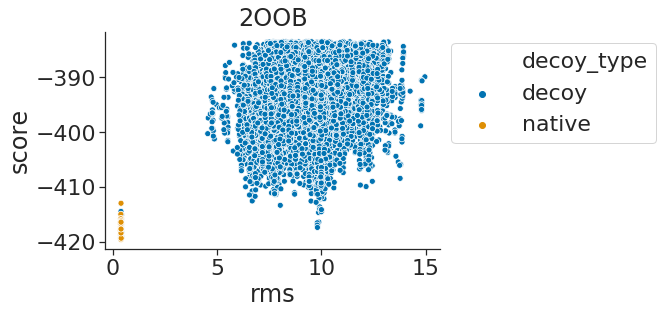

2PCC
N starting decoys 6631
N passing decoys 6631
native 15
decoy 6616
S mean rms: 0.65
S min and max: 0.557 0.8270000000000001
native mean rms: 0.55
N w/ S in name 65
N w/ native in name 25
N w/ xtal in name 15
N < 1A 90


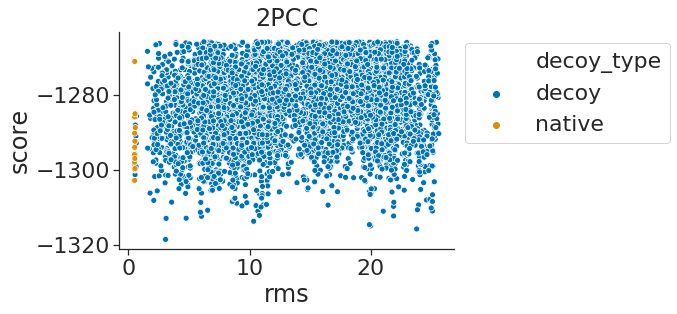

2UUY
N starting decoys 9402
N passing decoys 9402
native 16
decoy 9386
S mean rms: 0.5
S min and max: 0.473 0.545
native mean rms: 0.47
N w/ S in name 98
N w/ native in name 23
N w/ xtal in name 16
N < 1A 127


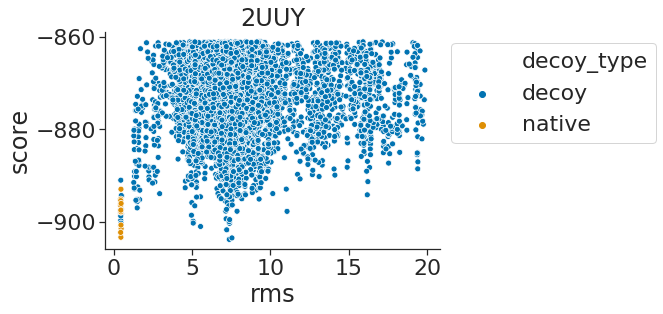

2VIS
N starting decoys 5213
N passing decoys 5213
native 11
decoy 5202
S mean rms: 0.55
S min and max: 0.51 0.6
native mean rms: 0.53
N w/ S in name 51
N w/ native in name 15
N w/ xtal in name 11
N < 1A 66


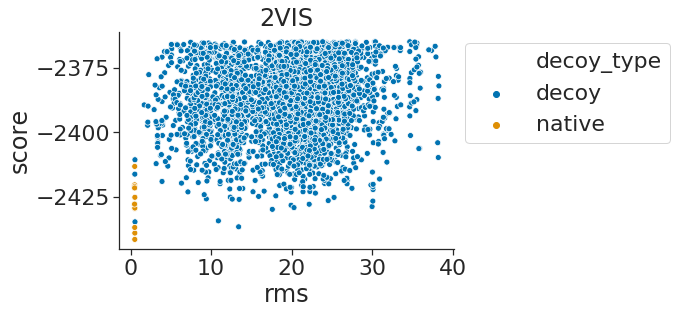

3CPH
N starting decoys 5551
N passing decoys 5551
native 11
decoy 5540
S mean rms: 0.56
S min and max: 0.494 0.674
native mean rms: 0.51
N w/ S in name 58
N w/ native in name 17
N w/ xtal in name 11
N < 1A 81


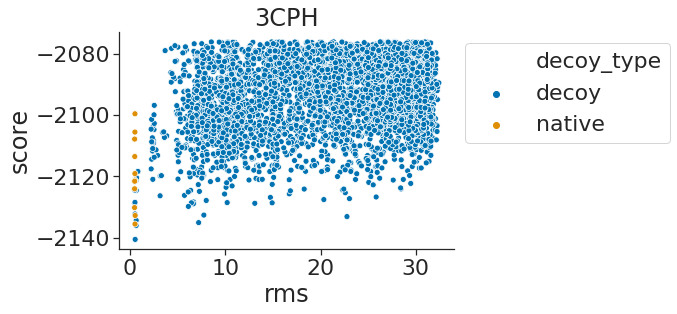

3D5S
N starting decoys 7828
N passing decoys 7828
native 18
decoy 7810
S mean rms: 0.43
S min and max: 0.386 0.47
native mean rms: 0.42
N w/ S in name 83
N w/ native in name 28
N w/ xtal in name 18
N < 1A 118


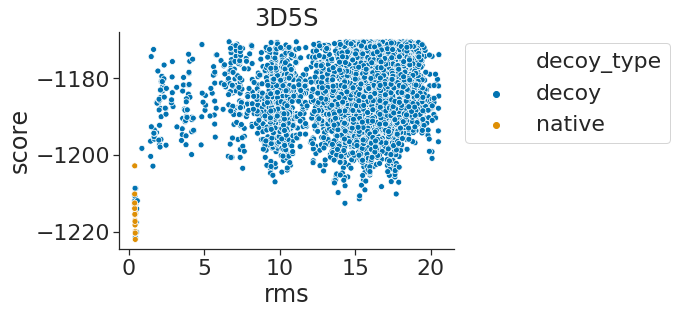

7CEI
N starting decoys 10714
N passing decoys 10713
native 24
decoy 10689
S mean rms: 0.65
S min and max: 0.561 0.8370000000000001
native mean rms: 0.58
N w/ S in name 102
N w/ native in name 36
N w/ xtal in name 24
N < 1A 152


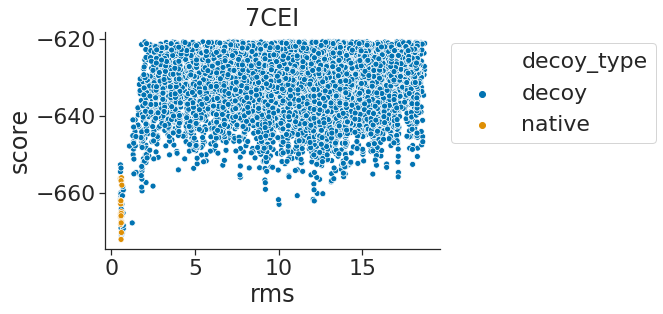

9QFW
N starting decoys 6890
N passing decoys 2620
native 14
decoy 2606
S mean rms: 2.02
S min and max: 1.723 2.1630000000000003
native mean rms: 0.81
N w/ S in name 72
N w/ native in name 19
N w/ xtal in name 14
N < 1A 20


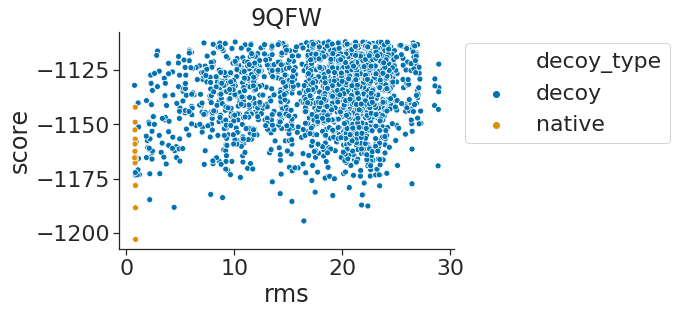

In [7]:
all_scores_files = []
dfs = []
dont_include_S = True
for (i, native) in enumerate(natives_to_score):
    
    # Read in scores
    boinc_results_dir = os.path.join(
        f'{resultsdir}/global_docks/{native}/boinc_relax/',
        'boinc_results/'
    )
    score_file = os.path.join(
        boinc_results_dir,
        'score.sc'
    )
    if not os.path.isfile(score_file):
        continue
    df = pandas.read_csv(
        score_file, sep='\s+', error_bad_lines=False,
        warn_bad_lines=False
    )
    df['native'] = native
    df.dropna(subset=['description'], inplace=True)
    df['description'] = df['description'].apply(
        lambda x: x[:-5]
    )
    df['pdb'] = df['description'].apply(os.path.basename)
    df['decoy_type'] = df['pdb'].apply(
        lambda x: 'native' if 'xtal' in x else 'decoy'
    )
    n_starting_decoys = len(df)
    
    # Read in passing tags and subset data to only
    # include passing decoys
    home_boinc_results_dir = \
        boinc_results_dir.replace('/net/scratch/', '/home/')
    passing_tags_file = os.path.join(
        home_boinc_results_dir,
        'passing_tags.txt'
    )
    if not os.path.isfile(passing_tags_file):
        continue
    with open(passing_tags_file) as f:
        passing_tags = [line.strip() for line in f.readlines()]
    df = df[
        ((df['description'].isin(passing_tags)) |
        (df['pdb'].str.contains('xtal'))) &
        (df['pdb'].str.contains(native))
    ]
    
    # Filter out a few problematic decoys
    df = df[
        ~(df['pdb'].str.contains(
            'HKH_2021_1JMO_run_1_complex.1940_chain_B'
        )) &
        ~(df['pdb'].str.contains(
            'HKH_2021_1JMO_run_2_complex.1940_chain_B'
        ))
    ]
    
    # Report summary stats
    print(native)
    print('N starting decoys', n_starting_decoys)
    print('N passing decoys', len(df))
    for decoy_type in ['native', 'decoy']:
        print(decoy_type, sum(df['decoy_type'] == decoy_type))
    s_data = df[df['pdb'].str.contains('_S_')].copy()
    n_data = df[df['pdb'].str.contains('native')].copy()
    print('S mean rms:', round(s_data['rms'].mean(), 2))
    print('S min and max:', s_data['rms'].min(), s_data['rms'].max())
    print('native mean rms:', round(n_data['rms'].mean(), 2))
    print('N w/ S in name', len(s_data))
    print('N w/ native in name', sum(df['pdb'].str.contains('native')))
    print('N w/ xtal in name', sum(df['pdb'].str.contains('xtal')))
    print('N < 1A', sum(df['rms'] < 1))
    unique_ref = set(df['ref'])
    assert len(unique_ref) == 1, unique_ref

    # Get data for plotting
    metric = 'score' # 'ref' #
    df[metric] = df[metric].astype(float)
    df['rms'] = df['rms'].astype(float)
    dfs.append(df)
    data = df[
        (df[metric] < df[metric].quantile(0.75)) &
        ~(df[metric].isnull())
    ].copy()
    if dont_include_S:
        data = data[~data['pdb'].str.contains('_S_')].copy()
    
    # Write file with scores
    curated_score_file = score_file.replace('.sc', '_curated.sc')
    data.to_csv(curated_score_file, index=False, sep='\t')
    all_scores_files.append(curated_score_file)
    
    # Plot data
    data.sort_values('decoy_type', inplace=True)
    sns.scatterplot(
        x='rms', y=metric, data=data,
        hue='decoy_type', hue_order=['decoy', 'native']
    )
    plt.legend(bbox_to_anchor=(1,1))
    plt.title(native)
    sns.despine()
    plt.show()

# Make a single dataframe with all scores
scores_df = pandas.concat(dfs, sort=False)

# Write a file that lists all score files
temp_f = 'results/temp_boinc.docking'
out_f = 'results/score_docking_result_boinc'
if dont_include_S:
    temp_f.replace('.docking', '_noS.docking')
    out_f += '_noS'
    
with open(temp_f, 'w') as f:
    for score_file in all_scores_files:
        f.write(f'{score_file}\n')

cmd = ' '.join([
    'scripts/calc1dboltzmann.pl',
    '0.1',
    'score',
    temp_f,
    f'> {out_f}'
])
! {cmd}

Compute Boltzman-weighted discrimination scores

results/score_docking_result_boinc_noS
old avg 0.64
new avg 0.52
N landscapes = 62


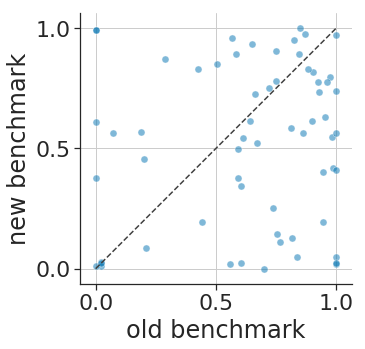

In [8]:
print(out_f)

# Read in docking results from old benchmark
result_file = os.path.join(
    '/home/haddox/2019/optE_eval/results/beta_nov16/',
    'nolayer_nostab_0/opt_1/score_docking_result'
)
with open(result_file) as f:
    score = float(f.readline().split()[0])
    #print('old score', round(score, 2))
old_df = pandas.read_csv(
    result_file, sep='\s+',
    skiprows=2, names=['pdb', 'score']
)
old_df['pdb'] = old_df['pdb'].apply(
    lambda x: os.path.basename(x).split('.')[0]
)

# Read in docking results from new benchmark
with open(out_f) as f:
    score = float(f.readline().split()[0])
    #print('new score', round(score, 2))
new_df = pandas.read_csv(
    out_f, sep='\s+',
    skiprows=2, names=['pdb', 'score']
)
new_df['pdb'] = new_df['pdb'].apply(
    lambda x: x.split('/')[-4]
)

# Merge and plot data
new_df = new_df.merge(
    old_df, on='pdb', suffixes=['_new', '_old'],
    how='left'
)
print('old avg', round(new_df['score_old'].mean(), 2))
print('new avg', round(new_df['score_new'].mean(), 2))
print('N landscapes =', len(new_df))
fig = plt.figure(figsize=[5,5])
ax = fig.add_subplot(111)
ax.plot(
    [0, 1], [0, 1],
    c='0.25', ls='--'
)
sns.scatterplot(
    x='score_old', y='score_new', data=new_df,
    s=50, alpha=0.5
)
ax.grid()
ax.set(
    xticks=[0, 0.5, 1], yticks=[0, 0.5, 1],
    xlabel='old benchmark', ylabel='new benchmark'
)
ax.set_aspect('equal', adjustable='box')
sns.despine()
plt.show()

In [9]:
new_df.sort_values('score_new', ascending=True)

,pdb,score_new,score_old
36,1SYX,0.000667,0.700493
39,1Y64,0.010449,0.002600
31,1NSN,0.010486,0.021644
2,1AKJ,0.018925,0.996992
42,1ZHI,0.019766,0.558749
34,1R6Q,0.021651,0.604945
45,2AJF,0.021904,0.996086
51,2MTA,0.024130,0.024024
10,1EWY,0.025611,0.021300
50,2JEL,0.048617,0.837050


Plot data for a single landscape, both from the old and new benchmarks

old: 122
new:  3767
20
3747


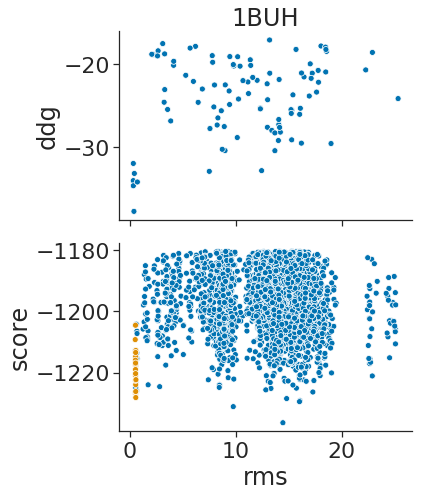

In [10]:
native = '1BUH'
(fig, axs) = plt.subplots(
    nrows=2, sharex=True, figsize=[6,7]
)

# Plot data from old benchmark
old_score_file = os.path.join(
    '/home/haddox/2019/optE_eval/results/beta_nov16/',
    f'nolayer_nostab_0/opt_1/{native}.docking.out'
)
df = pandas.read_csv(old_score_file, sep='\s+', skiprows=1)
print('old:', len(df))
df['decoy_type'] = 'decoy'
metric = 'ddg'
data = df[
    (df[metric] < df[metric].quantile(0.8)) &
    ~(df[metric].isnull())
].copy()
sns.scatterplot(
    x='rms', y='ddg', data=data, ax=axs[0],
    hue='decoy_type', hue_order=['decoy', 'native']
)

# Plot data from new benchmark
df = scores_df[scores_df['native'] == native].copy()
print("new: ", len(df))
for decoy_type in ['native', 'decoy']:
    print(sum(df['decoy_type'] == decoy_type))

metric = 'score' # 'ddg' # 'ref' #
data = df[
    (df[metric] < df[metric].quantile(0.8)) &
    (~df['pdb'].str.contains('_S_')) &
    ~(df[metric].isnull())
].copy()
data.sort_values('decoy_type', inplace=True)
sns.scatterplot(
    x='rms', y=metric, data=data, ax=axs[1],
    hue='decoy_type', hue_order=['decoy', 'native']
)
#plt.legend(bbox_to_anchor=(1,1))
axs[0].get_legend().remove()
axs[1].get_legend().remove()
axs[0].set(title=native)
plt.tight_layout()
sns.despine()
plt.show()

In [11]:
data.sort_values('score')[['pdb', 'score', 'rms']].head()

,pdb,score,rms
4707,HKH_2021_1BUH_run_2_complex.101_chain_B_7_0000...,-1236.436,14.453
8622,HKH_2021_1BUH_run_2_complex.881_chain_B_12_000...,-1231.164,9.759
7909,HKH_2021_1BUH_run_2_complex.72_chain_B_22_0000...,-1229.530,16.022
7801,HKH_2021_1BUH_run_2_complex.703_chain_B_1_0000...,-1229.231,16.066
6857,HKH_2021_1BUH_run_2_complex.504_chain_B_2_0000...,-1228.525,14.807


In [12]:
data.sort_values('score').iloc[0]['description']

'HKH_2021_1BUH_run_2_complex.101_chain_B_7_0000200002_0000001_0'

In [13]:
data[data['pdb'].str.contains('_S_')].sort_values('score', ascending=True)[['score', 'rms', 'pdb']].head()

,score,rms,pdb


Total score is noisy (see spread of relaxed natives). ddG is a less noisy metric, and more likely to work in optE. But ddG takes a long time to compute (long relaxes of unbound states are required). So, I will select ~1000 of PDBs with the best total score, roughly evenly sampled across different RMSD bins, so as to caputre the majority of PDBs likely to have low ddG values. Then, I will compute the ddG for that subset and choose the best-scoring ones for optE.

1A2K 1000


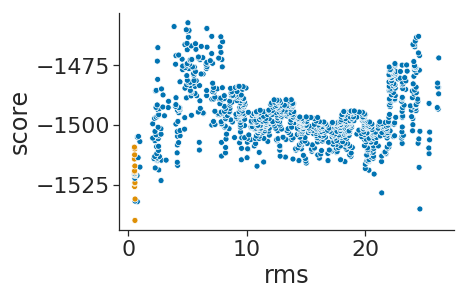

1AHW 1000


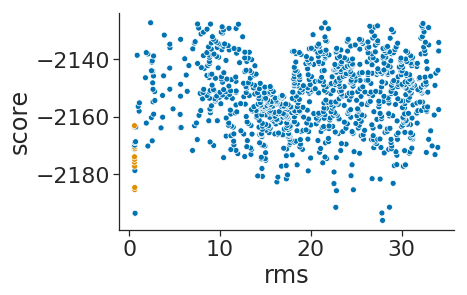

1AKJ 1000


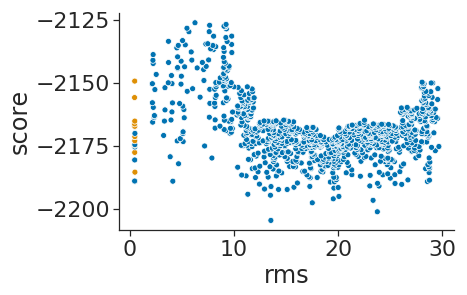

1AVX 1000


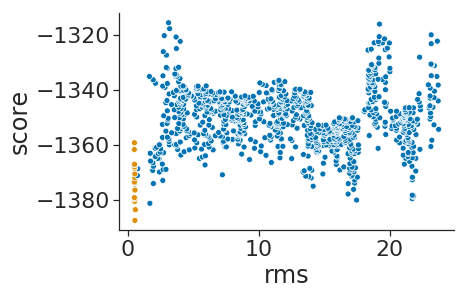

1BJ1 1000


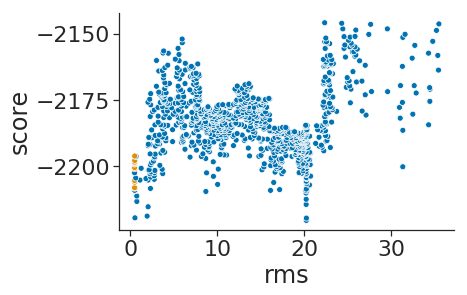

1BUH 1000


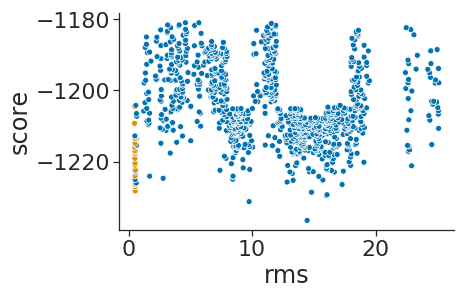

1BVK 1000


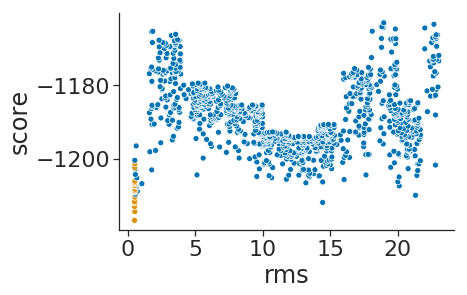

1DFJ 1000


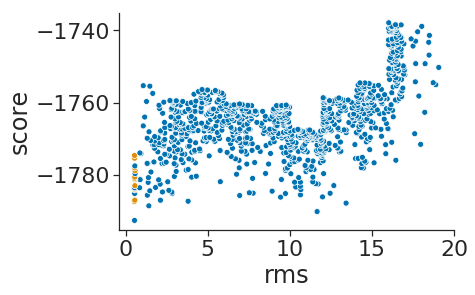

1E6E 1000


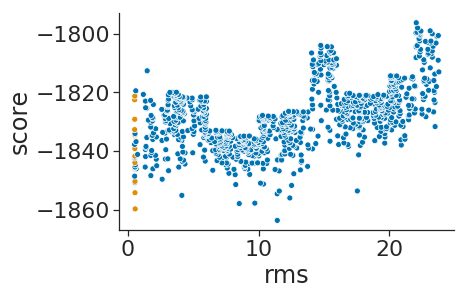

1EAW 1000


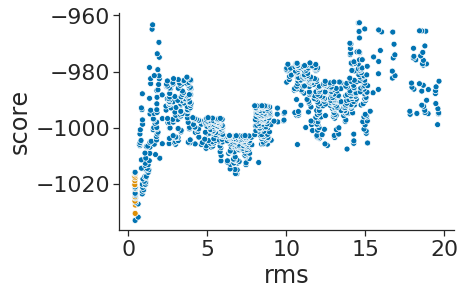

1EWY 1000


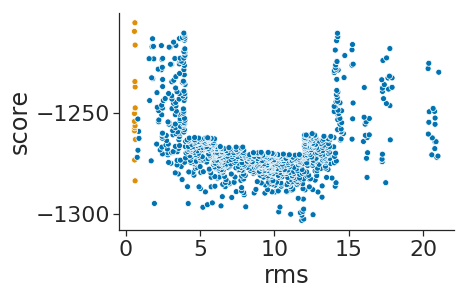

1EZU 1000


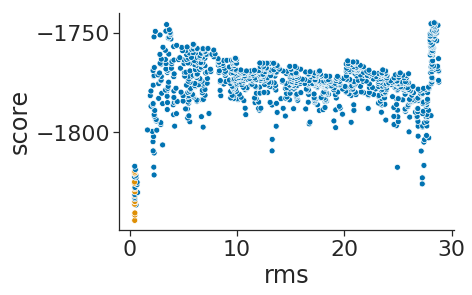

1F34 1000


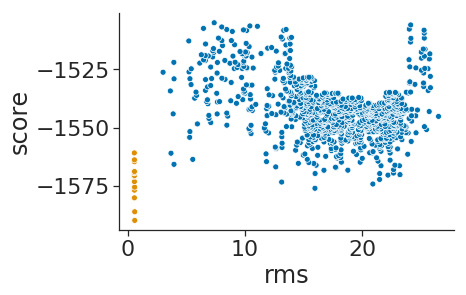

1F51 1000


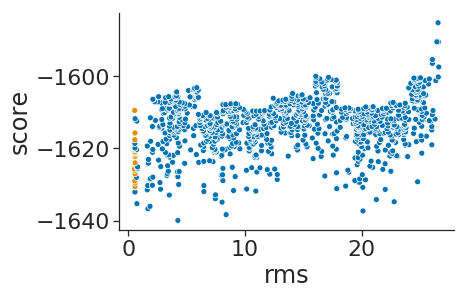

1F6M 1000


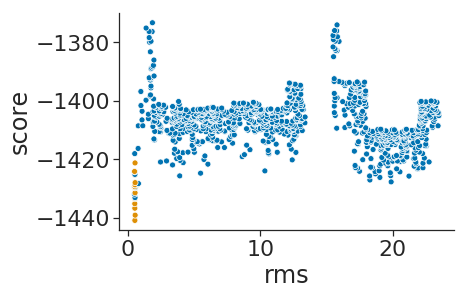

1FC2 1000


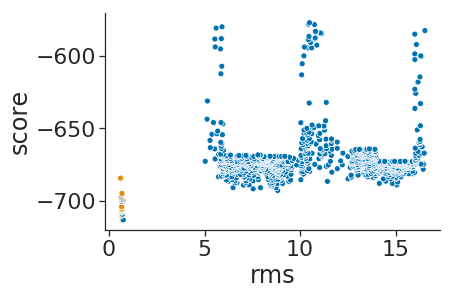

1FFW 1000


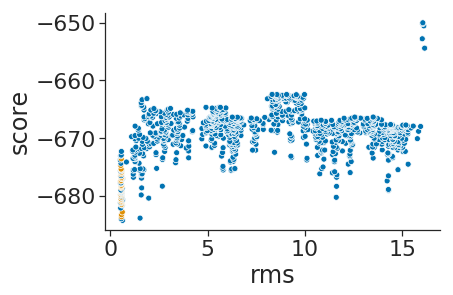

1FQ1 1000


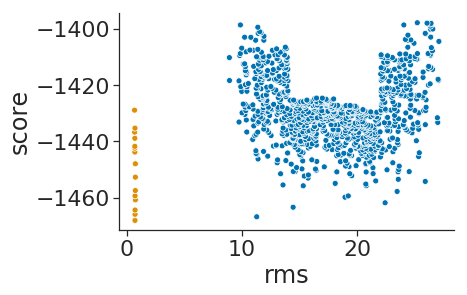

1FQJ 1000


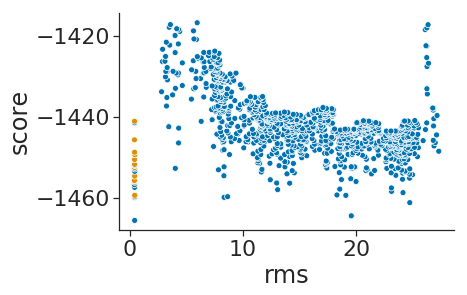

1FSK 1000


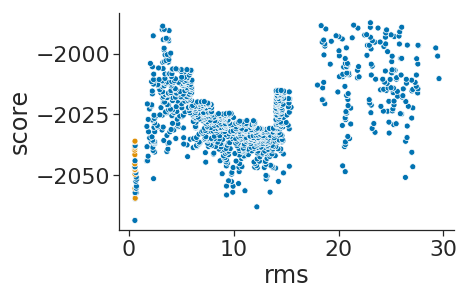

1GLA 1000


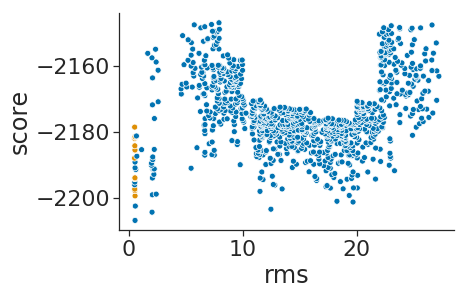

1GPW 1000


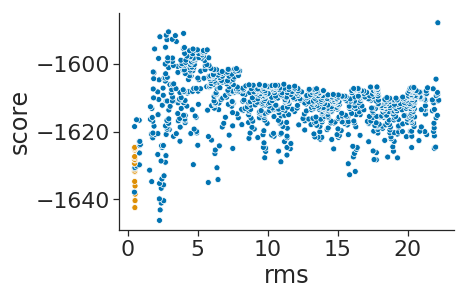

1H1V 1000


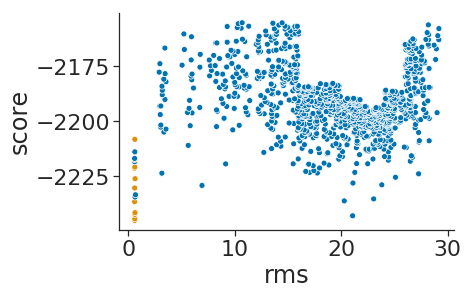

1HCF 1000


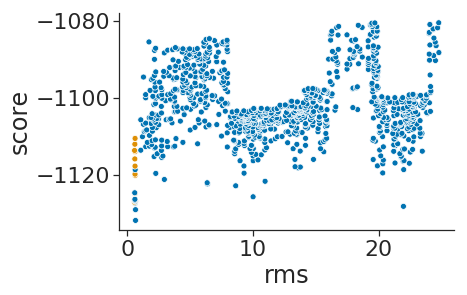

1IB1 1000


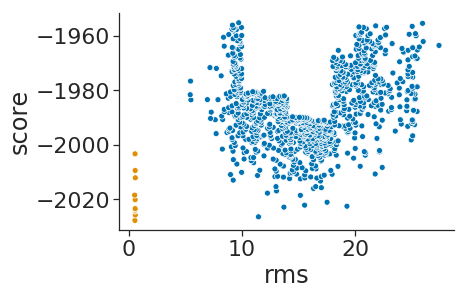

1J2J 1000


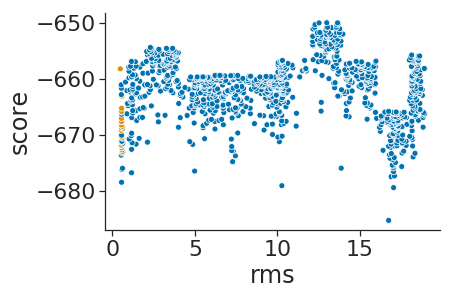

No decoys for 1JMO
1JZD 1000


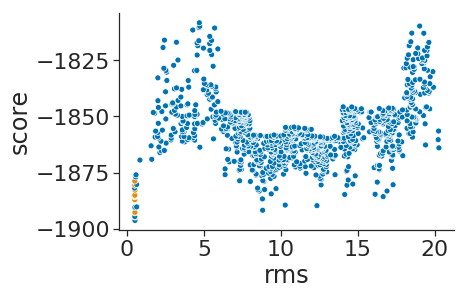

1K74 1000


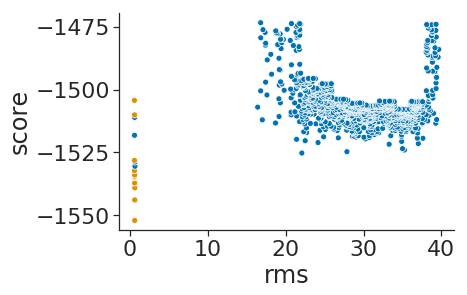

1KKL 1000


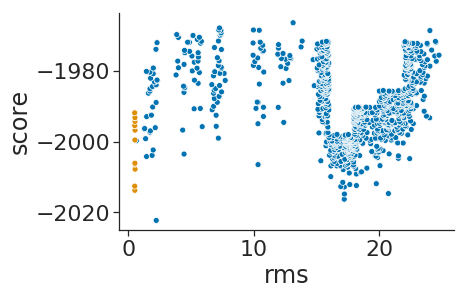

1M10 1000


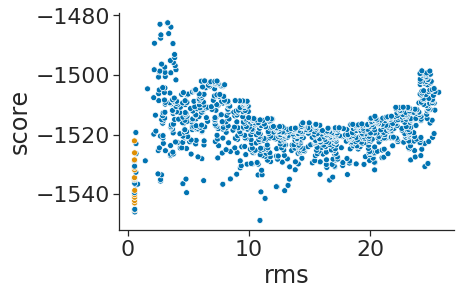

1NCA 1000


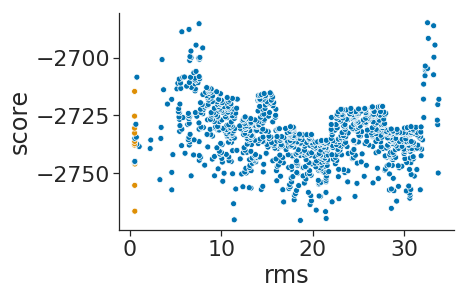

1NSN 1000


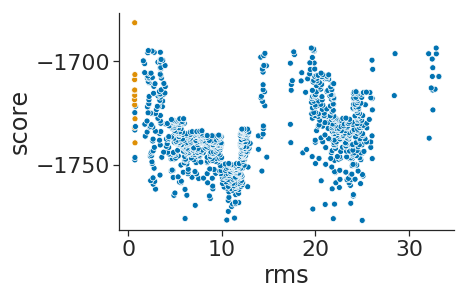

1OPH 1000


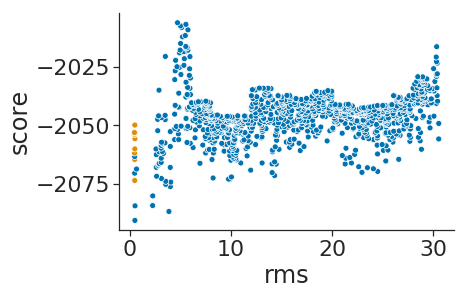

1QA9 1000


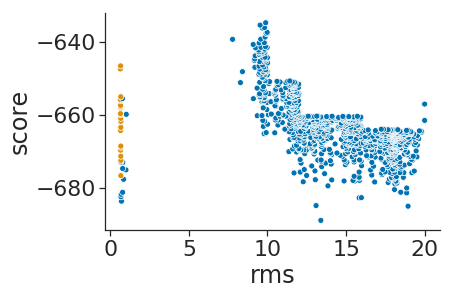

1R6Q 1000


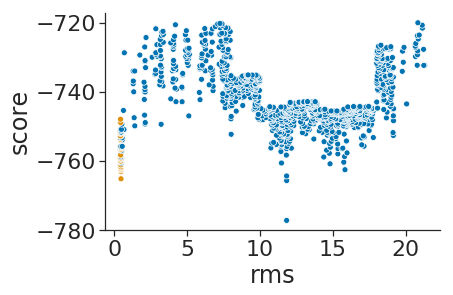

1RV6 1000


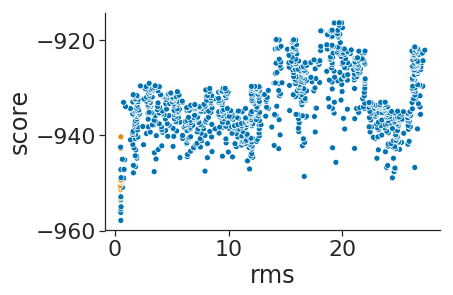

1SYX 1000


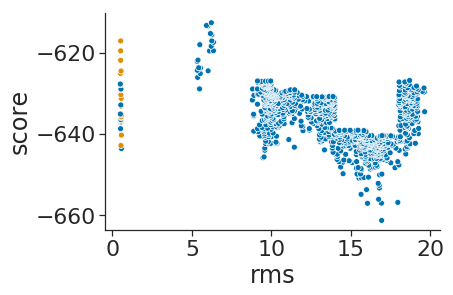

1US7 1000


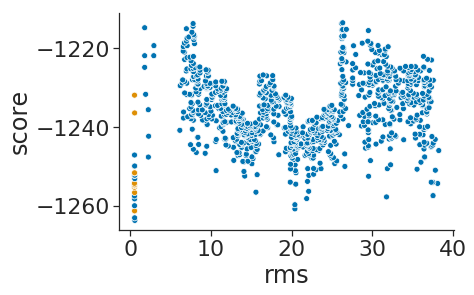

1XU1 1000


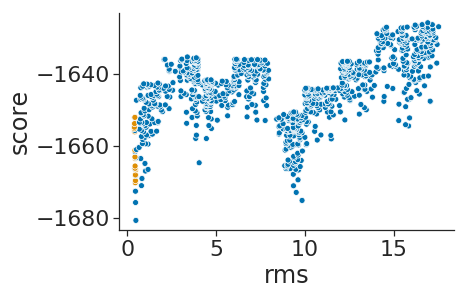

1Y64 1000


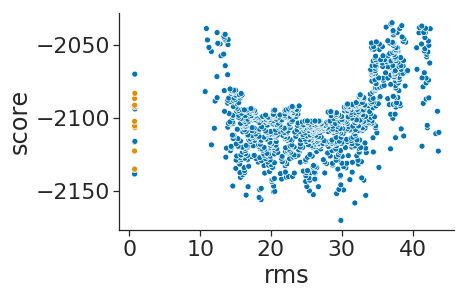

1YVB 1000


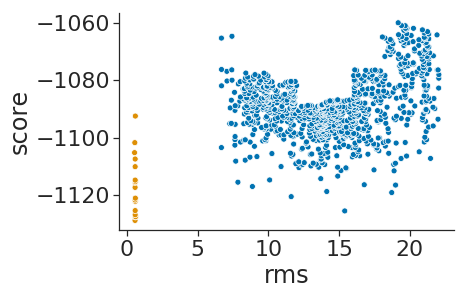

1Z5Y 1000


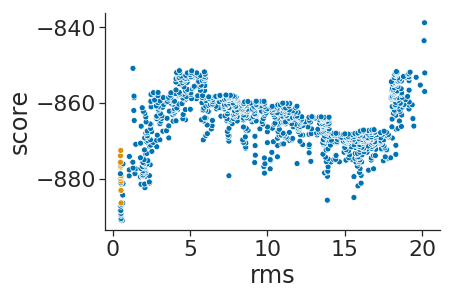

1ZHI 1000


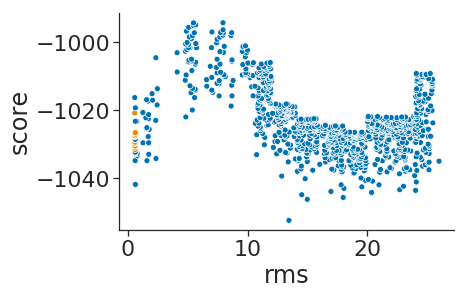

2A5T 1000


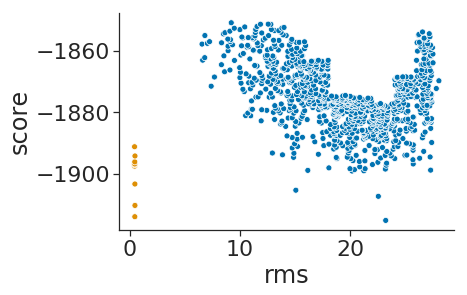

2ABZ 1000


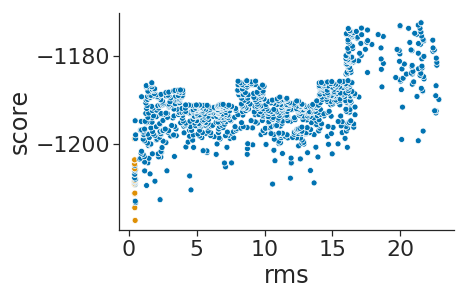

2AJF 1000


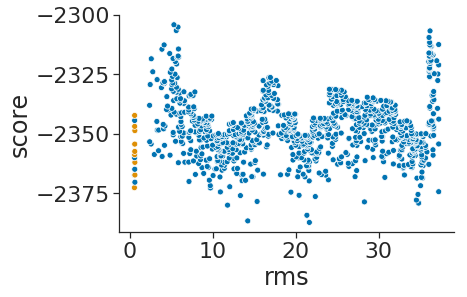

2AYO 1000


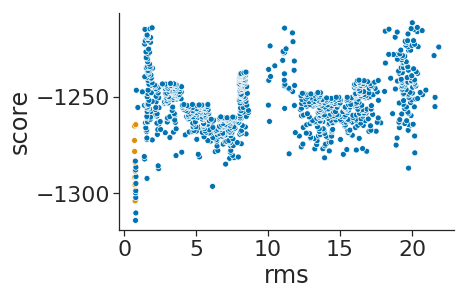

2CFH 1000


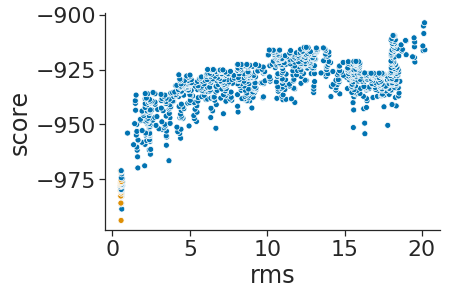

No decoys for 2H7V
2HRK 1000


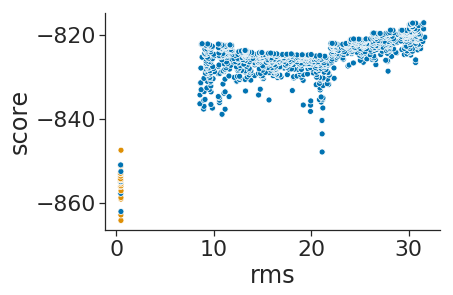

2I9B 1000


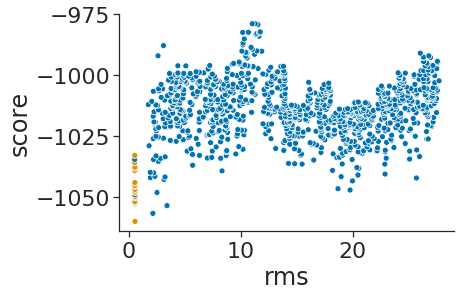

2JEL 1000


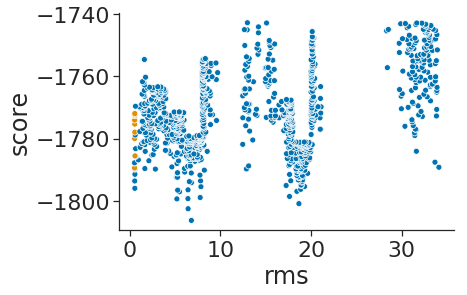

2MTA 1000


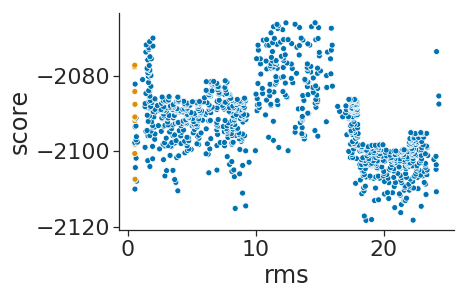

2O3B 1000


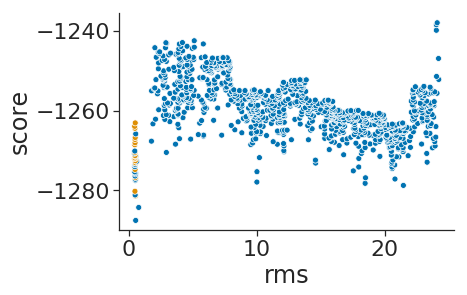

2O8V 803


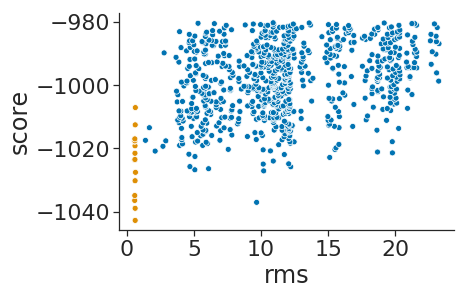

2OOB 933


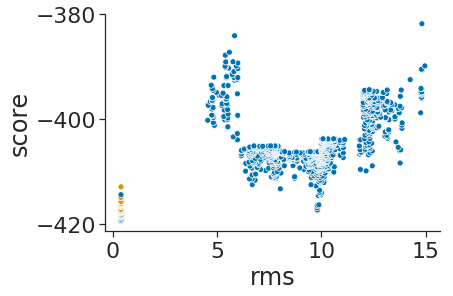

2PCC 1000


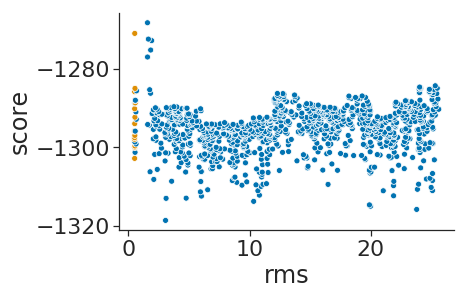

2UUY 1000


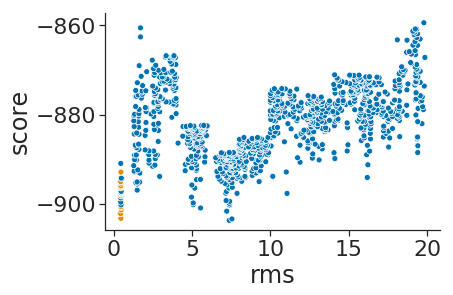

2VIS 1000


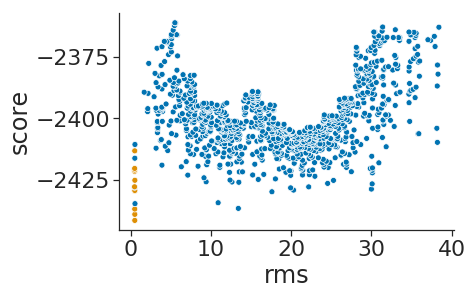

3CPH 1000


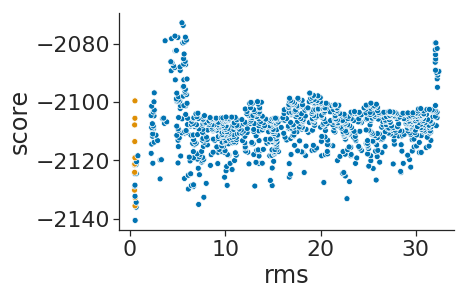

3D5S 1000


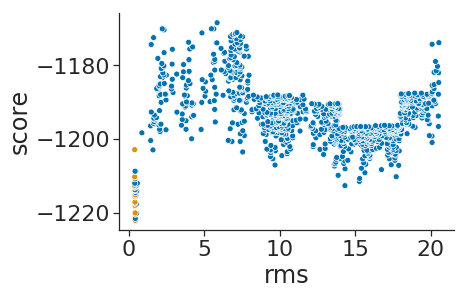

7CEI 1000


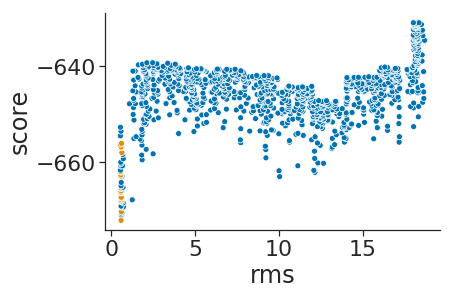

9QFW 1000


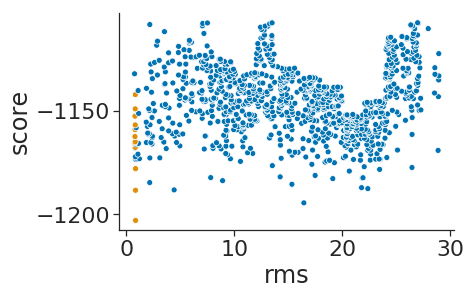

In [14]:
# Define input params
resultsdir = '/net/scratch/haddox/2021/ppi_benchmark/results'
dont_include_S = True
if dont_include_S:
    top_pdbs_results_dir = os.path.join(
        resultsdir,
        'silent_files_binned_top1000_noS/'
    )
else:
    top_pdbs_results_dir = os.path.join(
        resultsdir,
        'silent_files_binned_top1000/'
    )
if not os.path.isdir(top_pdbs_results_dir):
    os.makedirs(top_pdbs_results_dir)

# Cycle through natives, bin data, and select top PDBs
# from each bin
n_total_samples = 1000
top_pdbs_dict = {}
for (i, native) in enumerate(natives_to_score):
    
    # Get data for landscape for indicated native
    df = scores_df[
        scores_df['native'] == native
    ].copy()
    df = df[
        (df['pdb'].str.contains('xtal')) |
        (df['score'] < df['score'].quantile(0.8))
    ]
    if dont_include_S:
        df = df[~df['pdb'].str.contains('_S_')].copy()
    if len(df) == 0:
        print("No decoys for", native)
        continue
        
    # Bin PDBs, sorted by score
    max_rmsd = df['rms'].max() # 20 #  
    bin_size = 2
    n_samples_per_bin = 500
    bin_mins = list(np.arange(0, max_rmsd+bin_size, bin_size))
    df.sort_values('score', inplace=True)
    binned_pdbs = {}
    for bin_min in bin_mins:
        data = df[
            (df['rms'].between(bin_min, bin_min+bin_size))
        ].copy()
        binned_pdbs[bin_min] = \
            list(data['description'][:n_samples_per_bin])

    # Downselect PDBs to test by cycling through bins and
    # choosing low-energy structures one per cycle
    top_pdbs = []
    for pdb_index in range(200):
        for bin_min in bin_mins:
            if len(binned_pdbs[bin_min]) < pdb_index+1:
                continue
            top_pdbs.append(binned_pdbs[bin_min][pdb_index])
            if len(top_pdbs) >= n_total_samples:
                break
        if len(top_pdbs) >= n_total_samples:
            break
    top_pdbs_dict[native] = top_pdbs
    data = df[(df['description'].isin(top_pdbs))]
    print(native, len(top_pdbs))

    # Plot data
    metric = 'score'
    sns.scatterplot(
        x='rms', y=metric, data=data,
        hue='decoy_type', hue_order=['decoy', 'native']
    )
    plt.legend().remove()
    sns.despine()
    plt.show()

    # Make a silent file that only contains the PDBs
    # selected from above, and then split that file
    # into multiple files, each containing 50 poses
    # to help with efficiently scoring everything later
    boinc_results_dir = os.path.join(
        f'{resultsdir}/global_docks/{native}/boinc_relax/',
        'boinc_results/'
    )
    renamed_out_file = os.path.join(
        boinc_results_dir,
        f'{native}_renamed.out'
    )
    tags_file = os.path.join(
        top_pdbs_results_dir,
        f'{native}_tags.txt'
    )
    top_pdbs_silent_file = os.path.join(
        top_pdbs_results_dir,
        f'{native}.out'
    )
    if not os.path.isfile(tags_file):
        with open(tags_file, 'w') as f:
            for pdb in top_pdbs:
                f.write(f'{pdb}\n')
        
        # Make a big silent file with select PDBs
        cmd = ' '.join([
            f'cat {tags_file} |',
            f'/home/haddox/software/silent_tools/silentslice {renamed_out_file} >',
            top_pdbs_silent_file
        ])
        out = subprocess.check_call(cmd, shell=True)
        
        # Split up the big file into smaller pieces
        split_file_dir = os.path.join(
            top_pdbs_results_dir,
            f'{native}_split_silent_files/'
        )
        os.makedirs(split_file_dir)
        cmd = ' '.join([
            '/home/haddox/software/silent_tools/silentsplit',
            f'../{os.path.basename(top_pdbs_silent_file)}',
            '50'
        ])
        out = subprocess.check_call(
            cmd, shell=True, cwd=split_file_dir
        )

Having selected decoys from above, compute ddG of each decoy by doing a full relax of the complex and each individual chain. The relax protocols add PDB-info labels that indicate which residues are non-interface residues, so that future protocols can use this info (which would not be apparent for individual chains). I will renumber saved PDBs so that the numbers match the PDB-info labels.

In [15]:
# Define input params
dont_include_S = True
resultsdir = '/net/scratch/haddox/2021/ppi_benchmark/results'
dont_include_S = True
if dont_include_S:
    top_pdbs_results_dir = os.path.join(
        resultsdir,
        'silent_files_binned_top1000_noS/'
    )
else:
    top_pdbs_results_dir = os.path.join(
        resultsdir,
        'silent_files_binned_top1000/'
    )
relaxscript = 'MonomerDesign2019'
weights = 'beta_nov16_cart'

# Make list of XMLs to test
xml_dict = {
    'relax_interface_of_complex' : \
        'scripts/relax_interface_of_complex.xml',
    'relax_interface_of_chainA' : \
        'scripts/relax_interface_of_chainA.xml',
    'relax_interface_of_chainB' : \
        'scripts/relax_interface_of_chainB.xml',
}

# Cycle through natives and score silent files from each
for native in natives_to_score:

    # Get the path to the native xtal
    native_xtal = os.path.join(
        '/home/dimaio/optE2/dualoptE/decoys/docking/',
        f'{native}_bound_native.pdb'
    )
    
    # Make a list of silent files
    split_silent_files = glob.glob(os.path.join(
        top_pdbs_results_dir,
        f'{native}_split_silent_files/',
        '*'
    ))
    print(native, len(split_silent_files))
    
    # Score each file with each protocol
    for input_silent_file in split_silent_files:
        silent_id = os.path.basename(input_silent_file)
        for xml_name in xml_dict:

            # Assemble command
            xml = xml_dict[xml_name]
            output_prefix = os.path.join(
                top_pdbs_results_dir,
                f'{native}_{silent_id}_{xml_name}'
            )
            cmd = ' '.join([
                '~/Rosetta/main/source/bin/rosetta_scripts.default.linuxgccrelease',
                f'-parser:protocol {xml}',
                '-parser:script_vars',
                f'wts={weights}',
                f'relaxscript={relaxscript}',
                '-beta_nov16_cart',
                f'-in:file:silent {input_silent_file}',
                '-in:file:silent_struct_type binary',
                f'-score:weights {weights}',
                '-crystal_refine true',
                f'-in:file:native {native_xtal}',
                f'-out:prefix {top_pdbs_results_dir}',
                '-out:file:renumber_pdb true',
                f'-out:file:scorefile {output_prefix}.sc',
                f'-out:file:silent {output_prefix}.out',
                '-silent_read_through_errors',
                '-mute all'
            ])

            # Submit job
            sbatch_file_name = f'{output_prefix}.sbatch'
            if not os.path.isfile(sbatch_file_name):
                design_utils.WriteSbatchFile(
                    sbatch_file_name,
                    command=cmd,
                    queue_type='medium',
                    memory='2g'
                )
                ! sbatch {sbatch_file_name}

1A2K 20
1AHW 20
1AKJ 20
1AVX 20
1BJ1 20
1BUH 20
1BVK 20
1DFJ 20
1E6E 20
1EAW 20
1EWY 20
1EZU 20
1F34 20
1F51 20
1F6M 20
1FC2 20
1FFW 20
1FQ1 20
1FQJ 20
1FSK 20
1GLA 20
1GPW 20
1H1V 20
1HCF 20
1IB1 20
1J2J 20
1JMO 0
1JZD 20
1K74 20
1KKL 20
1M10 20
1NCA 20
1NSN 20
1OPH 20
1QA9 20
1R6Q 20
1RV6 20
1SYX 20
1US7 20
1XU1 20
1Y64 20
1YVB 20
1Z5Y 20
1ZHI 20
2A5T 20
2ABZ 20
2AJF 20
2AYO 20
2CFH 20
2H7V 0
2HRK 20
2I9B 20
2JEL 20
2MTA 20
2O3B 20
2O8V 17
2OOB 19
2PCC 20
2UUY 20
2VIS 20
3CPH 20
3D5S 20
7CEI 20
9QFW 20


For each native, read in scores from above and compute ddG, then select the top ~150 decoys for that native, spread roughly evenly across bins, and write the decoys to a silent file.

1A2K 1000 14


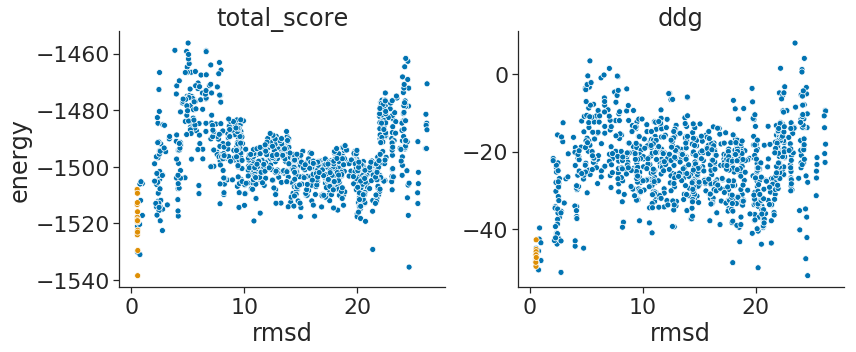

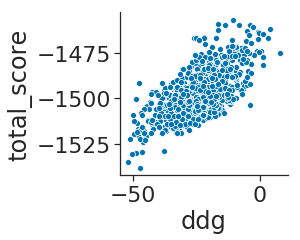

for optE 150 5


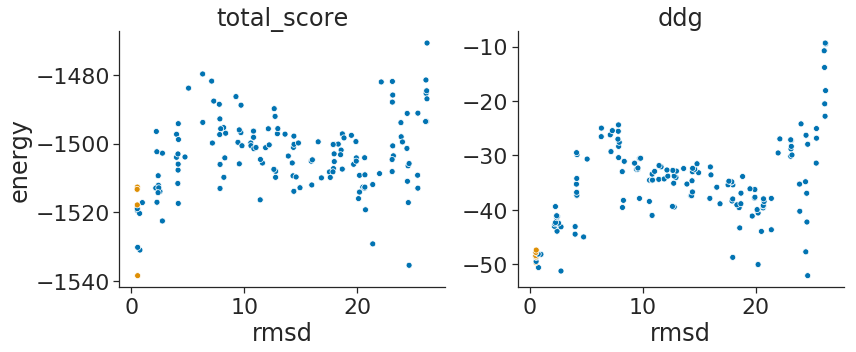

1AHW 1000 10


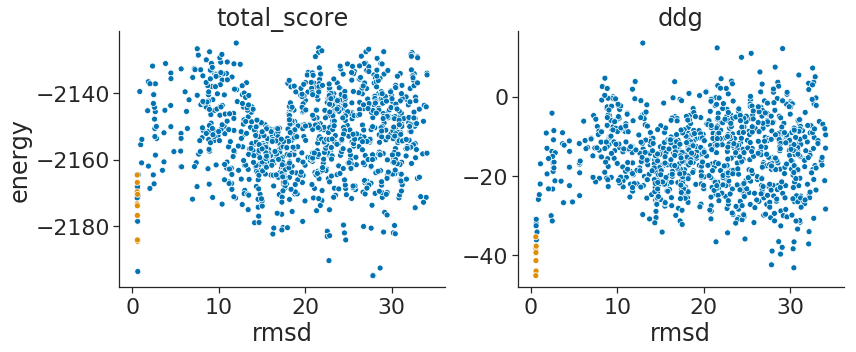

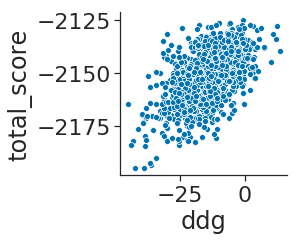

for optE 150 8


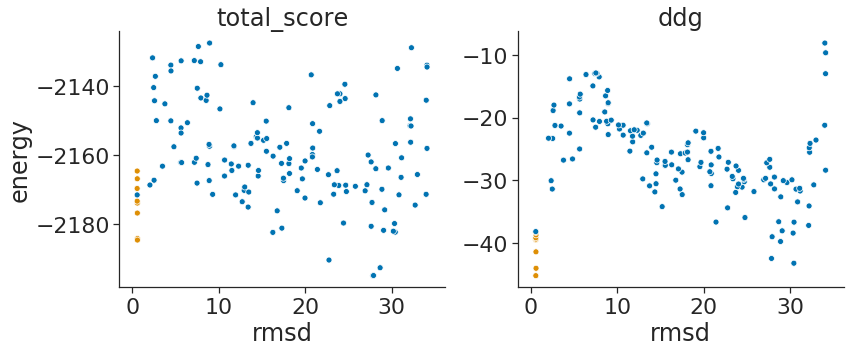

1AKJ 1000 12


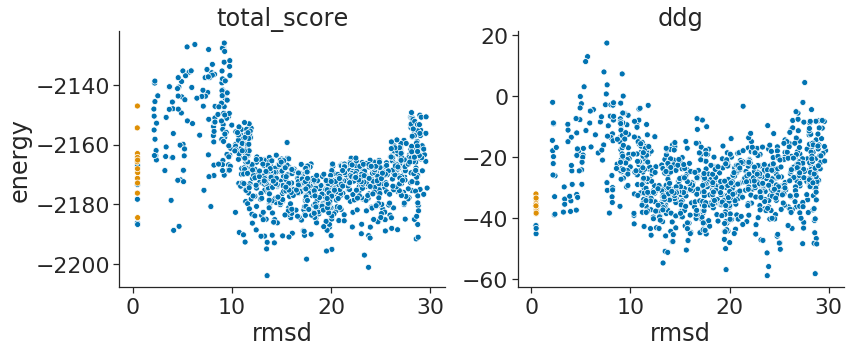

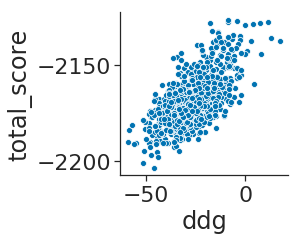

for optE 150 4


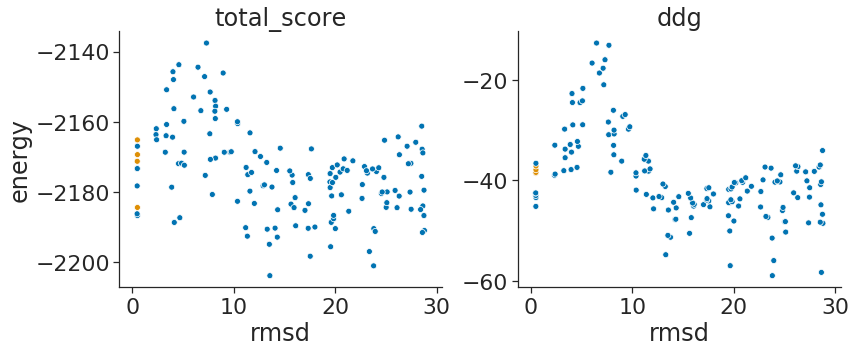

1AVX 1000 18


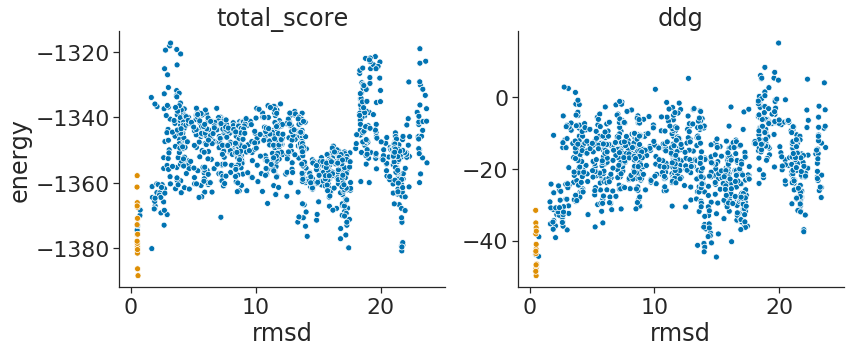

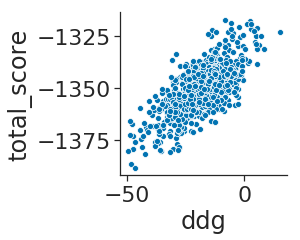

for optE 150 10


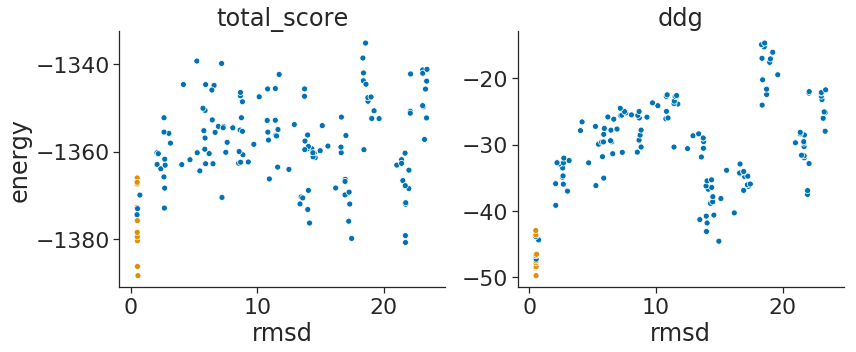

1BJ1 1000 12


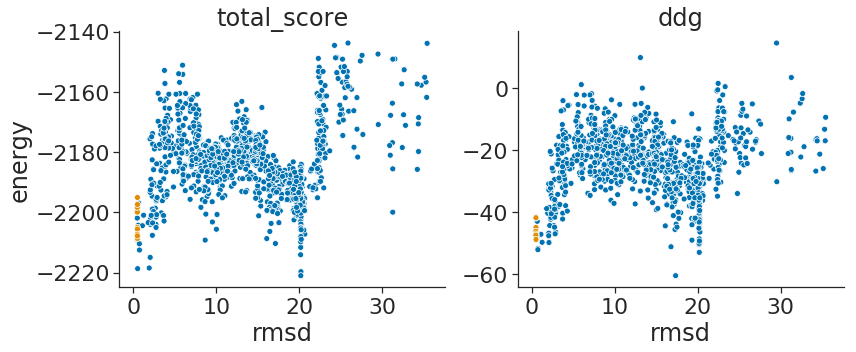

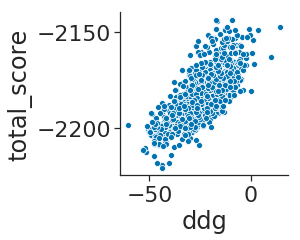

for optE 150 5


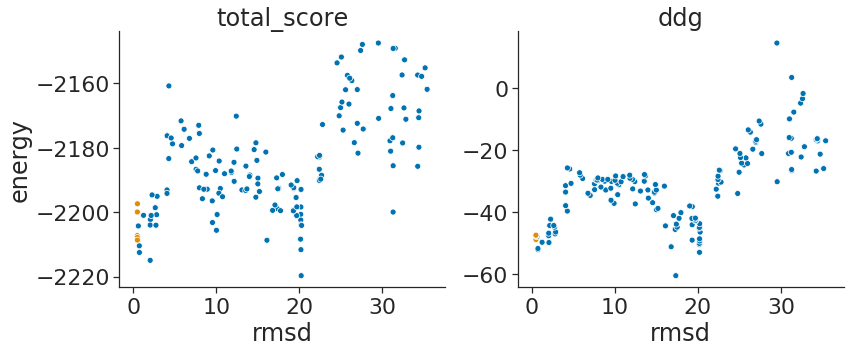

1BUH 1000 20


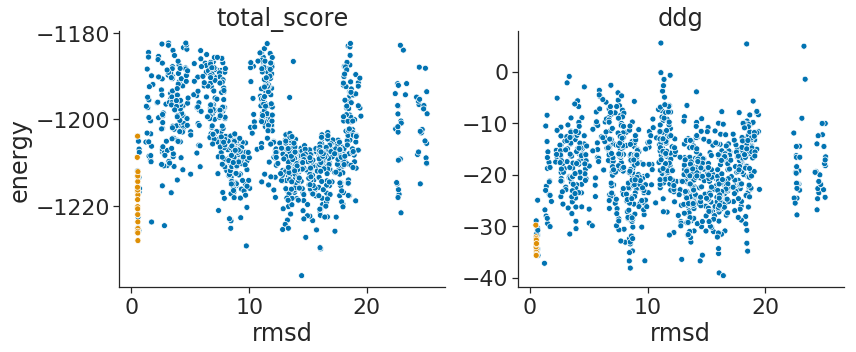

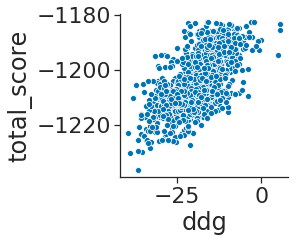

for optE 150 7


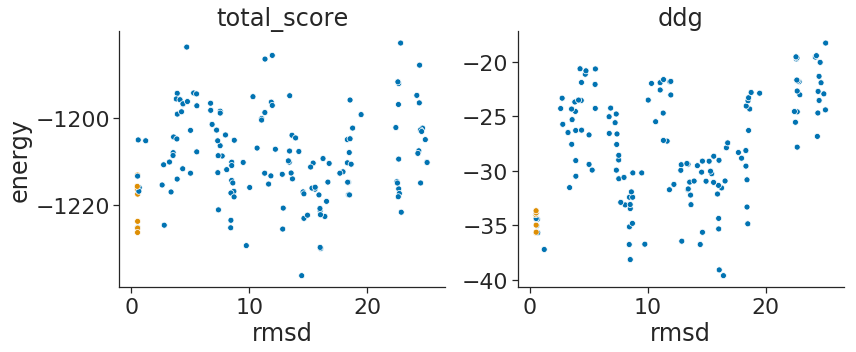

1BVK 1000 17


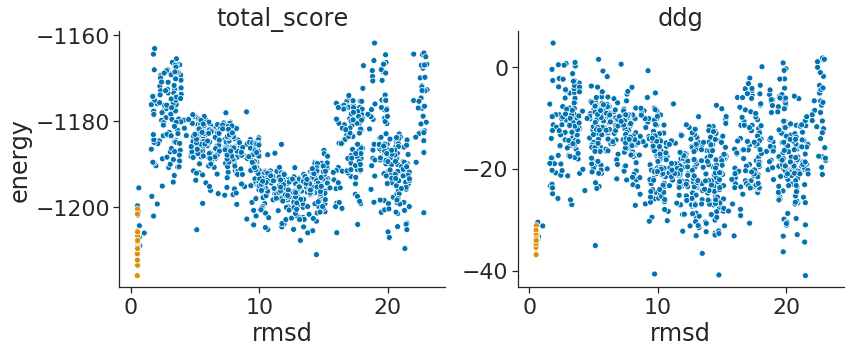

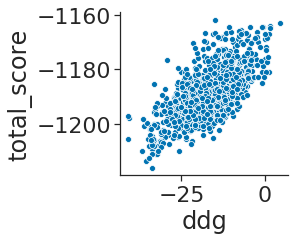

for optE 150 7


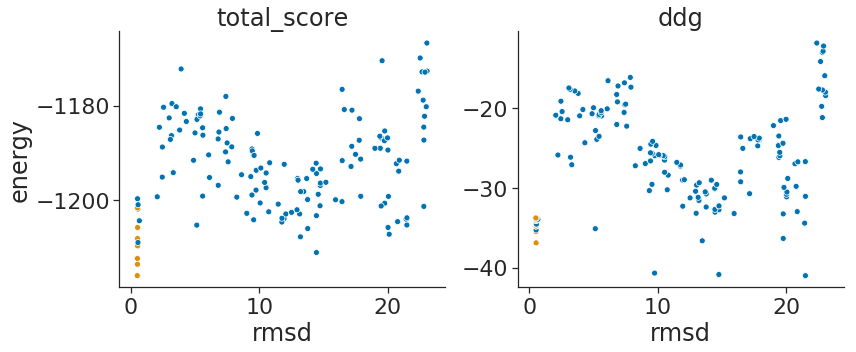

1DFJ 1000 12


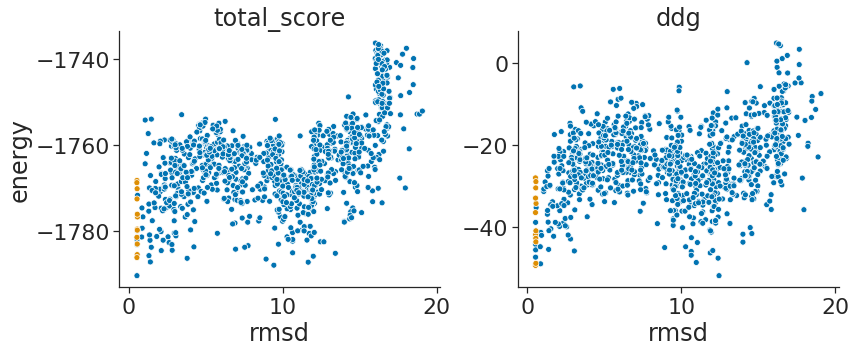

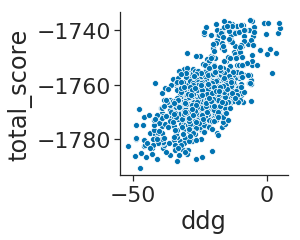

for optE 150 6


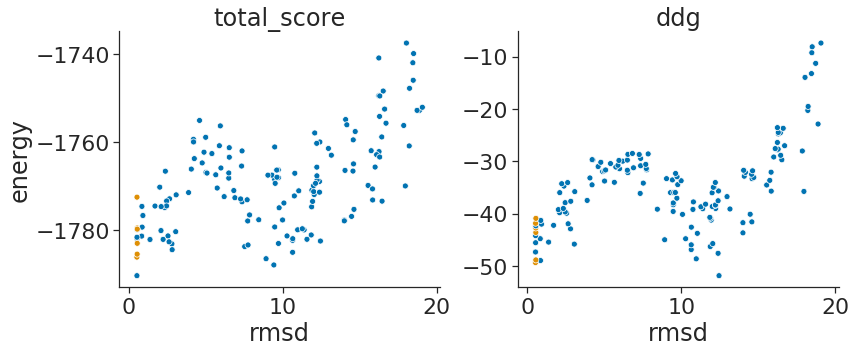

1E6E 1000 15


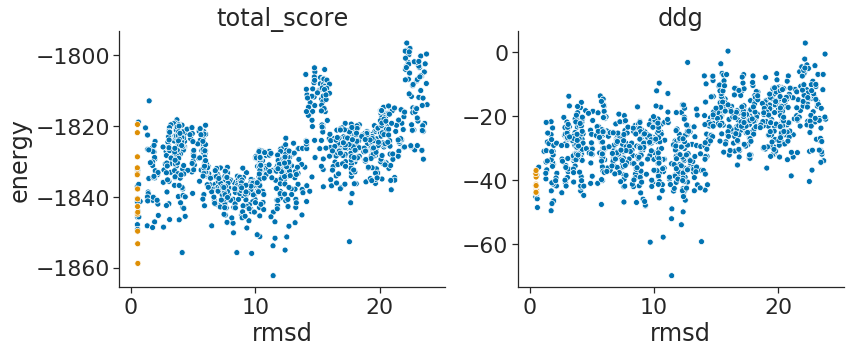

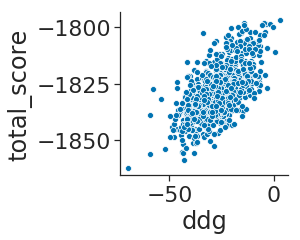

for optE 150 4


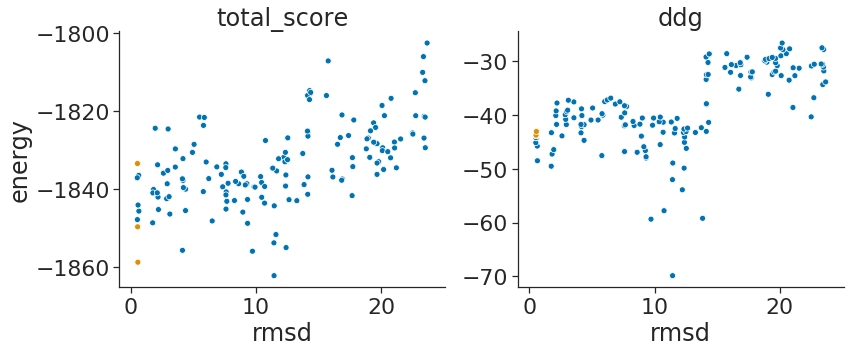

1EAW 1000 12


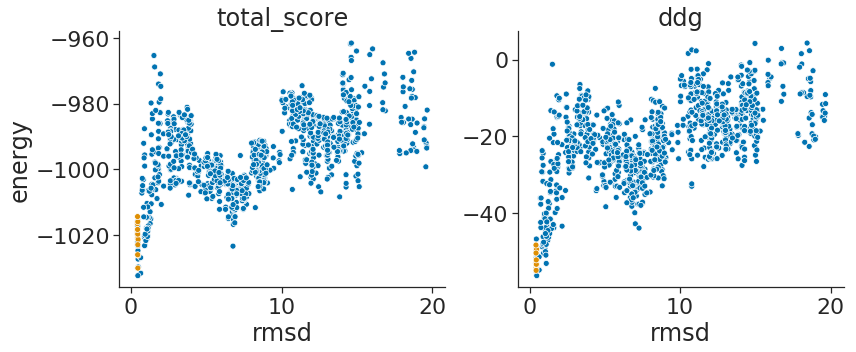

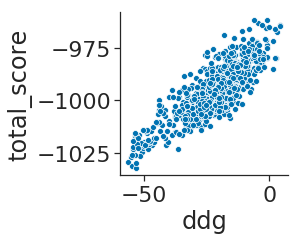

for optE 150 7


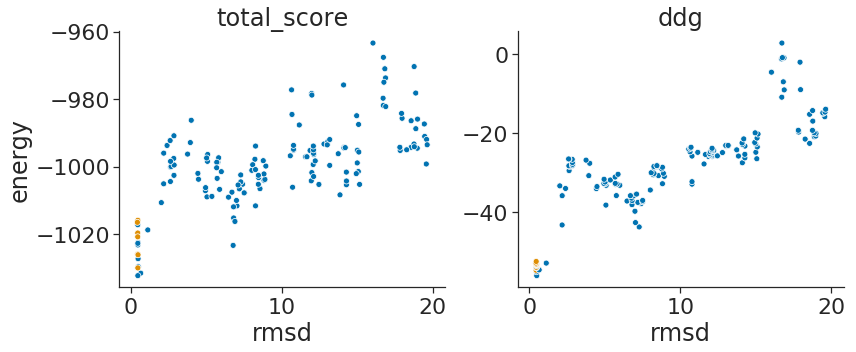

1EWY 1000 16


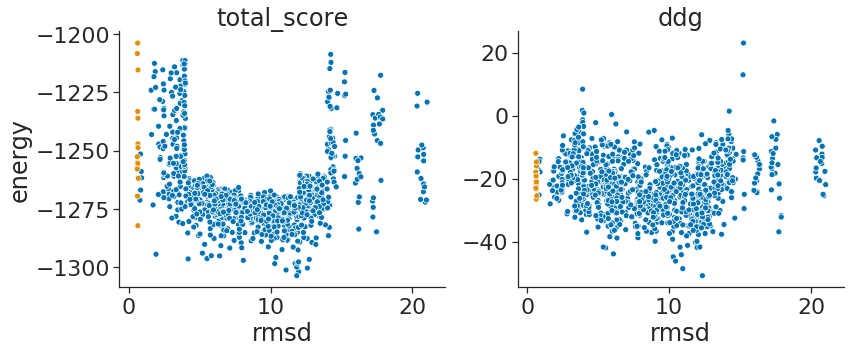

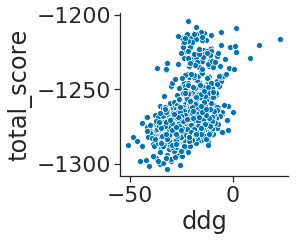

for optE 149 8


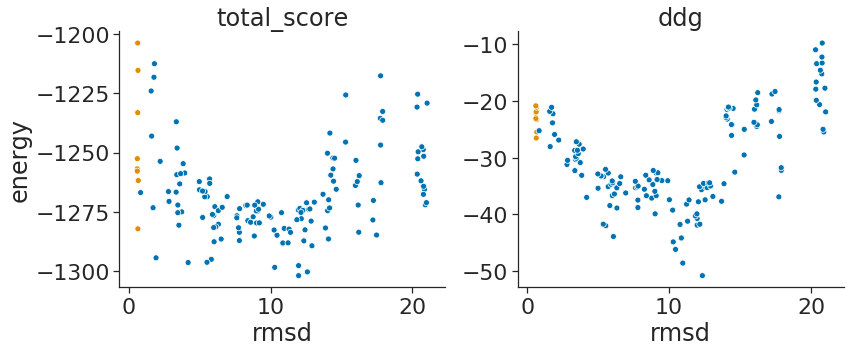

1EZU 1000 15


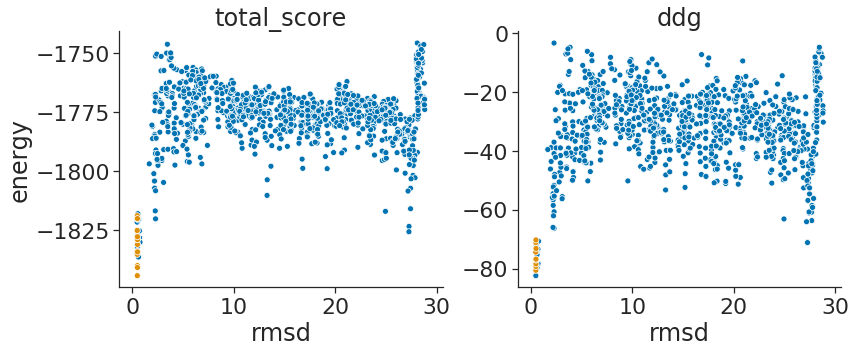

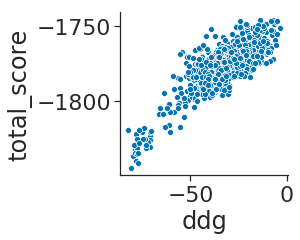

for optE 150 5


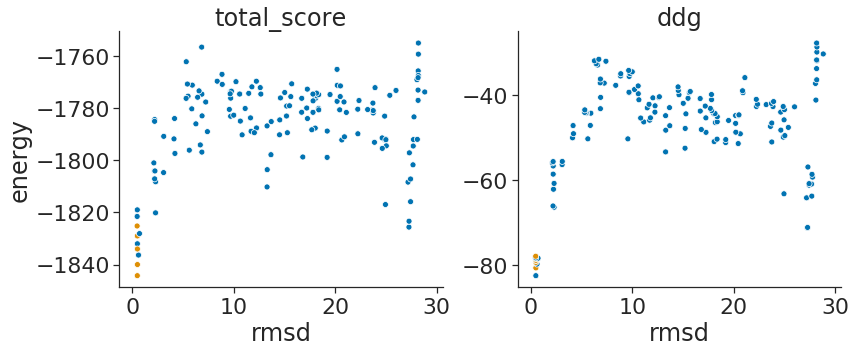

1F34 1000 14


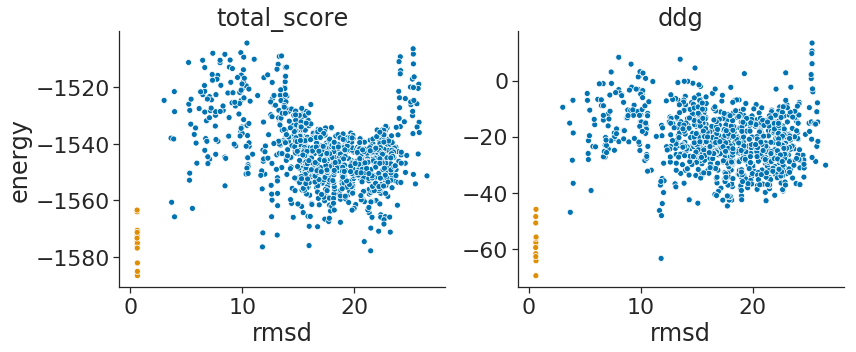

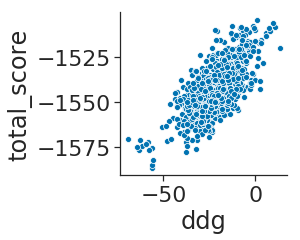

for optE 150 12


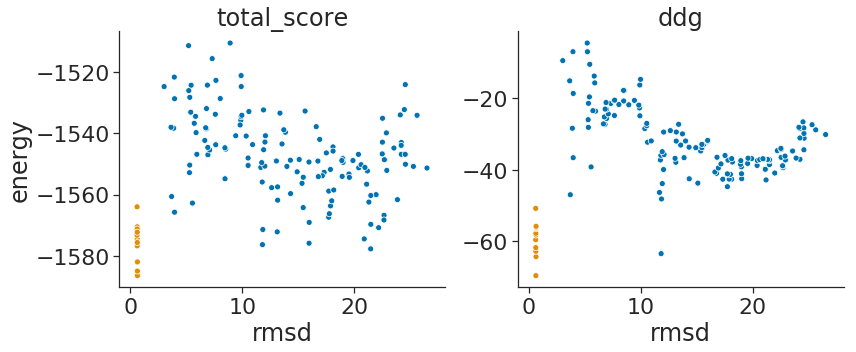

1F51 1000 18


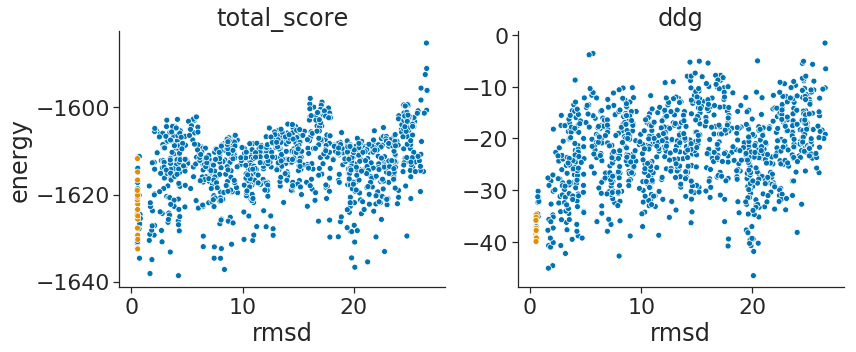

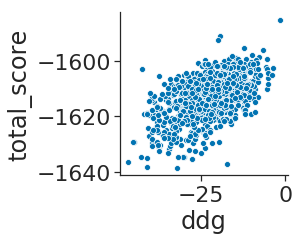

for optE 149 6


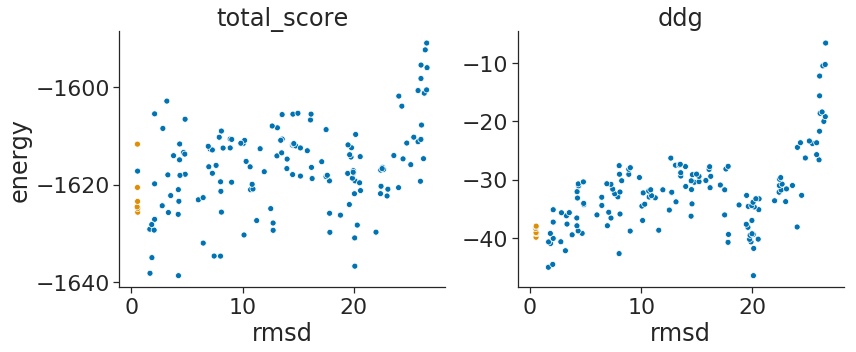

1F6M 1000 15


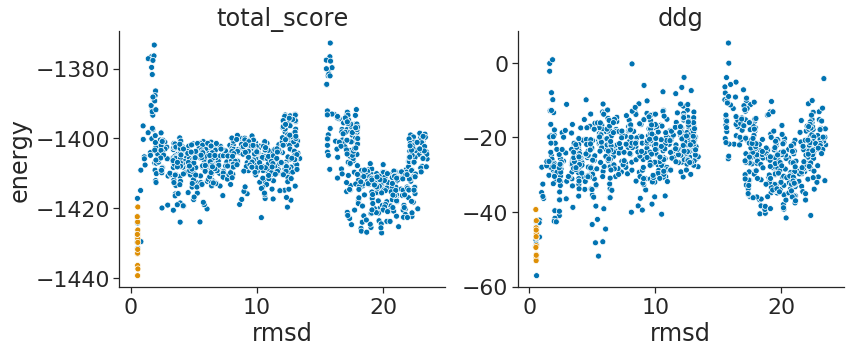

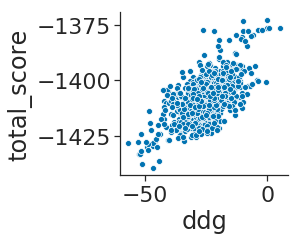

for optE 150 8


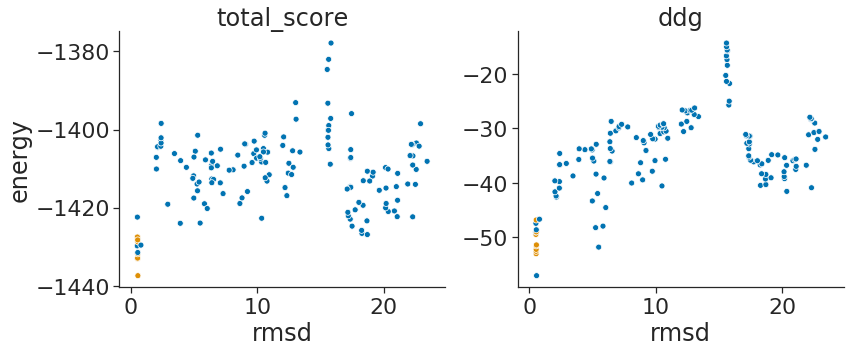

1FC2 1006 15


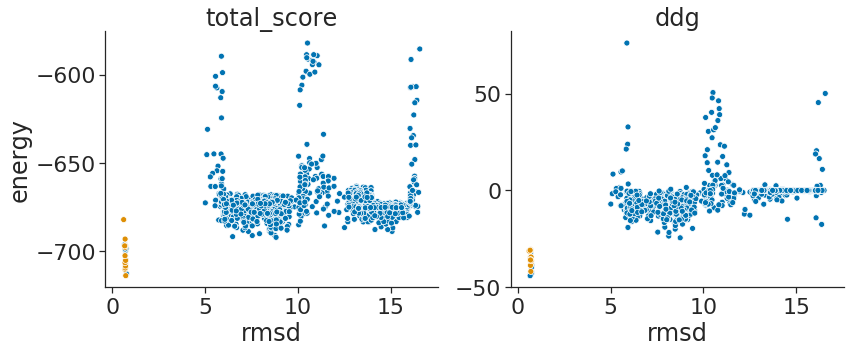

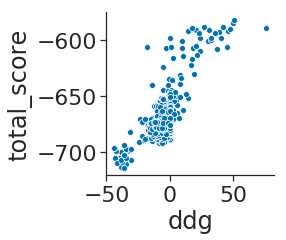

for optE 150 10


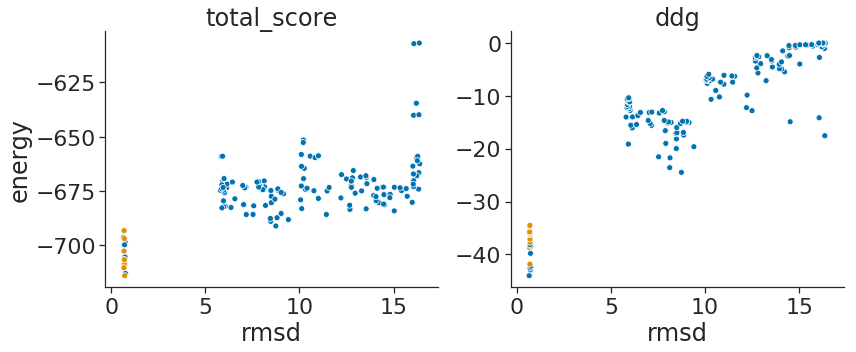

1FFW 1000 35


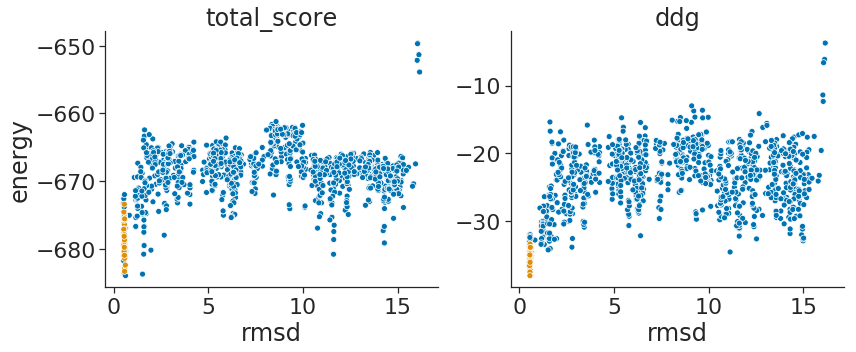

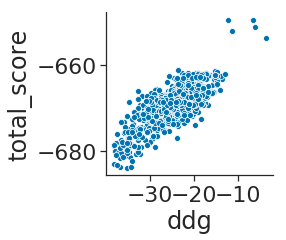

for optE 150 16


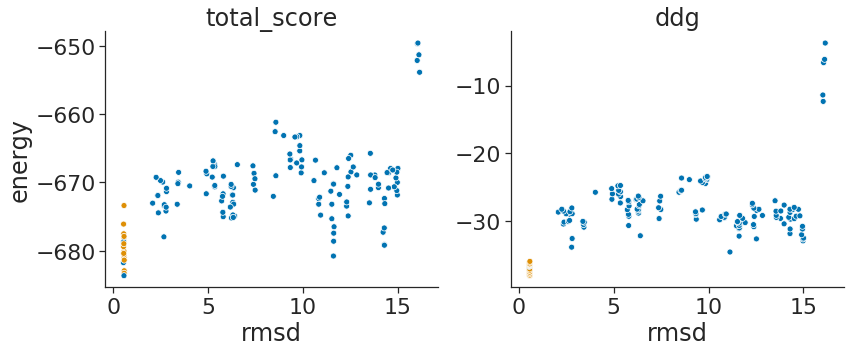

1FQ1 1012 19


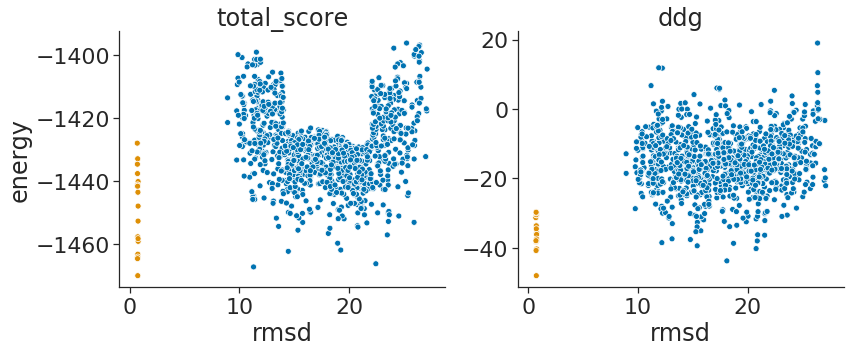

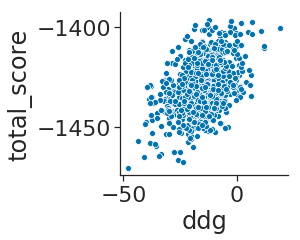

for optE 150 14


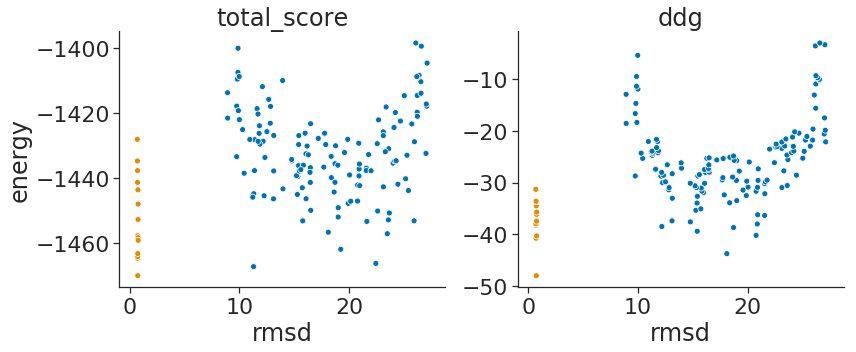

1FQJ 1000 13


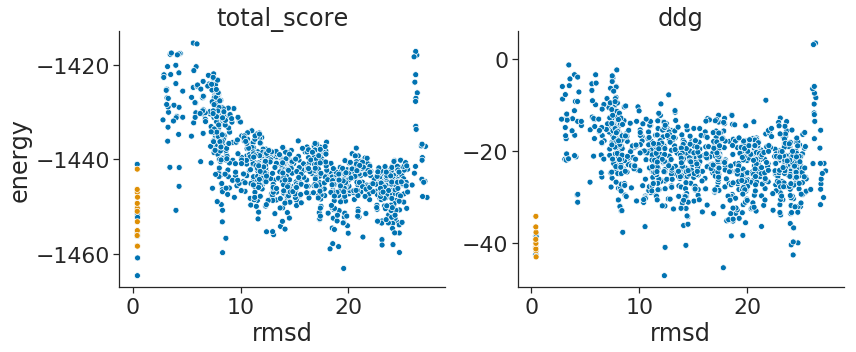

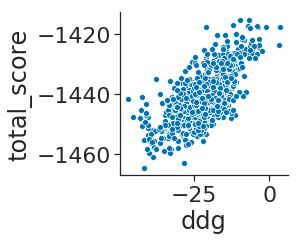

for optE 150 7


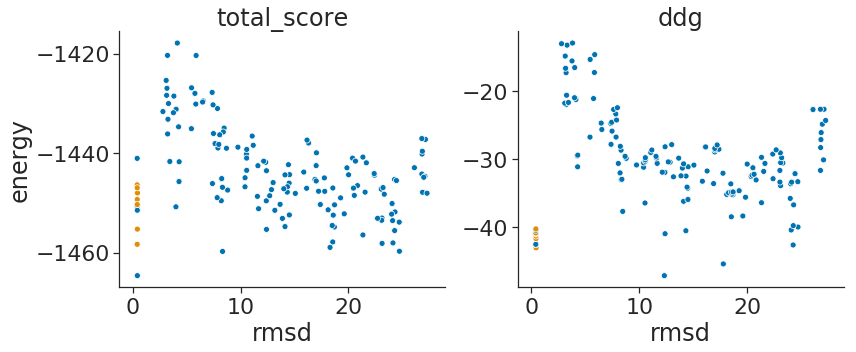

1FSK 1006 13


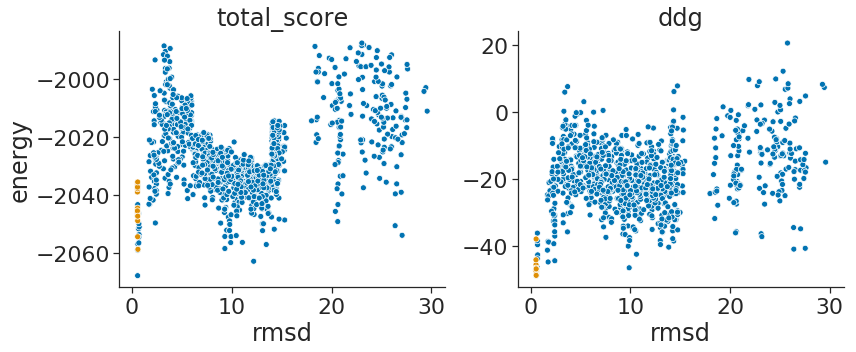

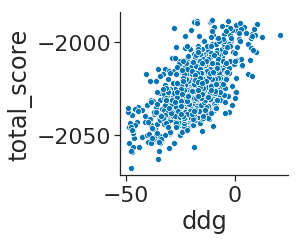

for optE 150 6


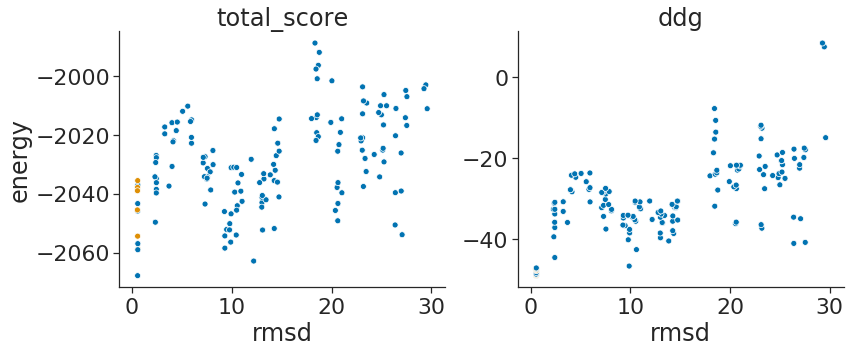

1GLA 1000 14


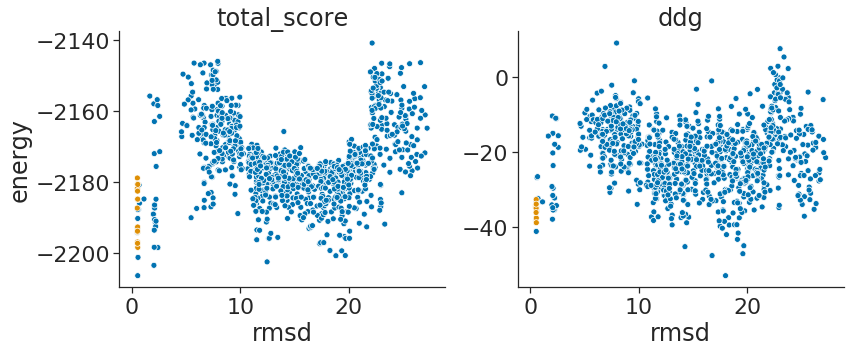

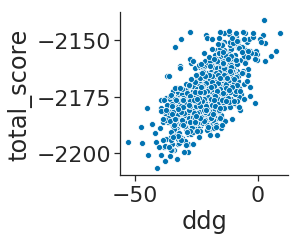

for optE 150 7


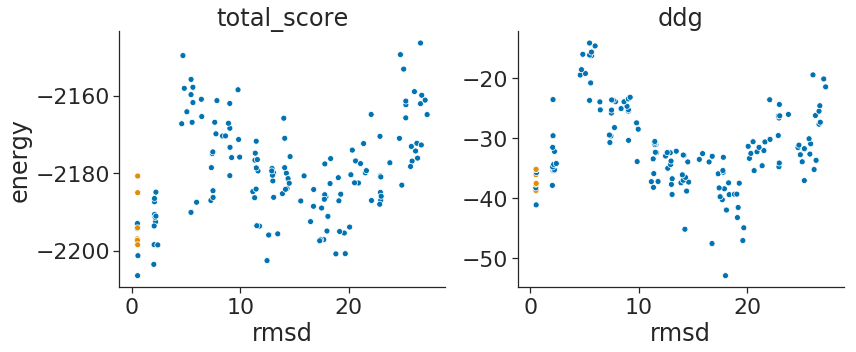

1GPW 1000 17


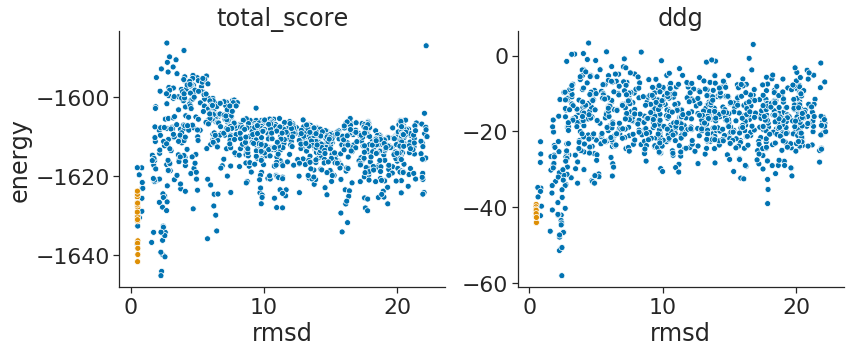

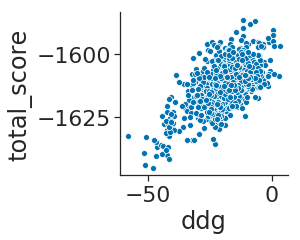

for optE 150 8


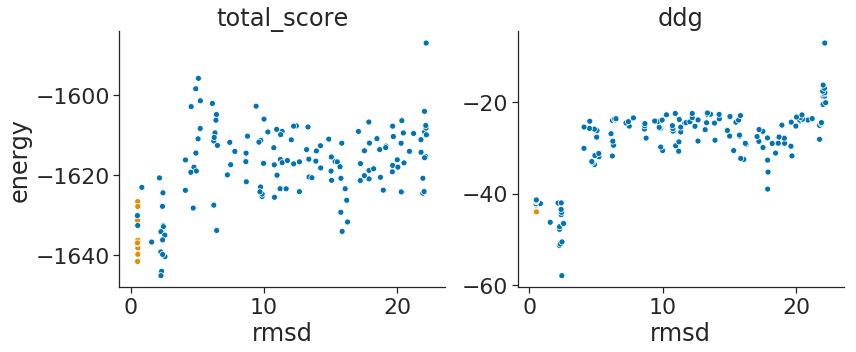

1H1V 1006 11


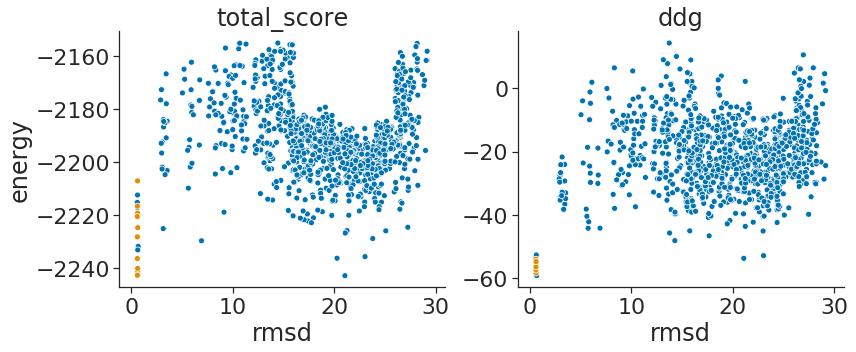

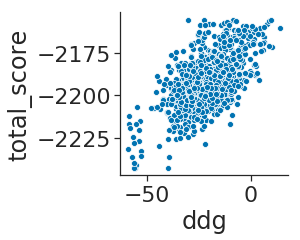

for optE 150 8


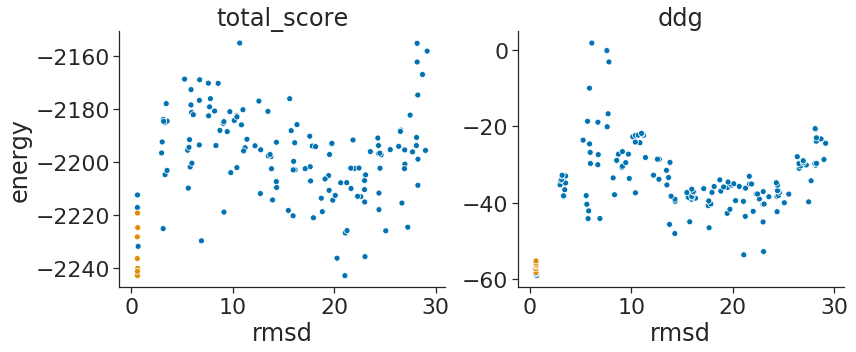

1HCF 1000 11


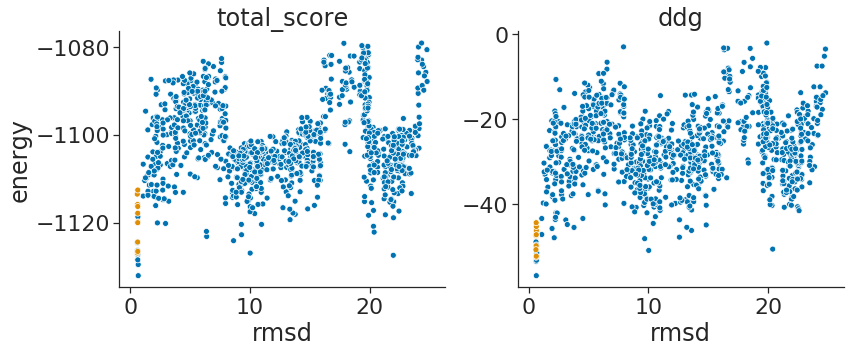

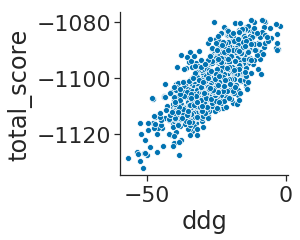

for optE 150 4


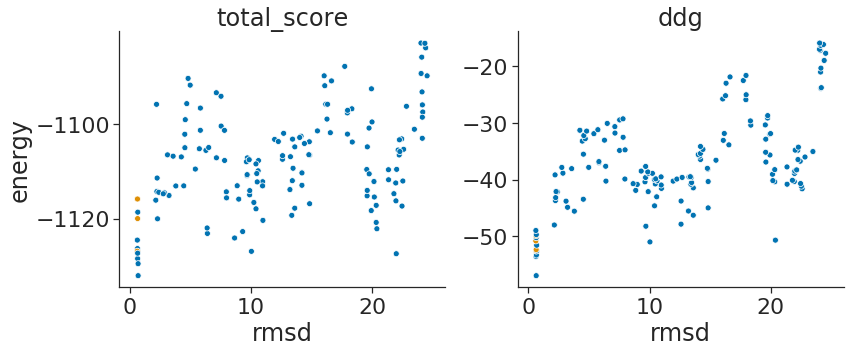

1IB1 1000 11


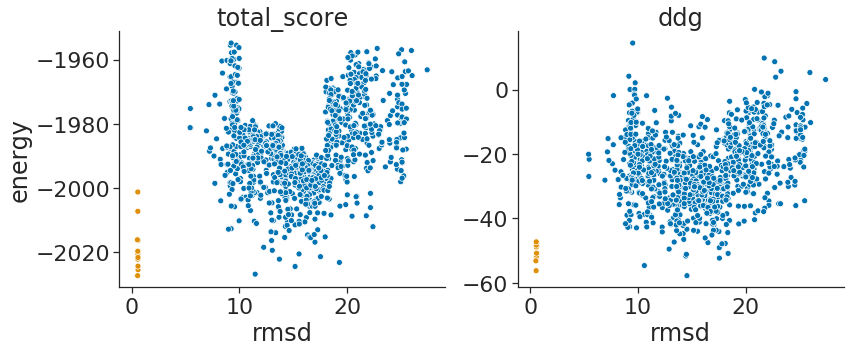

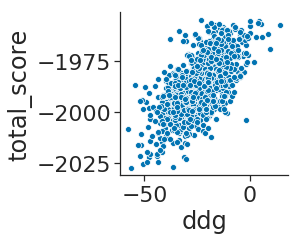

for optE 150 11


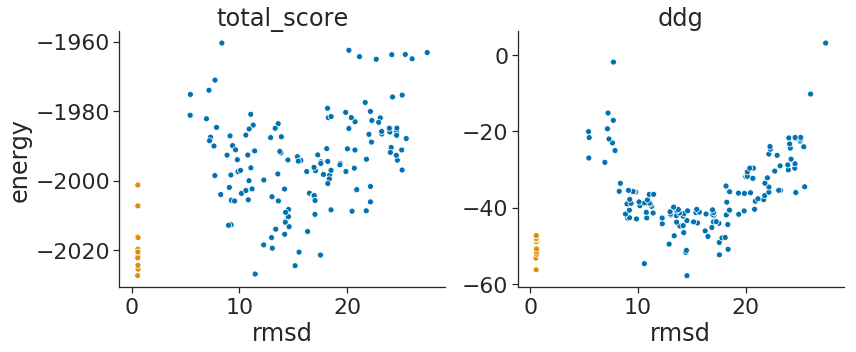

1J2J 1000 19


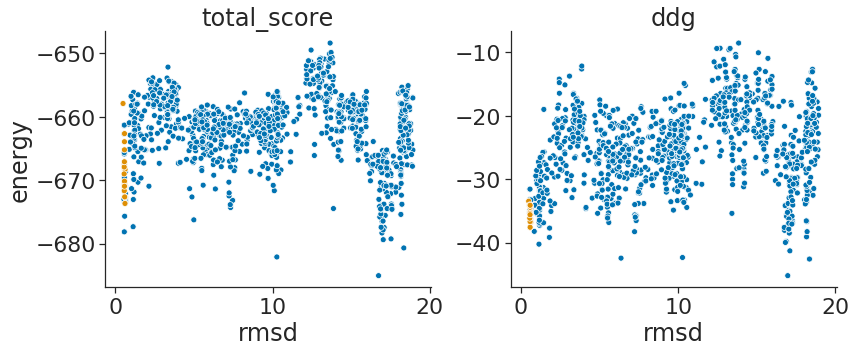

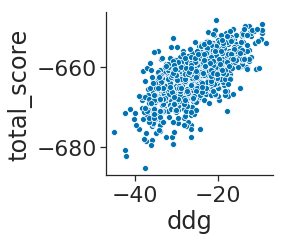

for optE 150 5


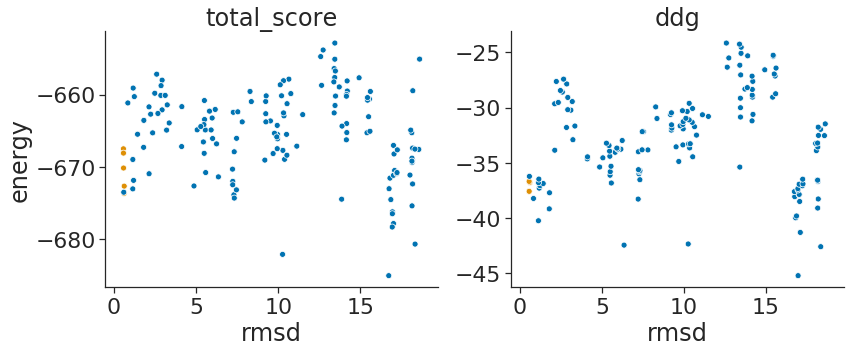

1JZD 1000 12


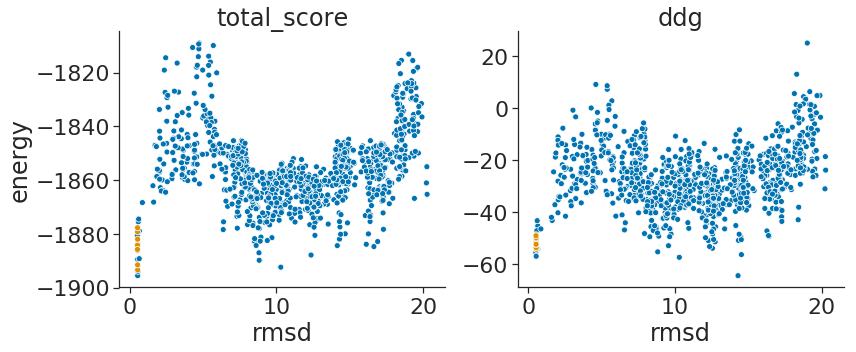

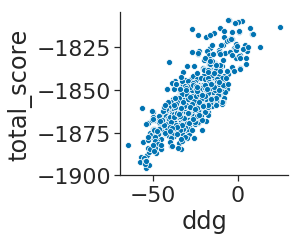

for optE 150 9


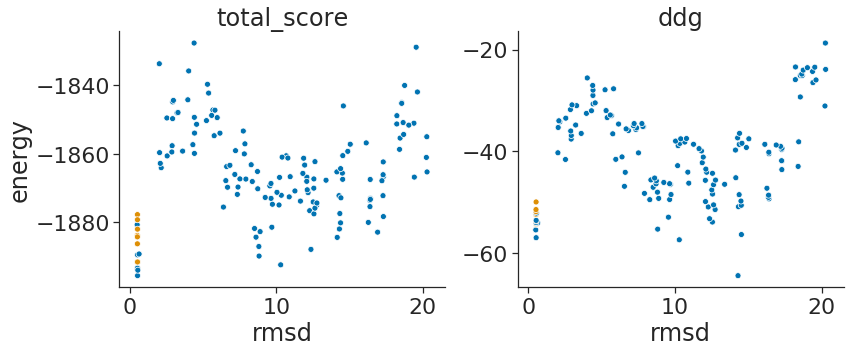

1K74 1006 13


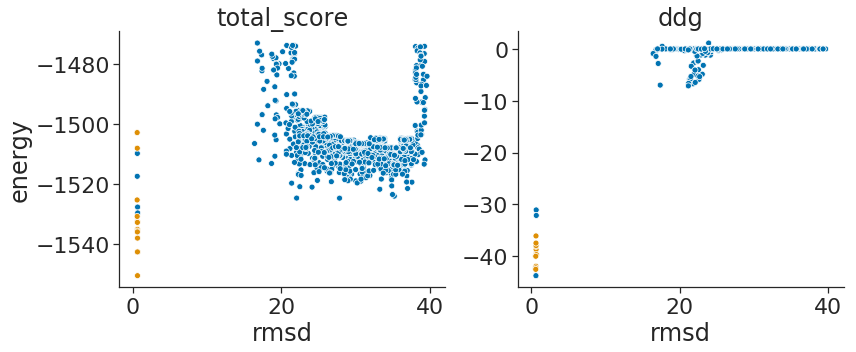

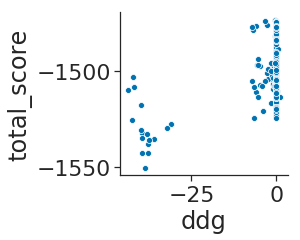

for optE 150 10


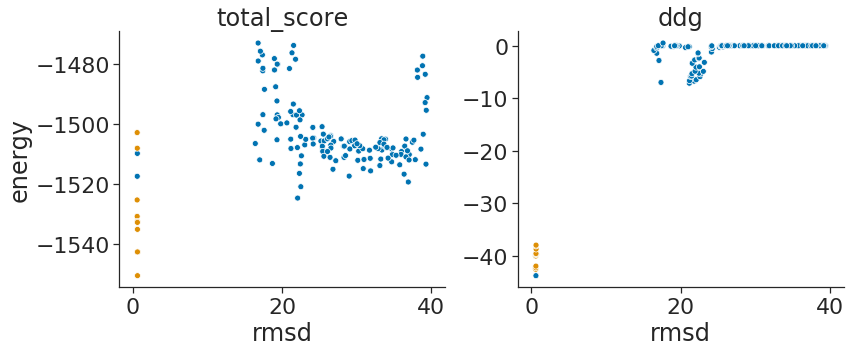

1KKL 1006 13


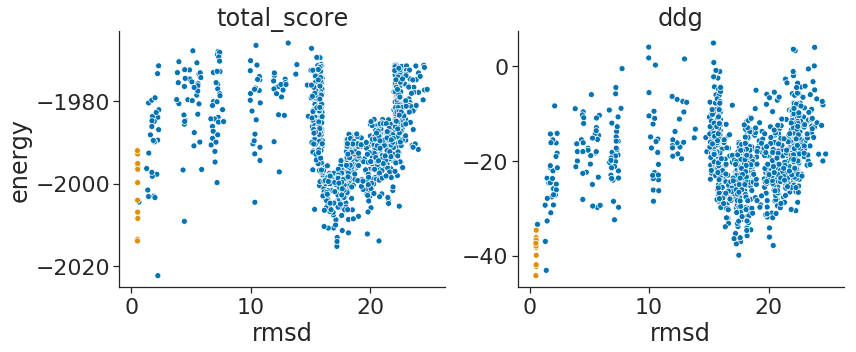

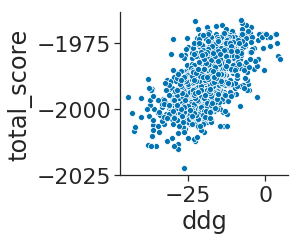

for optE 150 11


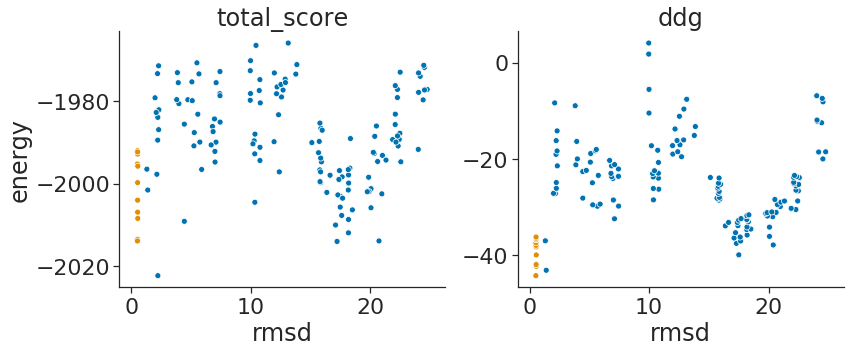

1M10 1000 14


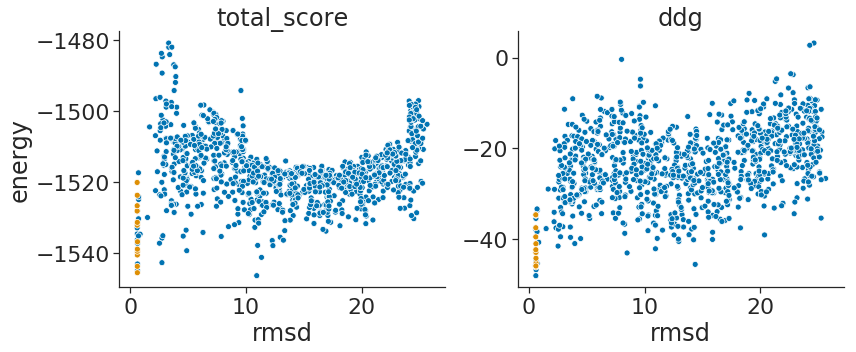

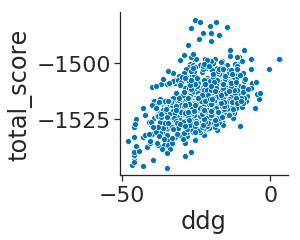

for optE 150 5


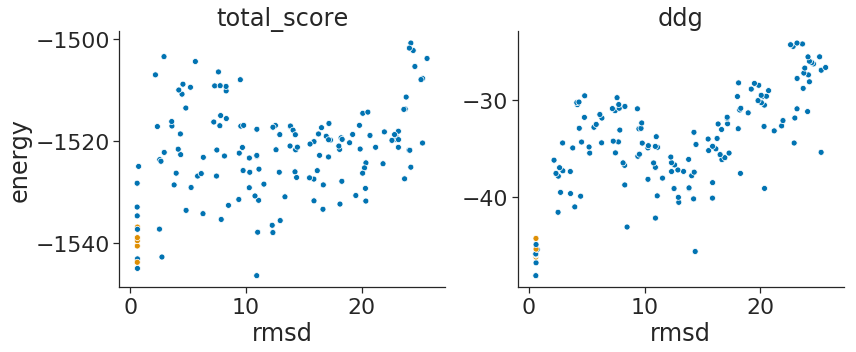

1NCA 1000 10


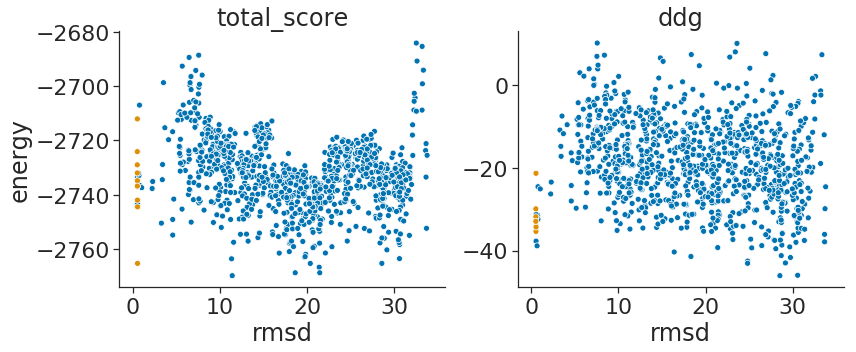

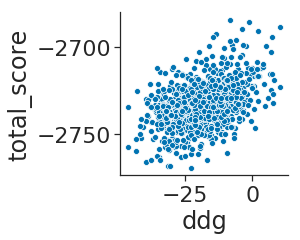

for optE 150 5


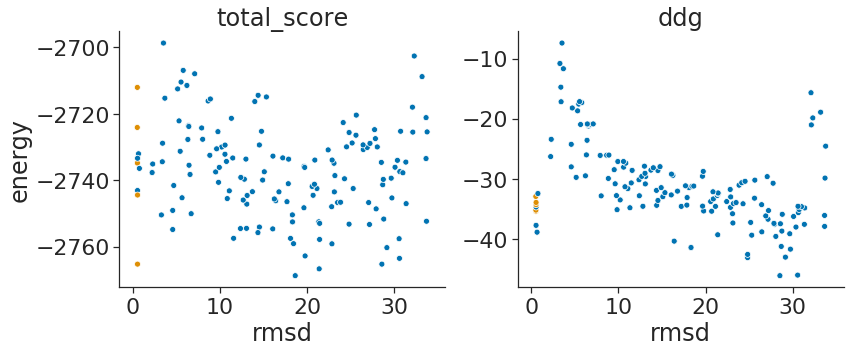

1NSN 1012 11


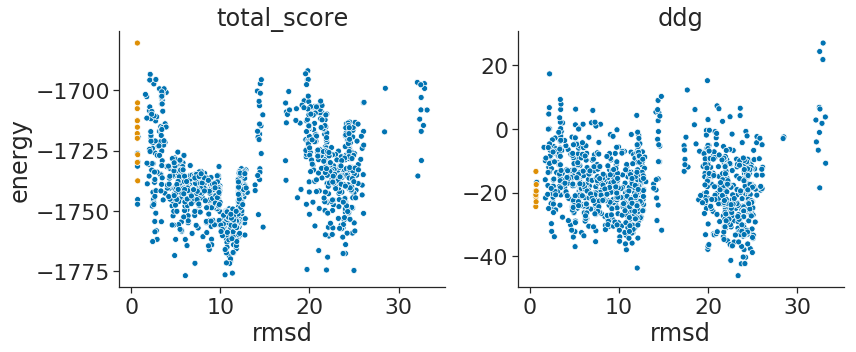

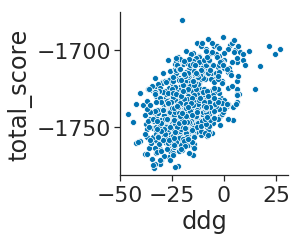

for optE 150 7


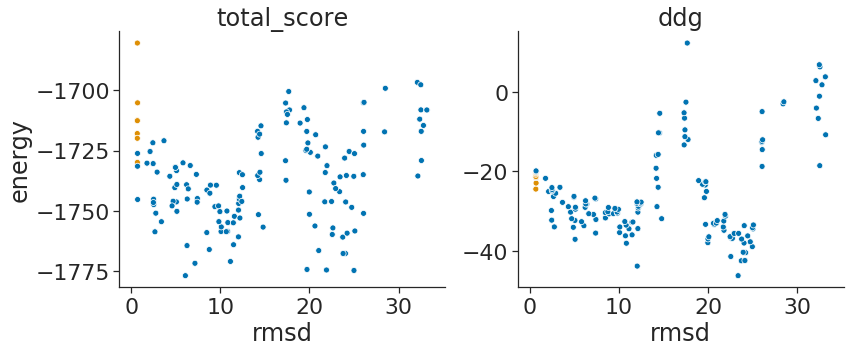

1OPH 1006 10


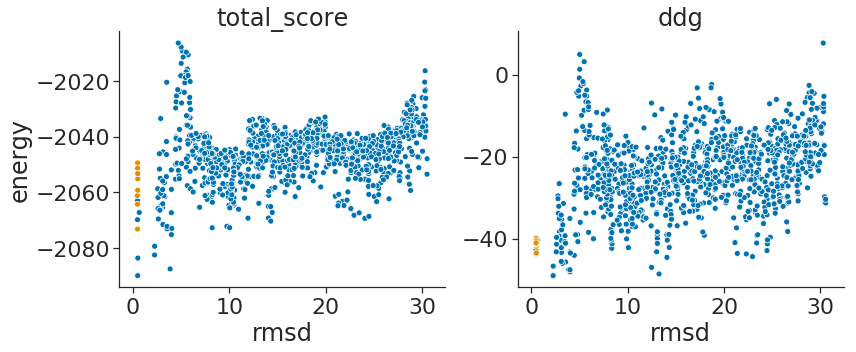

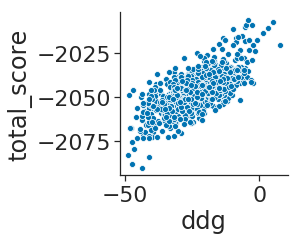

for optE 150 6


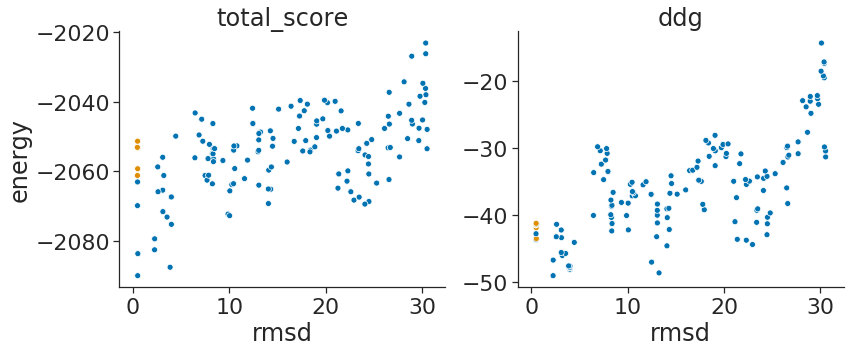

1QA9 1000 21


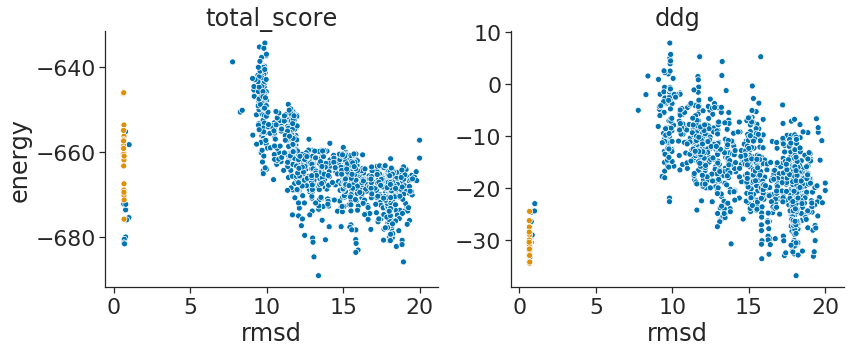

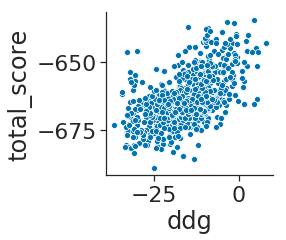

for optE 150 16


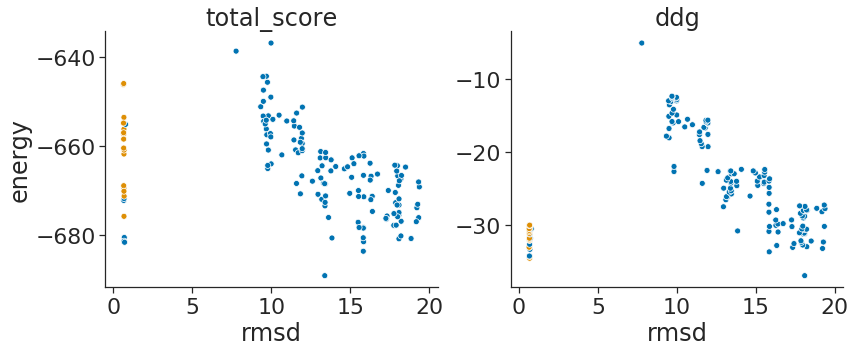

1R6Q 1000 30


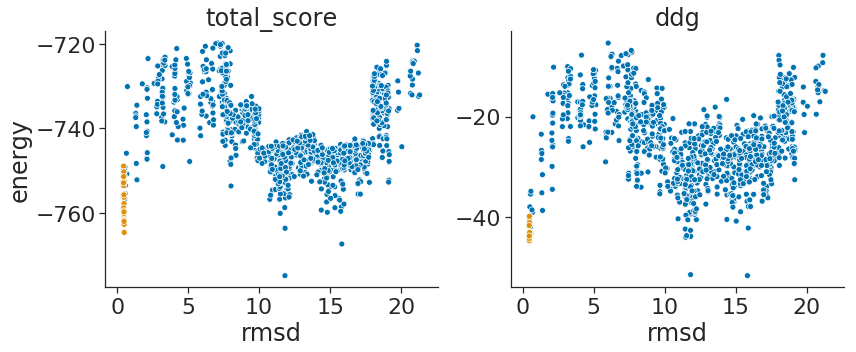

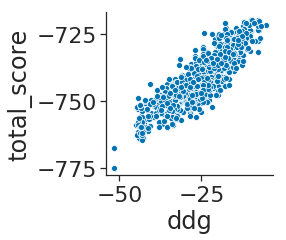

for optE 150 12


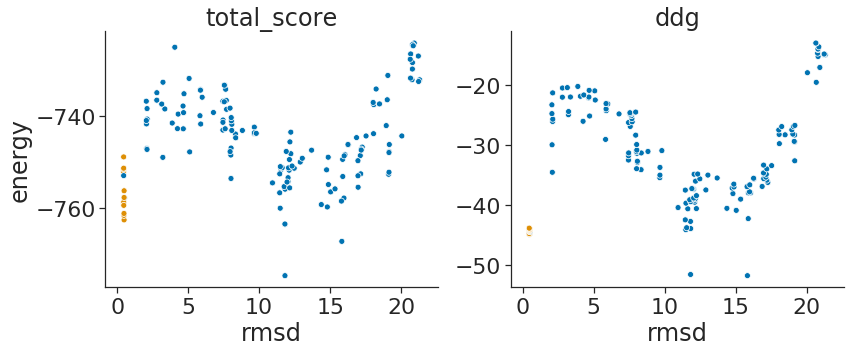

1RV6 1000 13


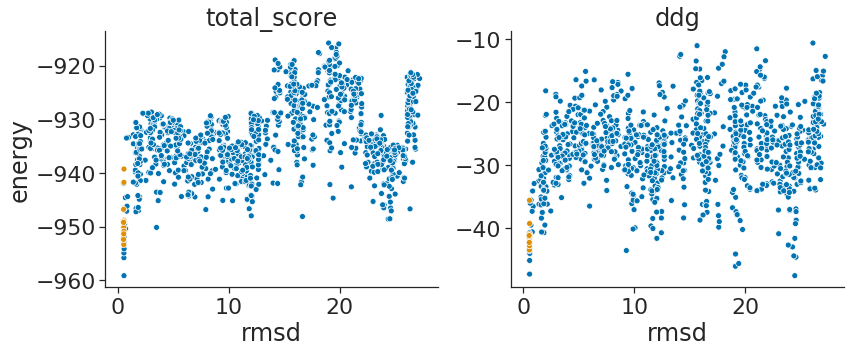

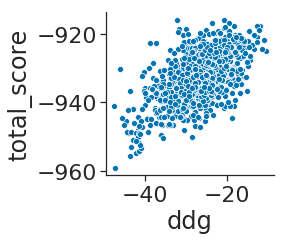

for optE 150 5


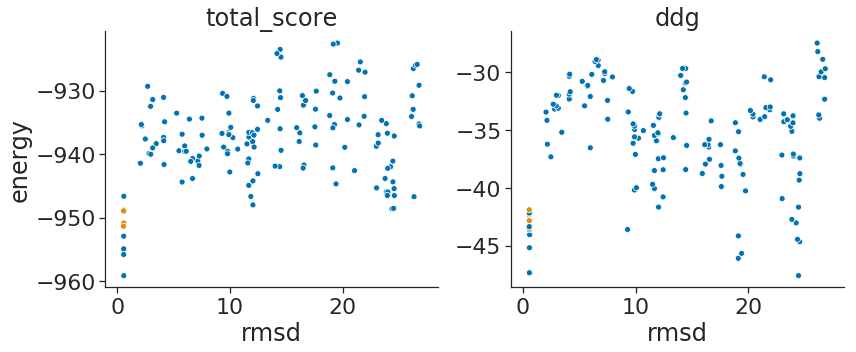

1SYX 1006 16


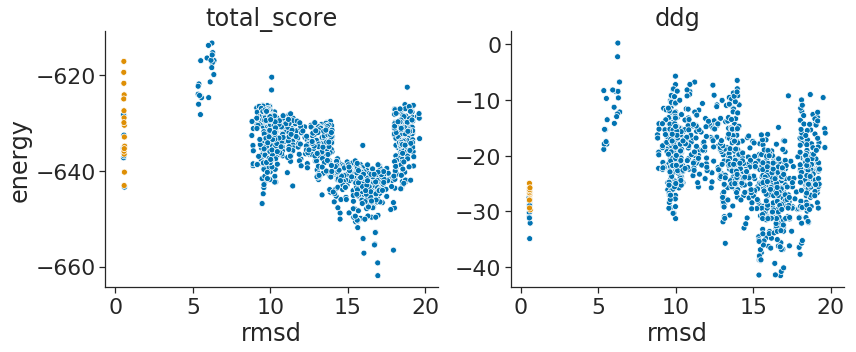

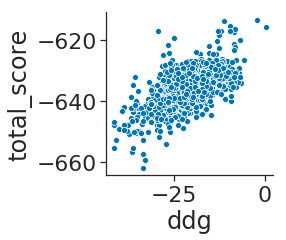

for optE 150 9


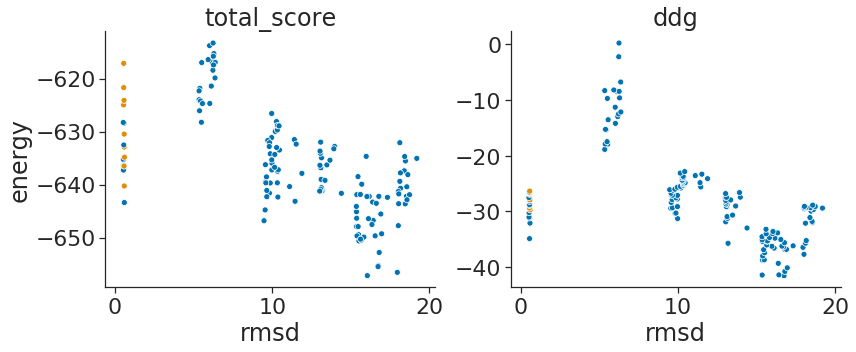

1US7 1000 11


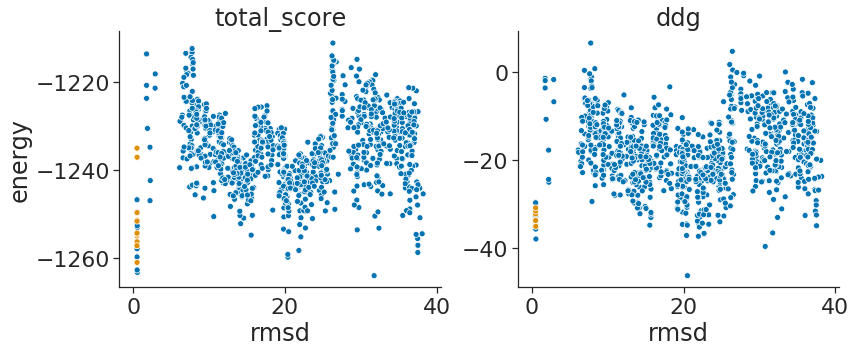

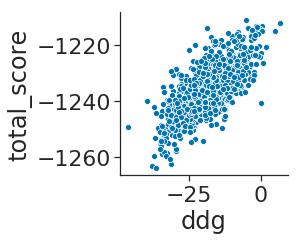

for optE 150 7


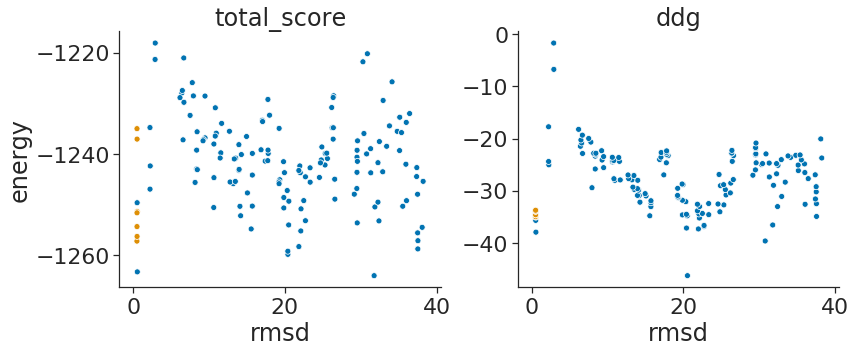

1XU1 1000 14


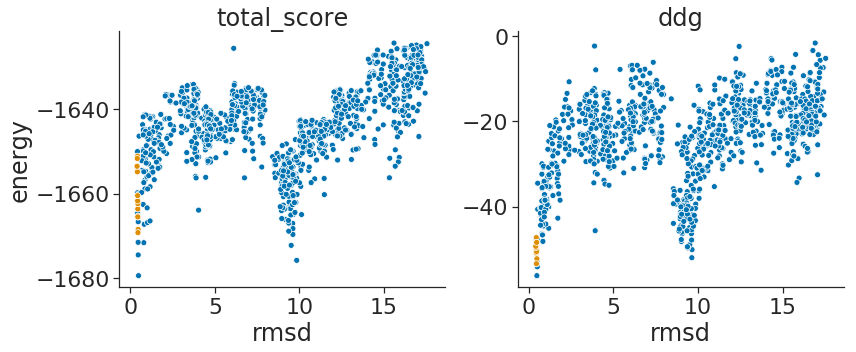

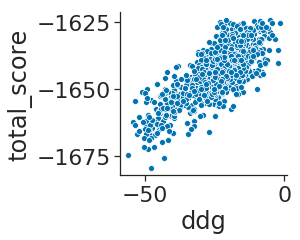

for optE 150 10


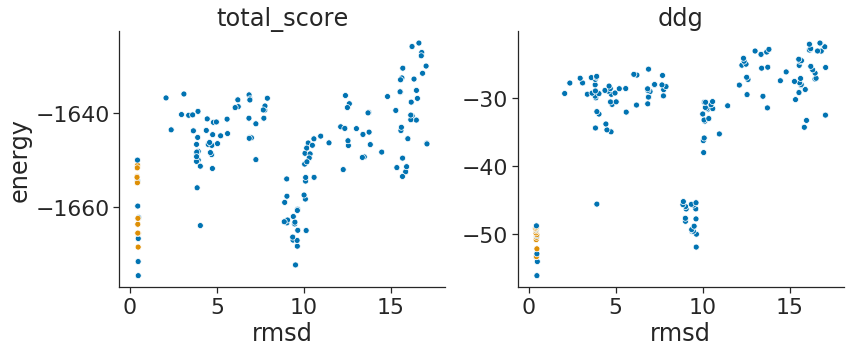

1Y64 1006 10


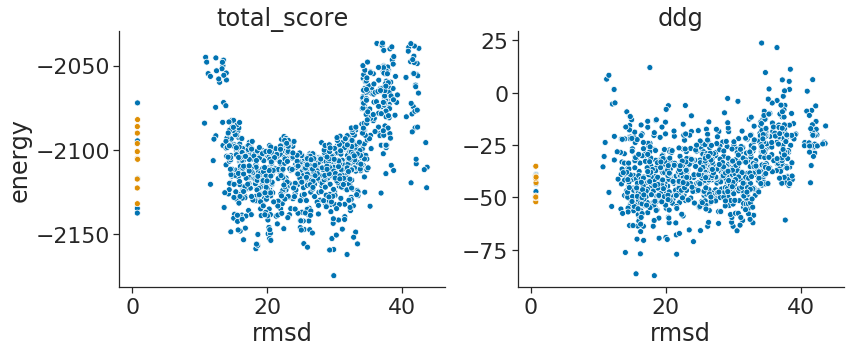

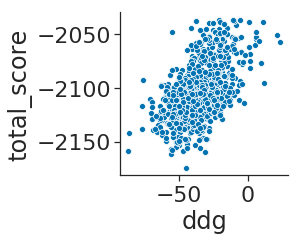

for optE 150 6


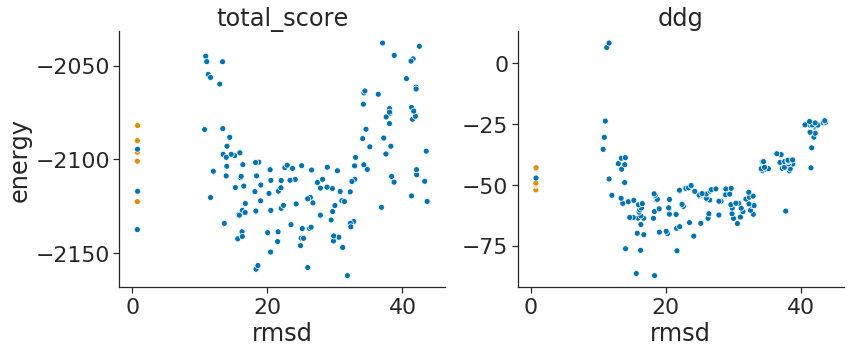

1YVB 1000 17


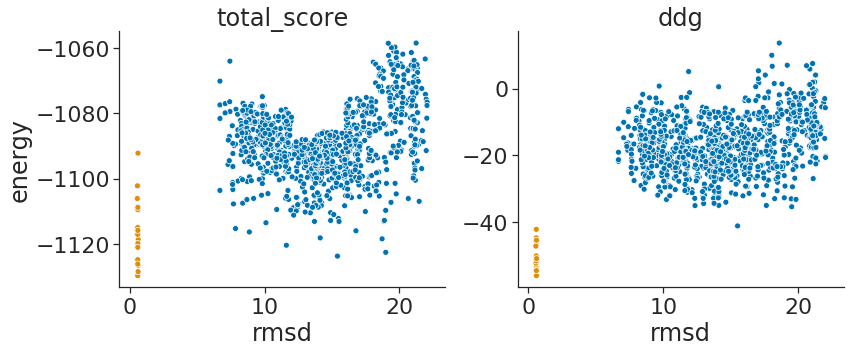

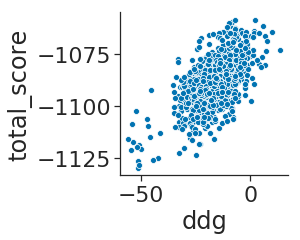

for optE 150 17


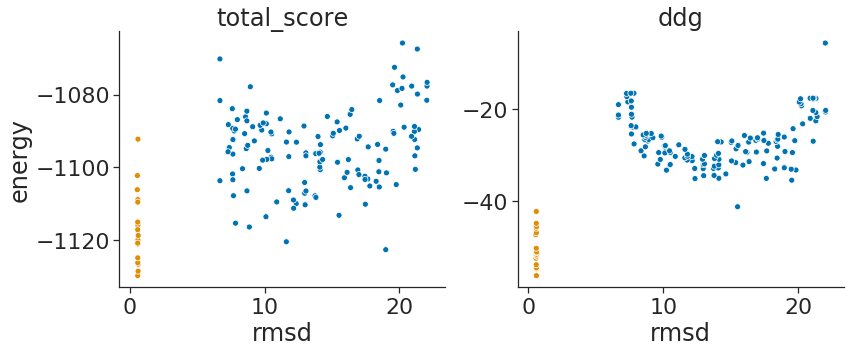

1Z5Y 1000 16


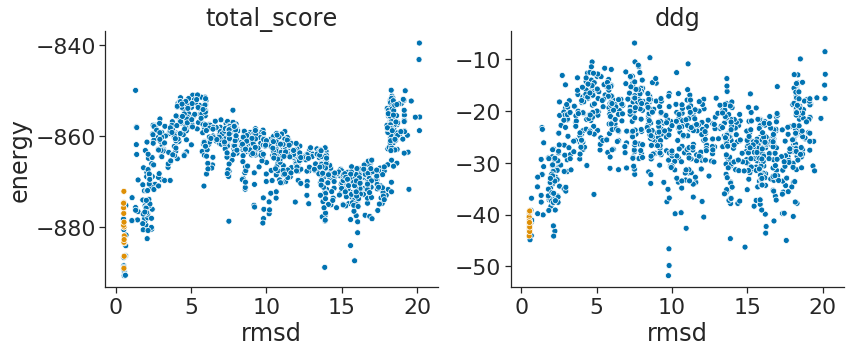

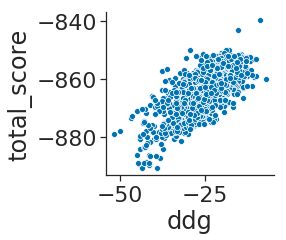

for optE 150 8


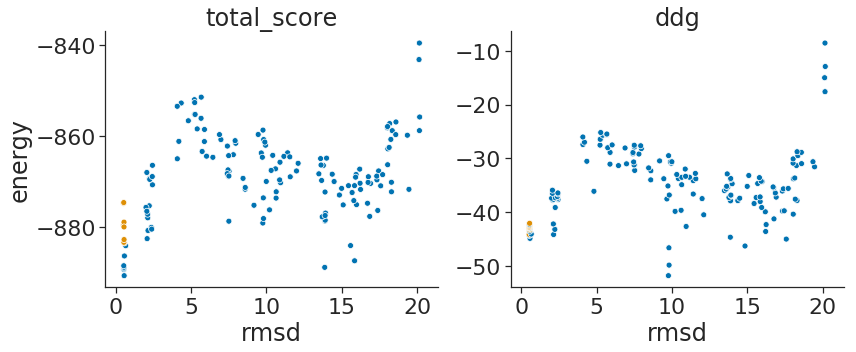

1ZHI 1000 16


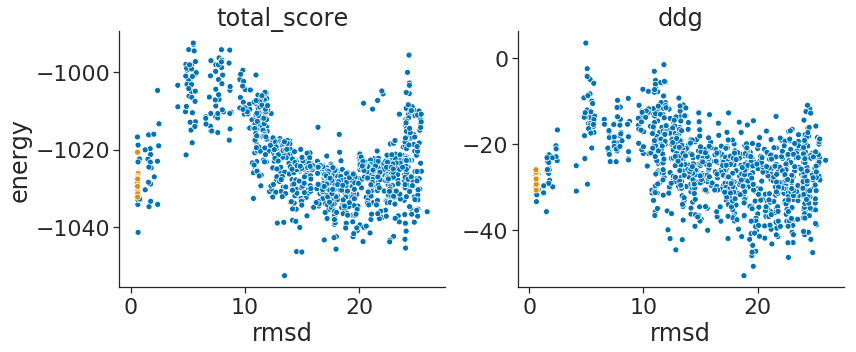

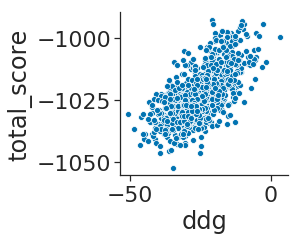

for optE 150 2


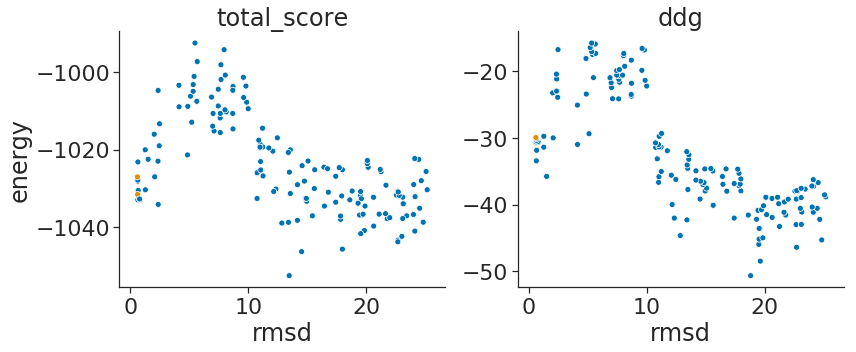

2A5T 1000 10


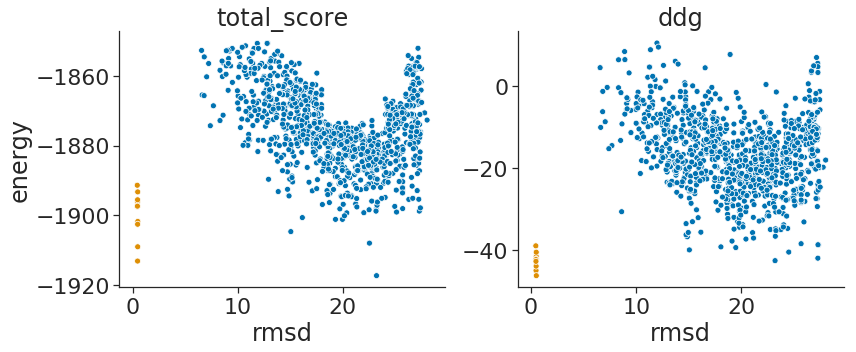

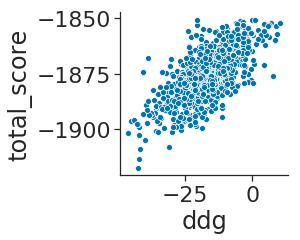

for optE 150 10


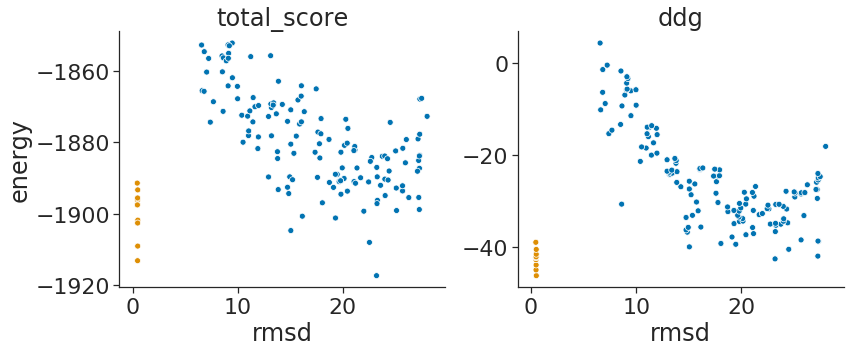

2ABZ 1000 14


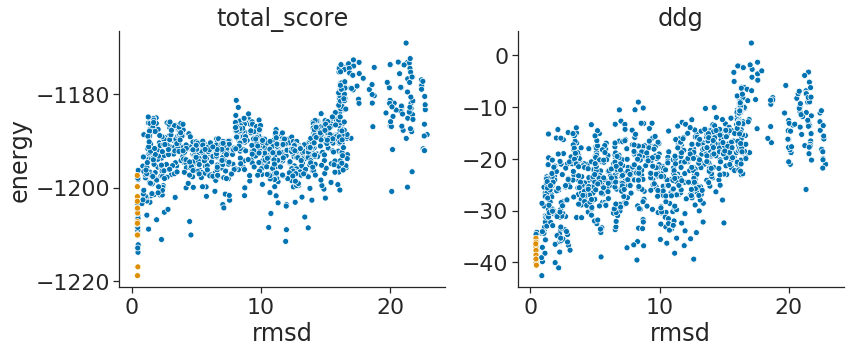

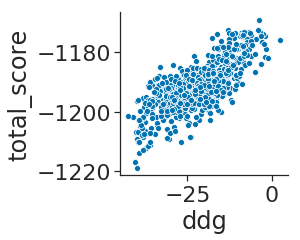

for optE 150 5


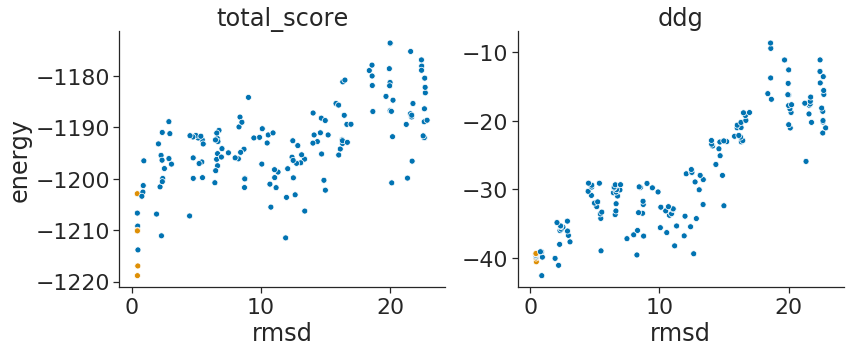

2AJF 1000 9


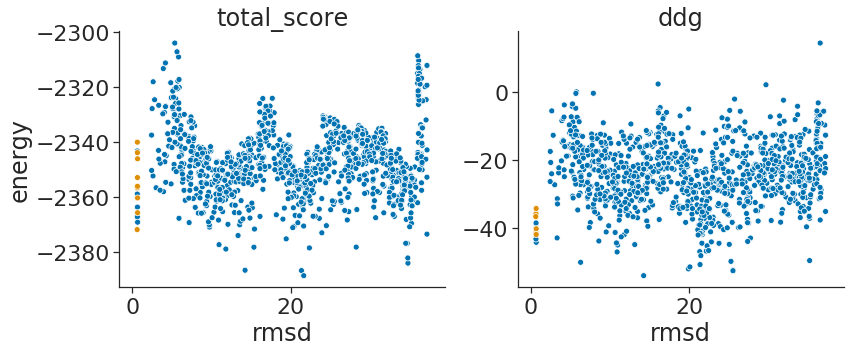

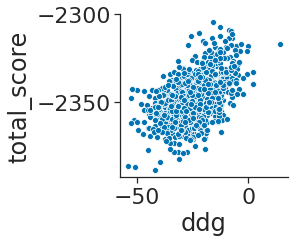

for optE 150 6


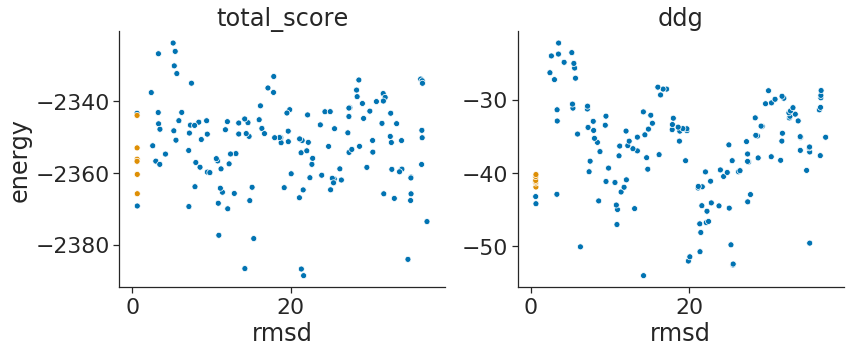

2AYO 1000 12


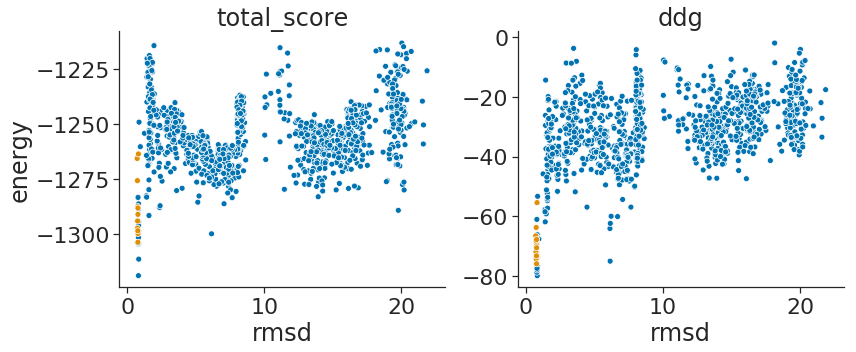

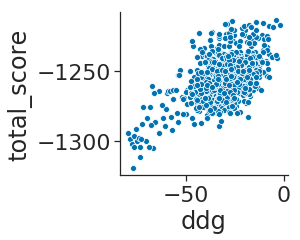

for optE 150 6


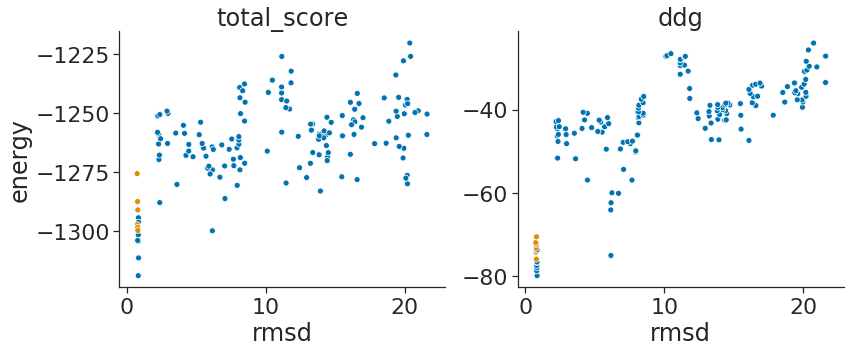

2CFH 1006 22


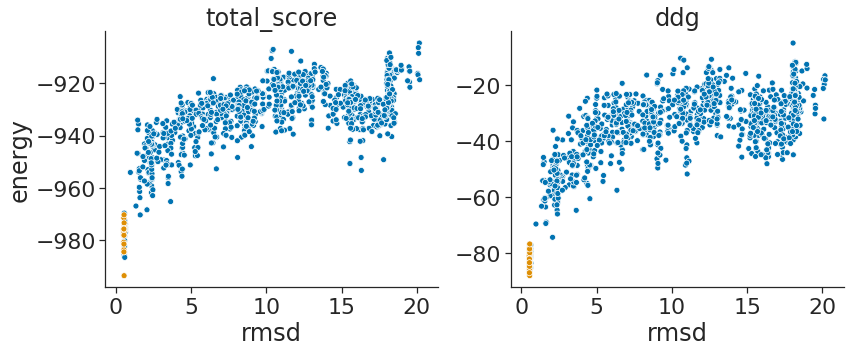

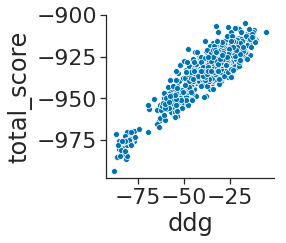

for optE 150 8


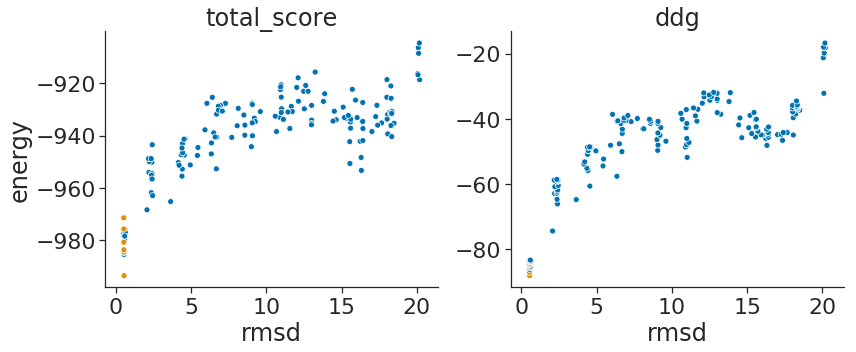

2HRK 1006 19


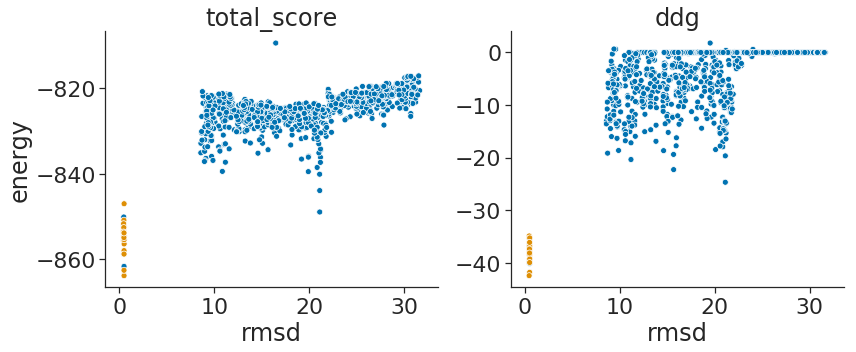

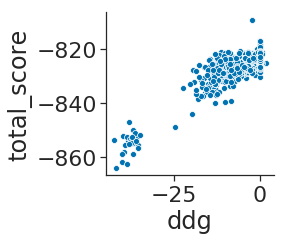

for optE 150 9


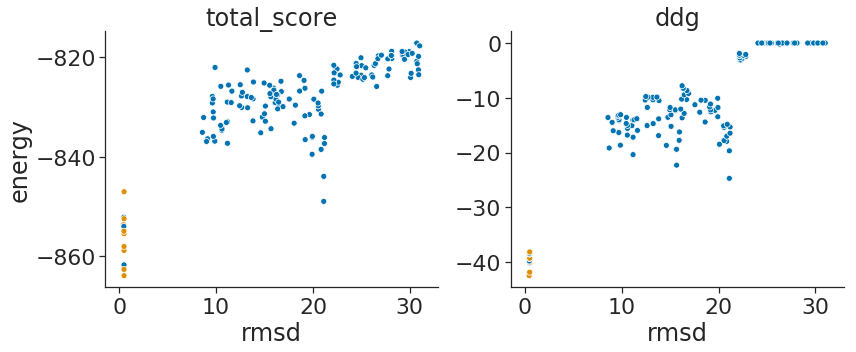

2I9B 1006 20


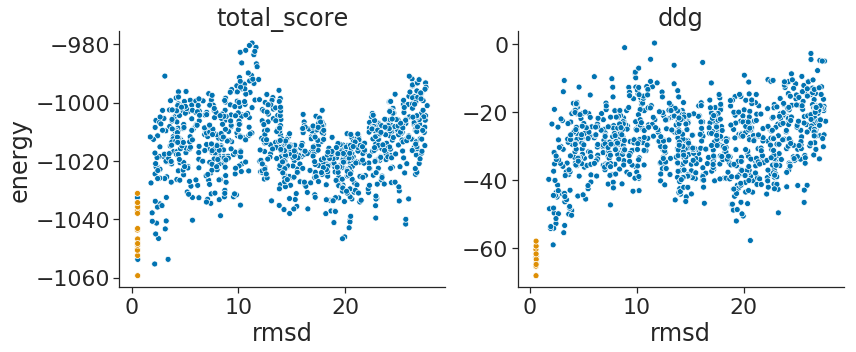

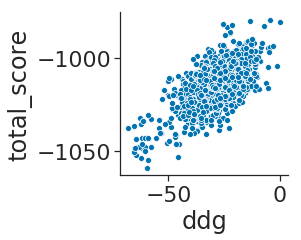

for optE 150 9


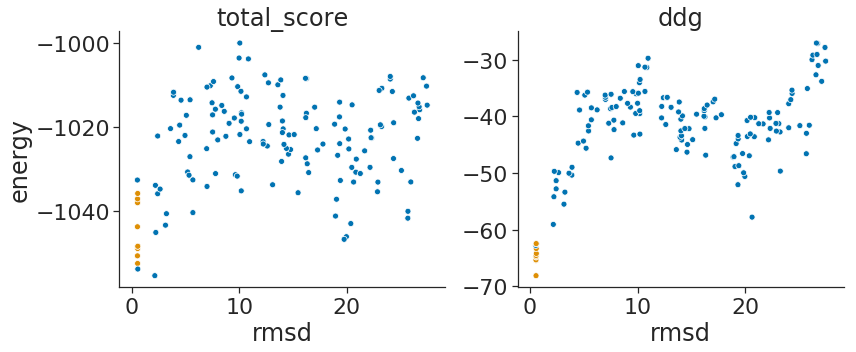

2JEL 1000 10


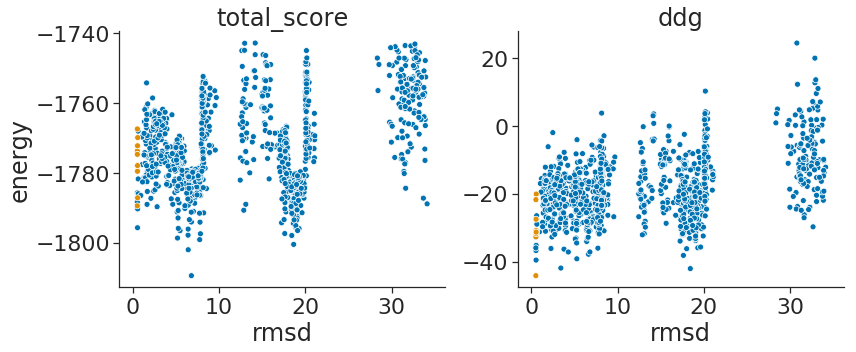

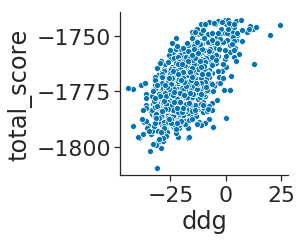

for optE 150 5


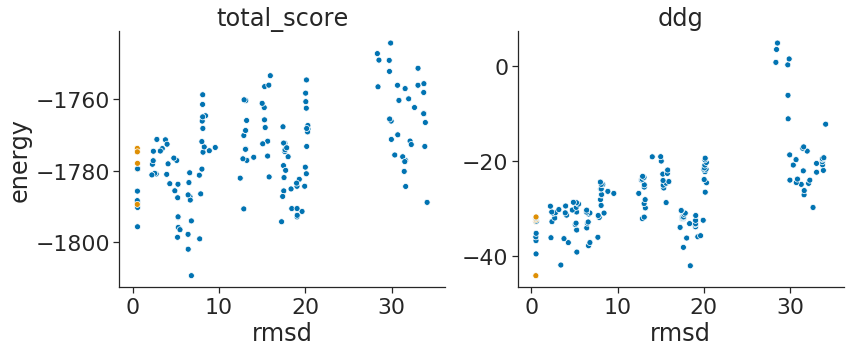

2MTA 1006 11


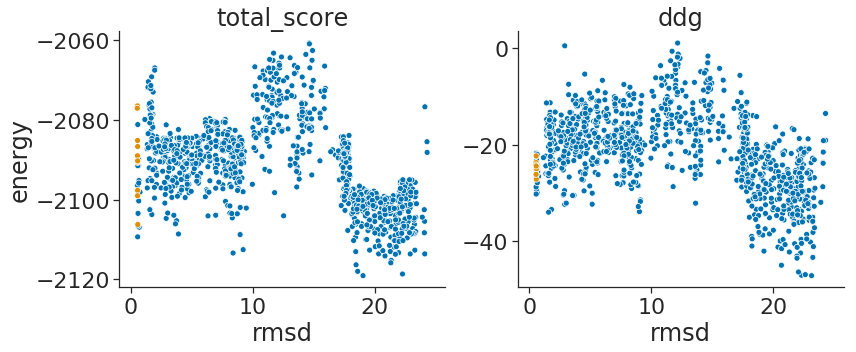

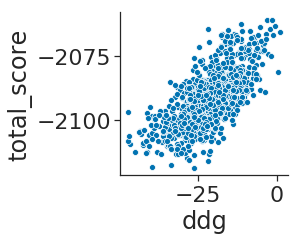

for optE 150 1


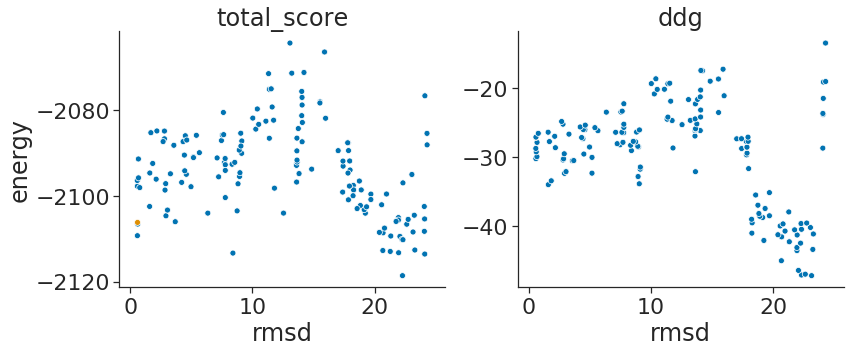

2O3B 1000 18


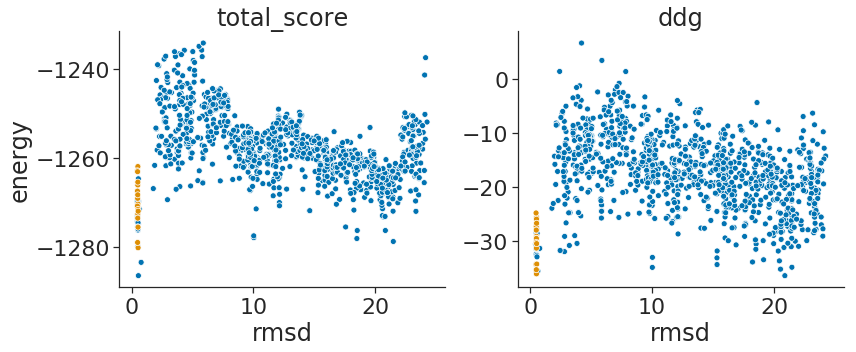

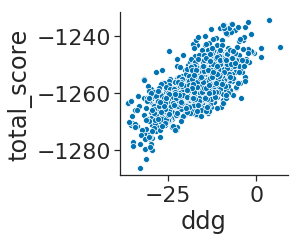

for optE 150 5


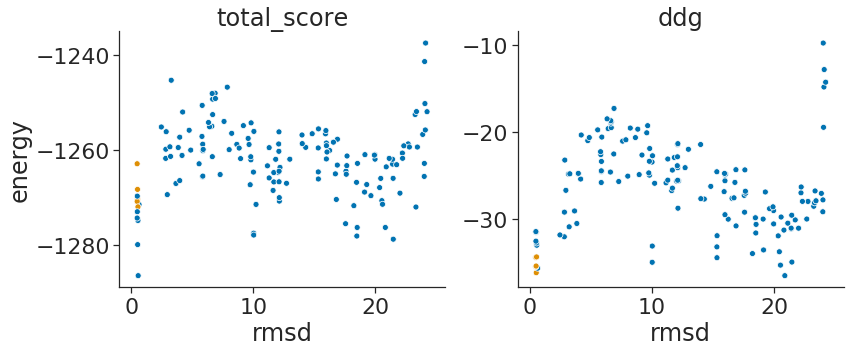

2O8V 803 15


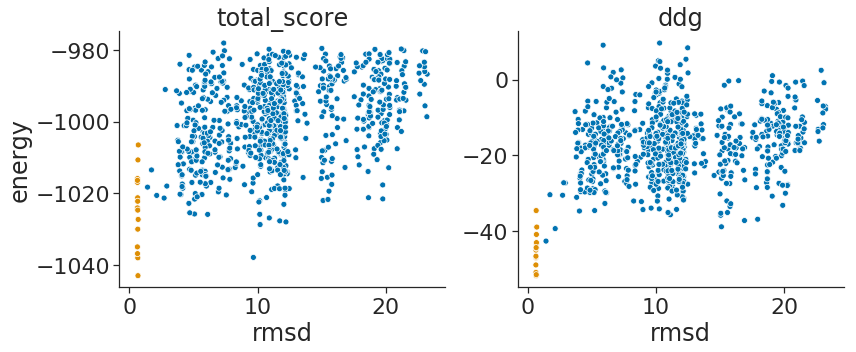

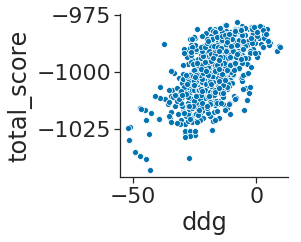

for optE 150 12


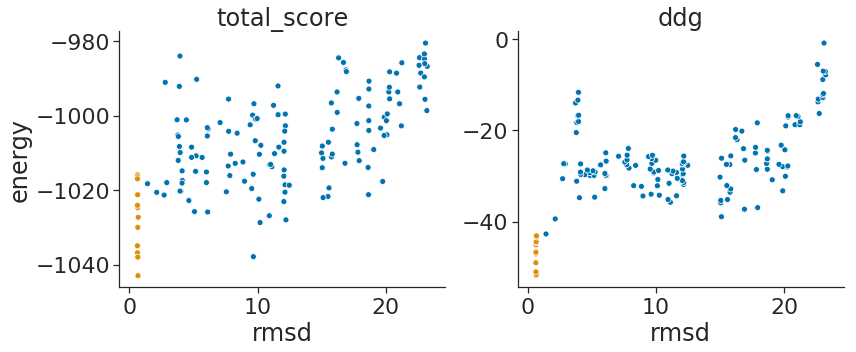

2OOB 933 39


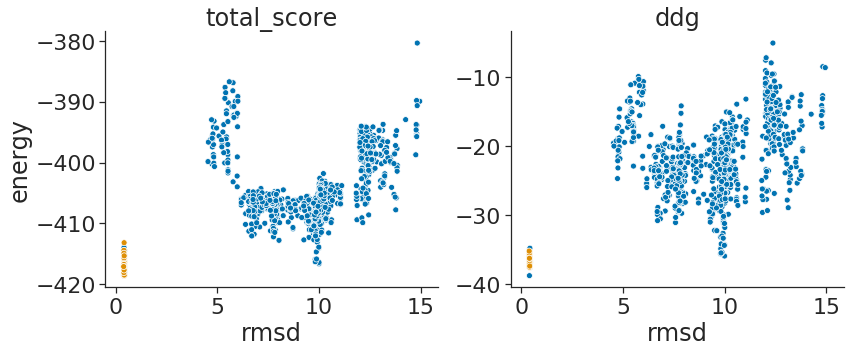

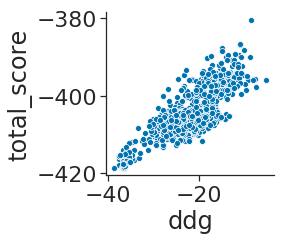

for optE 150 16


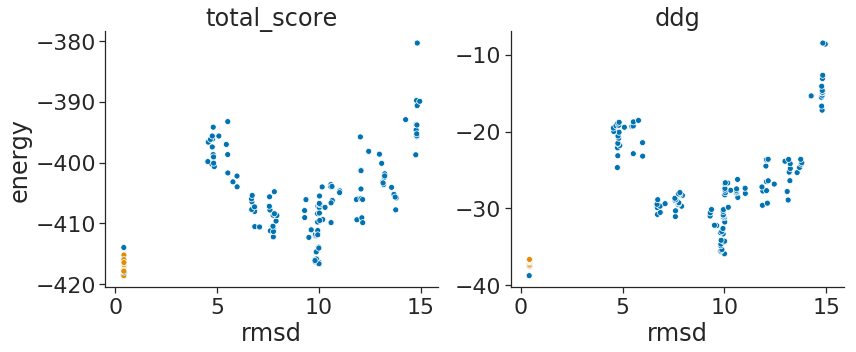

2PCC 1000 15


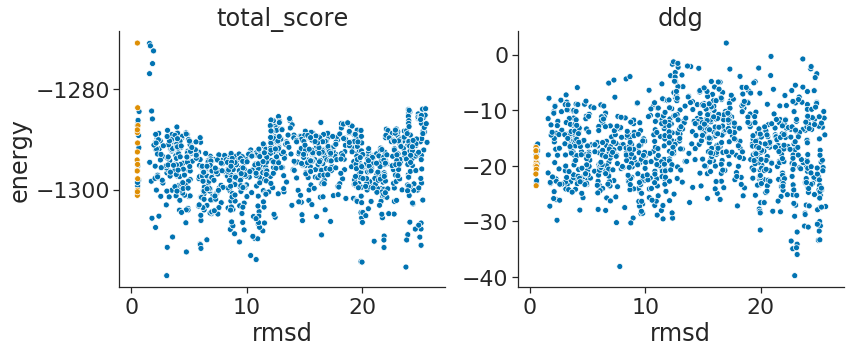

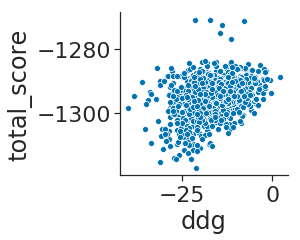

for optE 150 5


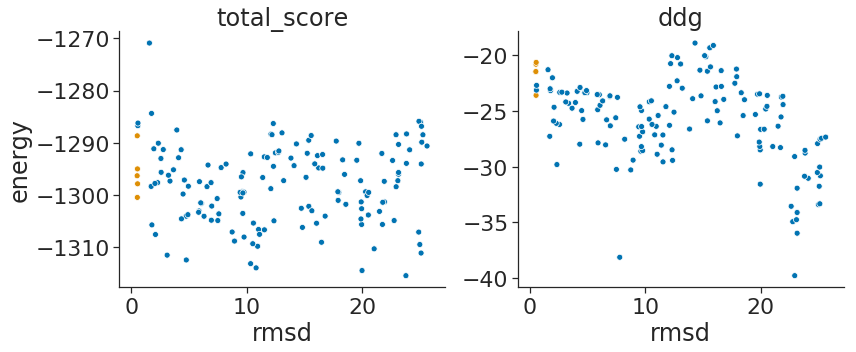

2UUY 1000 16


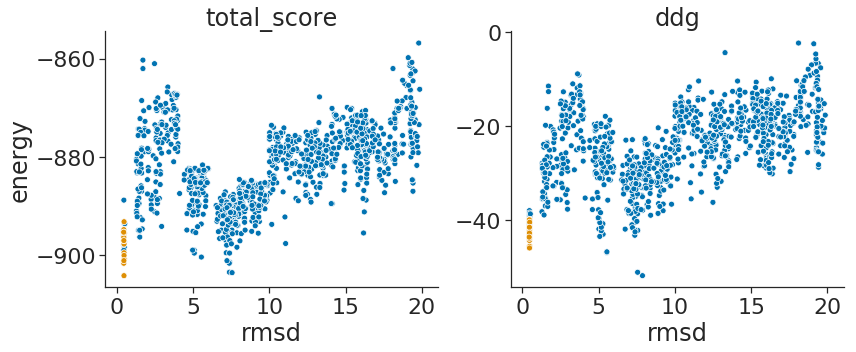

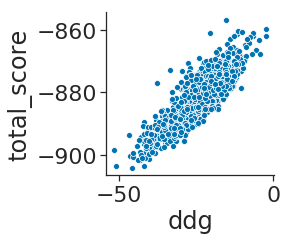

for optE 150 12


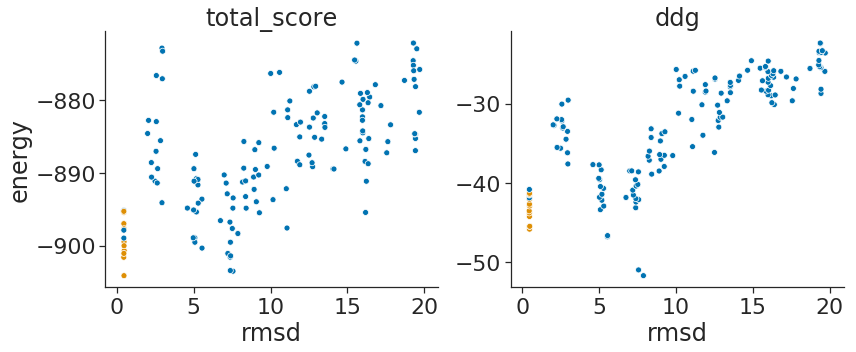

2VIS 1000 11


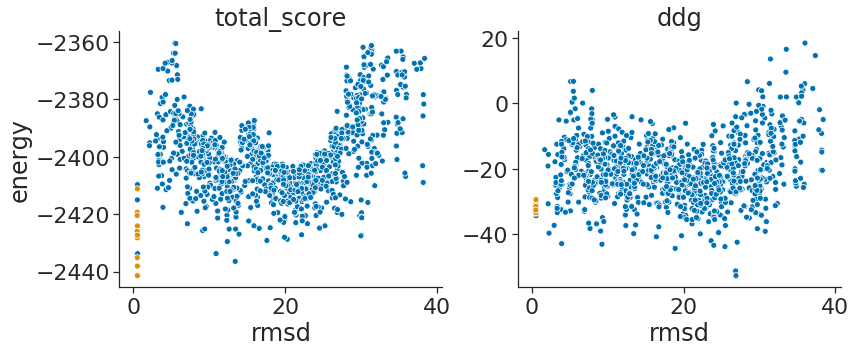

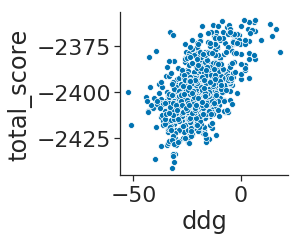

for optE 149 6


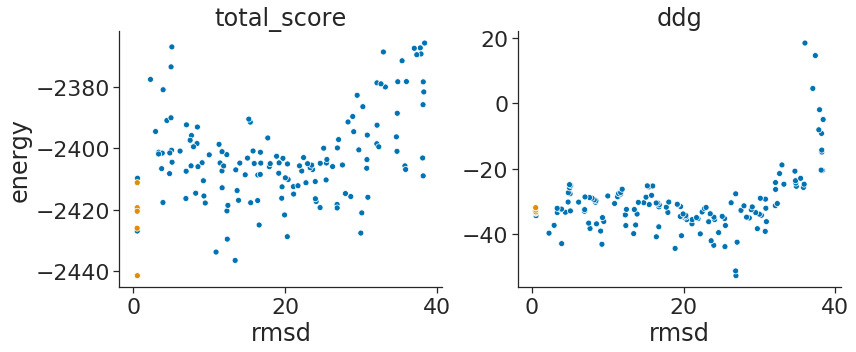

3CPH 1000 11


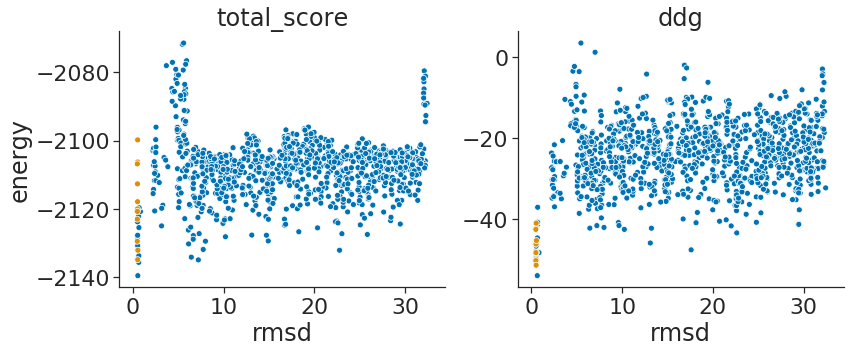

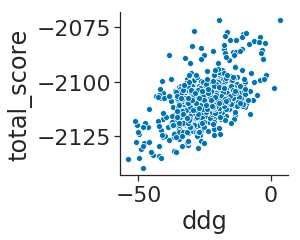

for optE 150 5


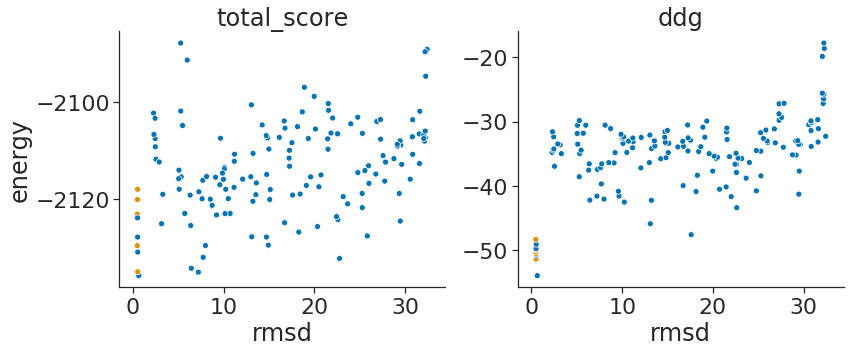

3D5S 999 18


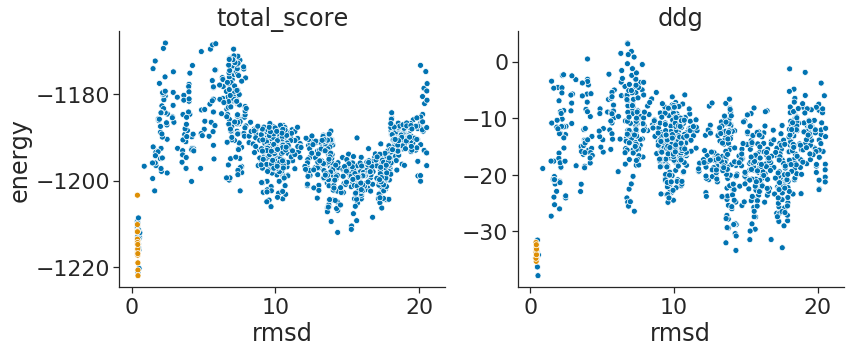

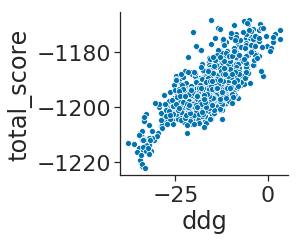

for optE 150 5


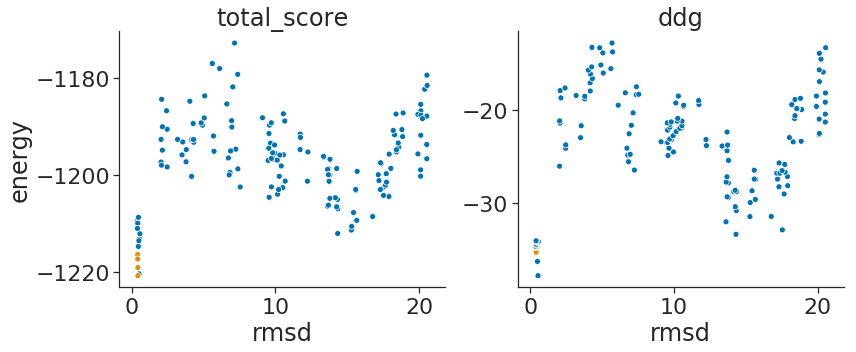

7CEI 1000 24


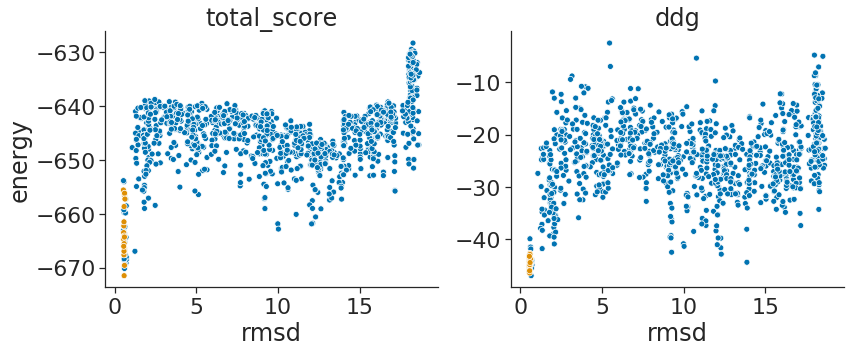

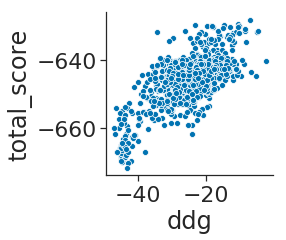

for optE 150 8


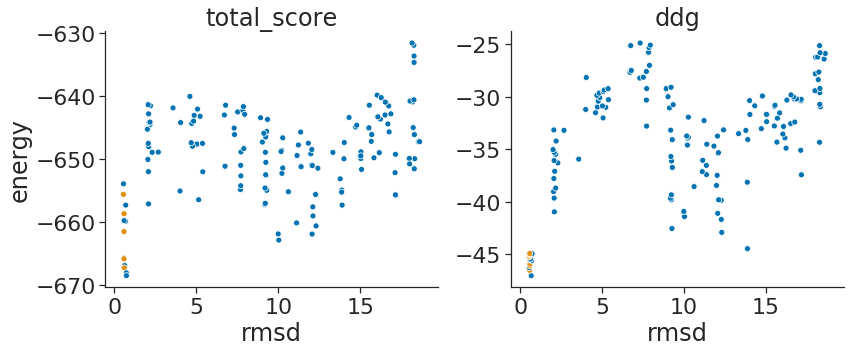

9QFW 1006 14


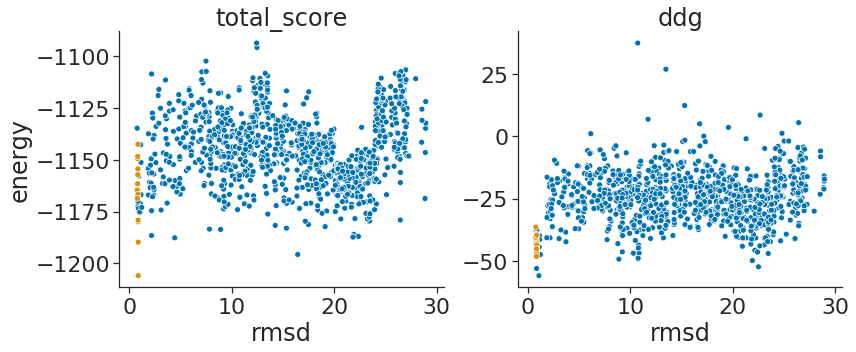

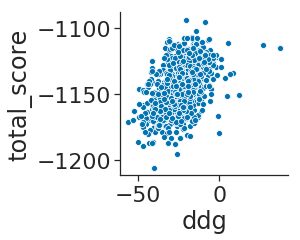

for optE 150 5


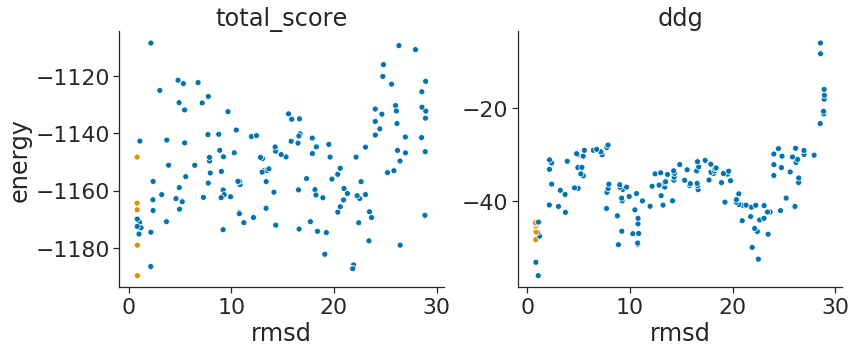

In [16]:
f_ids = ['complex', 'chainA', 'chainB']
relaxscript_name = 'MonomerDesign2019'
top_pdbs_results_dir = os.path.join(
    resultsdir,
    'silent_files_binned_top1000_noS/'
)
optE_results_dir = 'results/silent_files_for_optE_ddg_noS/'
if not os.path.isdir(optE_results_dir):
    os.makedirs(optE_results_dir)

# Cycle through natives one at a time, compute ddgs,
# and select decoys for optE
pdbs_for_optE_dict = {}
all_scores_files = []
ddg_dfs = []
make_out_files = True
for native in natives_to_score:
    
#     if native not in ['1BUH', '1AHW']:
#         continue
    
    # Read in data from different relax jobs
    n_fs = 0
    for f_id in f_ids:
        
        # Make a list of silent files
        fs = glob.glob(os.path.join(
            top_pdbs_results_dir,
            f'{native}_*_{f_id}.sc'
        ))
        n_fs += len(fs)
        if len(fs) == 0:
            continue
        
        # Concatenate all silent files into one for
        # downstream purposes
        if make_out_files:
            silent_fs = glob.glob(os.path.join(
                top_pdbs_results_dir,
                f'{native}_*_{f_id}.out'
            ))
            all_out_file = os.path.join(
                top_pdbs_results_dir,
                f'{native}_all_decoys_{f_id}.out'
            )
            if not os.path.isfile(all_out_file):
                print(f"{native}: concatenating {len(silent_fs)} silent files for {f_id}")
                cat_cmd = ' '.join(
                    ['cat'] + silent_fs + [f'> {all_out_file}']
                )
                subprocess.check_call(
                    cat_cmd, shell=True,
                )
        
        # Read in data
        dfs = []
        for f in fs:
            df = pandas.read_csv(f, skiprows=1, sep='\s+')
            dfs.append(df)
        df = pandas.concat(dfs, sort=False)
        if f_id == 'complex':
            ddg_df = df.copy()
        else:
            df[f_id] = df['total_score']
            ddg_df = ddg_df.merge(
                df[[f_id, 'description']],
                on='description', how='inner'
            )
#     if len(ddg_df) < 1000:
#         continue
    if n_fs == 0:
        continue

    # Identify relaxed natives
    ddg_df['decoy_type'] = ddg_df['description'].apply(
        lambda x: 'native' if 'xtal' in x else 'decoy'
    )
    ddg_df.sort_values('decoy_type', inplace=True)
    ddg_df['rms'] = ddg_df['rmsd']
    ddg_df['native'] = native
    ddg_df['pdb'] = ddg_df['description'].apply(os.path.basename)
        
    # Compute ddg from the total score of the relaxed complex
    # compared to the total score of each chain relaxed on its own
    ddg_df['ddg'] = \
        ddg_df['total_score'] - ddg_df['chainA'] - ddg_df['chainB']
    ddg_dfs.append(ddg_df)
    
    # Plot data for all ~1K relaxed structures
    print(native, len(ddg_df), sum(ddg_df['decoy_type'] == 'native'))
    (fig, axs) = plt.subplots(
        ncols=2, figsize=[12,5], sharex=True
    )
    ddg_df.sort_values('decoy_type', inplace=True)
    metrics = ['total_score', 'ddg']
    for (i, metric) in enumerate(metrics):
        sns.scatterplot(
            x='rmsd', y=metric, data=ddg_df, ax=axs[i],
            hue='decoy_type', hue_order=['decoy', 'native']
        )
        axs[i].set(ylabel='', title=metric)
        axs[i].get_legend().remove()
    axs[0].set(ylabel='energy')
    plt.tight_layout()
    sns.despine()
    plt.show()
    
    plt.figure(figsize=[3,3])
    sns.scatterplot(x='ddg', y='total_score', data=ddg_df)
    sns.despine()
    plt.show()
    if not make_out_files:
        continue
    
    # Select top ~150 decoys, spread roughly evenly across bins
    n_total_samples = 150
    max_rmsd = ddg_df['rms'].max()
    bin_size = 2 # Angstroms
    n_samples_per_bin = 50 # just to initially populate bins
    bin_mins = list(np.arange(0, max_rmsd+bin_size, bin_size))
    ddg_df.sort_values('ddg', inplace=True)
    binned_pdbs = {}
    for bin_min in bin_mins:
        data = ddg_df[
            (ddg_df['rms'].between(bin_min, bin_min+bin_size))
        ].copy()
        binned_pdbs[bin_min] = \
            list(data['description'][:n_samples_per_bin])

    # Downselect PDBs to test by cycling through bins and
    # choosing low-energy structures one per cycle.
    pdbs_for_optE = []
    for pdb_index in range(n_samples_per_bin):
        for bin_min in bin_mins:
            if len(binned_pdbs[bin_min]) < pdb_index+1:
                continue
            pdbs_for_optE.append(binned_pdbs[bin_min][pdb_index])
            if len(pdbs_for_optE) >= n_total_samples:
                break
        if len(pdbs_for_optE) >= n_total_samples:
            break
            
    # Decide whether or not to include all relaxed natives
    if False:
        relaxed_natives = set([
            pdb for pdb in ddg_df['description']
            if 'xtal' in pdb
        ])
        pdbs_for_optE = list(set.union(
            set(pdbs_for_optE),
            relaxed_natives
        ))
    pdbs_for_optE_dict[native] = pdbs_for_optE
    
    # Write file with scores
    data = ddg_df[ddg_df['description'].isin(pdbs_for_optE)]
    score_file = os.path.join(optE_results_dir, f'{native}.sc')
    data.to_csv(score_file, index=False, sep='\t')
    all_scores_files.append(score_file)
    
    # Plot data for all ~150 decoys relaxes
    print('for optE', len(data), sum(data['decoy_type'] == 'native'))
    (fig, axs) = plt.subplots(
        ncols=2, figsize=[12,5], sharex=True
    )
    metrics = ['total_score', 'ddg']
    for (i, metric) in enumerate(metrics):
        sns.scatterplot(
            x='rmsd', y=metric, data=data, ax=axs[i],
            hue='decoy_type', hue_order=['decoy', 'native']
        )
        axs[i].set(ylabel='', title=metric)
        axs[i].get_legend().remove()
    axs[0].set(ylabel='energy')
    plt.tight_layout()
    sns.despine()
    plt.show()
    
    # Make a single silent file with just the ~150 decoys
    # for optE
    tags_file = os.path.join(
        optE_results_dir,
        f'{native}_tags_for_optE.txt'
    )
    if not os.path.isfile(tags_file):
        with open(tags_file, 'w') as f:
            for pdb in pdbs_for_optE:
                f.write(f'{pdb}\n')
    for f_id in f_ids:
        all_out_file = os.path.join(
            top_pdbs_results_dir,
            f'{native}_all_decoys_{f_id}.out'
        )
        optE_silent_file = os.path.join(
            optE_results_dir,
            f'{native}_{f_id}.out'
        )
        cmd = ' '.join([
            f'cat {tags_file} |',
            f'/home/haddox/software/silent_tools/silentslice {all_out_file} >',
            optE_silent_file
        ])
        out = subprocess.check_call(cmd, shell=True)
        
# Make a big dataframe with all ddg values
ddg_df = pandas.concat(ddg_dfs, sort=False)

# Write a file that lists all score files
for metric in ['total_score', 'ddg']:
    if not make_out_files:
        continue
    temp_f = f'results/temp_optE_{relaxscript_name}_{metric}.docking'
    out_f = \
        f'results/score_docking_result_optE_input_{metric}'
    with open(temp_f, 'w') as f:
        for score_file in all_scores_files:
            f.write(f'{score_file}\n')
    cmd = ' '.join([
        'scripts/calc1dboltzmann.pl',
        '0.1',
        metric,
        temp_f,
        f'> {out_f}'
    ])
    ! {cmd}

ddg results/score_docking_result_optE_input_ddg
old avg 0.71
new avg 0.45
N landscapes = 54


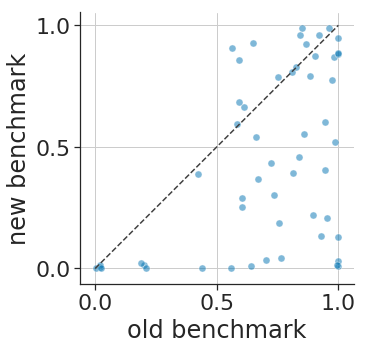

In [17]:
# Read in docking results from old benchmark
metric = 'ddg'
out_f = \
    f'results/score_docking_result_optE_input_{metric}'
print(metric, out_f)

result_file = os.path.join(
    '/home/haddox/2019/optE_eval/results/beta_nov16/',
    'nolayer_nostab_0/opt_1/score_docking_result'
)
old_df = pandas.read_csv(
    result_file, sep='\s+',
    skiprows=2, names=['pdb', 'score']
)
old_df['pdb'] = old_df['pdb'].apply(
    lambda x: os.path.basename(x).split('.')[0]
)

# Read in docking results from new benchmark
new_df = pandas.read_csv(
    out_f, sep='\s+',
    skiprows=2, names=['pdb', 'score']
)
new_df['pdb'] = new_df['pdb'].apply(
    lambda x: os.path.basename(x)[:4]
)

# Merge and plot data
new_df = new_df.merge(
    old_df, on='pdb', suffixes=['_new', '_old']
)
data = new_df[
    ~new_df['pdb'].isin([
        '9QFW', # no near-natives?
        '1FQJ', # no near-natives?
        '2O8V', # problem with ddg protocol?
        '1F6M', # problem with ddg protocol?
        '1FC2', # problem with ddg protocol?
        '1Z5Y', # problem with ddg protocol?
        '2HRK', # problem with ddg protocol?
        '1K74', # something weird going on
        
    ])
].copy()
print('old avg', round(data['score_old'].mean(), 2))
print('new avg', round(data['score_new'].mean(), 2))
print('N landscapes =', len(data))
fig = plt.figure(figsize=[5,5])
ax = fig.add_subplot(111)
ax.plot(
    [0, 1], [0, 1],
    c='0.25', ls='--'
)
sns.scatterplot(
    x='score_old', y='score_new', data=data,
    s=50, alpha=0.5
)
ax.grid()
ax.set(
    xticks=[0, 0.5, 1], yticks=[0, 0.5, 1],
    xlabel='old benchmark', ylabel='new benchmark'
)
ax.set_aspect('equal', adjustable='box')
sns.despine()
plt.show()

In [18]:
new_df.sort_values('score_new')

,pdb,score_new,score_old
8,1E6E,0.000115,0.440917
55,2PCC,0.000309,0.207435
39,1Y64,0.000801,0.002600
51,2MTA,0.001895,0.024024
42,1ZHI,0.002803,0.558749
10,1EWY,0.004642,0.021300
2,1AKJ,0.008295,0.996992
37,1US7,0.009180,0.639454
20,1GLA,0.013059,0.201012
45,2AJF,0.013446,0.996086


In [19]:
native = '9QFW'
data = ddg_df[ddg_df['native'] == native].copy()
data.sort_values('ddg', inplace=True)
display(data[['ddg', 'total_score', 'rms', 'pdb']].head())

working_dir = optE_results_dir
for f_id in ['complex']: # , 'chainA', 'chainB']:
    silent_file = f'{native}_{f_id}.out'
    tags = [data['description'].iloc[0]]
    design_utils.extract_pdbs_from_silent_file(
        working_dir,
        silent_file,
        extra_args=[
            '-in:file:silent_struct_type binary',
            f'-suffix _{f_id}'
        ],
        tags=tags,
        output_dir=False
    )
    time.sleep(5)
    for tag in tags:
        #shutil.copy(f'{tag}_{f_id}.pdb', optE_results_dir)
        shutil.copy(f'{tag}.pdb', optE_results_dir)

,ddg,total_score,rms,pdb
610,-55.970,-1171.094,1.074,HKH_2021_9QFW_run_1_complex.218_chain_B_12_000...
957,-53.091,-1169.962,0.845,HKH_2021_9QFW_run_1_9QFW_bound_native_chain_B_...
758,-52.409,-1162.802,22.516,HKH_2021_9QFW_run_1_complex.104_chain_B_16_000...
118,-49.892,-1185.947,21.913,HKH_2021_9QFW_run_1_complex.52_chain_B_2_00001...
73,-49.321,-1145.981,8.883,HKH_2021_9QFW_run_2_complex.1159_chain_B_5_000...


In [20]:
tag

'/net/scratch/haddox/2021/ppi_benchmark/results/silent_files_binned_top1000_noS/HKH_2021_9QFW_run_1_complex.218_chain_B_12_0000200002_0000001_1_0001'

1A2K


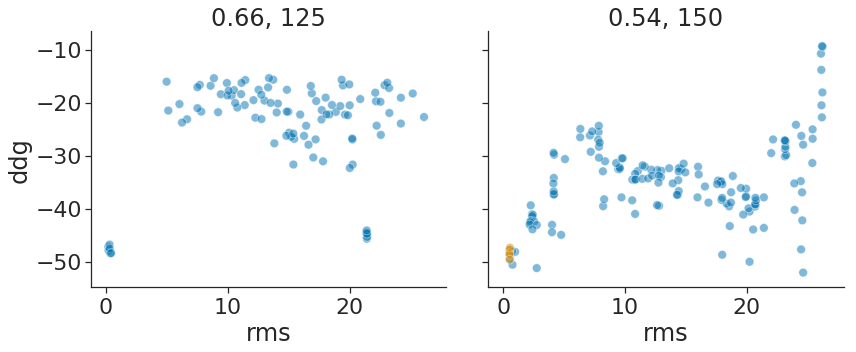

1AHW


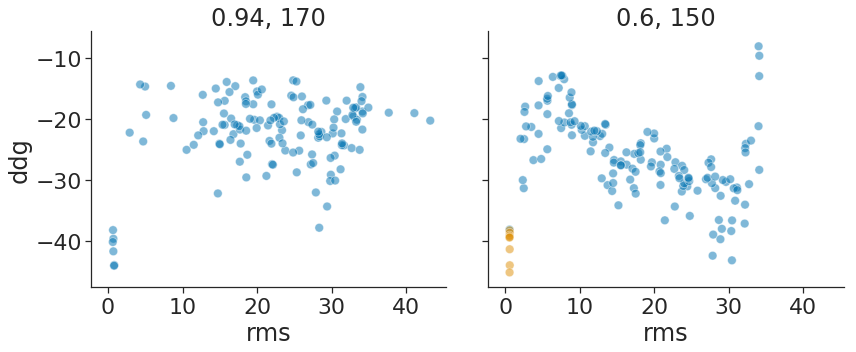

1AKJ


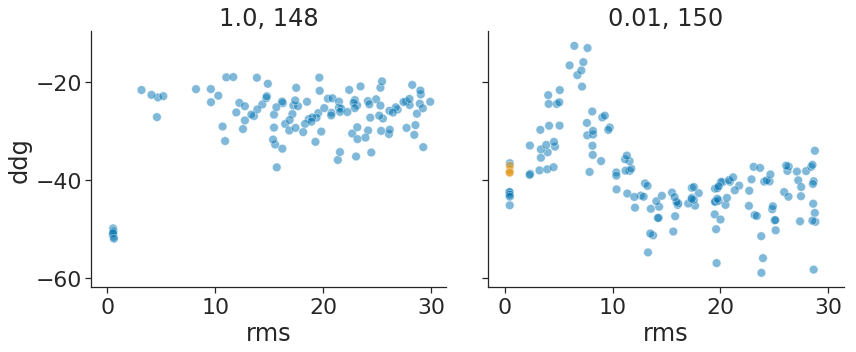

1AVX


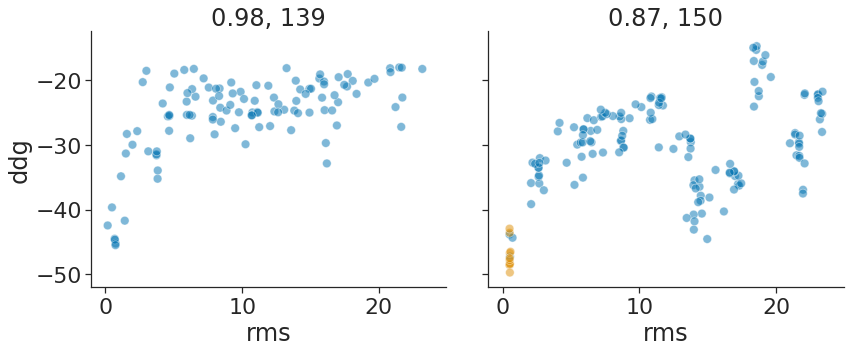

1BJ1


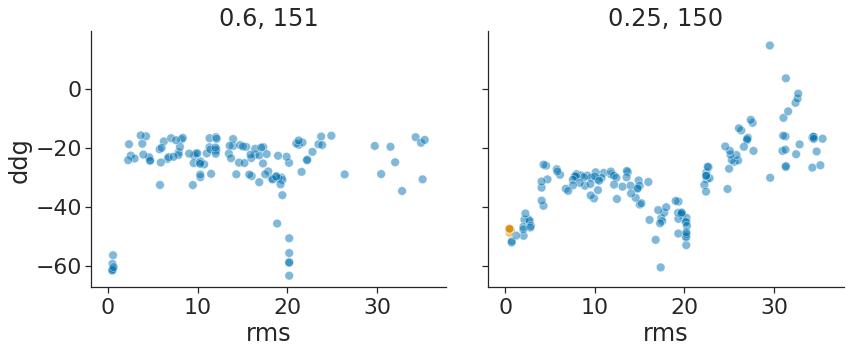

1BUH


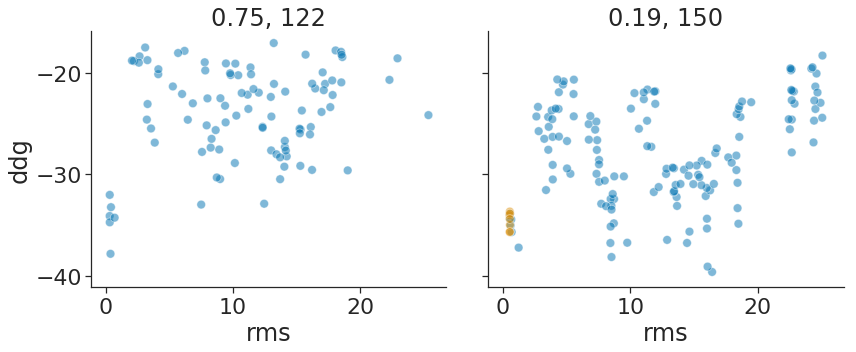

1BVK


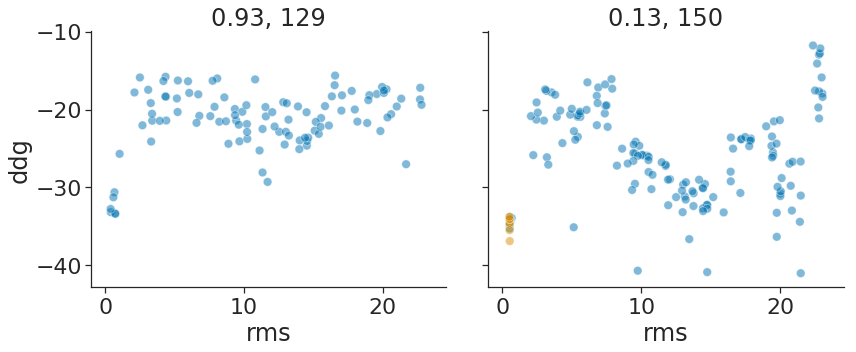

1DFJ


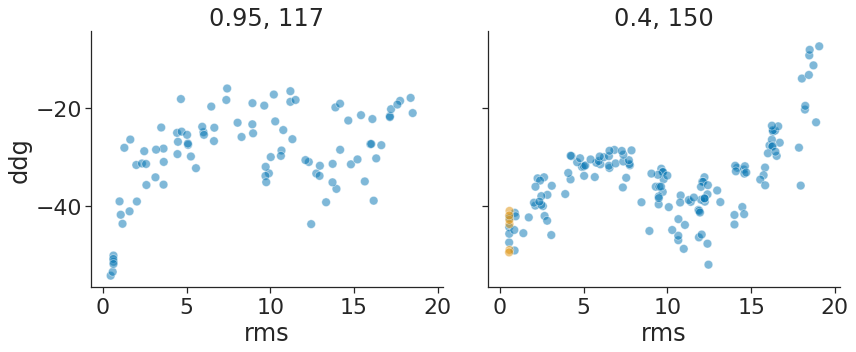

1E6E


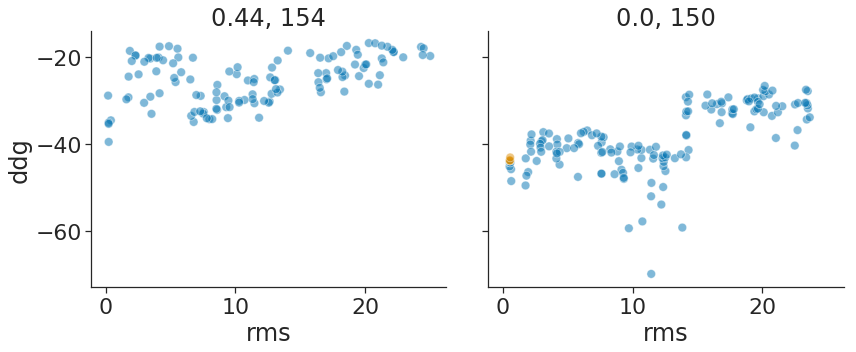

1EAW


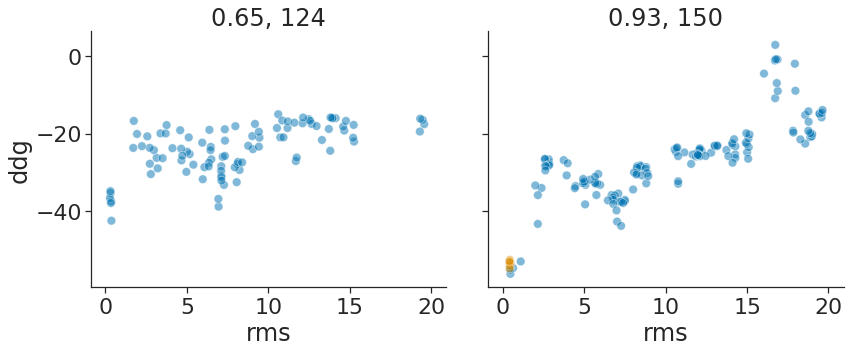

1EWY


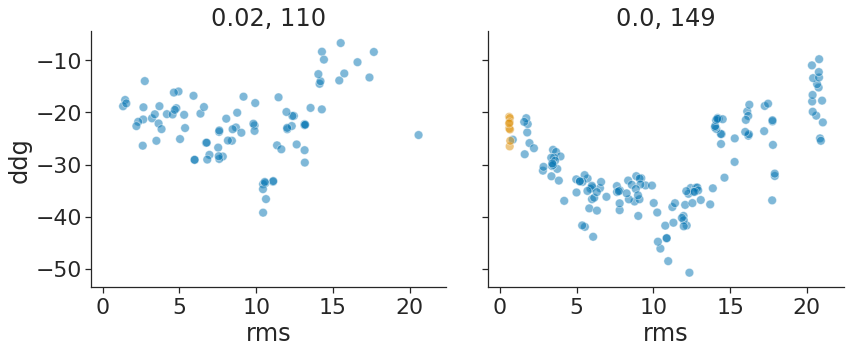

1EZU


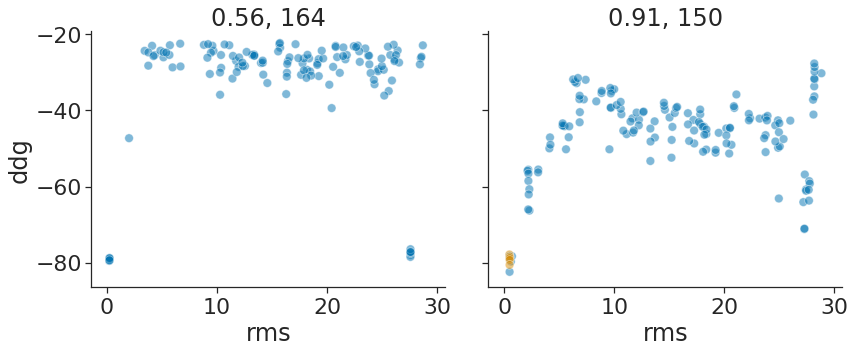

1F34


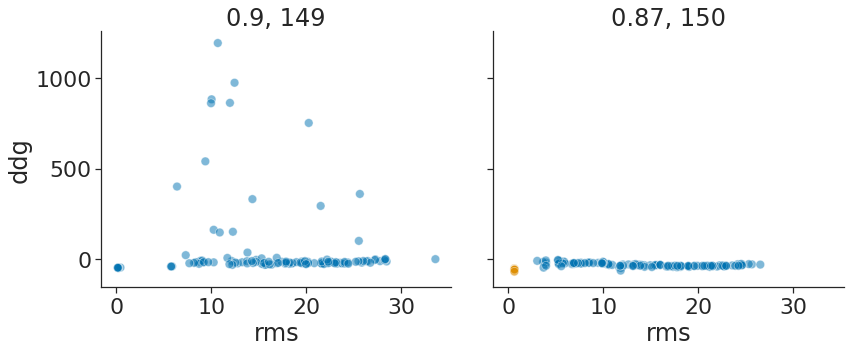

1F51


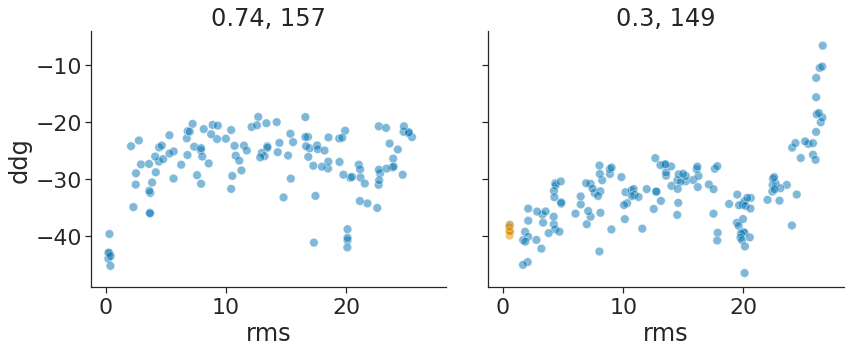

1F6M


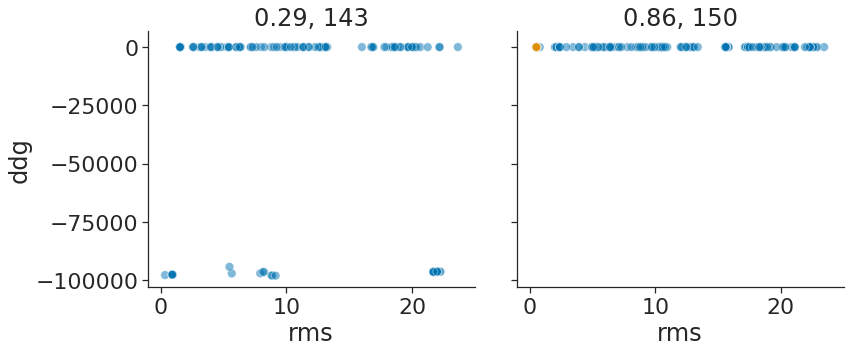

1FC2


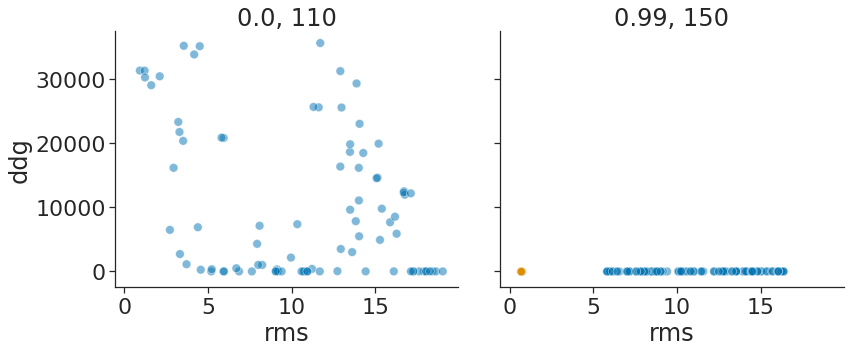

1FFW


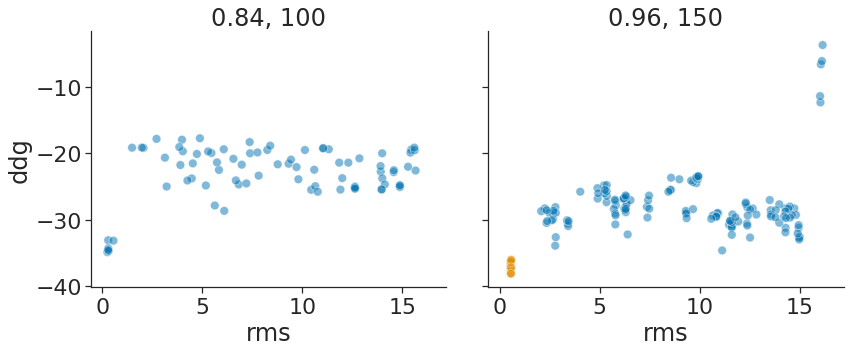

1FQ1


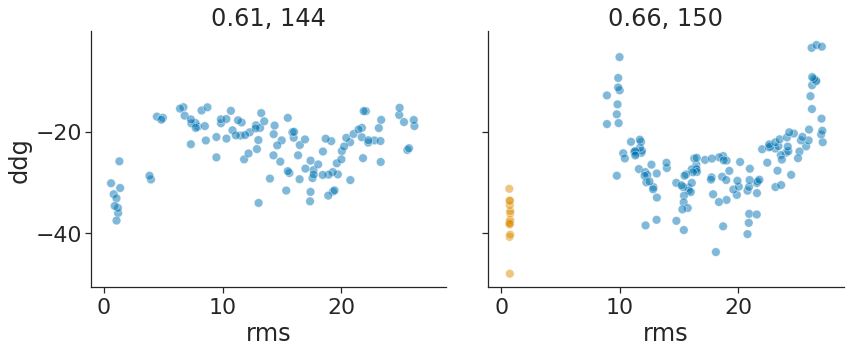

1FQJ


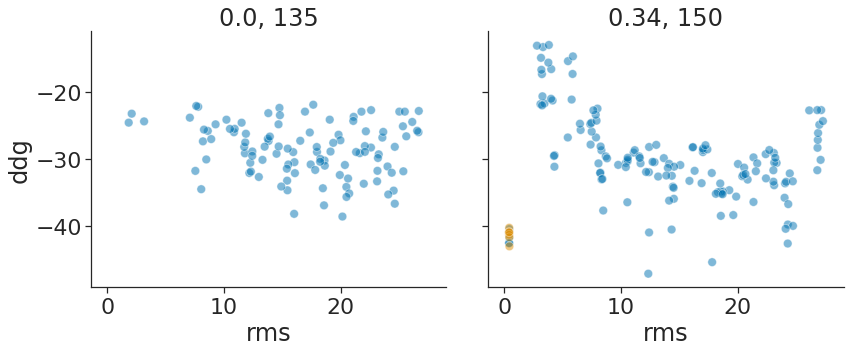

1FSK


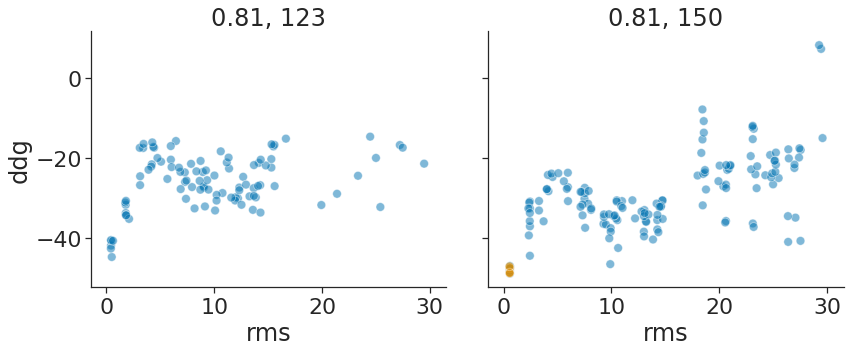

1GLA


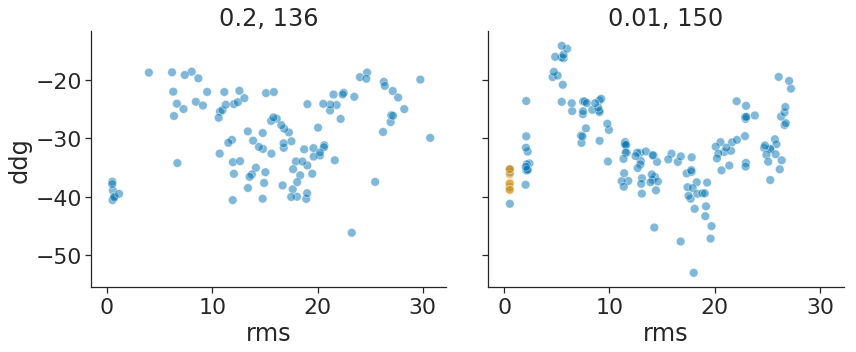

1GPW


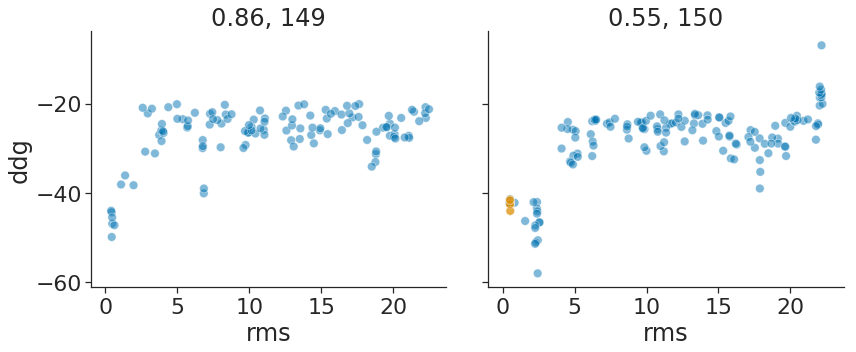

1H1V


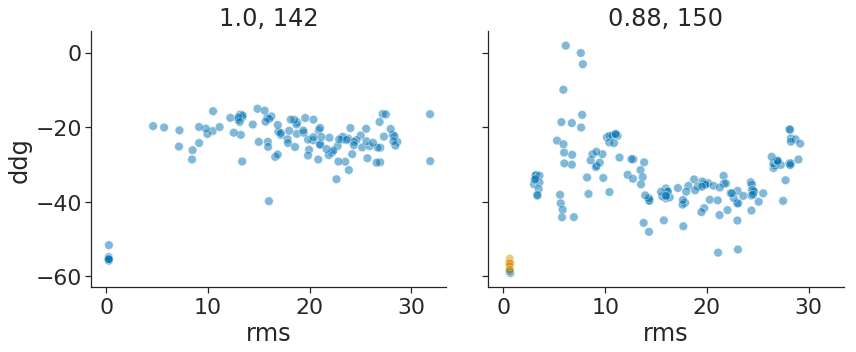

1HCF


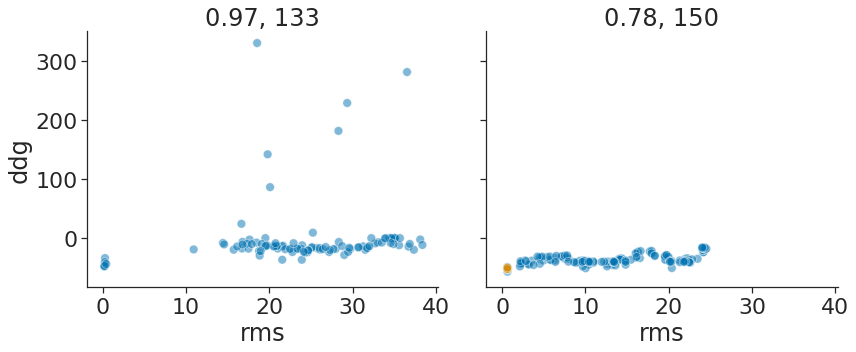

1IB1


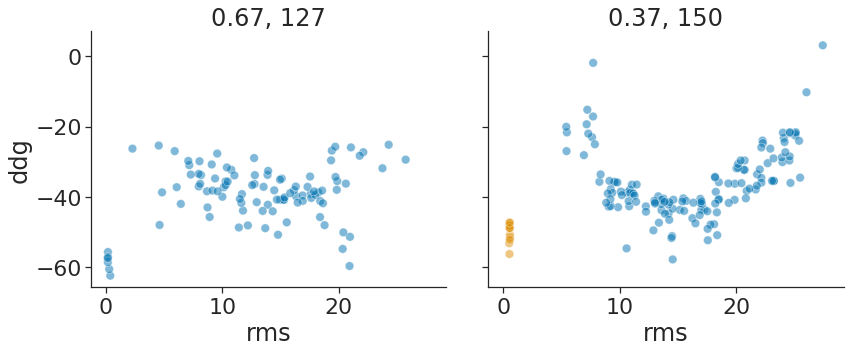

1J2J


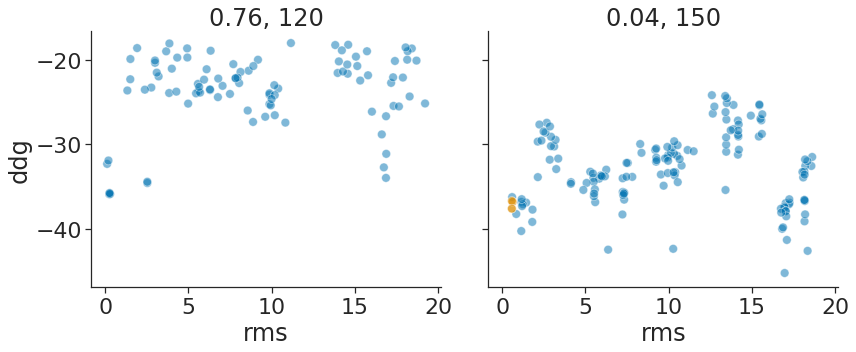

1JZD


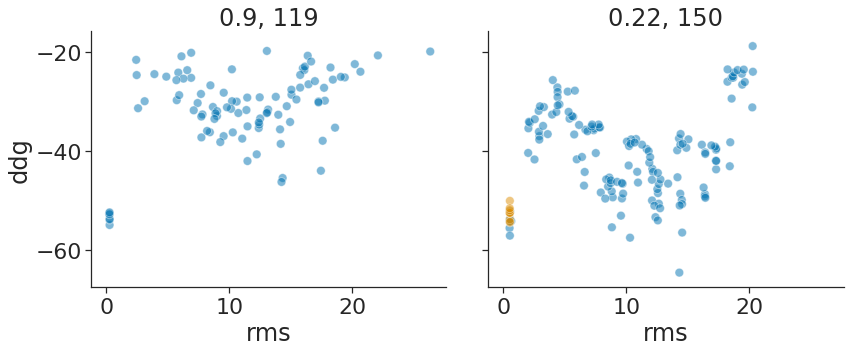

1K74


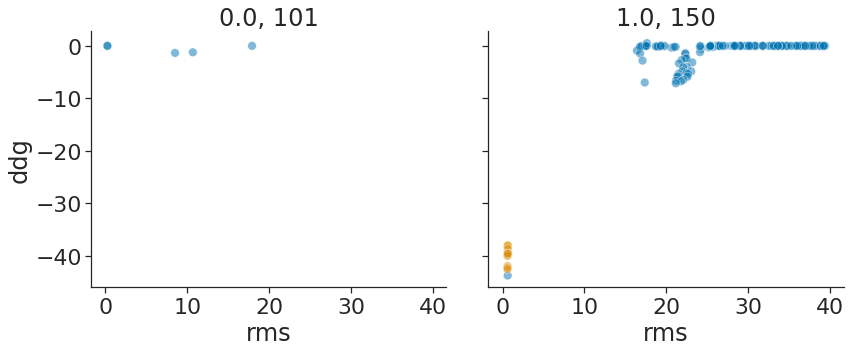

1KKL


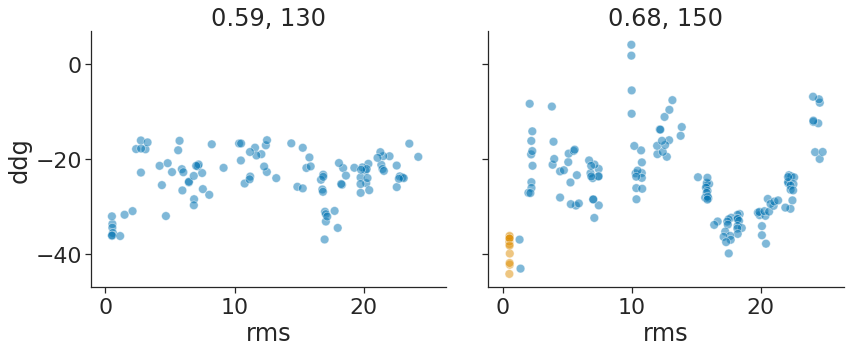

1M10


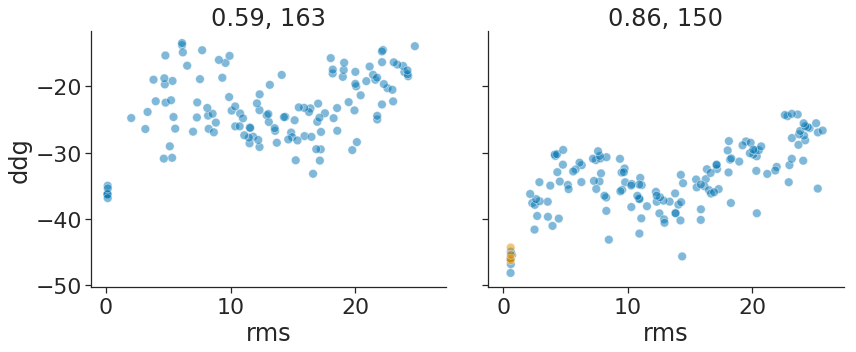

1NCA


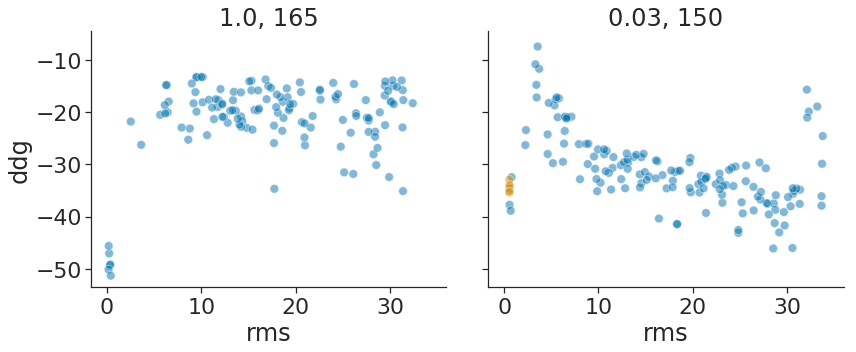

1NSN


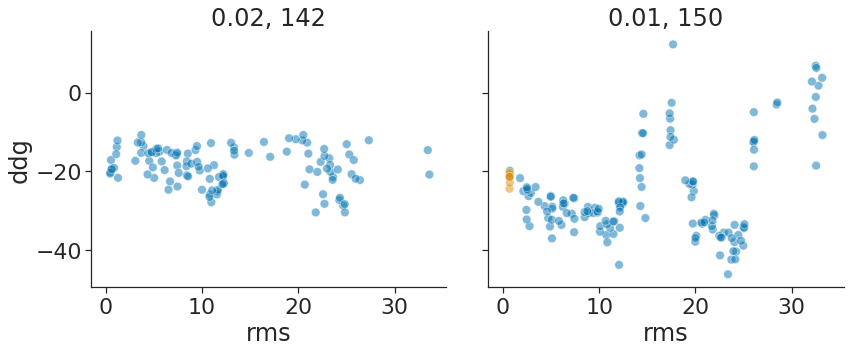

1OPH


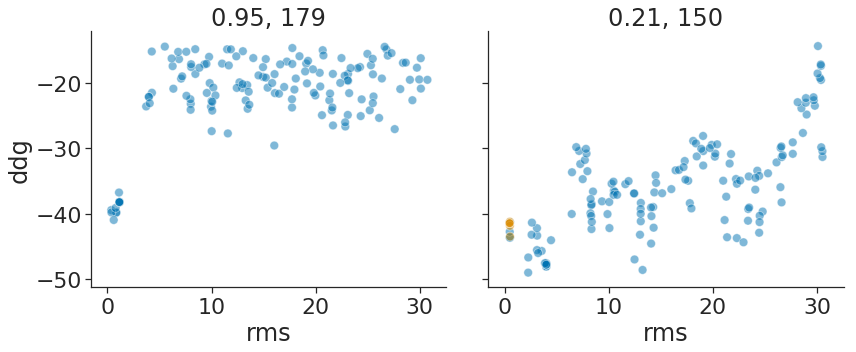

1QA9


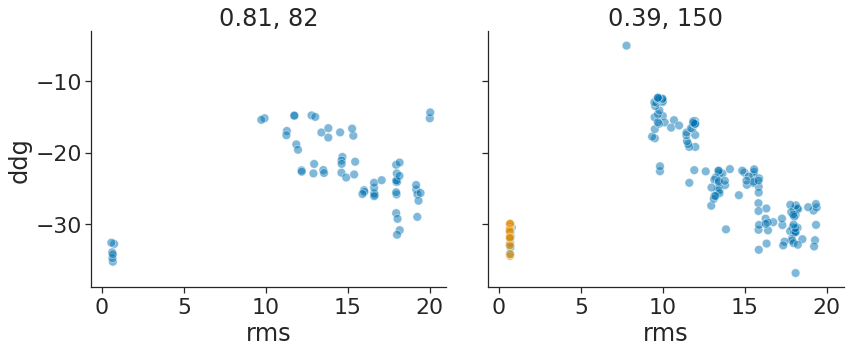

1R6Q


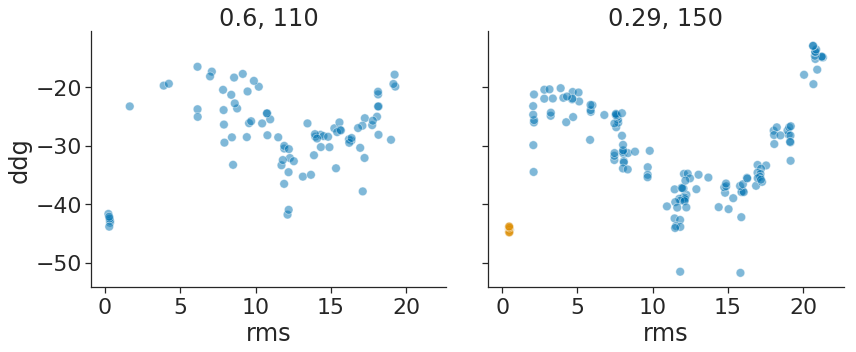

1RV6


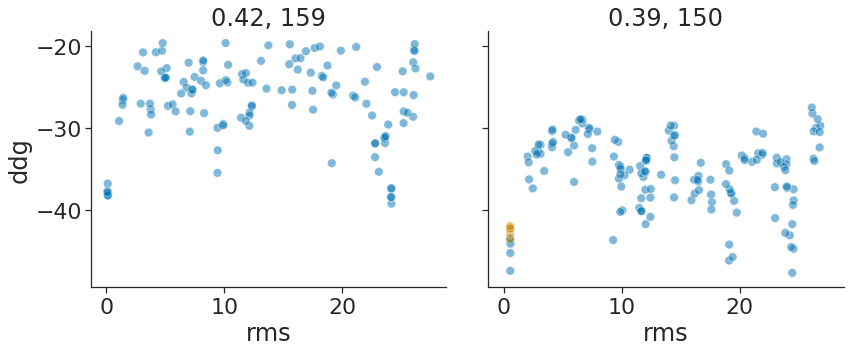

1SYX


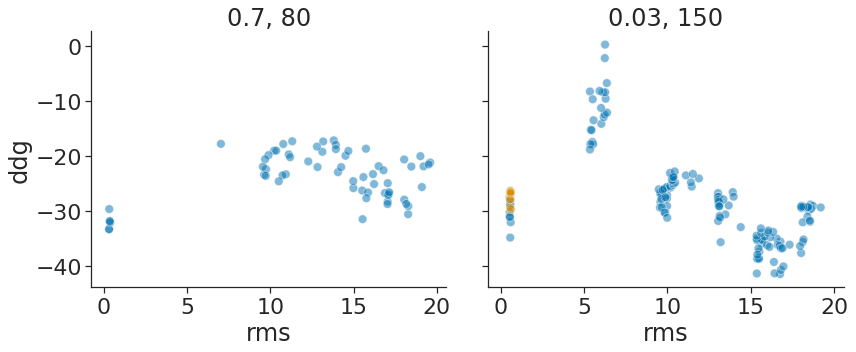

1US7


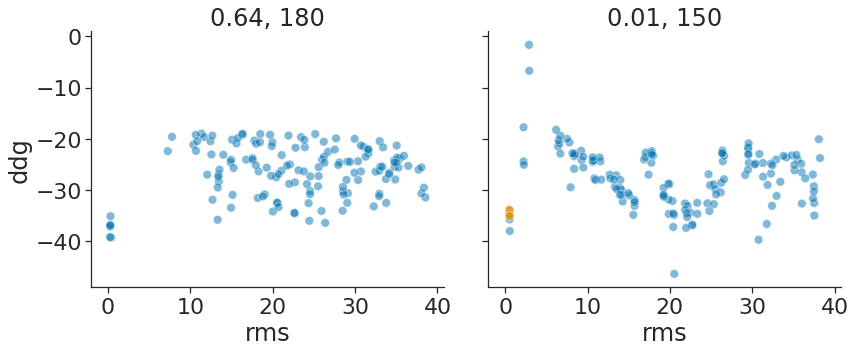

1XU1


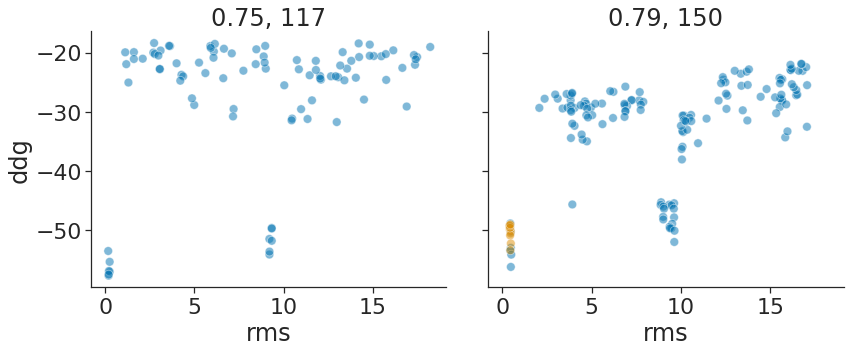

1Y64


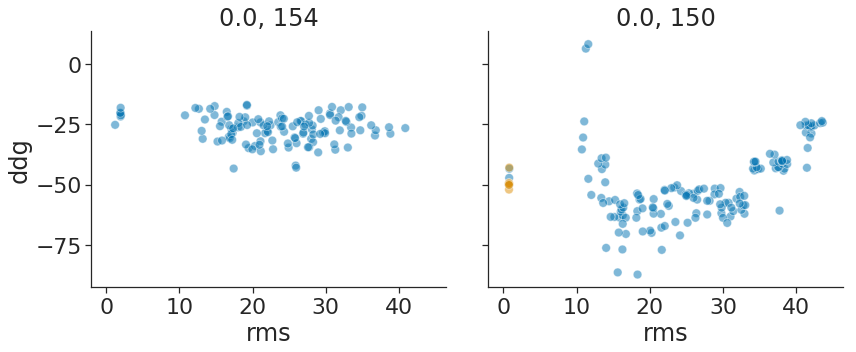

1YVB


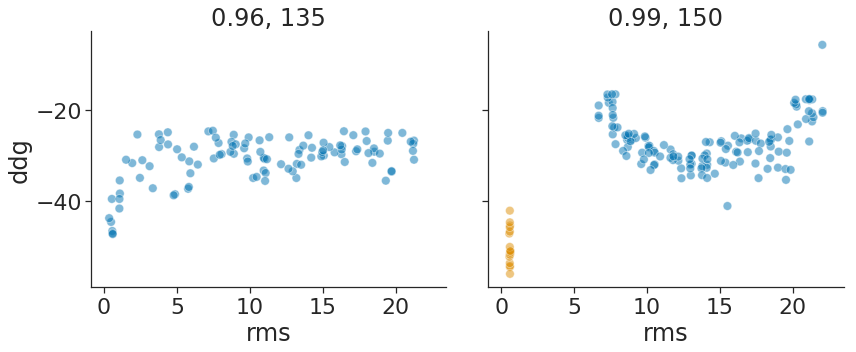

1Z5Y


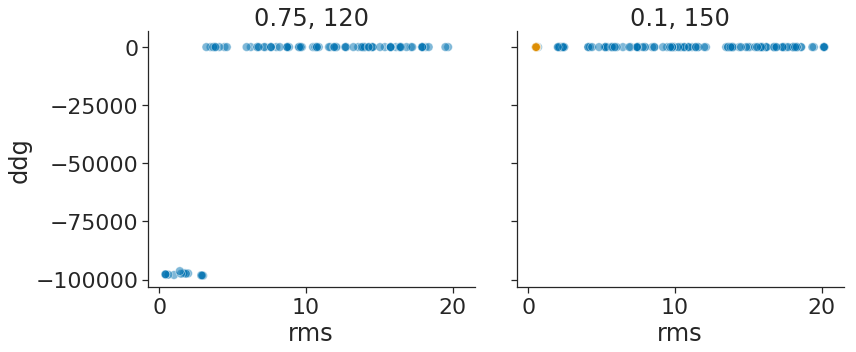

1ZHI


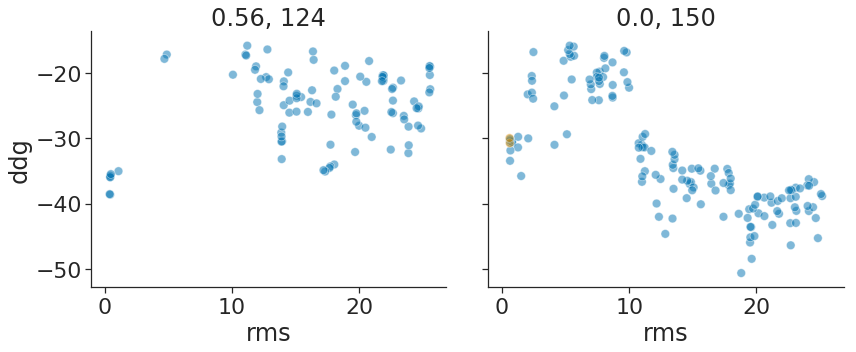

2A5T


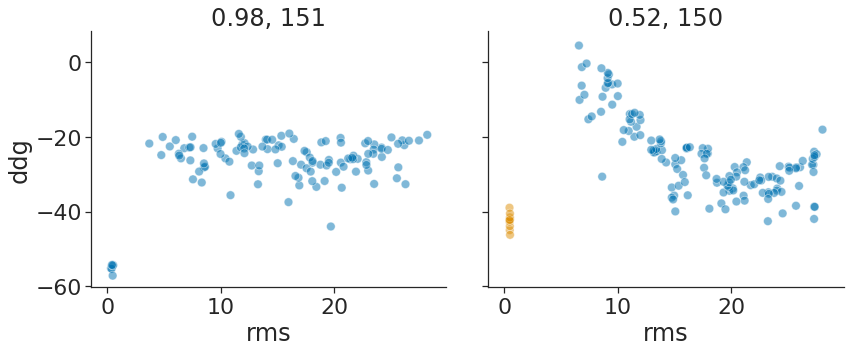

2ABZ


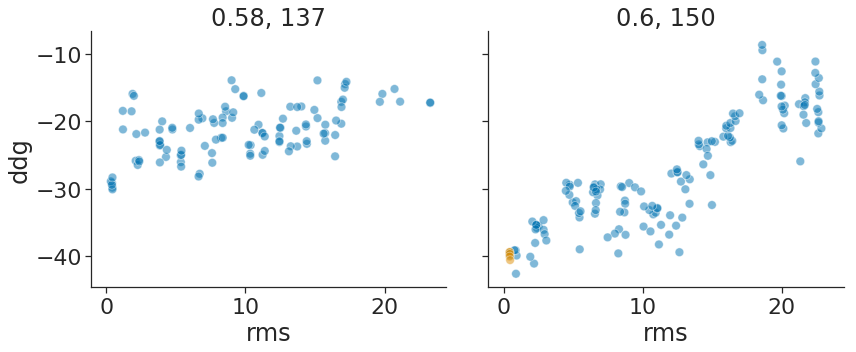

2AJF


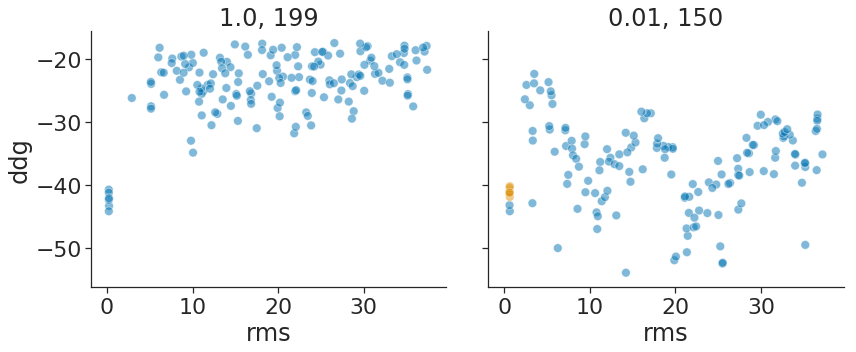

2AYO


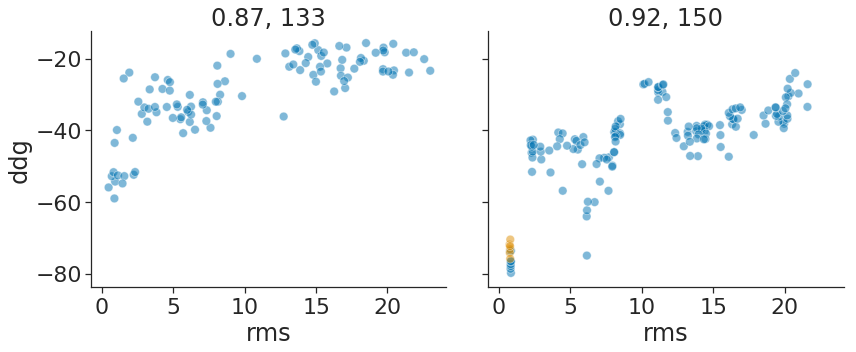

2CFH


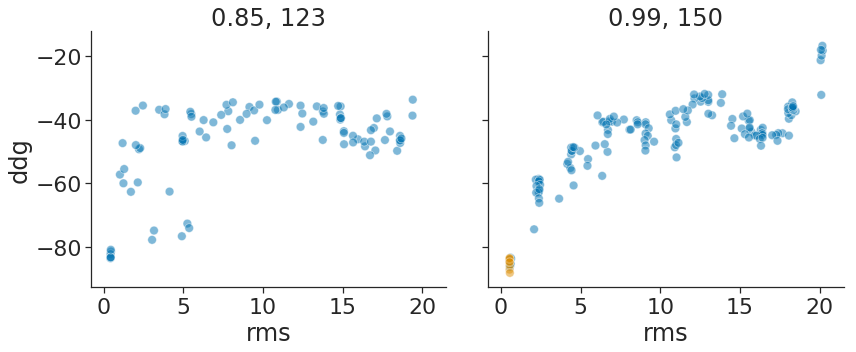

2HRK


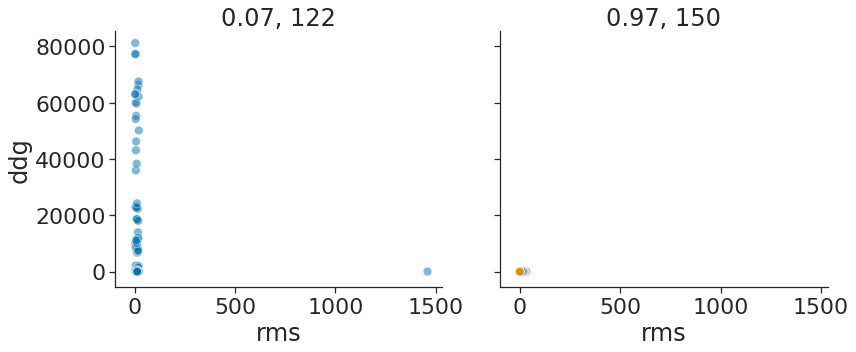

2I9B


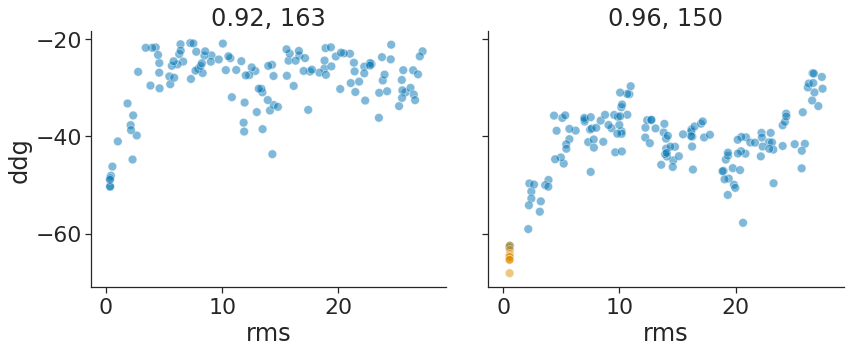

2JEL


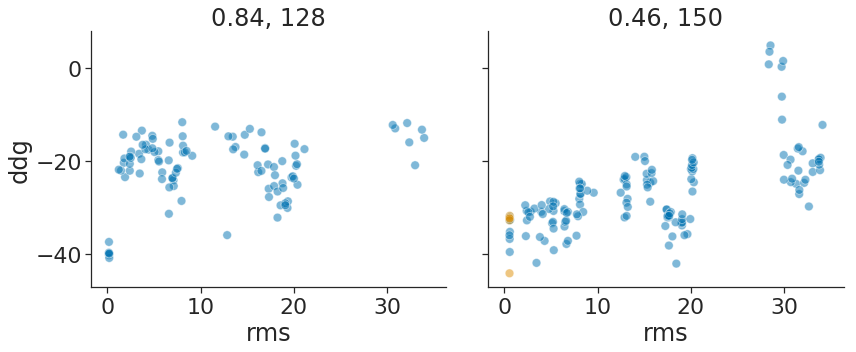

2MTA


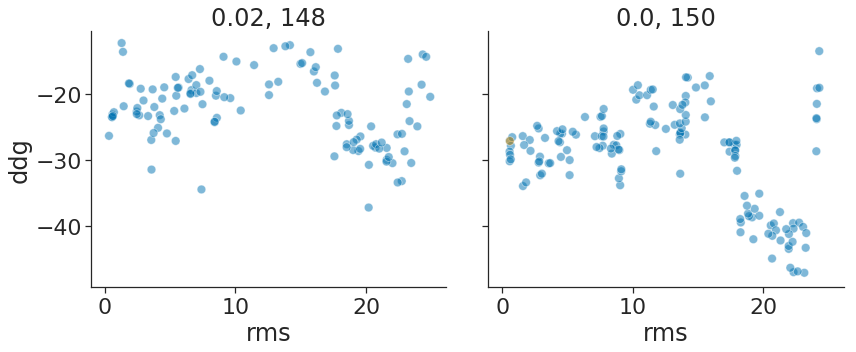

2O3B


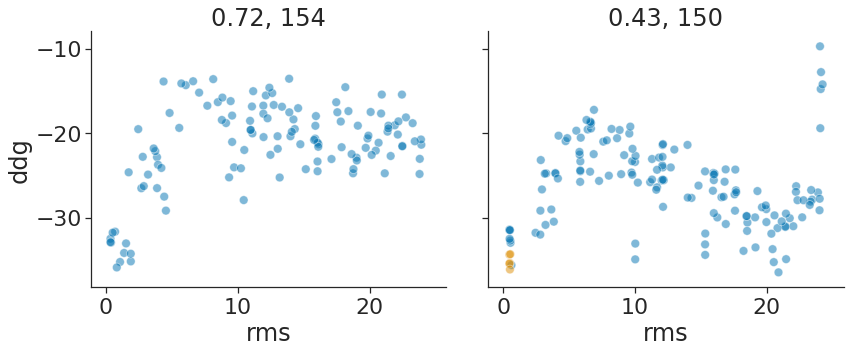

2O8V


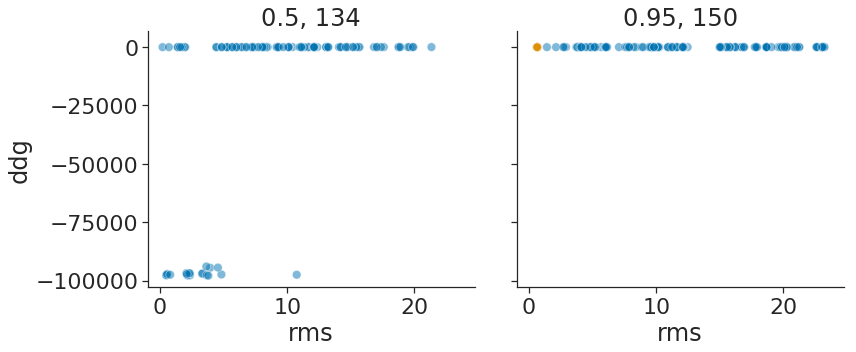

2OOB


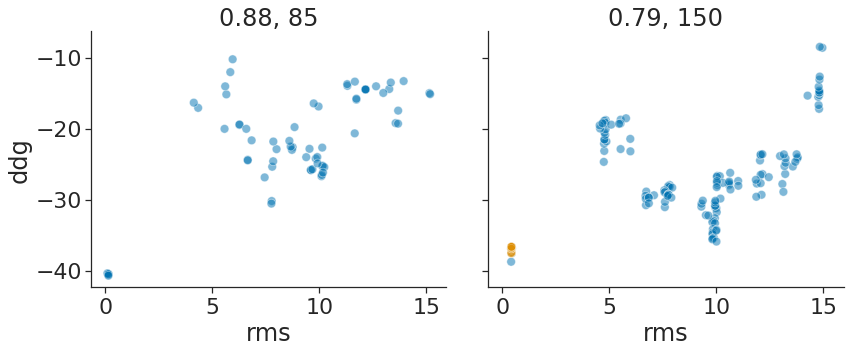

2PCC


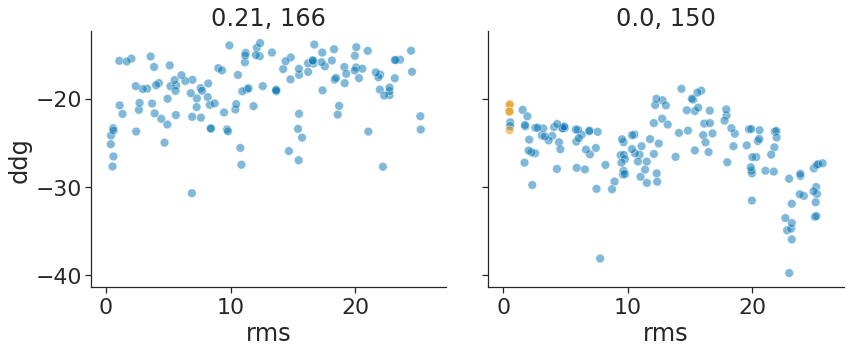

2UUY


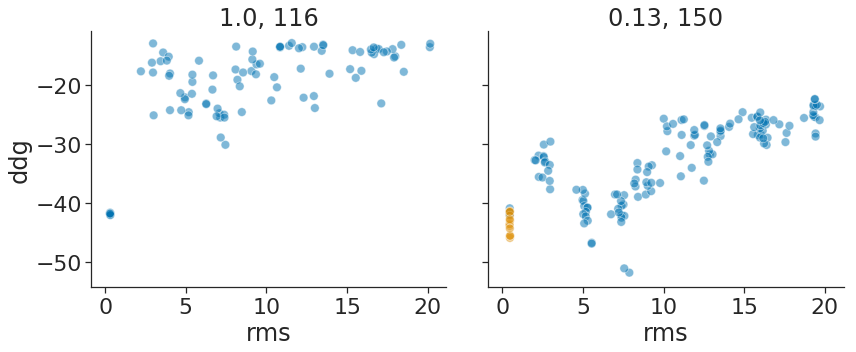

2VIS


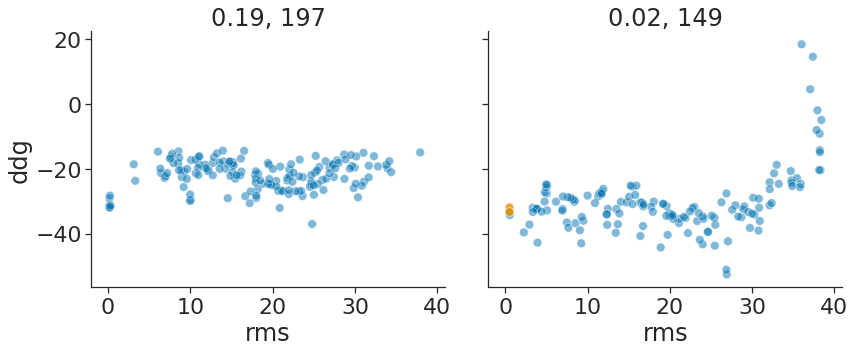

3CPH


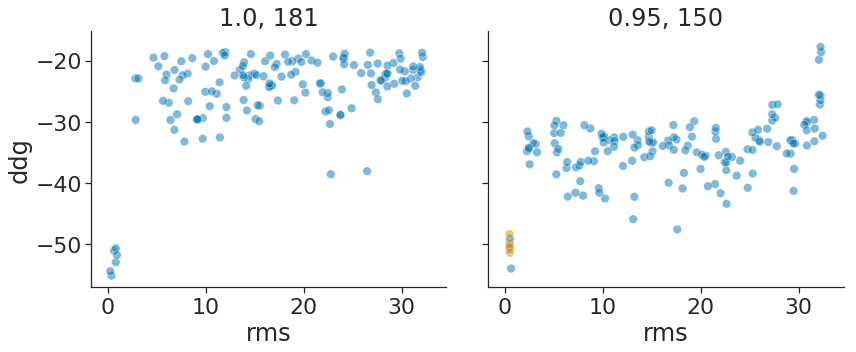

3D5S


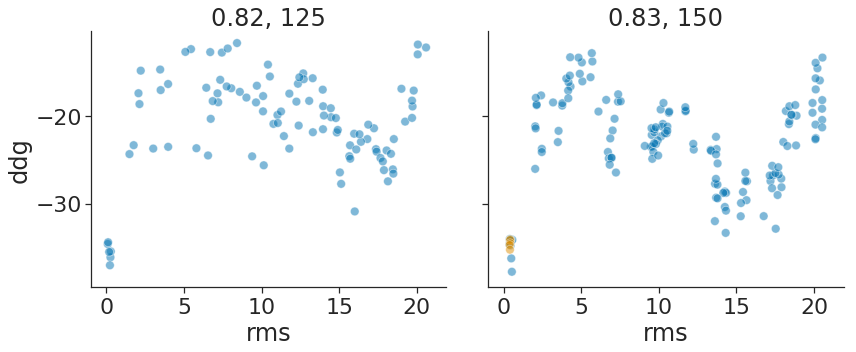

7CEI


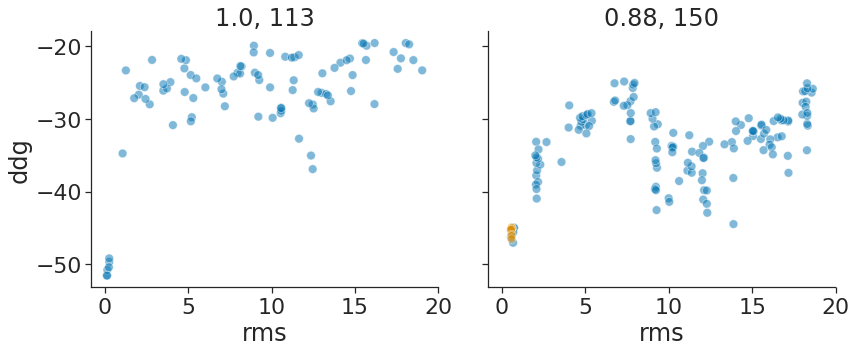

9QFW


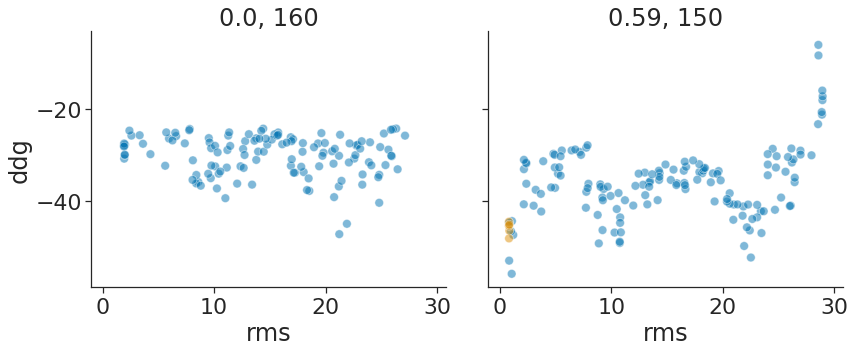

In [21]:
for native in new_df['pdb']:
    
    print(native)
    (fig, axs) = plt.subplots(
        ncols=2, figsize=[12,5], sharex=True, sharey=True
    )

    # Plot data from old benchmark
    old_score_file = os.path.join(
        '/home/haddox/2019/optE_eval/results/beta_nov16/',
        f'nolayer_nostab_0/opt_1/{native}.docking.out'
    )
    df = pandas.read_csv(old_score_file, sep='\s+', skiprows=1)
    df['decoy_type'] = 'decoy'
    metric = 'ddg'
    data = df[
        (df[metric] < df[metric].quantile(0.8)) &
        ~(df[metric].isnull())
    ].copy()
    sns.scatterplot(
        x='rms', y='ddg', data=data, ax=axs[0],
        hue='decoy_type', hue_order=['decoy', 'native'],
        s=75, alpha=0.5
    )
    old_score = round(float(
        new_df[new_df['pdb']==native]['score_old']
    ), 2)
    axs[0].set(
        title = f'{old_score}, {len(df)}'
    )

    # Plot data from new benchmark
    df = ddg_df[
        (ddg_df['native'] == native) &
        (ddg_df['description'].isin(pdbs_for_optE_dict[native]))
    ].copy()
    metric = 'ddg' #
    df.sort_values('decoy_type', inplace=True)
    sns.scatterplot(
        x='rms', y=metric, data=df, ax=axs[1],
        hue='decoy_type', hue_order=['decoy', 'native'],
        s=75, alpha=0.5
    )
    new_score = round(float(
        new_df[new_df['pdb']==native]['score_new']
    ), 2)
    axs[1].set(
        title = f'{new_score}, {len(df)}'
    )
    #plt.legend(bbox_to_anchor=(1,1))
    axs[0].get_legend().remove()
    axs[1].get_legend().remove()
    plt.tight_layout(w_pad=3)
    sns.despine()
    plt.show()

**Observations**:
* Look into
    * 1F34, 1HCF: too many high-energy decoys in old test?
* Why do some landscapes score better in new test?
    * errors in ddG protocols?
        * 2O8V
        * 1F6M
        * 1FC2
        * 1HCF
        * 1Z5Y
        * 2HRK
    * old protocol didn't sample any near-natives?
        * 1FQJ
        * 9QFW
    * new protocol does more sampling of near-natives?
        * 1M10
    * something strange going on
        * 1K74
        * 1IJK

* Drop from new test
    * 1IJK
        * problem with RMSD calcuations? Even S_ have high RMSD
    * 1K74
        * only four points in old test?
        * seems like there was a problem with sampling good decoys in new test


1NCA
* HKH_2021_1NCA_run_2_complex.785_chain_B_20
    * large central cavity
    * multiple loosely packed unsats: 497 OCbb, 525 OCbb, 161 bb and sc (many in this region)
    
* For a 1NCA decoy, confirmed that the relaxed complex and relaxed chains have differences near interface (both bb and sc), but not away from interface

Run optE protocol on landscapes from above, doing replicates of beta_nov16 to quantify noise

In [ ]:
natives_to_drop_from_test = ['1IJK', '1K74']
xml = 'scripts/relax_interface.xml'

# Cycle through natives and carry out each protocol
for native in natives_to_score:

    if native in natives_to_drop_from_test:
        continue
    print(native)
    if dont_include_S:
        input_silent_file = \
            f'results/silent_files_for_optE_noS/{native}.out'
    else:
        input_silent_file = \
            f'results/silent_files_for_optE/{native}.out'

    for relaxscript_name in relaxscript_dict:    
        for xml_name in xml_dict:

            if xml_name == 'ddg_no_repack':
                if relaxscript_name != 'cartminpack':
                    continue
            
            # Get protocol
            xml = xml_dict[xml_name]
            relaxscript = relaxscript_dict[relaxscript_name]

            # Define output directory
            output_file = os.path.join(
                output_dir,
                f'{native}_{xml_name}_{relaxscript_name}.sc'
            )

            # Assemble command
            cmd = ' '.join([
                '~/Rosetta/main/source/bin/rosetta_scripts.default.linuxgccrelease',
                f'-parser:protocol {xml}',
                '-parser:script_vars',
                f'wts={weights}',
                f'relaxscript={relaxscript}',
                '-beta_nov16_cart',
                f'-in:file:silent {input_silent_file}',
                '-in:file:silent_struct_type binary',
                #-force_silent_bitflip_on_read \
                f'-score:weights {weights}',
                #'-set_weights cart_bonded 0.0 pro_close 1.25',
                '-crystal_refine true',
                f'-in:file:native /home/dimaio/optE2/dualoptE/decoys/docking/{native}_bound_native.pdb',
                f'-out:file:score_only {output_file}',
                '-silent_read_through_errors',
                '-mute all'
            ])

            # Submit job
            sbatch_file_name = output_file.replace('.sc', '.sbatch')
            if not os.path.isfile(sbatch_file_name):
                if 'cartminpack' in relaxscript_name:
                    queue_type = 'short'
                else:
                    queue_type = 'medium'
                design_utils.WriteSbatchFile(
                    sbatch_file_name,
                    command=cmd,
                    queue_type=queue_type,
                    memory='2g'
                )
                ! sbatch {sbatch_file_name}

Run optE protocols on landscapes from above

In [239]:
# Define input vars
weights = 'beta_nov16_cart'
dont_include_S = True
if dont_include_S:
    output_dir = 'results/optE_test_noS/'
else:
    output_dir = 'results/optE_test/'
if not os.path.isdir(output_dir):
    os.makedirs(output_dir)
    
# Make list of XMLs to test
xml_dict = {
#     'total_score' : 'scripts/compute_docking_score.xml',
#     'ddg_relax_unbound' : \
#         'scripts/compute_docking_score_ddg_relax.xml',
#     'ddg_repack_unbound' : \
#         'scripts/compute_docking_score_ddg_repack.xml',
#     'ddg_no_repack' : \
#         'scripts/compute_docking_score_ddg_no_repack.xml',
    'relax_interface_of_complex' : \
        'scripts/relax_interface_of_complex.xml',
    'relax_interface_of_chainA' : \
        'scripts/relax_interface_of_chainA.xml',
    'relax_interface_of_chainB' : \
        'scripts/relax_interface_of_chainB.xml',
}

# Make list of relax scripts to test
relaxscript_dict = {
    'cartminpack' : 'scripts/cartminpack.script',
    'cartminpack_1_50' : 'scripts/cartminpack_1_50.script',
    'MonomerDesign2019' : 'MonomerDesign2019'
}

# Cycle through natives and carry out each protocol
for native in natives_to_score:

    print(native)
    if dont_include_S:
        input_silent_file = \
            f'results/silent_files_for_optE_noS/{native}.out'
    else:
        input_silent_file = \
            f'results/silent_files_for_optE/{native}.out'

    for relaxscript_name in relaxscript_dict:    
        for xml_name in xml_dict:

            if xml_name == 'ddg_no_repack':
                if relaxscript_name != 'cartminpack':
                    continue
            
            # Get protocol
            xml = xml_dict[xml_name]
            relaxscript = relaxscript_dict[relaxscript_name]

            # Define output directory
            output_file = os.path.join(
                output_dir,
                f'{native}_{xml_name}_{relaxscript_name}.sc'
            )

            # Assemble command
            cmd = ' '.join([
                '~/Rosetta/main/source/bin/rosetta_scripts.default.linuxgccrelease',
                f'-parser:protocol {xml}',
                '-parser:script_vars',
                f'wts={weights}',
                f'relaxscript={relaxscript}',
                '-beta_nov16_cart',
                f'-in:file:silent {input_silent_file}',
                '-in:file:silent_struct_type binary',
                #-force_silent_bitflip_on_read \
                f'-score:weights {weights}',
                #'-set_weights cart_bonded 0.0 pro_close 1.25',
                '-crystal_refine true',
                f'-in:file:native /home/dimaio/optE2/dualoptE/decoys/docking/{native}_bound_native.pdb',
                f'-out:file:score_only {output_file}',
                '-silent_read_through_errors',
                '-mute all'
            ])

            # Submit job
            sbatch_file_name = output_file.replace('.sc', '.sbatch')
            if not os.path.isfile(sbatch_file_name):
                if 'cartminpack' in relaxscript_name:
                    queue_type = 'short'
                else:
                    queue_type = 'medium'
                design_utils.WriteSbatchFile(
                    sbatch_file_name,
                    command=cmd,
                    queue_type=queue_type,
                    memory='2g'
                )
                ! sbatch {sbatch_file_name}

1A2K
Submitted batch job 26744241
Submitted batch job 26744242
Submitted batch job 26744243
Submitted batch job 26744244
Submitted batch job 26744245
Submitted batch job 26744247
Submitted batch job 26744248
Submitted batch job 26744249
Submitted batch job 26744250
1AHW
1AKJ
1AVX
Submitted batch job 26744251
Submitted batch job 26744252
Submitted batch job 26744253
Submitted batch job 26744254
Submitted batch job 26744255
Submitted batch job 26744257
Submitted batch job 26744258
Submitted batch job 26744259
Submitted batch job 26744260
1BJ1
1BUH
1DFJ
1E6E
1EZU
1F34
1F51
1F6M
1FQ1
1FQJ
1FSK
1GLA
1GPW
1H1V
1IB1
1IJK
1JMO
1JZD
1K74
Submitted batch job 26744261
Submitted batch job 26744262
Submitted batch job 26744263
Submitted batch job 26744264
Submitted batch job 26744265
Submitted batch job 26744266
Submitted batch job 26744267
Submitted batch job 26744268
Submitted batch job 26744269
1KKL
1M10
1NCA
1NSN
1OPH
1US7
1XU1
1Y64
2A5T
2ABZ
Submitted batch job 26744270
Submitted batch job 267

Compute ddG from scores obtained from relaxing the complex and each monomer individually

1A2K 150


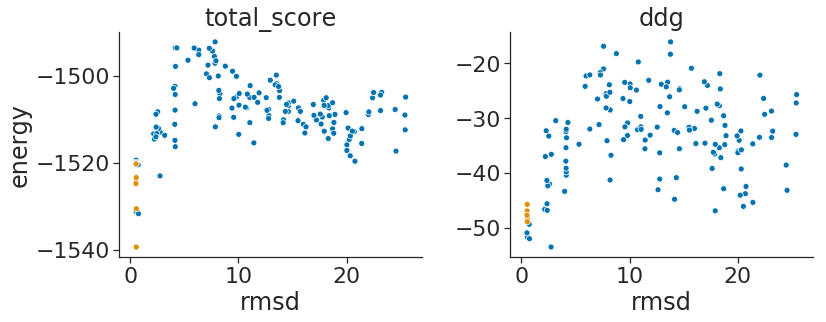

1AHW 150


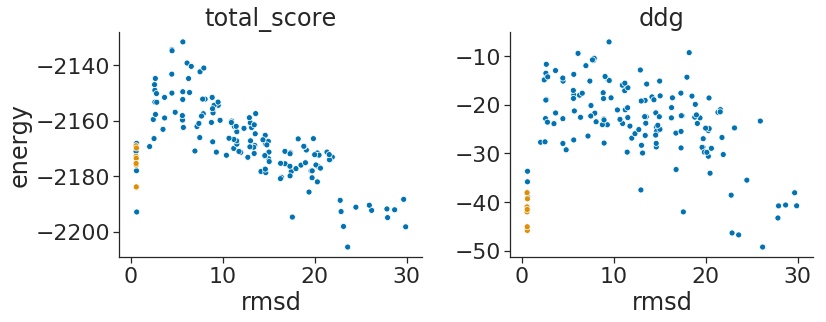

1AKJ 150


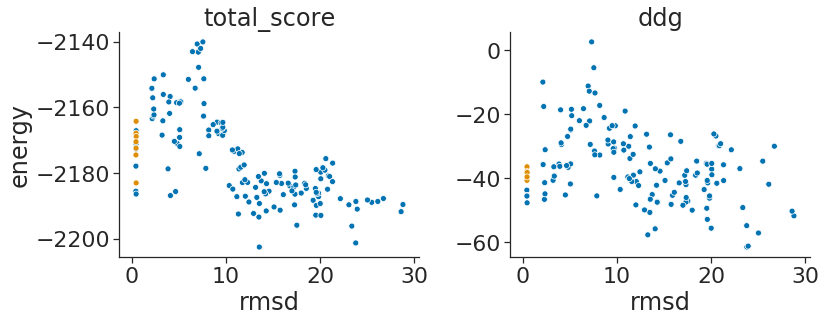

1AVX 150


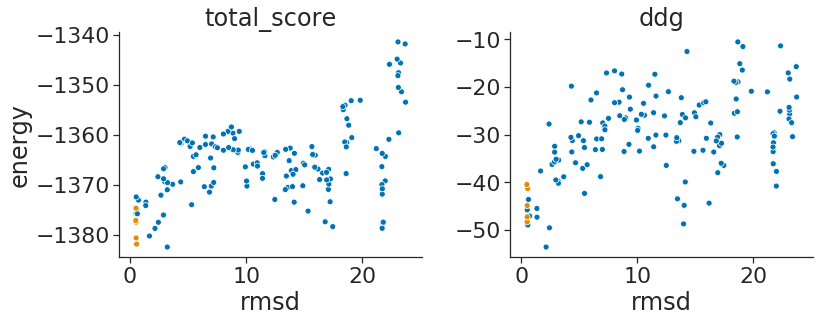

1BJ1 150


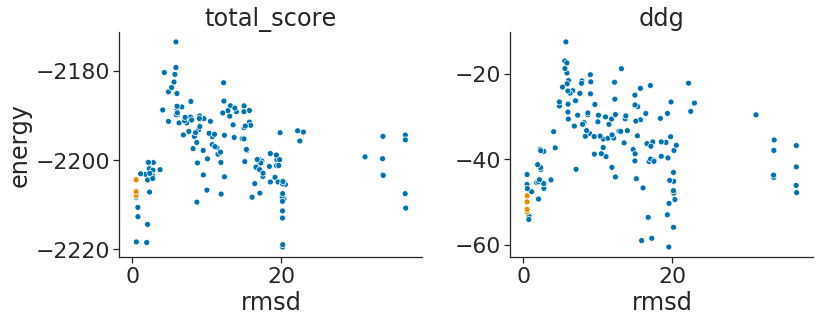

1BUH 150


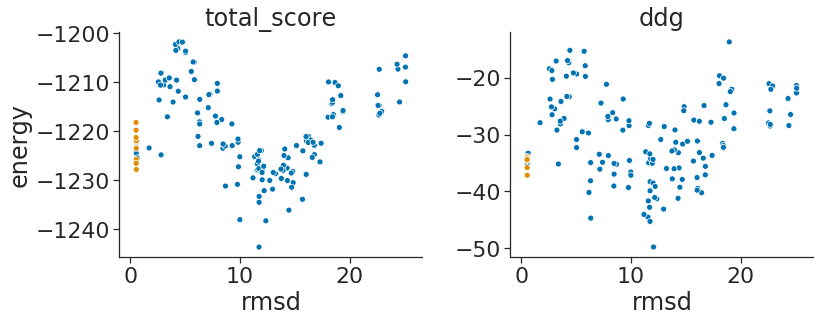

1DFJ 150


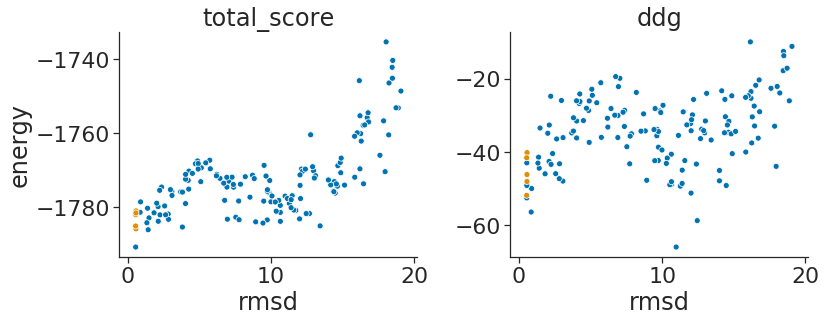

1E6E 150


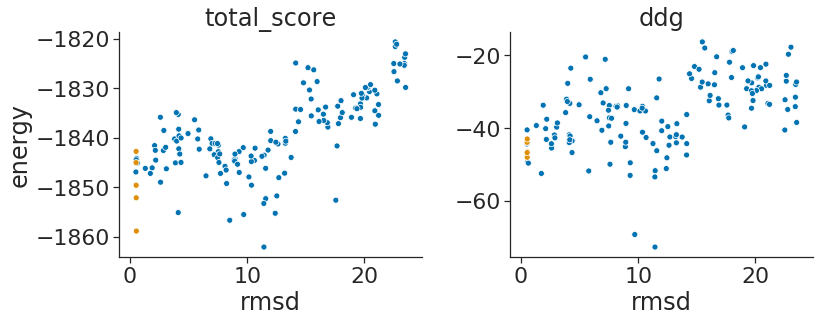

1EZU 150


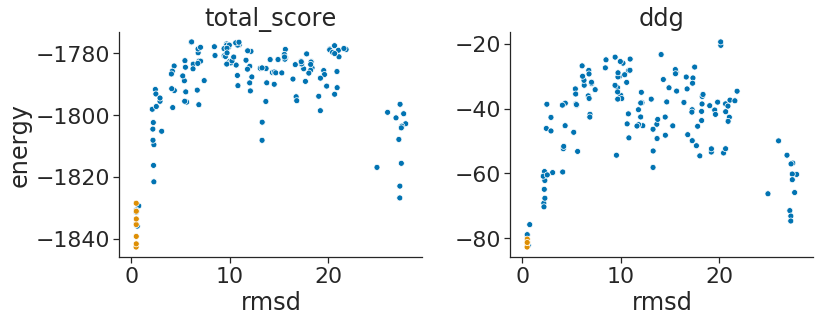

1F34 150


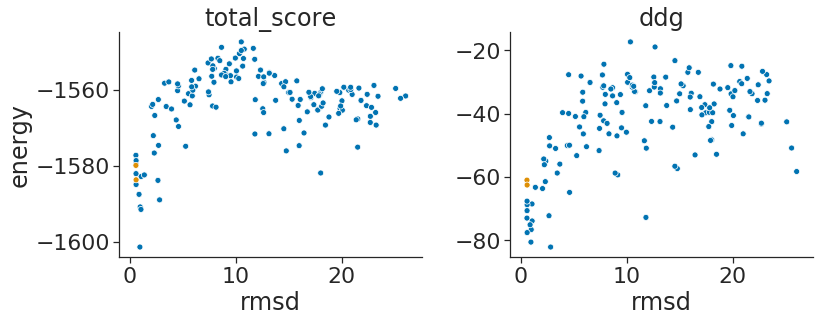

1F51 150


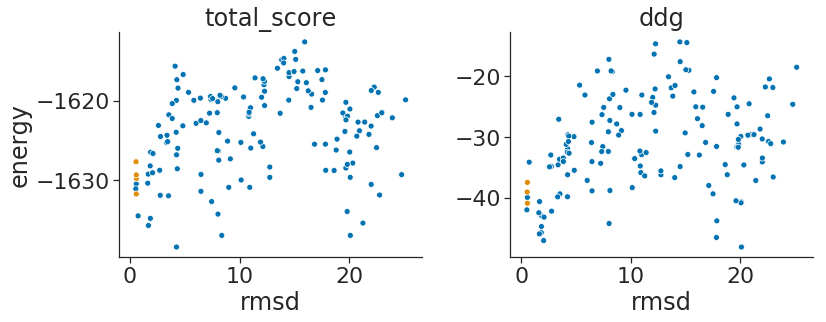

1F6M 150


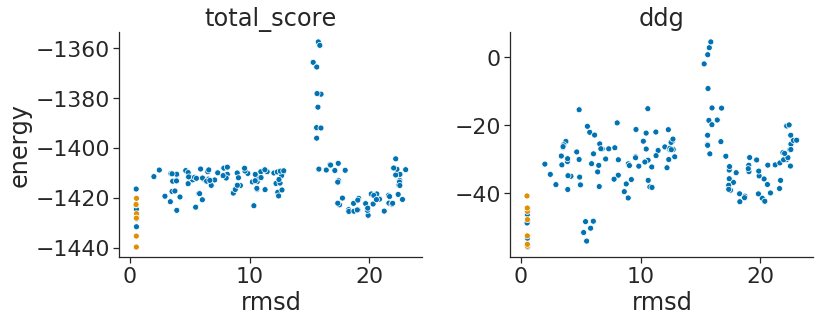

1FQ1 150


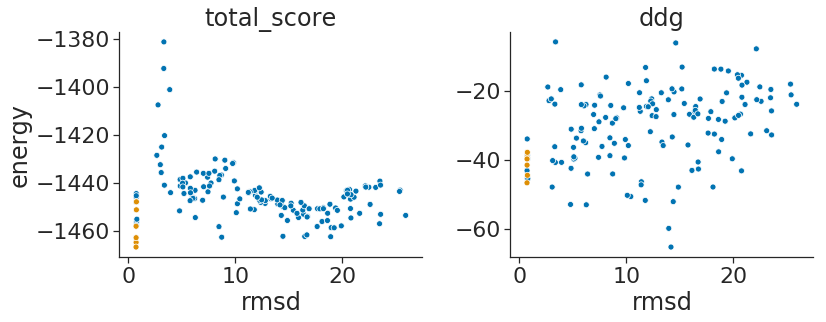

1FQJ 150


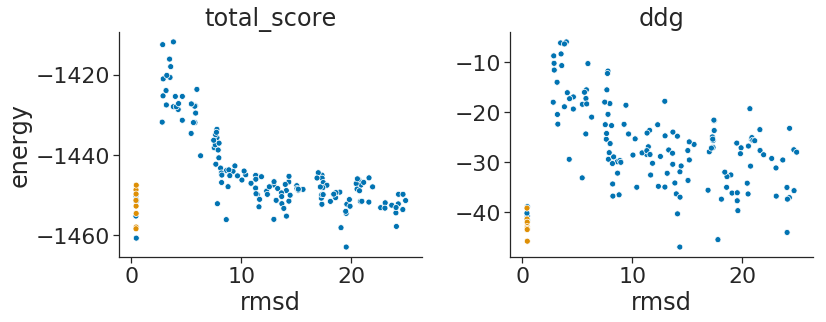

1FSK 150


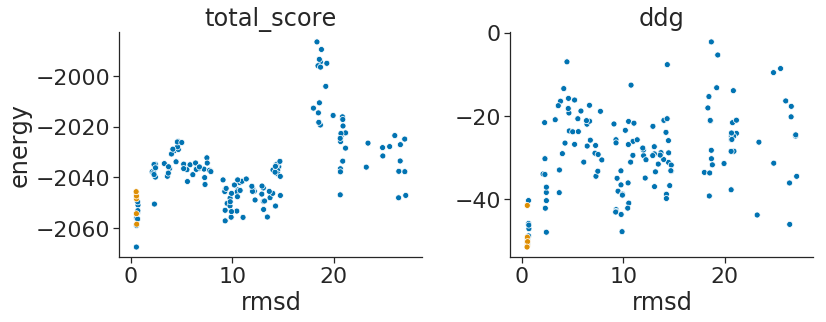

1GLA 150


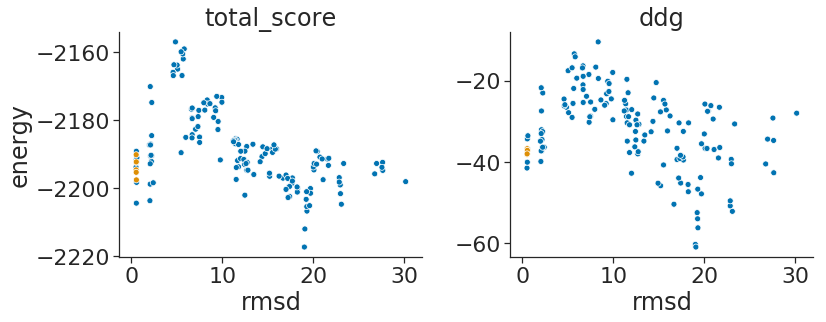

1GPW 150


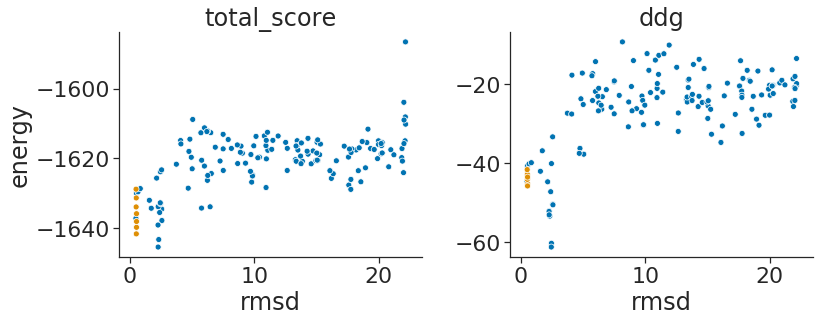

1H1V 150


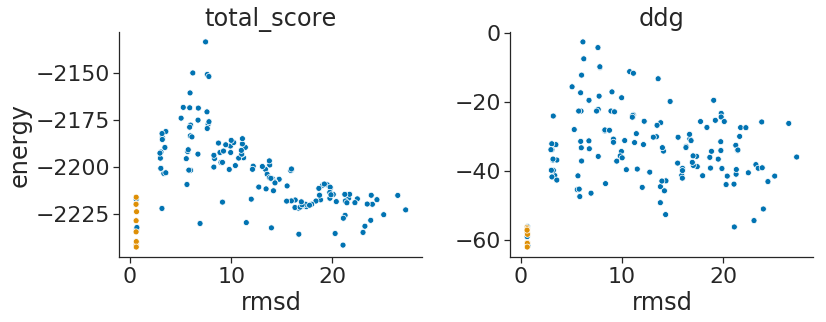

1IB1 150


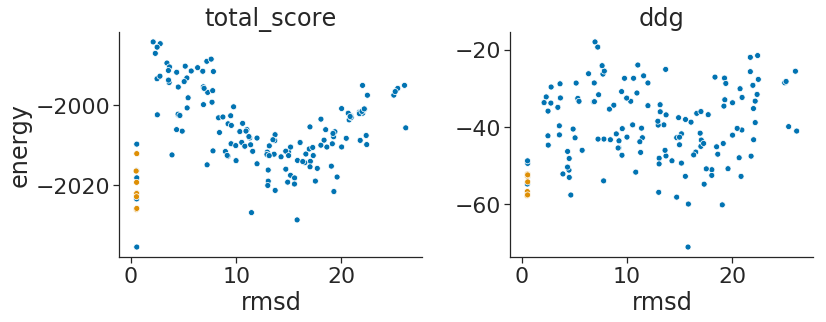

1JMO 150


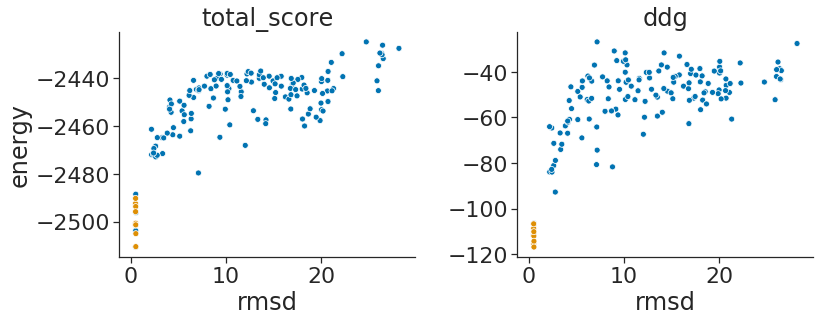

1JZD 150


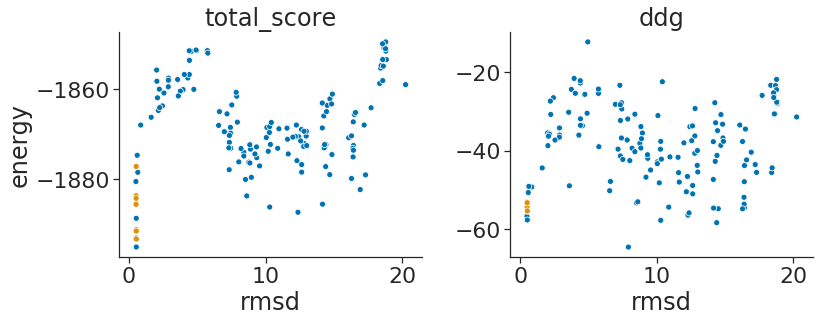

1K74 150


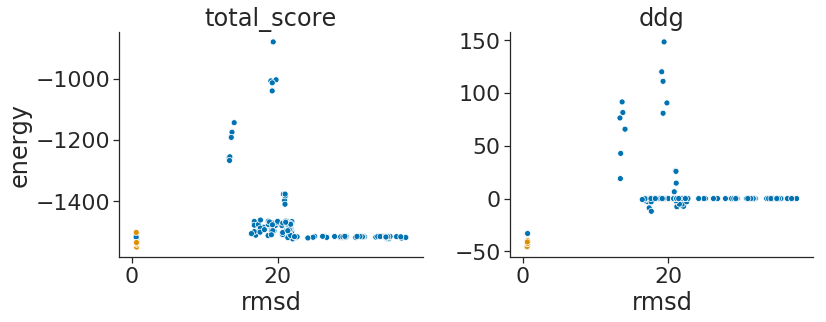

1KKL 150


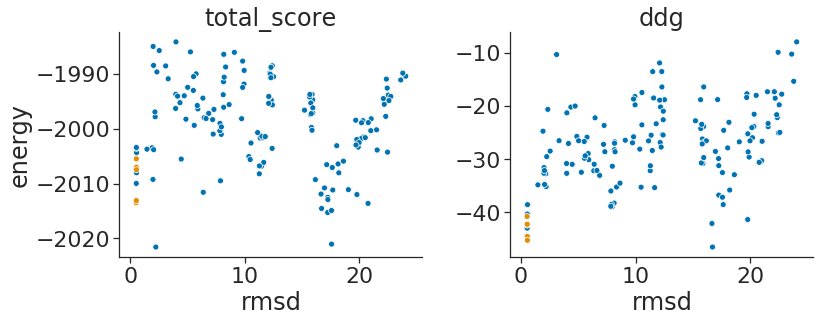

1M10 150


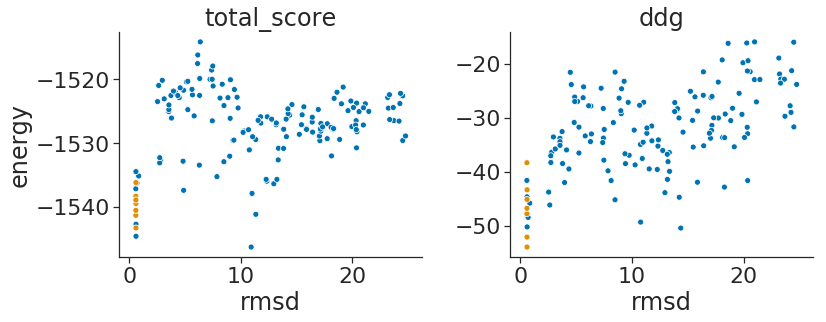

1NCA 150


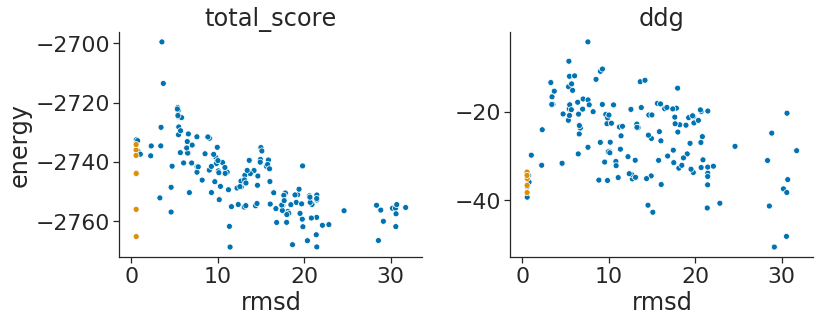

1NSN 150


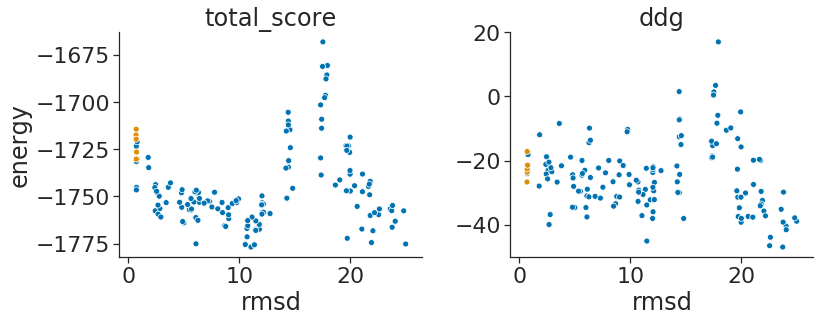

1OPH 150


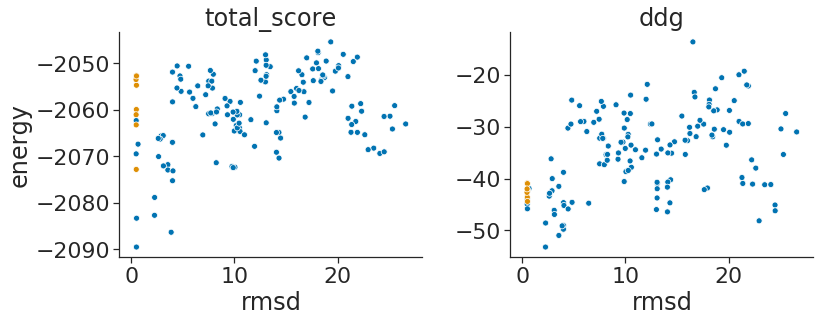

1US7 150


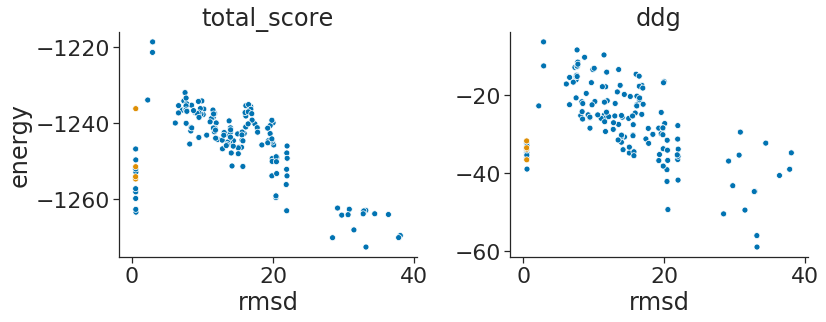

1XU1 150


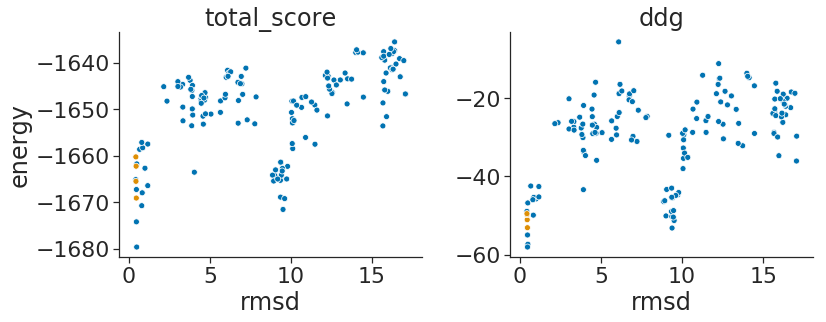

1Y64 150


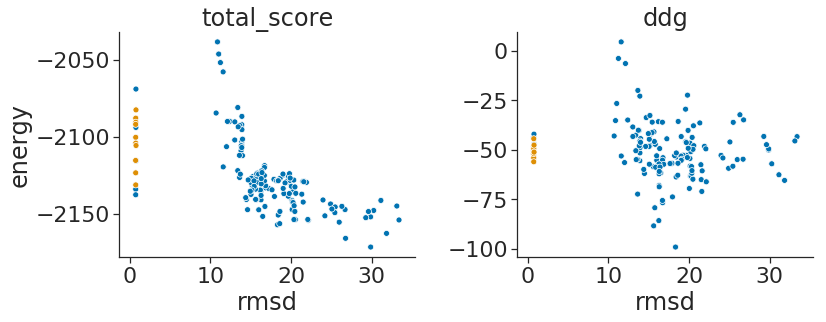

2A5T 150


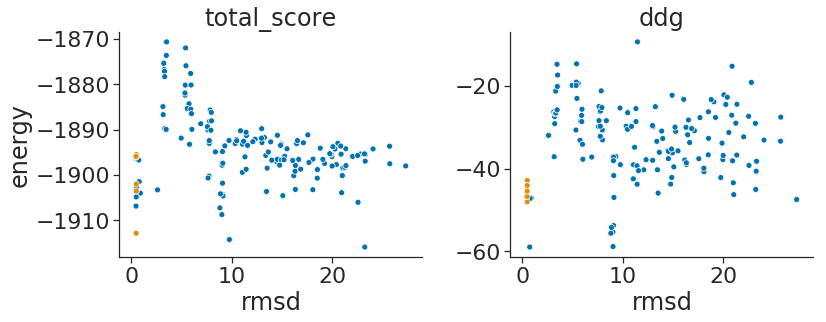

2ABZ 150


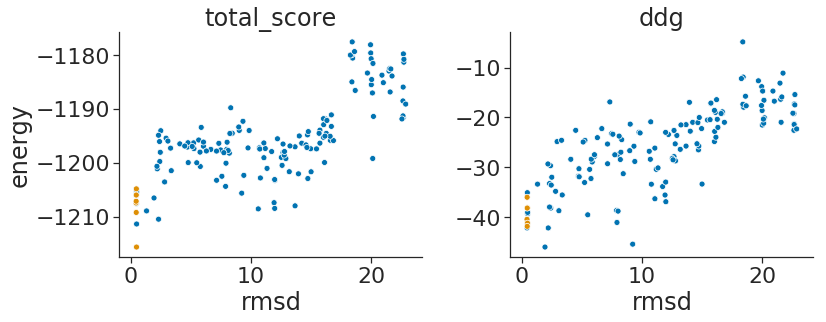

2AJF 150


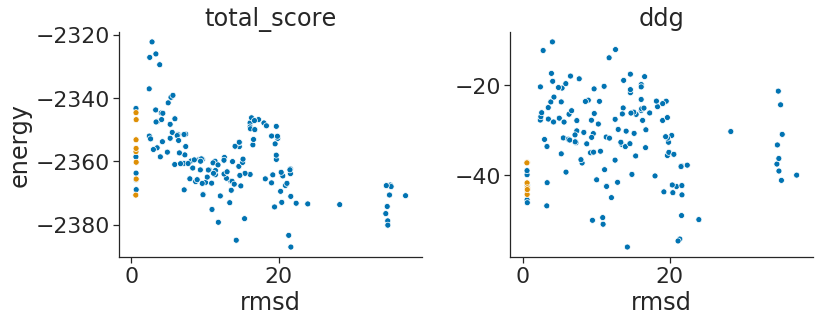

2AYO 150


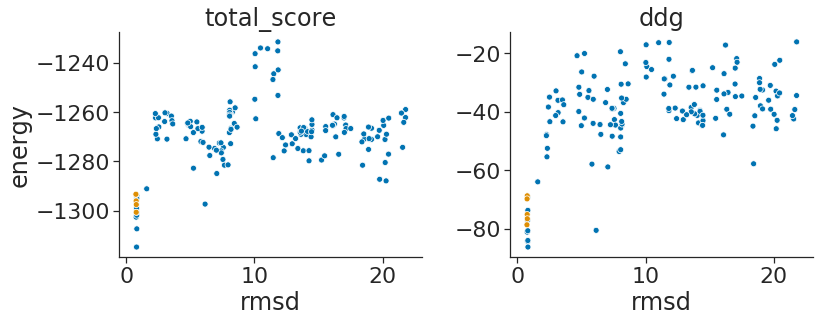

2I9B 150


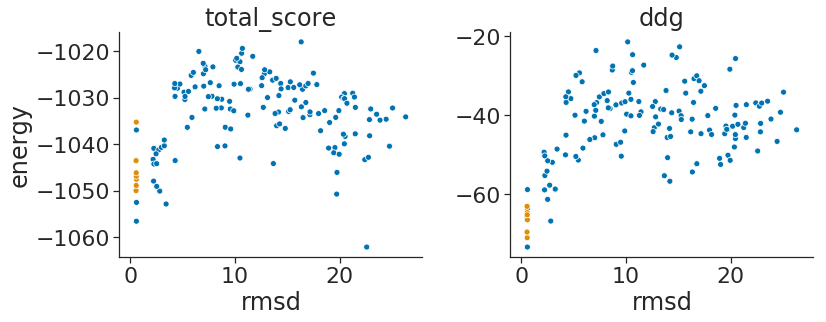

2JEL 150


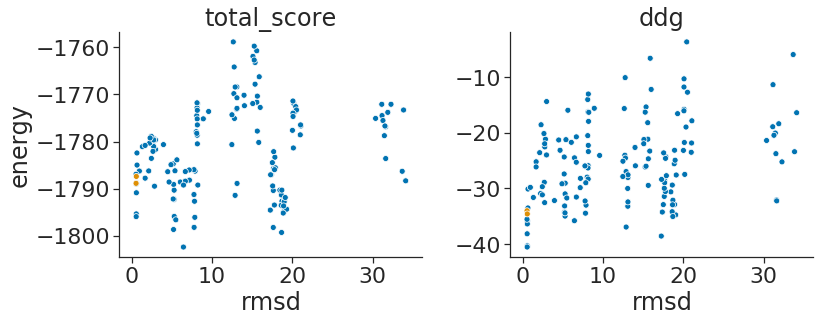

2MTA 150


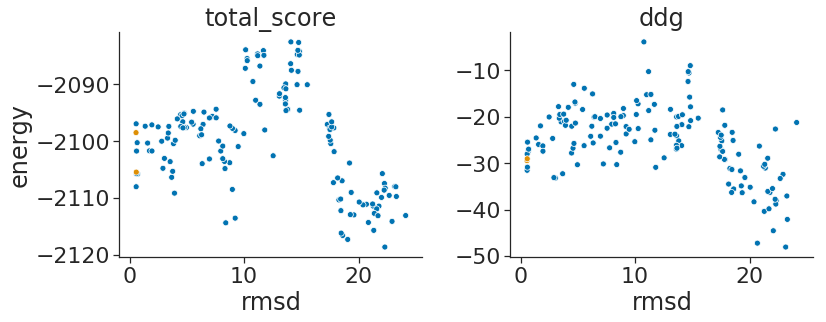

2O3B 150


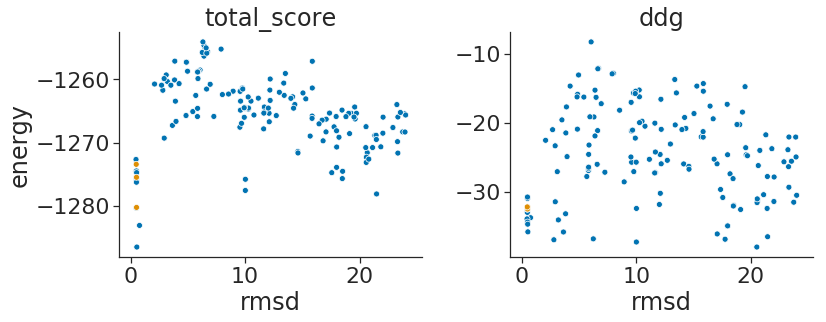

2PCC 150


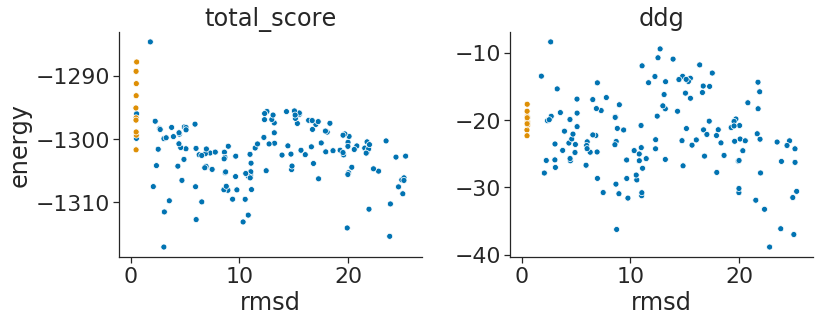

2VIS 150


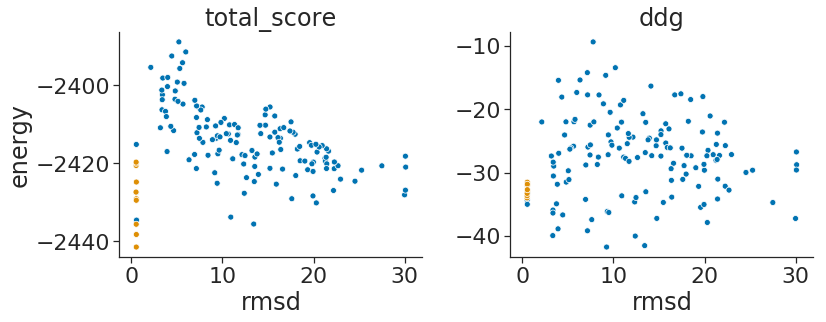

3CPH 150


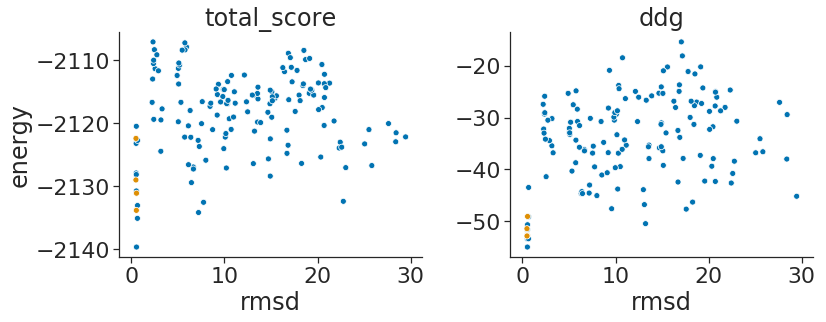

9QFW 150


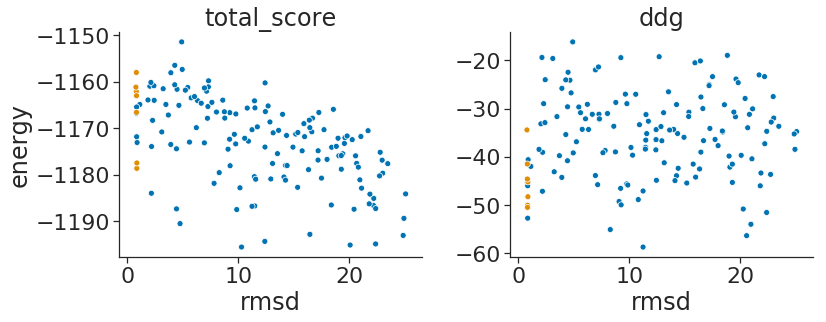

In [287]:
f_ids = ['complex', 'chainA', 'chainB']
relaxscript_name = 'MonomerDesign2019' # 'cartminpack' # 'cartminpack_1_50' #  
dont_include_S = True
if dont_include_S:
    output_dir = 'results/optE_test_noS/'
else:
    output_dir = 'results/optE_test/'

# Cycle through natives one at a time and compute ddgs
all_scores_files = []
for native in natives_to_score:
    
    if native in ['1IJK']:
        continue
    
    # Read in data from different relax jobs
    dont_analyze = False
    for f_id in f_ids:
        f = os.path.join(
            output_dir,
            f'{native}_relax_interface_of_{f_id}_{relaxscript_name}.sc'
        )
        if not os.path.isfile(f):
            dont_analyze = True
            continue
        df = pandas.read_csv(f, skiprows=1, sep='\s+')
        if f_id == 'complex':
            ddg_df = df.copy()
        else:
            df[f_id] = df['total_score']
            ddg_df = ddg_df.merge(
                df[[f_id, 'description']],
                on='description', how='inner'
            )
    if dont_analyze:
        continue
    if len(ddg_df) < 100:
        continue

    # Identify relaxed natives
    ddg_df['decoy_type'] = ddg_df['description'].apply(
        lambda x: 'native' if 'xtal' in x else 'decoy'
    )
    ddg_df.sort_values('decoy_type', inplace=True)
        
    # Compute ddg from the total score of the relaxed complex
    # compared to the total score of each chain relaxed on its own
    ddg_df['ddg'] = \
        ddg_df['total_score'] - ddg_df['chainA'] - ddg_df['chainB']

    # Write results to output file
    ddg_df['rms'] = ddg_df['rmsd']
    output_file = os.path.join(
        output_dir,
        f'{native}_total_score_and_ddg_from_parts_{relaxscript_name}.sc'
    )
    ddg_df.to_csv(output_file, index=False, sep='\t')
    all_scores_files.append(output_file)
    
    # Plot data
    print(native, len(ddg_df))
    (fig, axs) = plt.subplots(
        ncols=2, figsize=[12,5], sharex=True
    )
    metrics = ['total_score', 'ddg']
    for (i, metric) in enumerate(metrics):
        n = sum(~ddg_df[metric].isnull())
        sns.scatterplot(
            x='rmsd', y=metric, data=ddg_df, ax=axs[i],
            hue='decoy_type', hue_order=['decoy', 'native']
        )
        axs[i].set(ylabel='', title=metric)
        axs[i].get_legend().remove()
    axs[0].set(ylabel='energy')
    plt.tight_layout()
    sns.despine()
    plt.show()
    
# Write a file that lists all score files
for metric in ['total_score', 'ddg']:
    temp_f = f'results/temp_optE_{relaxscript_name}_{metric}.docking'
    out_f = \
        f'results/score_docking_result_optE_{relaxscript_name}_{metric}'
    with open(temp_f, 'w') as f:
        for score_file in all_scores_files:
            f.write(f'{score_file}\n')
    cmd = ' '.join([
        'scripts/calc1dboltzmann.pl',
        '0.1',
        metric,
        temp_f,
        f'> {out_f}'
    ])
    ! {cmd}

ddg results/score_docking_result_optE_MonomerDesign2019_ddg
old score 0.64
new score 0.4
N landscapes = 42


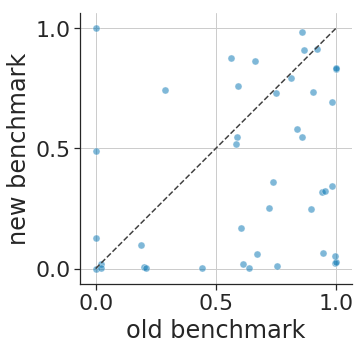

In [285]:
# Read in docking results from old benchmark
metric = 'ddg'
out_f = \
    f'results/score_docking_result_optE_{relaxscript_name}_{metric}'
print(metric, out_f)


result_file = os.path.join(
    '/home/haddox/2019/optE_eval/results/beta_nov16/',
    'nolayer_nostab_0/opt_1/score_docking_result'
)
with open(result_file) as f:
    score = float(f.readline().split()[0])
    print('old score', round(score, 2))
old_df = pandas.read_csv(
    result_file, sep='\s+',
    skiprows=2, names=['pdb', 'score']
)
old_df['pdb'] = old_df['pdb'].apply(
    lambda x: os.path.basename(x).split('.')[0]
)

# Read in docking results from new benchmark
with open(out_f) as f:
    score = float(f.readline().split()[0])
    print('new score', round(score, 2))
new_df = pandas.read_csv(
    out_f, sep='\s+',
    skiprows=2, names=['pdb', 'score']
)
new_df['pdb'] = new_df['pdb'].apply(
    lambda x: os.path.basename(x)[:4]
)

# Merge and plot data
new_df = new_df.merge(
    old_df, on='pdb', suffixes=['_new', '_old']
)
print('N landscapes =', len(new_df))
fig = plt.figure(figsize=[5,5])
ax = fig.add_subplot(111)
ax.plot(
    [0, 1], [0, 1],
    c='0.25', ls='--'
)
sns.scatterplot(
    x='score_old', y='score_new', data=new_df,
    s=50, alpha=0.5
)
ax.grid()
ax.set(
    xticks=[0, 0.5, 1], yticks=[0, 0.5, 1],
    xlabel='old benchmark', ylabel='new benchmark'
)
ax.set_aspect('equal', adjustable='box')
sns.despine()
plt.show()

Are results correlated between different scoring protocols?

MonomerDesign2019
total_score 0.44
ddg 0.4
N landscapes = 42
R = 0.55
p = 0.0


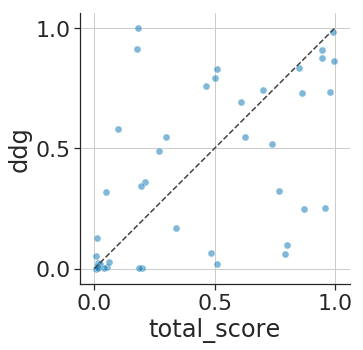

In [286]:
# Read in data
relaxscript = 'MonomerDesign2019' # 'cartminpack' # 'cartminpack_1_50' # 
print(relaxscript)
ts_f = f'results/score_docking_result_optE_{relaxscript}_total_score'
ddg_f = f'results/score_docking_result_optE_{relaxscript}_ddg'

with open(ts_f) as f:
    score = float(f.readline().split()[0])
    print('total_score', round(score, 2))
with open(ddg_f) as f:
    score = float(f.readline().split()[0])
    print('ddg', round(score, 2))

ts_df = pandas.read_csv(
    ts_f, sep='\s+',
    skiprows=2, names=['pdb', 'total_score']
)
ddg_df = pandas.read_csv(
    ddg_f, sep='\s+',
    skiprows=2, names=['pdb', 'ddg']
)
df = ddg_df.merge(ts_df, on='pdb', how='inner')
df['pdb'] = df['pdb'].apply(
    lambda x: os.path.basename(x)[:4]
)

# Plot data
print('N landscapes =', len(df))
(r, p) = scipy.stats.pearsonr(df['total_score'], df['ddg'])
print('R =', round(r, 2))
print('p =', round(p, 2))
fig = plt.figure(figsize=[5,5])
ax = fig.add_subplot(111)
ax.plot(
    [0, 1], [0, 1],
    c='0.25', ls='--'
)
sns.scatterplot(
    x='total_score', y='ddg', data=df,
    s=50, alpha=0.5
)
ax.grid()
ax.set(
    xticks=[0, 0.5, 1], yticks=[0, 0.5, 1]
)
ax.set_aspect('equal', adjustable='box')
sns.despine()
plt.show()

N landscapes = 38
R = 0.99
p = 0.0


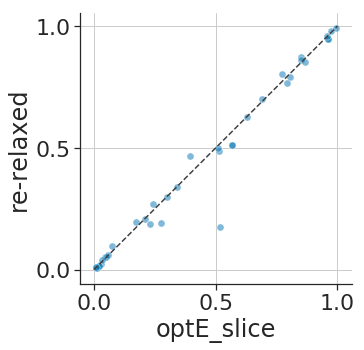

In [269]:
# Read in data
label1 = 'optE_slice'
f1 = 'results/score_docking_result_optE_slice_noS'
label2 = 're-relaxed'
f2 = f'results/score_docking_result_optE_MonomerDesign2019_total_score'

df1 = pandas.read_csv(
    f1, sep='\s+',
    skiprows=2, names=['pdb', label1]
)
df1['pdb'] = df1['pdb'].apply(
    lambda x: os.path.basename(x).replace('.sc', '')
)
df2 = pandas.read_csv(
    f2, sep='\s+',
    skiprows=2, names=['pdb', label2]
)
df2['pdb'] = df2['pdb'].apply(
    lambda x: os.path.basename(x)[:4]
)
df = df1.merge(df2, on='pdb', how='inner')


# Plot data
print('N landscapes =', len(df))
(r, p) = scipy.stats.pearsonr(df[label1], df[label2])
print('R =', round(r, 2))
print('p =', round(p, 2))
fig = plt.figure(figsize=[5,5])
ax = fig.add_subplot(111)
ax.plot(
    [0, 1], [0, 1],
    c='0.25', ls='--'
)
sns.scatterplot(
    x=label1, y=label2, data=df,
    s=50, alpha=0.5
)
ax.grid()
ax.set(
    xticks=[0, 0.5, 1], yticks=[0, 0.5, 1]
)
ax.set_aspect('equal', adjustable='box')
sns.despine()
plt.show()

Plot results

1AHW


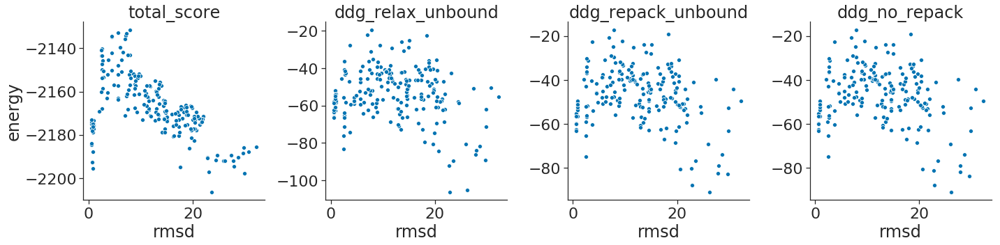

1AKJ


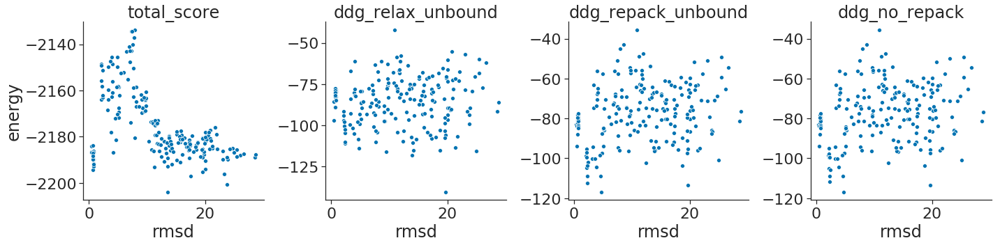

1BJ1


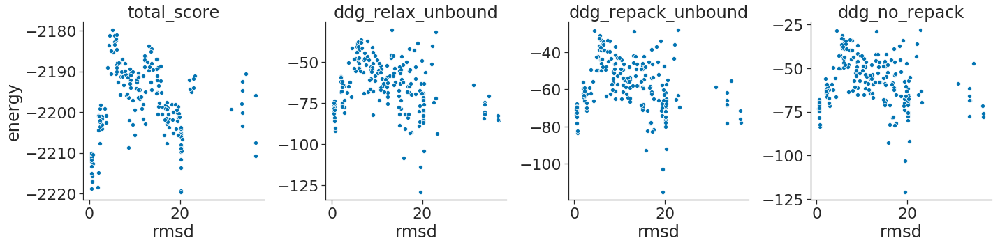

1BUH


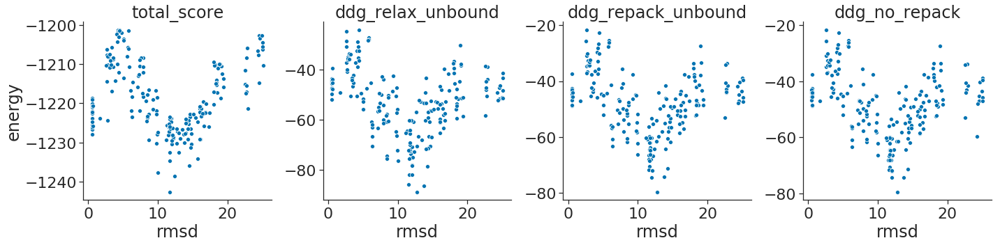

1DFJ


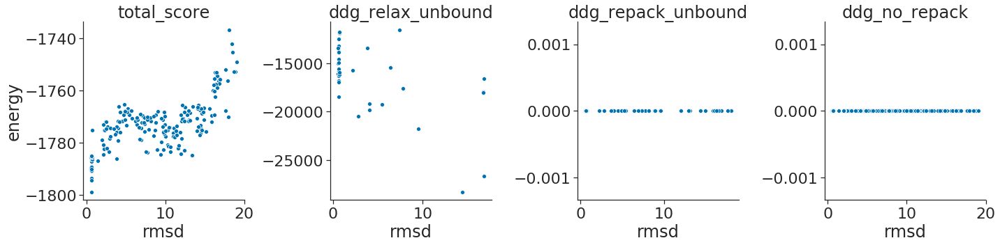

1E6E


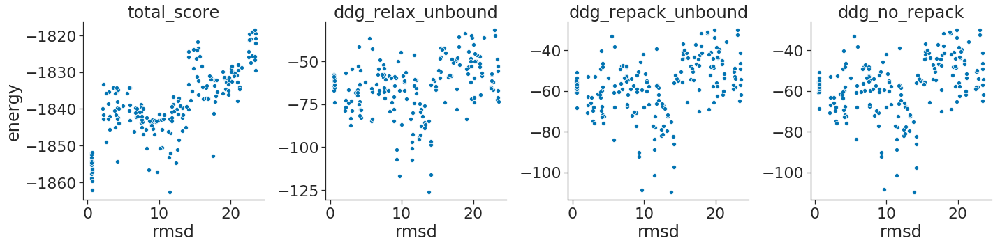

1EZU


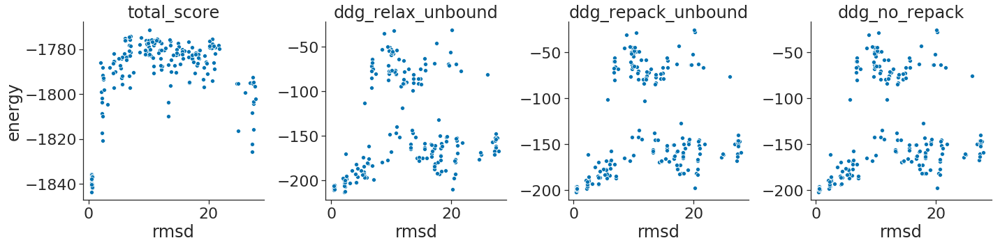

1F34


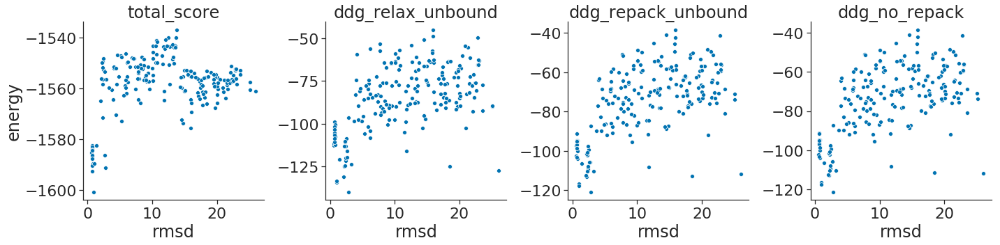

1F51


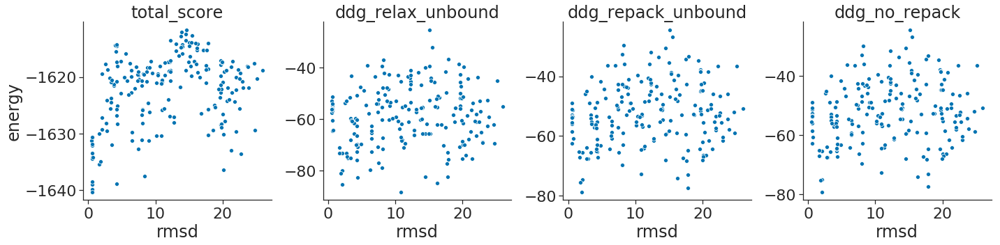

1FQ1


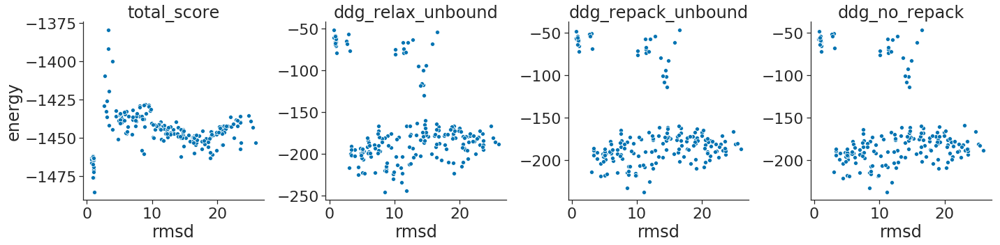

1FQJ


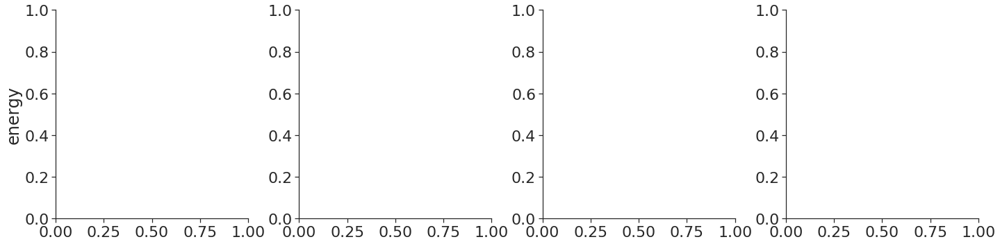

1FSK


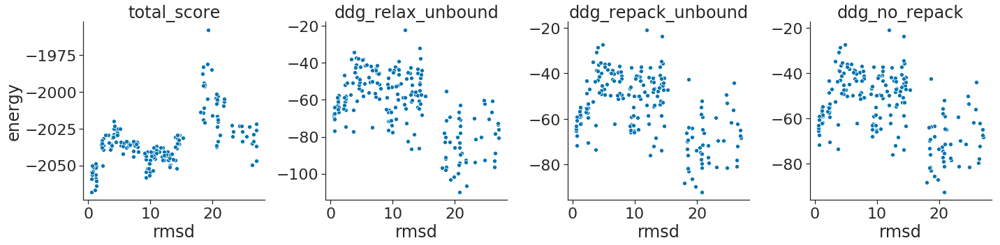

1GLA


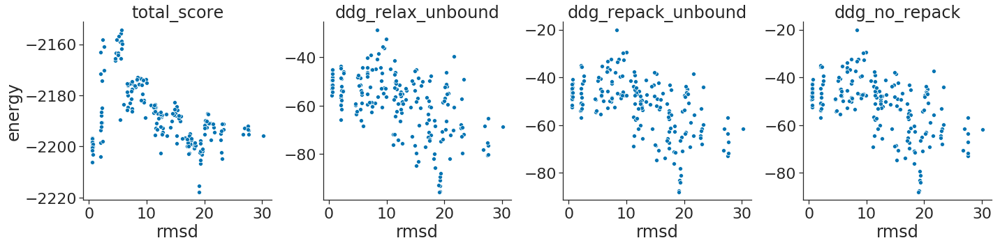

1H1V


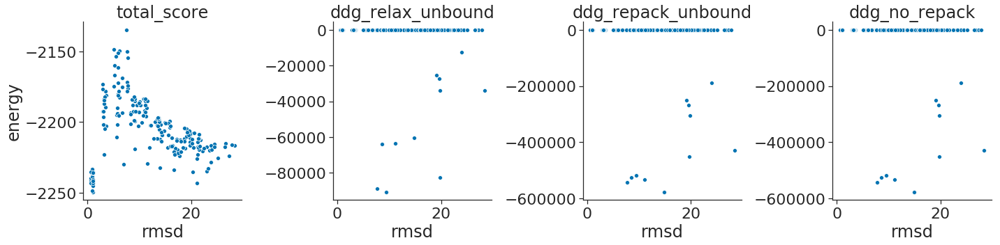

1IB1


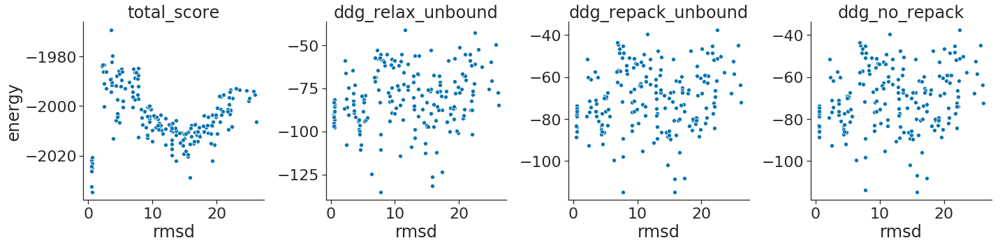

1JMO


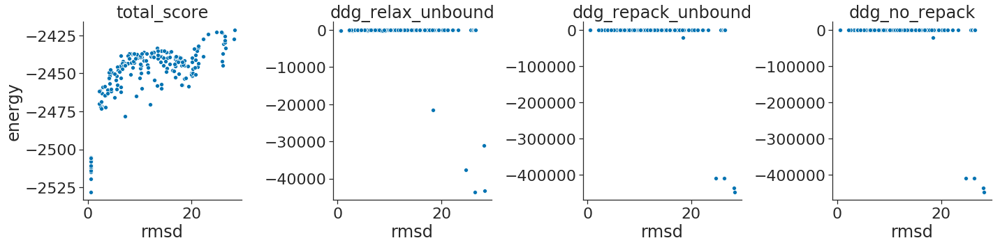

1JZD


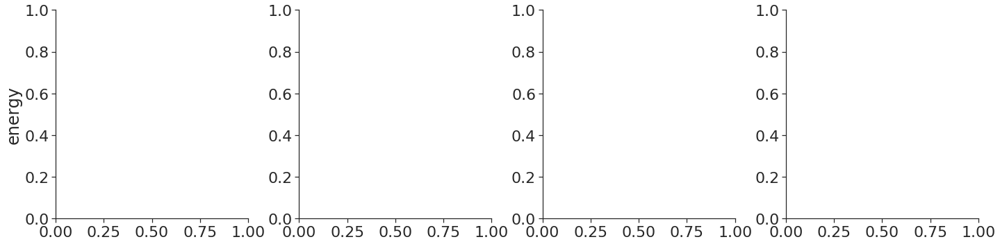

1KKL


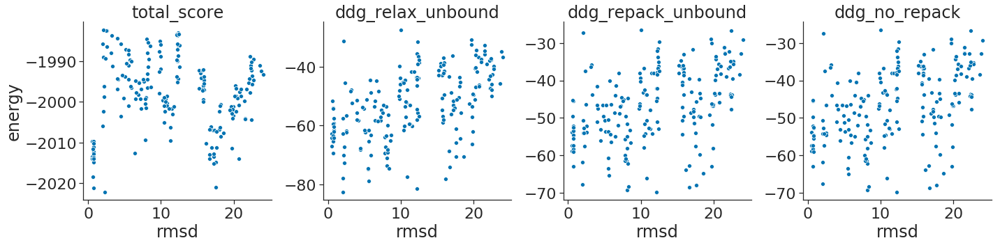

1M10


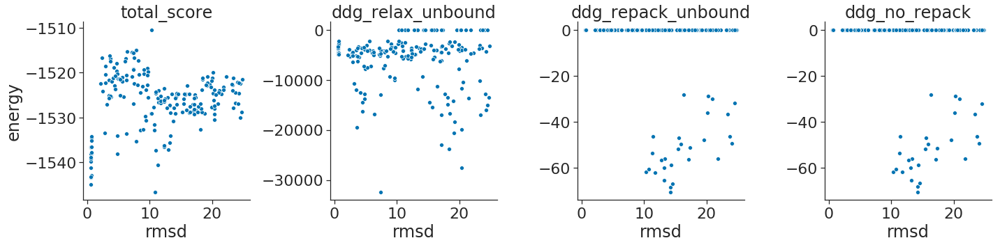

1NCA


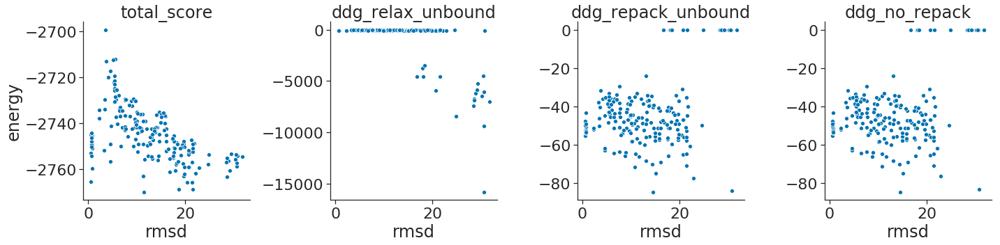

1NSN


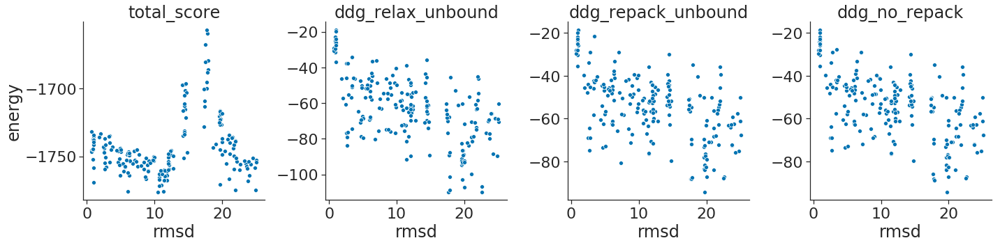

1OPH


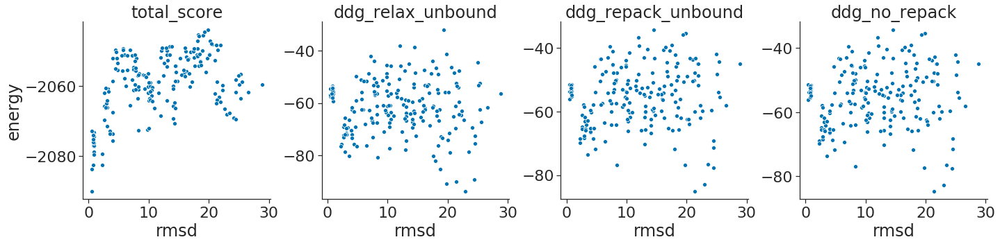

1US7


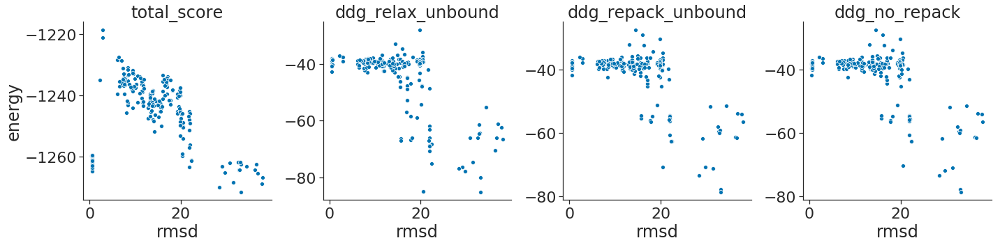

1Y64


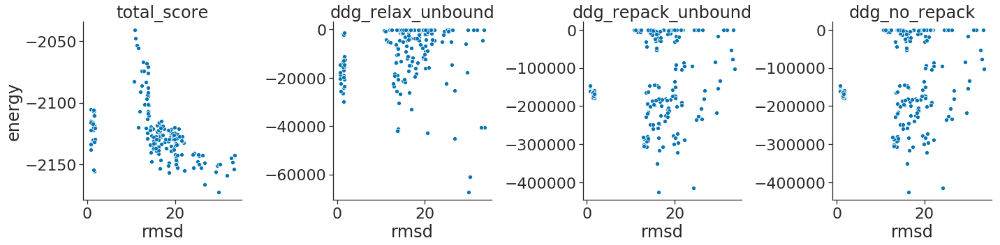

2A5T


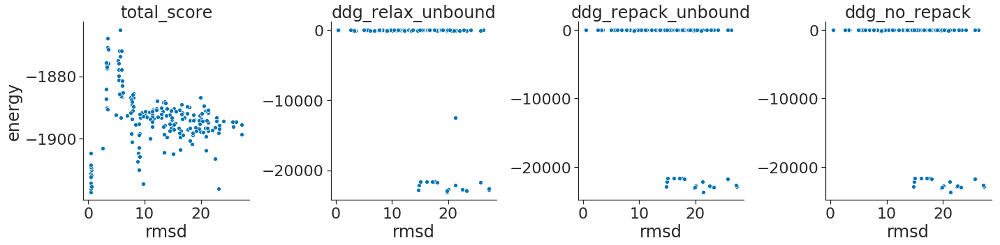

2AJF


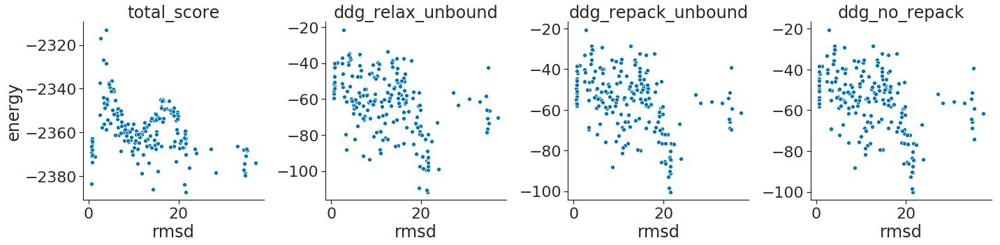

2H7V


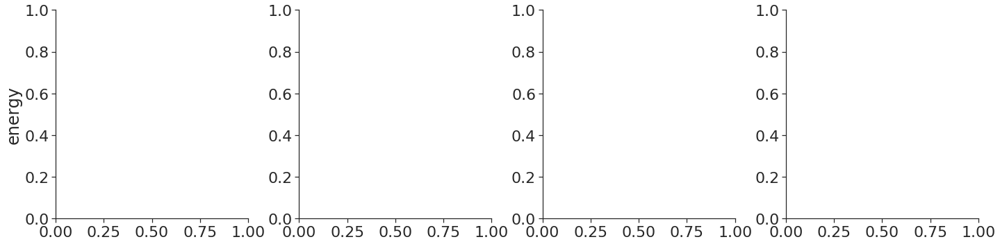

2MTA


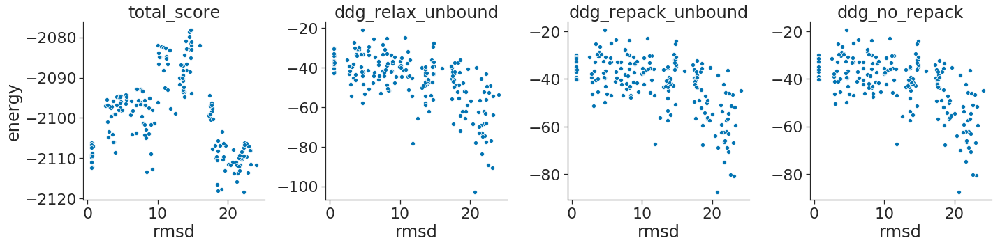

2VIS


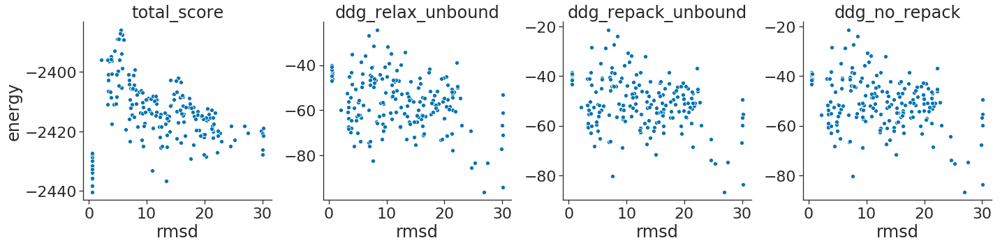

3CPH


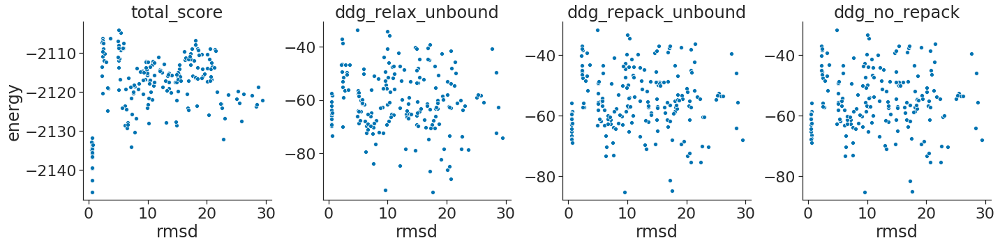

In [27]:
xml_names = [
#     ('total_score', 'total_score'),
#     ('ddg_relax_unbound', 'ddg'),
#     ('ddg_repack_unbound', 'ddg'),
#     ('ddg_no_repack', 'ddg'),
    ('relax_interface_of_complex', 'total_score'),
    ('relax_interface_of_chainA', 'total_score'),
    ('relax_interface_of_chainB', 'total_score')
]
for native in natives_to_score:
    print(native)
    (fig, axs) = plt.subplots(ncols=4, figsize=[20,5])
    for (i, (xml_name, metric)) in enumerate(xml_names):
        output_file = os.path.join(output_dir, f'{native}_{xml_name}.sc')
        if not os.path.isfile(output_file):
            continue
        df = pandas.read_csv(output_file, skiprows=1, sep='\s+')
        sns.scatterplot(x='rmsd', y=metric, data=df, ax=axs[i])
        axs[i].set(title=xml_name, ylabel='')

    axs[0].set(ylabel='energy')
    plt.tight_layout()
    sns.despine()
    plt.show()

In [91]:
df[['total_score', 'score', 'rmsd', 'description']]

,total_score,score,rmsd,description
0,-2195.511,-2076.379,0.869,HKH_2021_1AHW_S_19_39_39_0001_0000100001_00000...
1,-2176.789,-2058.382,0.601,HKH_2021_1AHW_bound_native_6_xtal_0000100001_0...
2,-2184.530,-2065.158,0.609,HKH_2021_1AHW_bound_native_7_xtal_0000100001_0...
3,-2183.827,-2064.199,0.612,HKH_2021_1AHW_bound_native_8_xtal_0000100001_0...
4,-2192.572,-2071.743,0.652,HKH_2021_1AHW_run_1_1AHW_bound_native_chain_B_...
5,-2178.896,-2061.054,0.849,HKH_2021_1AHW_run_1_S_19_16_1218_0001_chain_B_...
6,-2177.265,-2060.842,0.948,HKH_2021_1AHW_run_1_S_81_67_67_0001_chain_B_16...


In [92]:
df.columns.values

array(['SCORE:', 'total_score', 'score', 'cart_bonded', 'dslf_fa13',
       'fa_atr', 'fa_dun_dev', 'fa_dun_rot', 'fa_dun_semi', 'fa_elec',
       'fa_intra_atr_xover4', 'fa_intra_elec', 'fa_intra_rep_xover4',
       'fa_intra_sol_xover4', 'fa_rep', 'fa_sol', 'hbond_bb_sc',
       'hbond_lr_bb', 'hbond_sc', 'hbond_sr_bb', 'hxl_tors', 'lk_ball',
       'lk_ball_bridge', 'lk_ball_bridge_uncpl', 'lk_ball_iso', 'omega',
       'p_aa_pp', 'rama_prepro', 'ref', 'rmsd', 'time', 'description'],
      dtype=object)


* protocol: pack/min of sidechains only
    * if using total score, do a relax of just interface residues, allowing backbone movement (can use cartminpack.script to speed things up)
* total score better

* optE runs
    * fa_sol_bd
    * new docking benchmark (still generating decoys)
    
    * try run with what I have now on protein docking side
    * run DNA optE with fa_sol and fa_elec terms
        * though update the docking benchmark, too

* Which energy function should I start with?
    * beta_nov16 vs. beta_dec20
        * try with both?
        * come up with test that addresses perceived problems?
    * w/ fa_elec_dd?
        * use elec_dd, but test both distance and non-distance dependent versions
* train and test split for docking benchmark?
    * 65/100 for train, remainder for split?
    
Differnce may relate to bb flexibility, esp w/ loopy regions

Decoy set of protein-peptide complexes?

Score output from boinc

In [149]:
# Define inputs
rosetta_scripts_path = '/home/haddox/Rosetta/main/source/bin/rosetta_scripts.linuxgccrelease'
xml = 'scripts/compute_ddg_and_total_score.xml'
e_function = 'beta_nov16'
(weights_file, flags_file, extra_args) = e_functions_dict[e_function]

for (i, native) in enumerate(natives_to_score):
    native_pdb = os.path.join(
        '/home/dimaio/optE2/dualoptE/decoys/docking/',
        f'{native}_bound_native.pdb'
    )
    boinc_relax_dir = f'{resultsdir}/global_docks/{native}/boinc_relax/'
    home_boinc_results_dir = os.path.join(
        boinc_relax_dir.replace('/net/scratch/', '/home/'),
        'boinc_results/'
    )

    # Score all structures in all silent files
    out_files = glob.glob(os.path.join(
        home_boinc_results_dir,
        '*.out'
    ))
    out_files = [f for f in out_files if 'sbatch' not in f]

    print(native, len(out_files))
    for out_file in out_files:
        assert native in os.path.basename(out_file), out_file
        scores_file_prefix = out_file.replace('.out', '')
        sbatch_file = scores_file_prefix + '.sbatch'
        if not os.path.isfile(sbatch_file):
            cmd = ' '.join([
                rosetta_scripts_path,
                f'-in:file:silent {out_file}',
                '-in:file:silent_struct_type binary',
                f'-parser:protocol {xml}',
                f'-parser:script_vars',
                f'weights_file={weights_file}',
                '-crystal_refine',
                f'-out:prefix {home_boinc_results_dir}',
                f'-out:file:score_only {scores_file_prefix}.sc',
                f'-in:file:native {native_pdb}',
            ])
            if extra_args:
                cmd += ' ' + ' '.join(extra_args)
            if flags_file:
                cmd += f' @{flags_file}'
            design_utils.WriteSbatchFile(
                sbatch_file,
                command=cmd,
                queue_type='short',
                memory='2g',
            )
            ! sbatch {sbatch_file}

1AHW 4821
1AKJ 4440
1BJ1 4021
1BUH 4981
1DFJ 1415
1E6E 4101
1EZU 3513
1F51 567
1GLA 4067
1H1V 4465
1IB1 3186
1JMO 4757
1KKL 5
1NCA 4864
1NSN 2479
1OPH 4561
1Y64 4937
2A5T 4335
2AJF 5919
2H7V 3612
2MTA 3838
2VIS 4917
3CPH 4891
